<a href="https://colab.research.google.com/github/danieletirinnanzi/HUPLACLIP-NNs/blob/main/PlantedClique_NeuralNets_Daniele.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch
import torchvision
import torch.nn as nn
import torchvision.transforms as transforms
import torch.optim as optim
import matplotlib.pyplot as plt
import numpy as np
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
import torch.nn.functional as F
import math
from google.colab import files

from __future__ import print_function
from __future__ import division
from torchvision import datasets, models, transforms
import time
import os
import copy

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cpu


# Data generation functions

We define the function that generates the adjacency matrices with and without the cliques. The default probability to get a graph with a clique is  0.5 . The adjacency matrices in this case represents an Erdos-Renyi graph where the probability  p  to have an edge between two nodes is such that both the graph with and without the planted clique have the same average degree ( p=0.5  by default).

OLD CORRECTION (https://ncl-sissa.zulipchat.com/#narrow/stream/366018-planted-clique/topic/task-design/near/323448358):

In [ ]:
def plant_clique(graph, clique_size, graph_size):
    """
    Plants a clique of specified size within a given graph.

    Args:
        graph (torch.Tensor): Adjacency matrix representing the graph.
        size (int): Size of the clique to be planted.
        graph_size (int): Total number of nodes in the graph.

    Returns:
        torch.Tensor: Modified adjacency matrix with the planted clique.
    """
    graph[:clique_size, :clique_size] = torch.ones(clique_size,clique_size)
    random_permutation = torch.randperm(graph_size)
    graph = graph[random_permutation[:, None], random_permutation]
    return graph

def generate_graphs(number_of_graphs, graph_size, clique_size, p_nodes=0.5, p_clique=0.5):
    """
    Generates multiple graphs.

    Args:
        number_of_graphs (int): Number of graphs to generate.
        graph_size (int): Number of nodes in each graph.
        clique_size (int): Size of the planted clique.
        p_nodes (float): Probability of an edge being present between two nodes.
        p_clique (float): Probability of a graph having a planted clique.

    Returns:
        tuple: A tuple containing the generated graphs and the on_off flag for each graph.
    """
    on_off = torch.bernoulli(p_clique * torch.ones(number_of_graphs))
    data = torch.zeros(number_of_graphs, 1, graph_size, graph_size)
    for i in range(number_of_graphs):
      # generating lower triangle of the adjacency matrix
        if not on_off[i]:
          # clique not present
          p_corrected = p_nodes + (1 - p_nodes) * ((clique_size * (clique_size - 1)) / (graph_size * (graph_size - 1)))
          adjacency_matrix = torch.bernoulli(p_corrected * torch.ones(graph_size, graph_size))
        else:
          # clique present
          adjacency_matrix = torch.bernoulli(p_nodes * torch.ones(graph_size, graph_size))  #regular graph without clique
          # adding clique to adjacency matrix
          adjacency_matrix = plant_clique(adjacency_matrix, clique_size, graph_size)
        # generating upper triangular matrix
        upper_triangular = torch.triu(adjacency_matrix)
        adjacency_matrix = upper_triangular + torch.transpose(upper_triangular, 0, 1)
        adjacency_matrix.fill_diagonal_(1)
        # adding graph to the matrix of graphs
        data[i, 0] = adjacency_matrix

    return data, on_off.tolist()

Checking that functions work properly:

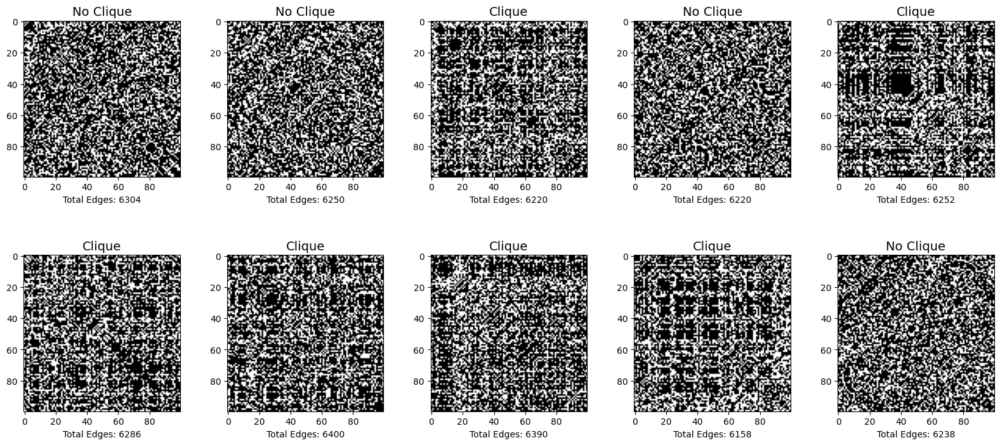

In [ ]:
# Generating 10 graphs and storing them:
graphs_for_visualization = generate_graphs(10, 100, 50)

# Creating subplots for 10 graphs in 2 rows of 5 pictures each
fig, axs = plt.subplots(2, 5, figsize=(20, 8))

# Looping through each graph and its presence of clique
for i, (graph, is_clique) in enumerate(zip(graphs_for_visualization[0], graphs_for_visualization[1])):
    # Selecting subplot based on the index i
    ax = axs[i // 5, i % 5]
    # Setting the title based on the presence of clique
    title = "Clique" if is_clique else "No Clique"
    # Calculating the total number of edges
    total_edges = int(graph[0].sum())
    # Adding a subtitle with the total number of edges
    subtitle = f"Total Edges: {total_edges}"
    ax.set_title(title, fontsize=14)  # Setting title
    ax.set_xlabel(subtitle, fontsize=10)  # Adding subtitle with total edges
    # Plotting the adjacency matrix
    ax.imshow(graph[0], cmap=plt.get_cmap('gray_r'), vmin=0, vmax=1)

# Adjusting layout with increased vertical spacing
plt.subplots_adjust(hspace=0.5)
plt.show()


NEW CORRECTION (https://ncl-sissa.zulipchat.com/#narrow/stream/366018-planted-clique/topic/task-design/near/428182290):

In [ ]:
def plant_clique(graph, clique_size, graph_size):
    """
    Plants a clique of specified size within a given graph.

    Args:
        graph (torch.Tensor): Adjacency matrix representing the graph.
        size (int): Size of the clique to be planted.
        graph_size (int): Total number of nodes in the graph.

    Returns:
        torch.Tensor: Modified adjacency matrix with the planted clique.
    """
    graph[:clique_size, :clique_size] = torch.ones(clique_size,clique_size)
    random_permutation = torch.randperm(graph_size)
    graph = graph[random_permutation[:, None], random_permutation]
    return graph

def generate_graphs(number_of_graphs, graph_size, clique_size, p_nodes=0.5, p_clique=0.5):
    """
    Generates multiple graphs.

    Args:
        number_of_graphs (int): Number of graphs to generate.
        graph_size (int): Number of nodes in each graph.
        clique_size (int): Size of the planted clique.
        p_nodes (float): Probability of an edge being present between two nodes.
        p_clique (float): Probability of a graph having a planted clique.

    Returns:
        tuple: A tuple containing the generated graphs and the on_off flag for each graph.
    """
    on_off = torch.bernoulli(p_clique * torch.ones(number_of_graphs))
    data = torch.zeros(number_of_graphs, 1, graph_size, graph_size)
    for i in range(number_of_graphs):
      # generating lower triangle of the adjacency matrix
        if not on_off[i]:
          # clique not present (no need to correct)
          adjacency_matrix = torch.bernoulli(p_nodes * torch.ones(graph_size, graph_size))
        else:
          # clique present (new correction acts on the reduction of p before adding the clique):
          # - computing the new probability of association (will be less than p_nodes)
          p_corrected = (p_nodes*graph_size*(graph_size - 1) - clique_size * (clique_size - 1))/( (graph_size - clique_size)*(graph_size + clique_size - 1) )

          print(p_corrected)

          # - creating the new random graph with the probability just computed
          adjacency_matrix = torch.bernoulli(p_corrected * torch.ones(graph_size, graph_size))  #regular graph without clique
          # adding clique to adjacency matrix
          adjacency_matrix = plant_clique(adjacency_matrix, clique_size, graph_size)
        # generating upper triangular matrix
        upper_triangular = torch.triu(adjacency_matrix)
        adjacency_matrix = upper_triangular + torch.transpose(upper_triangular, 0, 1)
        adjacency_matrix.fill_diagonal_(1)
        # adding graph to the matrix of graphs
        data[i, 0] = adjacency_matrix

    return data, on_off.tolist()

Checking that functions work properly:

0.33557046979865773
0.33557046979865773
0.33557046979865773
0.33557046979865773


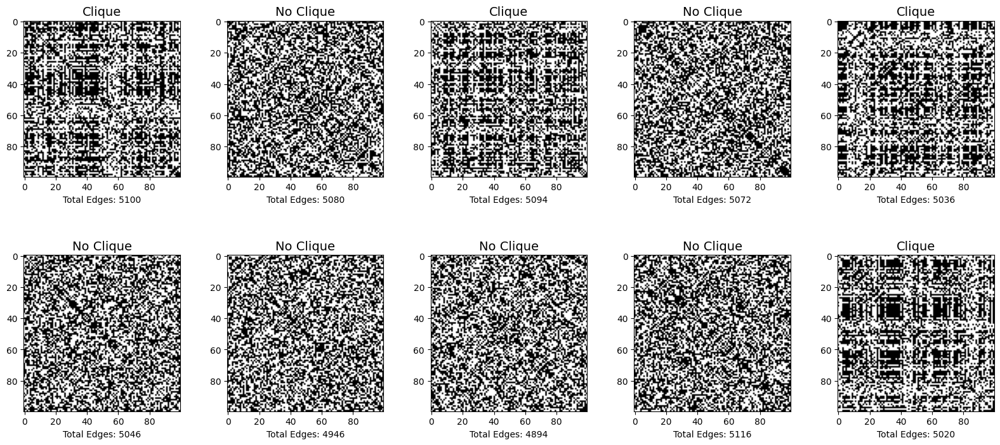

In [ ]:
# Generating 10 graphs and storing them:
graphs_for_visualization = generate_graphs(10, 100, 50)

# Creating subplots for 10 graphs in 2 rows of 5 pictures each
fig, axs = plt.subplots(2, 5, figsize=(20, 8))

# Looping through each graph and its presence of clique
for i, (graph, is_clique) in enumerate(zip(graphs_for_visualization[0], graphs_for_visualization[1])):
    # Selecting subplot based on the index i
    ax = axs[i // 5, i % 5]
    # Setting the title based on the presence of clique
    title = "Clique" if is_clique else "No Clique"
    # Calculating the total number of edges
    total_edges = int(graph[0].sum())
    # Adding a subtitle with the total number of edges
    subtitle = f"Total Edges: {total_edges}"
    ax.set_title(title, fontsize=14)  # Setting title
    ax.set_xlabel(subtitle, fontsize=10)  # Adding subtitle with total edges
    # Plotting the adjacency matrix
    ax.imshow(graph[0], cmap=plt.get_cmap('gray_r'), vmin=0, vmax=1)

# Adjusting layout with increased vertical spacing
plt.subplots_adjust(hspace=0.5)
plt.show()


# Early stopping function

Defining the early stopping function:

In [ ]:
def EarlyStopper(validation_loss, training_loss, memory=3, validation_exit_error= 0.2, training_exit_error = 0.2):
    """
    Implements early stopping based on validation and training losses. If both are below the "exit_error" values defined above, then training is interrupted.

    Args:
        validation_loss (numpy.array): Array containing validation loss values.
        training_loss (numpy.array): Array containing training loss values.
        counter (int): Current count of epochs where validation loss increases.
        min_validation_loss (float): Minimum validation loss encountered so far.
        memory (int): Number of previous epochs to consider for calculating average validation and training losses.
        validation_exit_error (float): Validation error below which we can stop early
        training_exit_error (float): Training error below which we can stop early

    Returns:
        tuple: A boolean indicating whether to stop early.
    """

    # Computing length of validation and training losses
    val_length = validation_loss.shape[0]
    training_length = training_loss.shape[0]

    # Checking if average value of validation and training losses in the last "memory" epochs allows early stopping:
    if np.mean(validation_loss[val_length - memory:]) < validation_exit_error and np.mean(training_loss[training_length - memory:]) < training_exit_error:
      return True
    else:
      return False

# Multilayer Perceptron (MLP)

Here we define the MLP. The meaning of each parameter is explained below. This network works only with graphs of a certain size, a different graph needs a slightly different architecture. There is also an early stopping function, which stops if the validation error starts to increase for several steps.

The architecture is made by stacking many layers of neurons of different sizes. The optimizier is Adam and the loss is the CrossEntropy.

Defining the architecture:

In [ ]:
# Graph parameters (needed to define input dimension)
graph_size = 100

# Hyperparamters
lr_rate=0.01            # learning rate
l1=1000                 # number of neurons in the first layer
l2=500                  # number of neurons in the second layer
l3=100                  # number of neurons in the third layer
l4=20                   # number of neurons in the fourth layer
dropout_prob=0.2        # dropout probability

# building the architecture
model_MLP = nn.Sequential(
    nn.Flatten(),
    nn.Linear(graph_size*graph_size,l1),
    nn.BatchNorm1d(l1),
    nn.ReLU(),
    nn.Dropout(dropout_prob),
    nn.Linear(l1,l2),
    nn.BatchNorm1d(l2),
    nn.ReLU(),
    nn.Dropout(dropout_prob),
    nn.Linear(l2,l3),
    nn.BatchNorm1d(l3),
    nn.ReLU(),
    nn.Linear(l3,2),
    nn.BatchNorm1d(2),
    nn.ReLU(),
)

optim=torch.optim.Adam(model_MLP.parameters())    # optimization with Adam
criterion = nn.CrossEntropyLoss()                 # criterion = Cross Entropy
model_MLP.to(device)

Sequential(
  (0): Flatten(start_dim=1, end_dim=-1)
  (1): Linear(in_features=10000, out_features=1000, bias=True)
  (2): BatchNorm1d(1000, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (3): ReLU()
  (4): Dropout(p=0.2, inplace=False)
  (5): Linear(in_features=1000, out_features=500, bias=True)
  (6): BatchNorm1d(500, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (7): ReLU()
  (8): Dropout(p=0.2, inplace=False)
  (9): Linear(in_features=500, out_features=100, bias=True)
  (10): BatchNorm1d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (11): ReLU()
  (12): Linear(in_features=100, out_features=2, bias=True)
  (13): BatchNorm1d(2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (14): ReLU()
)

The following is the traing procedure. It works in the following way: at each epoch we generate a batch of training samples. Then we train the network with this batch and check the validation error. This online generation of batches ensures a faster training.

Eventually we also plot the generalization error versus the parameter $k/\sqrt{n}$.

If you want to run the code test with small number of epochs, small max_step or smaller samples; the code takes very long.

## Training loop:

In the training loop, there are 3 nested **for** cycles:

- FOR decreasing clique size (curriculum training)
    - FOR epochs (50 epochs for each clique size)
        - FOR training step (100 training steps for each epoch):
          At each step:
          - graphs are generated
          - network is trained on the generated graphs
    - early stopping criterion is checked after each epoch is completed


Clique size is now:  60
Epoch number =  1 . Percentage of training completed =  0.0 %
0
[0]
[0.8378922343254089]
[0.7488358020782471]


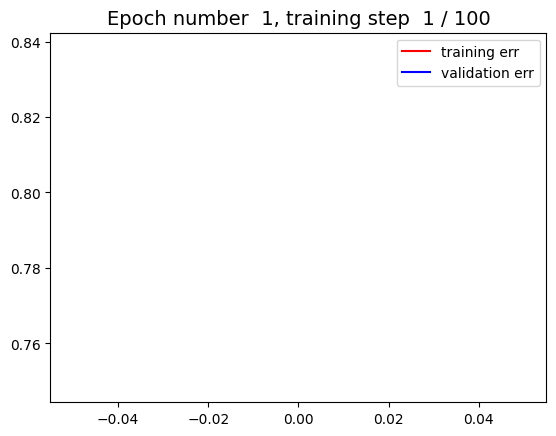

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  5.0 %
5
[0, 5]
[0.8378922343254089, 0.564561128616333]
[0.7488358020782471, 0.6426639556884766]


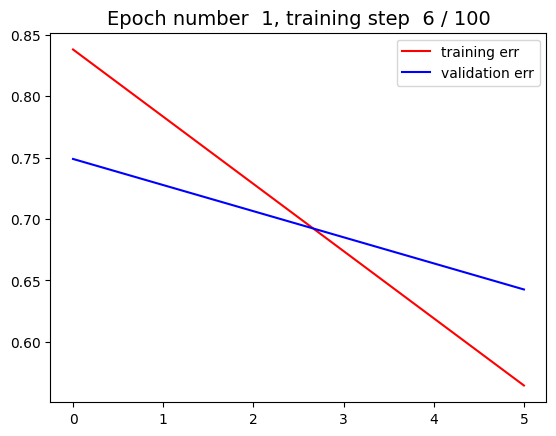

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  10.0 %
10
[0, 5, 10]
[0.8378922343254089, 0.564561128616333, 0.4369795322418213]
[0.7488358020782471, 0.6426639556884766, 0.4096433222293854]


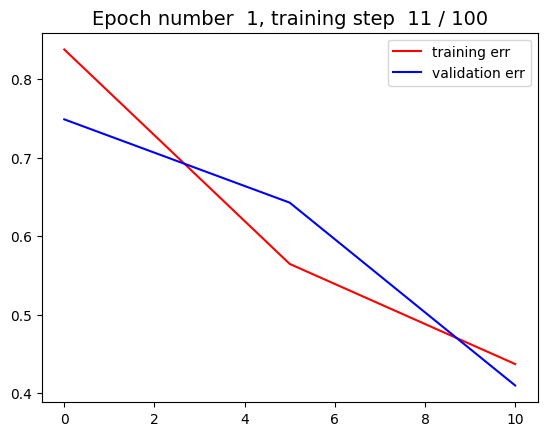

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  15.0 %
15
[0, 5, 10, 15]
[0.8378922343254089, 0.564561128616333, 0.4369795322418213, 0.37532293796539307]
[0.7488358020782471, 0.6426639556884766, 0.4096433222293854, 0.4267587661743164]


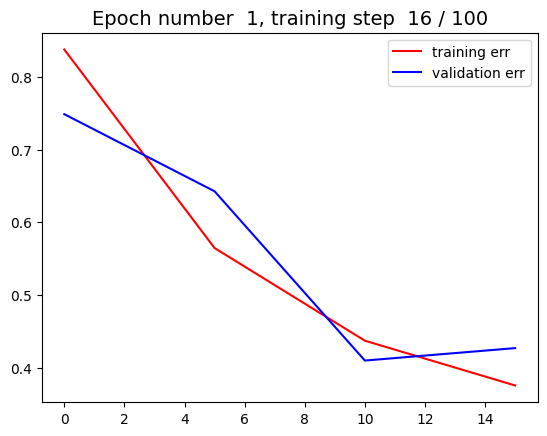

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  20.0 %
20
[0, 5, 10, 15, 20]
[0.8378922343254089, 0.564561128616333, 0.4369795322418213, 0.37532293796539307, 0.43328022956848145]
[0.7488358020782471, 0.6426639556884766, 0.4096433222293854, 0.4267587661743164, 0.38785502314567566]


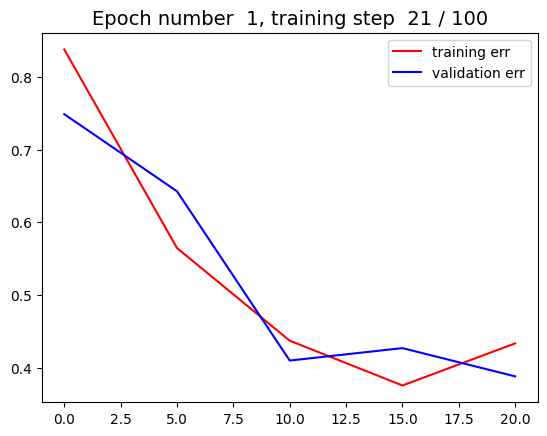

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  25.0 %
25
[0, 5, 10, 15, 20, 25]
[0.8378922343254089, 0.564561128616333, 0.4369795322418213, 0.37532293796539307, 0.43328022956848145, 0.4022596776485443]
[0.7488358020782471, 0.6426639556884766, 0.4096433222293854, 0.4267587661743164, 0.38785502314567566, 0.3517073392868042]


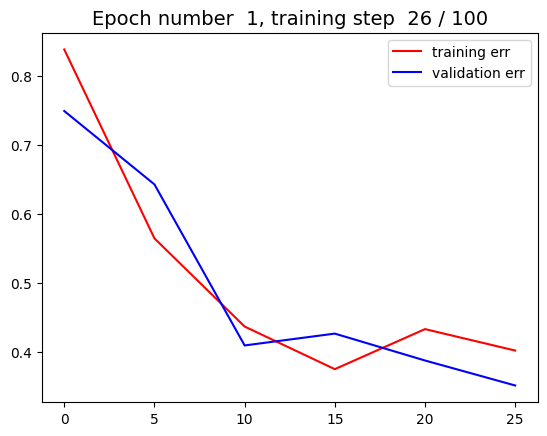

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  30.0 %
30
[0, 5, 10, 15, 20, 25, 30]
[0.8378922343254089, 0.564561128616333, 0.4369795322418213, 0.37532293796539307, 0.43328022956848145, 0.4022596776485443, 0.3603600263595581]
[0.7488358020782471, 0.6426639556884766, 0.4096433222293854, 0.4267587661743164, 0.38785502314567566, 0.3517073392868042, 0.37923166155815125]


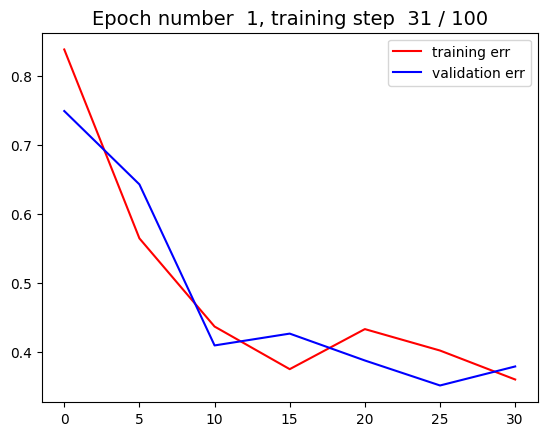

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  35.0 %
35
[0, 5, 10, 15, 20, 25, 30, 35]
[0.8378922343254089, 0.564561128616333, 0.4369795322418213, 0.37532293796539307, 0.43328022956848145, 0.4022596776485443, 0.3603600263595581, 0.3469082713127136]
[0.7488358020782471, 0.6426639556884766, 0.4096433222293854, 0.4267587661743164, 0.38785502314567566, 0.3517073392868042, 0.37923166155815125, 0.3992237448692322]


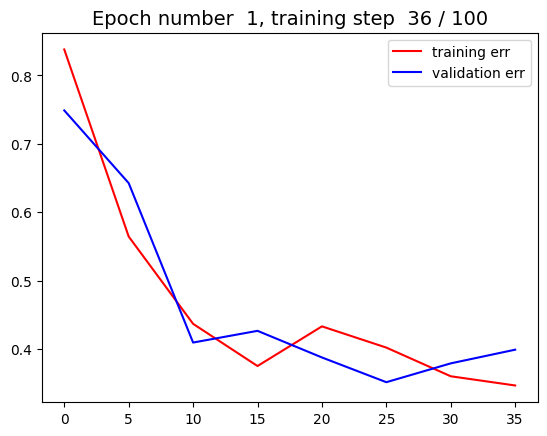

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  40.0 %
40
[0, 5, 10, 15, 20, 25, 30, 35, 40]
[0.8378922343254089, 0.564561128616333, 0.4369795322418213, 0.37532293796539307, 0.43328022956848145, 0.4022596776485443, 0.3603600263595581, 0.3469082713127136, 0.3342181146144867]
[0.7488358020782471, 0.6426639556884766, 0.4096433222293854, 0.4267587661743164, 0.38785502314567566, 0.3517073392868042, 0.37923166155815125, 0.3992237448692322, 0.331463098526001]


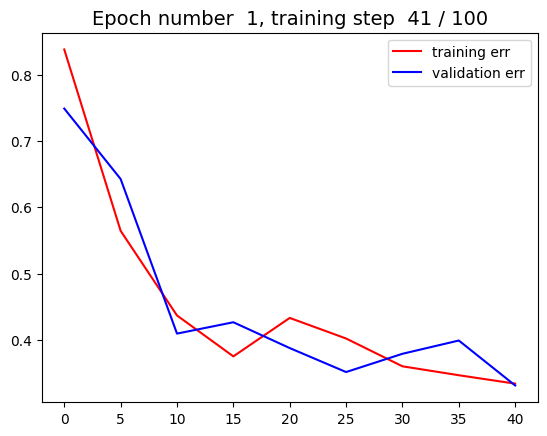

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  45.0 %
45
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
[0.8378922343254089, 0.564561128616333, 0.4369795322418213, 0.37532293796539307, 0.43328022956848145, 0.4022596776485443, 0.3603600263595581, 0.3469082713127136, 0.3342181146144867, 0.32594528794288635]
[0.7488358020782471, 0.6426639556884766, 0.4096433222293854, 0.4267587661743164, 0.38785502314567566, 0.3517073392868042, 0.37923166155815125, 0.3992237448692322, 0.331463098526001, 0.37897464632987976]


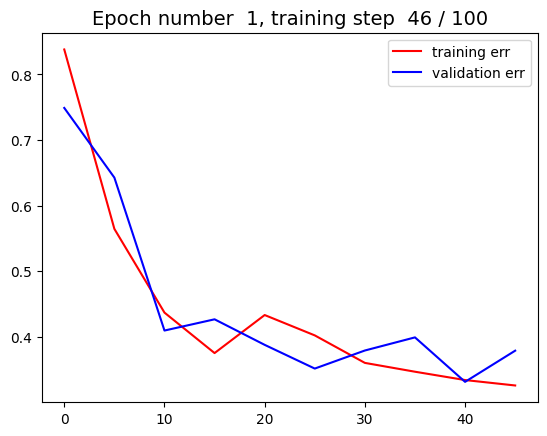

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  50.0 %
50
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]
[0.8378922343254089, 0.564561128616333, 0.4369795322418213, 0.37532293796539307, 0.43328022956848145, 0.4022596776485443, 0.3603600263595581, 0.3469082713127136, 0.3342181146144867, 0.32594528794288635, 0.34331274032592773]
[0.7488358020782471, 0.6426639556884766, 0.4096433222293854, 0.4267587661743164, 0.38785502314567566, 0.3517073392868042, 0.37923166155815125, 0.3992237448692322, 0.331463098526001, 0.37897464632987976, 0.32419946789741516]


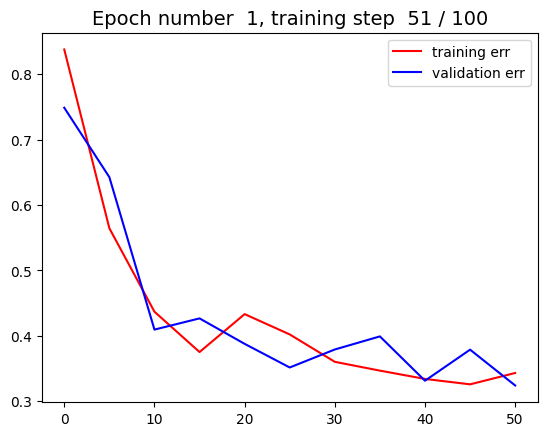

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  55.0 %
55
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55]
[0.8378922343254089, 0.564561128616333, 0.4369795322418213, 0.37532293796539307, 0.43328022956848145, 0.4022596776485443, 0.3603600263595581, 0.3469082713127136, 0.3342181146144867, 0.32594528794288635, 0.34331274032592773, 0.33245646953582764]
[0.7488358020782471, 0.6426639556884766, 0.4096433222293854, 0.4267587661743164, 0.38785502314567566, 0.3517073392868042, 0.37923166155815125, 0.3992237448692322, 0.331463098526001, 0.37897464632987976, 0.32419946789741516, 0.3175300657749176]


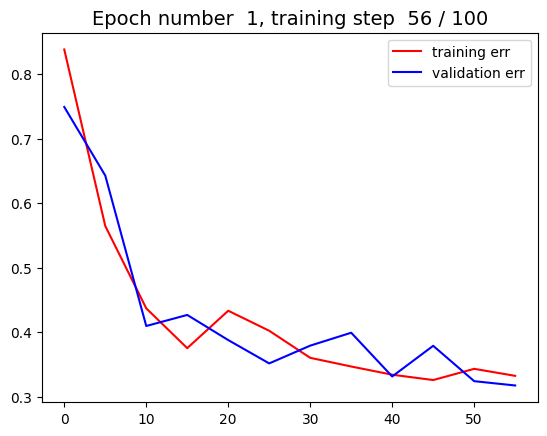

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  60.0 %
60
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]
[0.8378922343254089, 0.564561128616333, 0.4369795322418213, 0.37532293796539307, 0.43328022956848145, 0.4022596776485443, 0.3603600263595581, 0.3469082713127136, 0.3342181146144867, 0.32594528794288635, 0.34331274032592773, 0.33245646953582764, 0.33218708634376526]
[0.7488358020782471, 0.6426639556884766, 0.4096433222293854, 0.4267587661743164, 0.38785502314567566, 0.3517073392868042, 0.37923166155815125, 0.3992237448692322, 0.331463098526001, 0.37897464632987976, 0.32419946789741516, 0.3175300657749176, 0.3056946098804474]


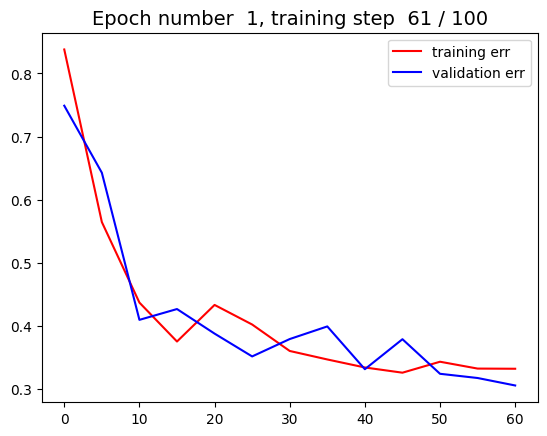

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  65.0 %
65
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65]
[0.8378922343254089, 0.564561128616333, 0.4369795322418213, 0.37532293796539307, 0.43328022956848145, 0.4022596776485443, 0.3603600263595581, 0.3469082713127136, 0.3342181146144867, 0.32594528794288635, 0.34331274032592773, 0.33245646953582764, 0.33218708634376526, 0.31731146574020386]
[0.7488358020782471, 0.6426639556884766, 0.4096433222293854, 0.4267587661743164, 0.38785502314567566, 0.3517073392868042, 0.37923166155815125, 0.3992237448692322, 0.331463098526001, 0.37897464632987976, 0.32419946789741516, 0.3175300657749176, 0.3056946098804474, 0.3119531571865082]


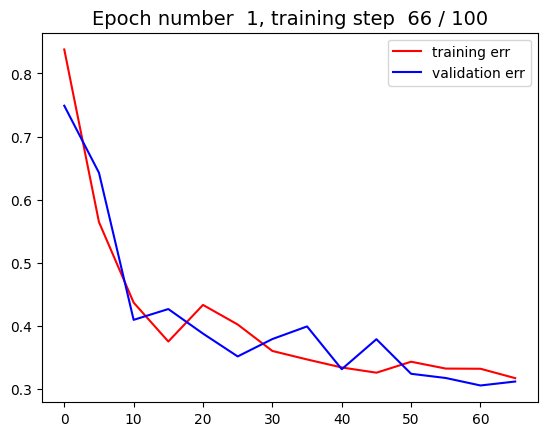

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  70.0 %
70
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70]
[0.8378922343254089, 0.564561128616333, 0.4369795322418213, 0.37532293796539307, 0.43328022956848145, 0.4022596776485443, 0.3603600263595581, 0.3469082713127136, 0.3342181146144867, 0.32594528794288635, 0.34331274032592773, 0.33245646953582764, 0.33218708634376526, 0.31731146574020386, 0.3183771073818207]
[0.7488358020782471, 0.6426639556884766, 0.4096433222293854, 0.4267587661743164, 0.38785502314567566, 0.3517073392868042, 0.37923166155815125, 0.3992237448692322, 0.331463098526001, 0.37897464632987976, 0.32419946789741516, 0.3175300657749176, 0.3056946098804474, 0.3119531571865082, 0.3029119074344635]


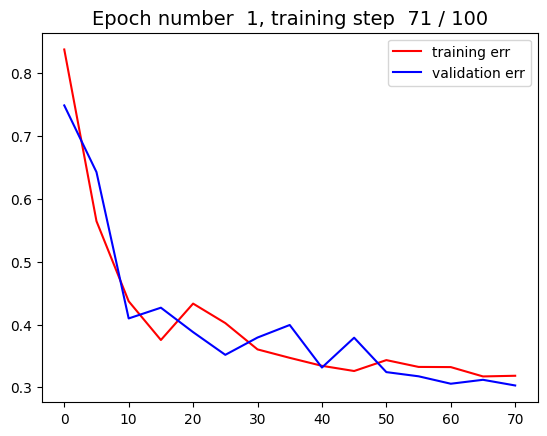

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  75.0 %
75
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75]
[0.8378922343254089, 0.564561128616333, 0.4369795322418213, 0.37532293796539307, 0.43328022956848145, 0.4022596776485443, 0.3603600263595581, 0.3469082713127136, 0.3342181146144867, 0.32594528794288635, 0.34331274032592773, 0.33245646953582764, 0.33218708634376526, 0.31731146574020386, 0.3183771073818207, 0.3254852890968323]
[0.7488358020782471, 0.6426639556884766, 0.4096433222293854, 0.4267587661743164, 0.38785502314567566, 0.3517073392868042, 0.37923166155815125, 0.3992237448692322, 0.331463098526001, 0.37897464632987976, 0.32419946789741516, 0.3175300657749176, 0.3056946098804474, 0.3119531571865082, 0.3029119074344635, 0.30321380496025085]


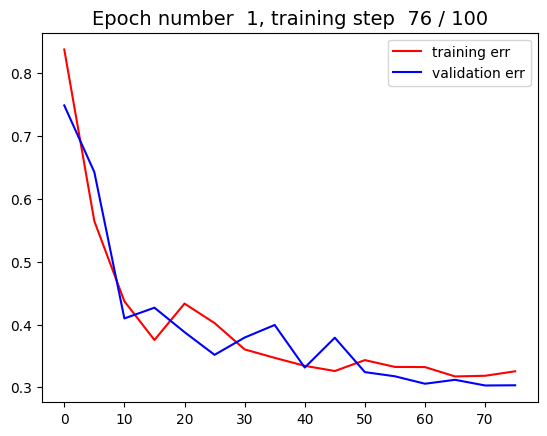

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  80.0 %
80
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80]
[0.8378922343254089, 0.564561128616333, 0.4369795322418213, 0.37532293796539307, 0.43328022956848145, 0.4022596776485443, 0.3603600263595581, 0.3469082713127136, 0.3342181146144867, 0.32594528794288635, 0.34331274032592773, 0.33245646953582764, 0.33218708634376526, 0.31731146574020386, 0.3183771073818207, 0.3254852890968323, 0.2951979637145996]
[0.7488358020782471, 0.6426639556884766, 0.4096433222293854, 0.4267587661743164, 0.38785502314567566, 0.3517073392868042, 0.37923166155815125, 0.3992237448692322, 0.331463098526001, 0.37897464632987976, 0.32419946789741516, 0.3175300657749176, 0.3056946098804474, 0.3119531571865082, 0.3029119074344635, 0.30321380496025085, 0.3257344365119934]


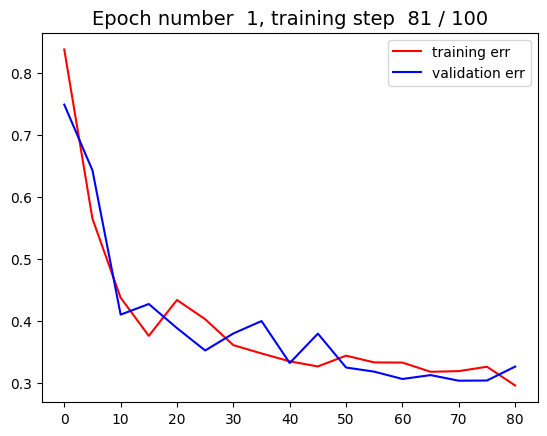

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  85.0 %
85
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85]
[0.8378922343254089, 0.564561128616333, 0.4369795322418213, 0.37532293796539307, 0.43328022956848145, 0.4022596776485443, 0.3603600263595581, 0.3469082713127136, 0.3342181146144867, 0.32594528794288635, 0.34331274032592773, 0.33245646953582764, 0.33218708634376526, 0.31731146574020386, 0.3183771073818207, 0.3254852890968323, 0.2951979637145996, 0.2954157888889313]
[0.7488358020782471, 0.6426639556884766, 0.4096433222293854, 0.4267587661743164, 0.38785502314567566, 0.3517073392868042, 0.37923166155815125, 0.3992237448692322, 0.331463098526001, 0.37897464632987976, 0.32419946789741516, 0.3175300657749176, 0.3056946098804474, 0.3119531571865082, 0.3029119074344635, 0.30321380496025085, 0.3257344365119934, 0.30995944142341614]


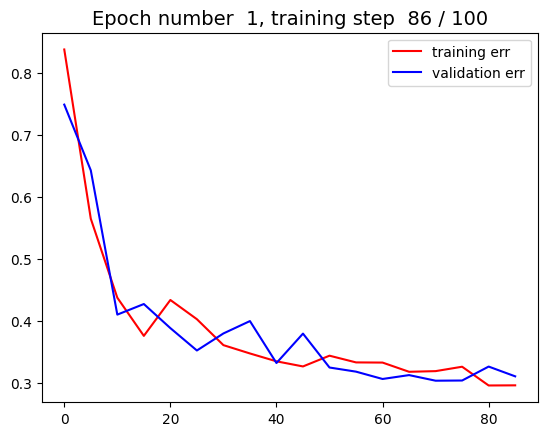

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  90.0 %
90
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90]
[0.8378922343254089, 0.564561128616333, 0.4369795322418213, 0.37532293796539307, 0.43328022956848145, 0.4022596776485443, 0.3603600263595581, 0.3469082713127136, 0.3342181146144867, 0.32594528794288635, 0.34331274032592773, 0.33245646953582764, 0.33218708634376526, 0.31731146574020386, 0.3183771073818207, 0.3254852890968323, 0.2951979637145996, 0.2954157888889313, 0.3311004340648651]
[0.7488358020782471, 0.6426639556884766, 0.4096433222293854, 0.4267587661743164, 0.38785502314567566, 0.3517073392868042, 0.37923166155815125, 0.3992237448692322, 0.331463098526001, 0.37897464632987976, 0.32419946789741516, 0.3175300657749176, 0.3056946098804474, 0.3119531571865082, 0.3029119074344635, 0.30321380496025085, 0.3257344365119934, 0.30995944142341614, 0.28357747197151184]


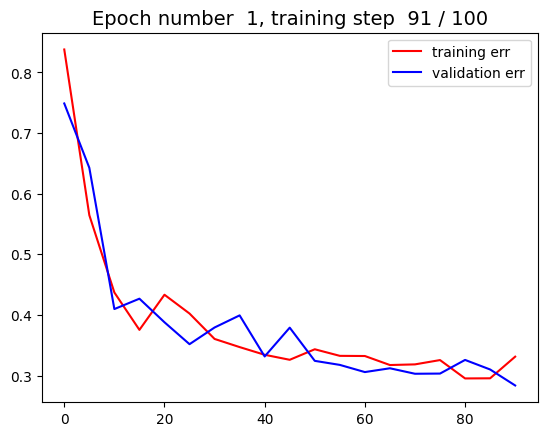

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  95.0 %
95
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95]
[0.8378922343254089, 0.564561128616333, 0.4369795322418213, 0.37532293796539307, 0.43328022956848145, 0.4022596776485443, 0.3603600263595581, 0.3469082713127136, 0.3342181146144867, 0.32594528794288635, 0.34331274032592773, 0.33245646953582764, 0.33218708634376526, 0.31731146574020386, 0.3183771073818207, 0.3254852890968323, 0.2951979637145996, 0.2954157888889313, 0.3311004340648651, 0.29329049587249756]
[0.7488358020782471, 0.6426639556884766, 0.4096433222293854, 0.4267587661743164, 0.38785502314567566, 0.3517073392868042, 0.37923166155815125, 0.3992237448692322, 0.331463098526001, 0.37897464632987976, 0.32419946789741516, 0.3175300657749176, 0.3056946098804474, 0.3119531571865082, 0.3029119074344635, 0.30321380496025085, 0.3257344365119934, 0.30995944142341614, 0.28357747197151184, 0.3207109570503

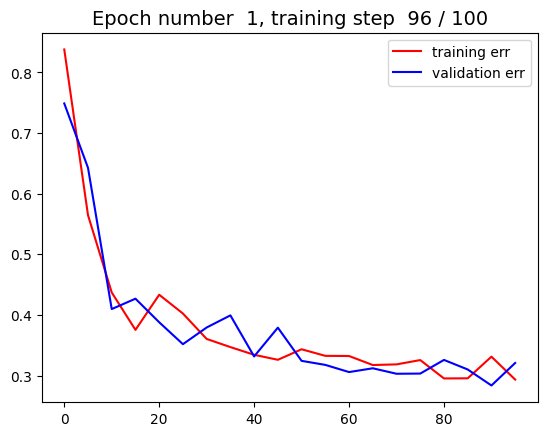

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  100.0 %
100
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
[0.8378922343254089, 0.564561128616333, 0.4369795322418213, 0.37532293796539307, 0.43328022956848145, 0.4022596776485443, 0.3603600263595581, 0.3469082713127136, 0.3342181146144867, 0.32594528794288635, 0.34331274032592773, 0.33245646953582764, 0.33218708634376526, 0.31731146574020386, 0.3183771073818207, 0.3254852890968323, 0.2951979637145996, 0.2954157888889313, 0.3311004340648651, 0.29329049587249756, 0.2908828556537628]
[0.7488358020782471, 0.6426639556884766, 0.4096433222293854, 0.4267587661743164, 0.38785502314567566, 0.3517073392868042, 0.37923166155815125, 0.3992237448692322, 0.331463098526001, 0.37897464632987976, 0.32419946789741516, 0.3175300657749176, 0.3056946098804474, 0.3119531571865082, 0.3029119074344635, 0.30321380496025085, 0.3257344365119934, 0.30995944142341614, 0.2835774

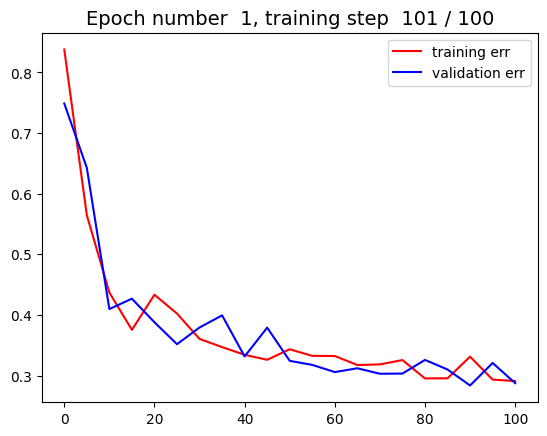

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  0.0 %
0
[0]
[0.2818353772163391]
[0.3017560839653015]


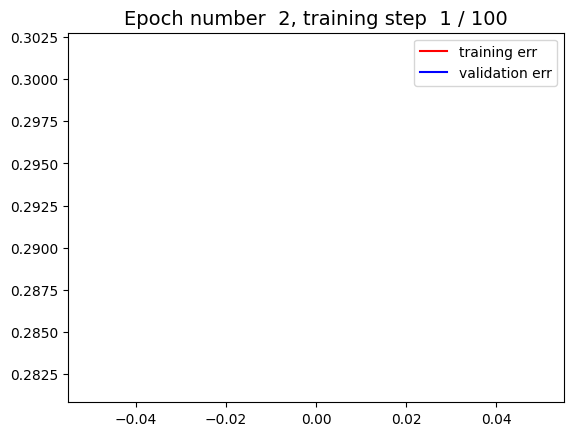

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  5.0 %
5
[0, 5]
[0.2818353772163391, 0.288451611995697]
[0.3017560839653015, 0.27709880471229553]


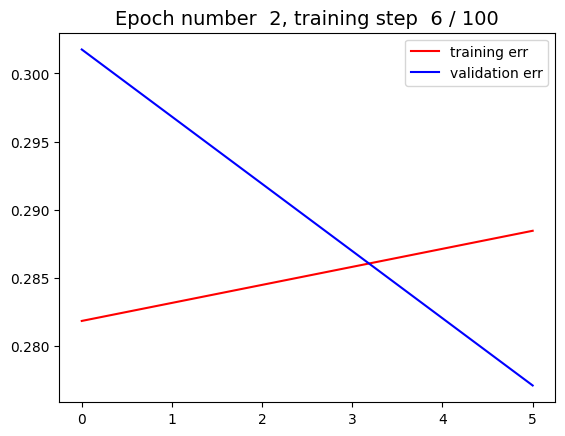

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  10.0 %
10
[0, 5, 10]
[0.2818353772163391, 0.288451611995697, 0.30689793825149536]
[0.3017560839653015, 0.27709880471229553, 0.27457424998283386]


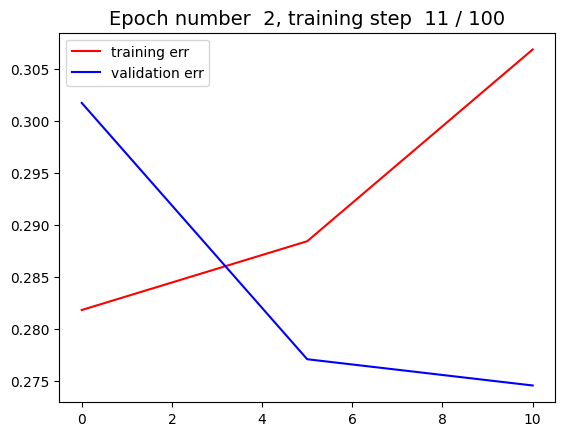

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  15.0 %
15
[0, 5, 10, 15]
[0.2818353772163391, 0.288451611995697, 0.30689793825149536, 0.28567439317703247]
[0.3017560839653015, 0.27709880471229553, 0.27457424998283386, 0.2808116376399994]


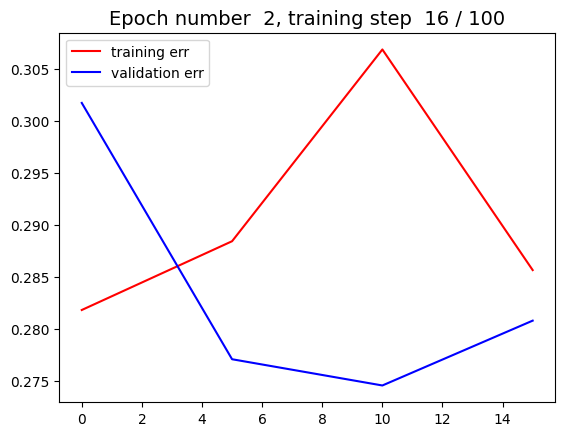

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  20.0 %
20
[0, 5, 10, 15, 20]
[0.2818353772163391, 0.288451611995697, 0.30689793825149536, 0.28567439317703247, 0.29178041219711304]
[0.3017560839653015, 0.27709880471229553, 0.27457424998283386, 0.2808116376399994, 0.2819734215736389]


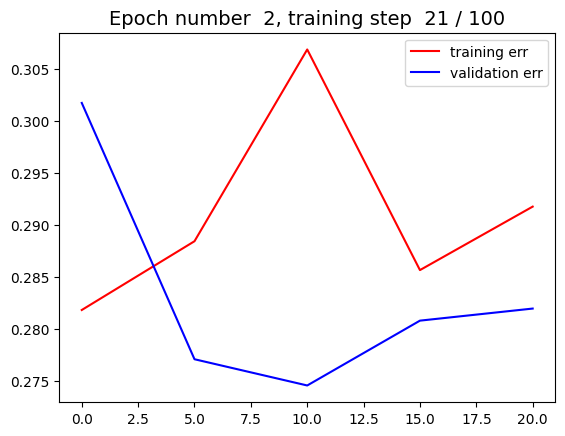

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  25.0 %
25
[0, 5, 10, 15, 20, 25]
[0.2818353772163391, 0.288451611995697, 0.30689793825149536, 0.28567439317703247, 0.29178041219711304, 0.27264609932899475]
[0.3017560839653015, 0.27709880471229553, 0.27457424998283386, 0.2808116376399994, 0.2819734215736389, 0.2941166162490845]


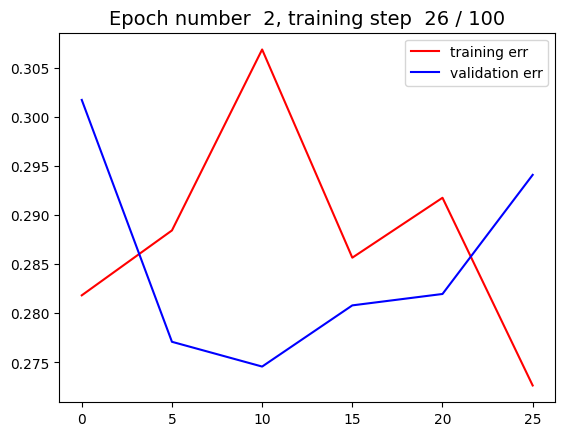

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  30.0 %
30
[0, 5, 10, 15, 20, 25, 30]
[0.2818353772163391, 0.288451611995697, 0.30689793825149536, 0.28567439317703247, 0.29178041219711304, 0.27264609932899475, 0.267351359128952]
[0.3017560839653015, 0.27709880471229553, 0.27457424998283386, 0.2808116376399994, 0.2819734215736389, 0.2941166162490845, 0.2769539952278137]


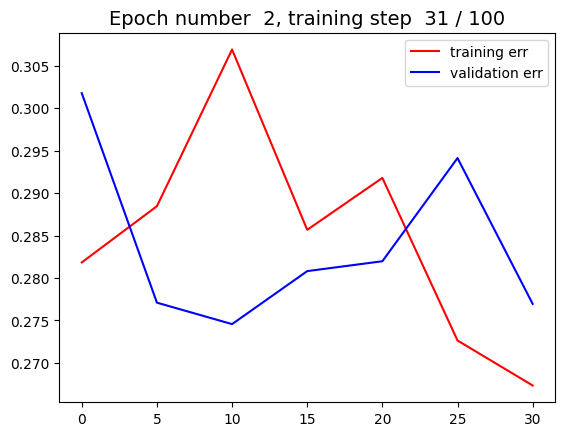

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  35.0 %
35
[0, 5, 10, 15, 20, 25, 30, 35]
[0.2818353772163391, 0.288451611995697, 0.30689793825149536, 0.28567439317703247, 0.29178041219711304, 0.27264609932899475, 0.267351359128952, 0.2844632565975189]
[0.3017560839653015, 0.27709880471229553, 0.27457424998283386, 0.2808116376399994, 0.2819734215736389, 0.2941166162490845, 0.2769539952278137, 0.28908494114875793]


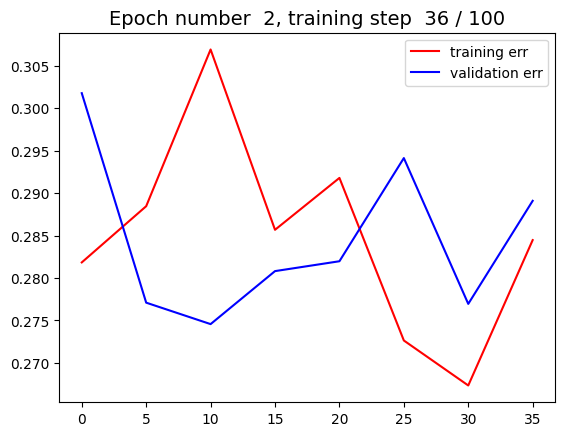

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  40.0 %
40
[0, 5, 10, 15, 20, 25, 30, 35, 40]
[0.2818353772163391, 0.288451611995697, 0.30689793825149536, 0.28567439317703247, 0.29178041219711304, 0.27264609932899475, 0.267351359128952, 0.2844632565975189, 0.27944624423980713]
[0.3017560839653015, 0.27709880471229553, 0.27457424998283386, 0.2808116376399994, 0.2819734215736389, 0.2941166162490845, 0.2769539952278137, 0.28908494114875793, 0.2899753749370575]


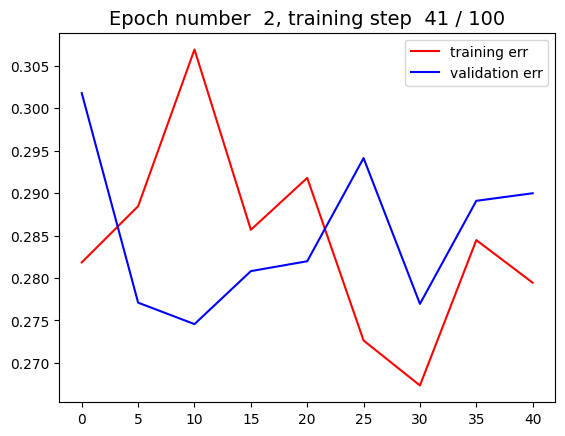

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  45.0 %
45
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
[0.2818353772163391, 0.288451611995697, 0.30689793825149536, 0.28567439317703247, 0.29178041219711304, 0.27264609932899475, 0.267351359128952, 0.2844632565975189, 0.27944624423980713, 0.27860432863235474]
[0.3017560839653015, 0.27709880471229553, 0.27457424998283386, 0.2808116376399994, 0.2819734215736389, 0.2941166162490845, 0.2769539952278137, 0.28908494114875793, 0.2899753749370575, 0.28347334265708923]


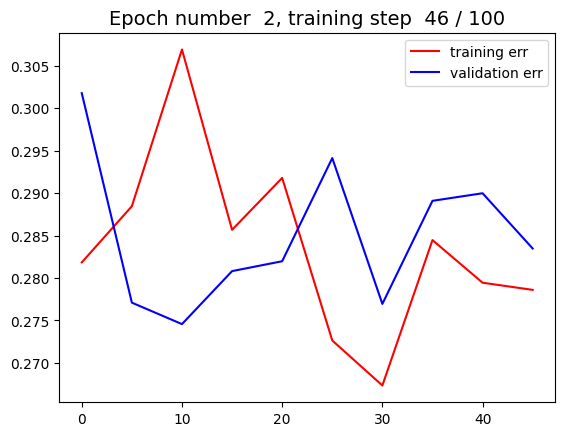

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  50.0 %
50
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]
[0.2818353772163391, 0.288451611995697, 0.30689793825149536, 0.28567439317703247, 0.29178041219711304, 0.27264609932899475, 0.267351359128952, 0.2844632565975189, 0.27944624423980713, 0.27860432863235474, 0.27049514651298523]
[0.3017560839653015, 0.27709880471229553, 0.27457424998283386, 0.2808116376399994, 0.2819734215736389, 0.2941166162490845, 0.2769539952278137, 0.28908494114875793, 0.2899753749370575, 0.28347334265708923, 0.28386759757995605]


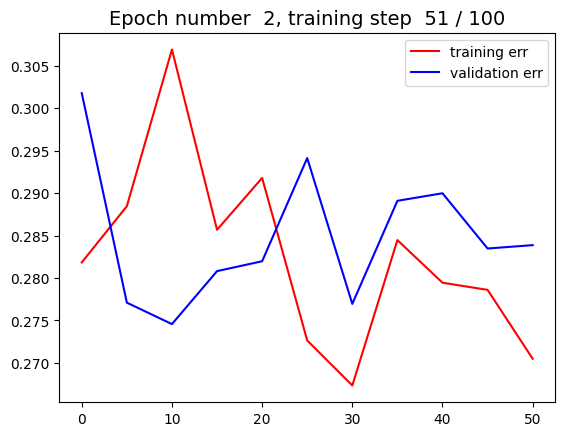

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  55.0 %
55
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55]
[0.2818353772163391, 0.288451611995697, 0.30689793825149536, 0.28567439317703247, 0.29178041219711304, 0.27264609932899475, 0.267351359128952, 0.2844632565975189, 0.27944624423980713, 0.27860432863235474, 0.27049514651298523, 0.25903934240341187]
[0.3017560839653015, 0.27709880471229553, 0.27457424998283386, 0.2808116376399994, 0.2819734215736389, 0.2941166162490845, 0.2769539952278137, 0.28908494114875793, 0.2899753749370575, 0.28347334265708923, 0.28386759757995605, 0.2645055651664734]


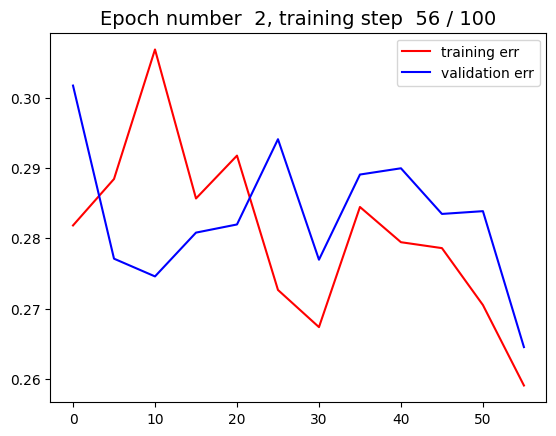

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  60.0 %
60
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]
[0.2818353772163391, 0.288451611995697, 0.30689793825149536, 0.28567439317703247, 0.29178041219711304, 0.27264609932899475, 0.267351359128952, 0.2844632565975189, 0.27944624423980713, 0.27860432863235474, 0.27049514651298523, 0.25903934240341187, 0.2594711482524872]
[0.3017560839653015, 0.27709880471229553, 0.27457424998283386, 0.2808116376399994, 0.2819734215736389, 0.2941166162490845, 0.2769539952278137, 0.28908494114875793, 0.2899753749370575, 0.28347334265708923, 0.28386759757995605, 0.2645055651664734, 0.27496206760406494]


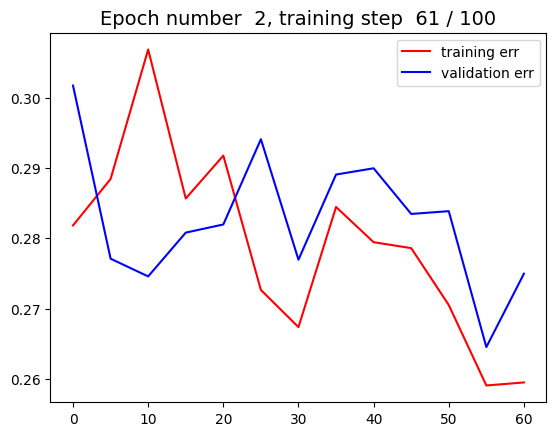

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  65.0 %
65
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65]
[0.2818353772163391, 0.288451611995697, 0.30689793825149536, 0.28567439317703247, 0.29178041219711304, 0.27264609932899475, 0.267351359128952, 0.2844632565975189, 0.27944624423980713, 0.27860432863235474, 0.27049514651298523, 0.25903934240341187, 0.2594711482524872, 0.25730064511299133]
[0.3017560839653015, 0.27709880471229553, 0.27457424998283386, 0.2808116376399994, 0.2819734215736389, 0.2941166162490845, 0.2769539952278137, 0.28908494114875793, 0.2899753749370575, 0.28347334265708923, 0.28386759757995605, 0.2645055651664734, 0.27496206760406494, 0.2485528141260147]


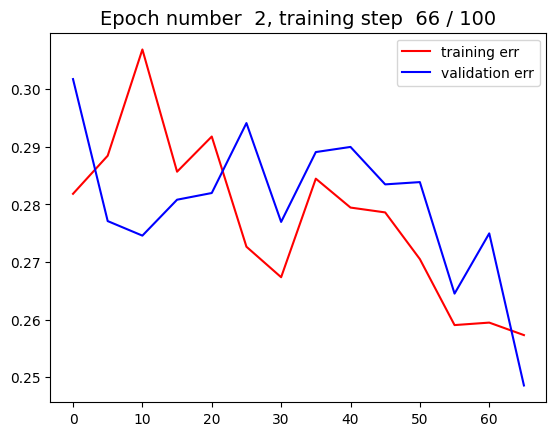

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  70.0 %
70
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70]
[0.2818353772163391, 0.288451611995697, 0.30689793825149536, 0.28567439317703247, 0.29178041219711304, 0.27264609932899475, 0.267351359128952, 0.2844632565975189, 0.27944624423980713, 0.27860432863235474, 0.27049514651298523, 0.25903934240341187, 0.2594711482524872, 0.25730064511299133, 0.2597143054008484]
[0.3017560839653015, 0.27709880471229553, 0.27457424998283386, 0.2808116376399994, 0.2819734215736389, 0.2941166162490845, 0.2769539952278137, 0.28908494114875793, 0.2899753749370575, 0.28347334265708923, 0.28386759757995605, 0.2645055651664734, 0.27496206760406494, 0.2485528141260147, 0.24804747104644775]


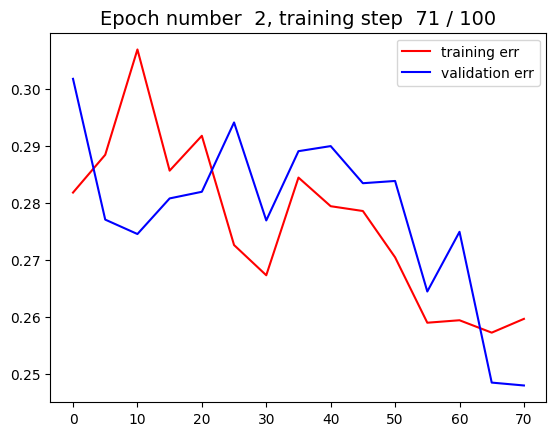

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  75.0 %
75
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75]
[0.2818353772163391, 0.288451611995697, 0.30689793825149536, 0.28567439317703247, 0.29178041219711304, 0.27264609932899475, 0.267351359128952, 0.2844632565975189, 0.27944624423980713, 0.27860432863235474, 0.27049514651298523, 0.25903934240341187, 0.2594711482524872, 0.25730064511299133, 0.2597143054008484, 0.24572452902793884]
[0.3017560839653015, 0.27709880471229553, 0.27457424998283386, 0.2808116376399994, 0.2819734215736389, 0.2941166162490845, 0.2769539952278137, 0.28908494114875793, 0.2899753749370575, 0.28347334265708923, 0.28386759757995605, 0.2645055651664734, 0.27496206760406494, 0.2485528141260147, 0.24804747104644775, 0.24192945659160614]


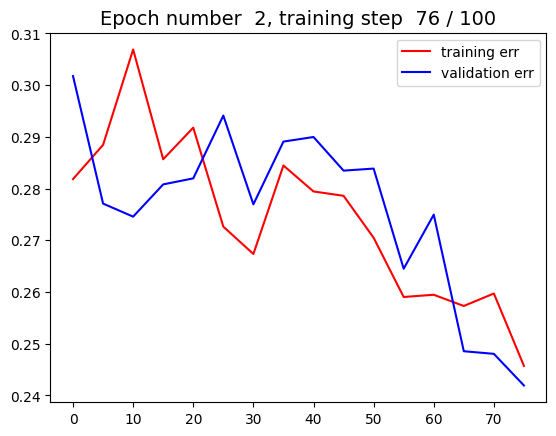

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  80.0 %
80
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80]
[0.2818353772163391, 0.288451611995697, 0.30689793825149536, 0.28567439317703247, 0.29178041219711304, 0.27264609932899475, 0.267351359128952, 0.2844632565975189, 0.27944624423980713, 0.27860432863235474, 0.27049514651298523, 0.25903934240341187, 0.2594711482524872, 0.25730064511299133, 0.2597143054008484, 0.24572452902793884, 0.25168028473854065]
[0.3017560839653015, 0.27709880471229553, 0.27457424998283386, 0.2808116376399994, 0.2819734215736389, 0.2941166162490845, 0.2769539952278137, 0.28908494114875793, 0.2899753749370575, 0.28347334265708923, 0.28386759757995605, 0.2645055651664734, 0.27496206760406494, 0.2485528141260147, 0.24804747104644775, 0.24192945659160614, 0.2987593412399292]


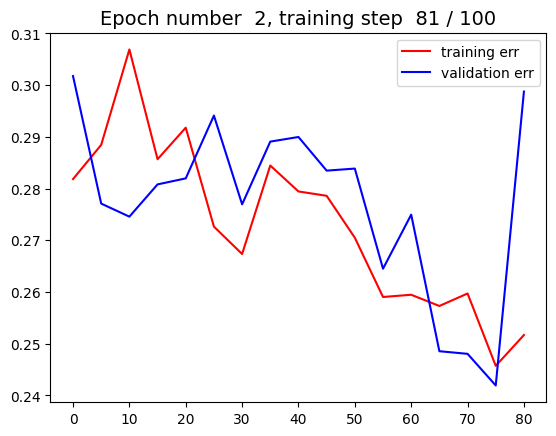

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  85.0 %
85
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85]
[0.2818353772163391, 0.288451611995697, 0.30689793825149536, 0.28567439317703247, 0.29178041219711304, 0.27264609932899475, 0.267351359128952, 0.2844632565975189, 0.27944624423980713, 0.27860432863235474, 0.27049514651298523, 0.25903934240341187, 0.2594711482524872, 0.25730064511299133, 0.2597143054008484, 0.24572452902793884, 0.25168028473854065, 0.24631531536579132]
[0.3017560839653015, 0.27709880471229553, 0.27457424998283386, 0.2808116376399994, 0.2819734215736389, 0.2941166162490845, 0.2769539952278137, 0.28908494114875793, 0.2899753749370575, 0.28347334265708923, 0.28386759757995605, 0.2645055651664734, 0.27496206760406494, 0.2485528141260147, 0.24804747104644775, 0.24192945659160614, 0.2987593412399292, 0.25316327810287476]


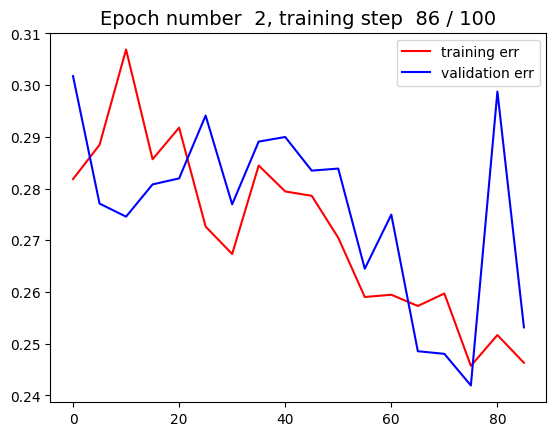

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  90.0 %
90
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90]
[0.2818353772163391, 0.288451611995697, 0.30689793825149536, 0.28567439317703247, 0.29178041219711304, 0.27264609932899475, 0.267351359128952, 0.2844632565975189, 0.27944624423980713, 0.27860432863235474, 0.27049514651298523, 0.25903934240341187, 0.2594711482524872, 0.25730064511299133, 0.2597143054008484, 0.24572452902793884, 0.25168028473854065, 0.24631531536579132, 0.24183572828769684]
[0.3017560839653015, 0.27709880471229553, 0.27457424998283386, 0.2808116376399994, 0.2819734215736389, 0.2941166162490845, 0.2769539952278137, 0.28908494114875793, 0.2899753749370575, 0.28347334265708923, 0.28386759757995605, 0.2645055651664734, 0.27496206760406494, 0.2485528141260147, 0.24804747104644775, 0.24192945659160614, 0.2987593412399292, 0.25316327810287476, 0.26642608642578125]


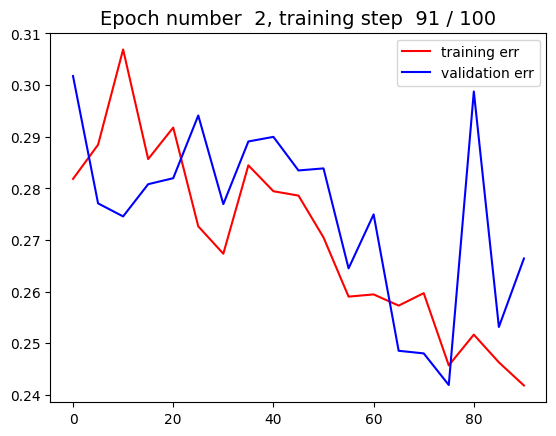

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  95.0 %
95
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95]
[0.2818353772163391, 0.288451611995697, 0.30689793825149536, 0.28567439317703247, 0.29178041219711304, 0.27264609932899475, 0.267351359128952, 0.2844632565975189, 0.27944624423980713, 0.27860432863235474, 0.27049514651298523, 0.25903934240341187, 0.2594711482524872, 0.25730064511299133, 0.2597143054008484, 0.24572452902793884, 0.25168028473854065, 0.24631531536579132, 0.24183572828769684, 0.37852704524993896]
[0.3017560839653015, 0.27709880471229553, 0.27457424998283386, 0.2808116376399994, 0.2819734215736389, 0.2941166162490845, 0.2769539952278137, 0.28908494114875793, 0.2899753749370575, 0.28347334265708923, 0.28386759757995605, 0.2645055651664734, 0.27496206760406494, 0.2485528141260147, 0.24804747104644775, 0.24192945659160614, 0.2987593412399292, 0.25316327810287476, 0.26642608642578125, 0.2386

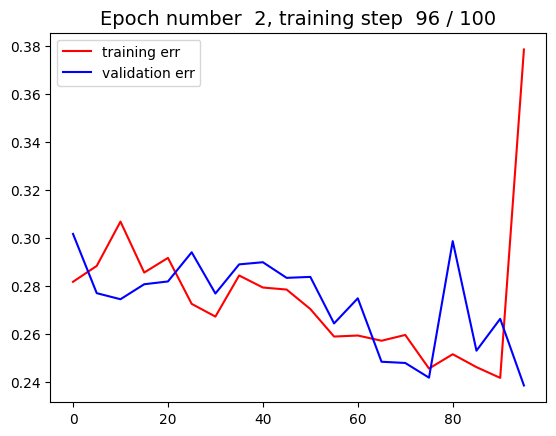

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  100.0 %
100
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
[0.2818353772163391, 0.288451611995697, 0.30689793825149536, 0.28567439317703247, 0.29178041219711304, 0.27264609932899475, 0.267351359128952, 0.2844632565975189, 0.27944624423980713, 0.27860432863235474, 0.27049514651298523, 0.25903934240341187, 0.2594711482524872, 0.25730064511299133, 0.2597143054008484, 0.24572452902793884, 0.25168028473854065, 0.24631531536579132, 0.24183572828769684, 0.37852704524993896, 0.2594755291938782]
[0.3017560839653015, 0.27709880471229553, 0.27457424998283386, 0.2808116376399994, 0.2819734215736389, 0.2941166162490845, 0.2769539952278137, 0.28908494114875793, 0.2899753749370575, 0.28347334265708923, 0.28386759757995605, 0.2645055651664734, 0.27496206760406494, 0.2485528141260147, 0.24804747104644775, 0.24192945659160614, 0.2987593412399292, 0.25316327810287476, 

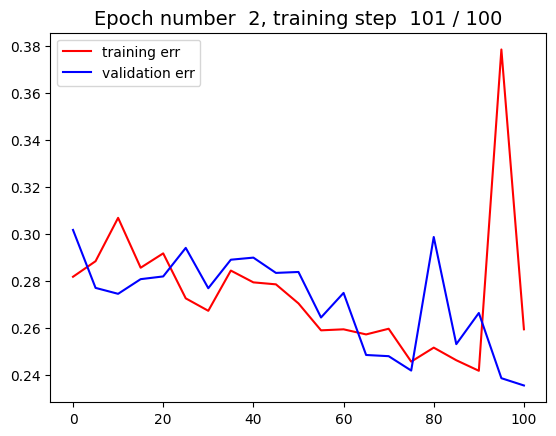

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  0.0 %
0
[0]
[0.2680568993091583]
[0.24674612283706665]


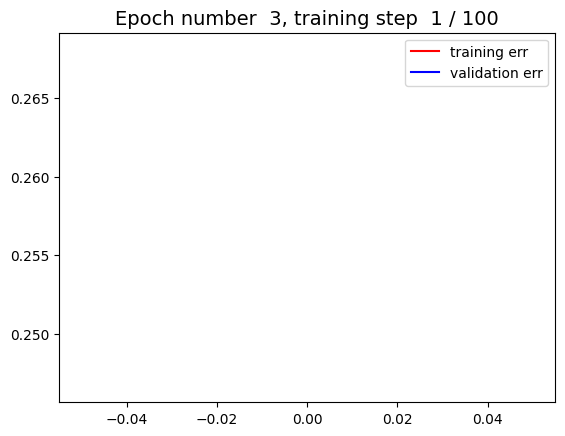

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  5.0 %
5
[0, 5]
[0.2680568993091583, 0.23823986947536469]
[0.24674612283706665, 0.23486919701099396]


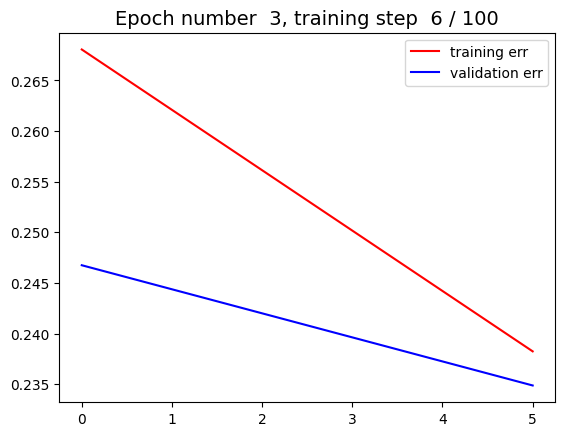

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  10.0 %
10
[0, 5, 10]
[0.2680568993091583, 0.23823986947536469, 0.23224245011806488]
[0.24674612283706665, 0.23486919701099396, 0.24296189844608307]


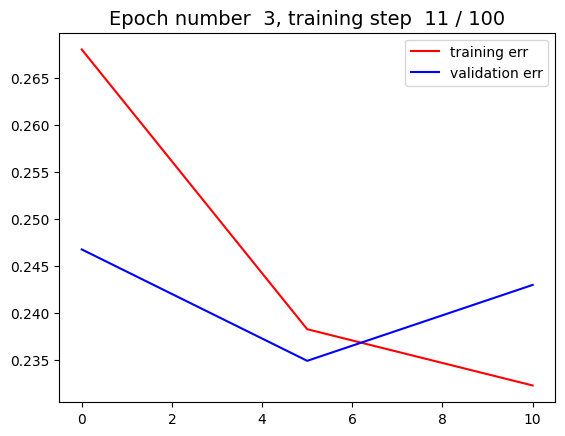

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  15.0 %
15
[0, 5, 10, 15]
[0.2680568993091583, 0.23823986947536469, 0.23224245011806488, 0.3211318850517273]
[0.24674612283706665, 0.23486919701099396, 0.24296189844608307, 0.2509654760360718]


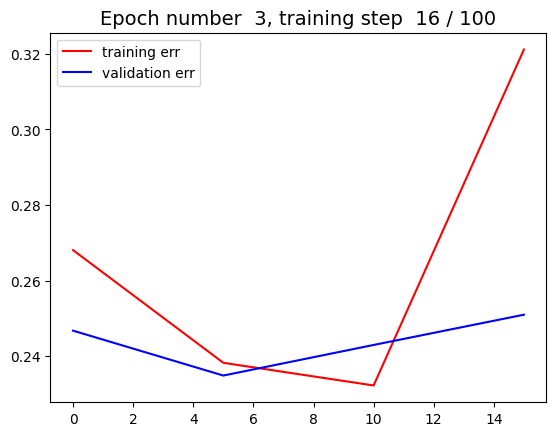

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  20.0 %
20
[0, 5, 10, 15, 20]
[0.2680568993091583, 0.23823986947536469, 0.23224245011806488, 0.3211318850517273, 0.23959632217884064]
[0.24674612283706665, 0.23486919701099396, 0.24296189844608307, 0.2509654760360718, 0.24173346161842346]


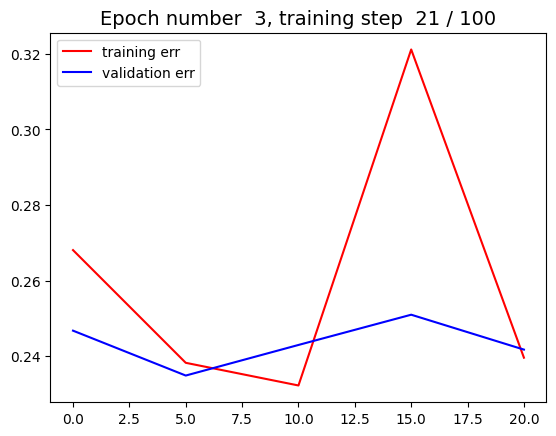

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  25.0 %
25
[0, 5, 10, 15, 20, 25]
[0.2680568993091583, 0.23823986947536469, 0.23224245011806488, 0.3211318850517273, 0.23959632217884064, 0.23833708465099335]
[0.24674612283706665, 0.23486919701099396, 0.24296189844608307, 0.2509654760360718, 0.24173346161842346, 0.23227627575397491]


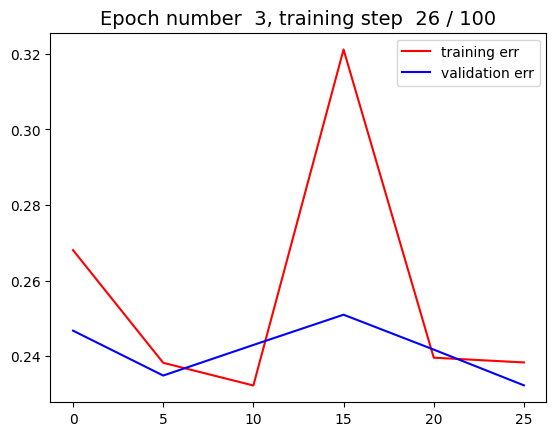

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  30.0 %
30
[0, 5, 10, 15, 20, 25, 30]
[0.2680568993091583, 0.23823986947536469, 0.23224245011806488, 0.3211318850517273, 0.23959632217884064, 0.23833708465099335, 0.25912031531333923]
[0.24674612283706665, 0.23486919701099396, 0.24296189844608307, 0.2509654760360718, 0.24173346161842346, 0.23227627575397491, 0.2543364465236664]


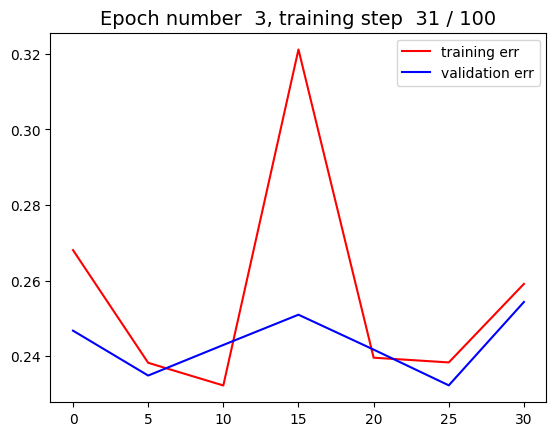

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  35.0 %
35
[0, 5, 10, 15, 20, 25, 30, 35]
[0.2680568993091583, 0.23823986947536469, 0.23224245011806488, 0.3211318850517273, 0.23959632217884064, 0.23833708465099335, 0.25912031531333923, 0.3053230345249176]
[0.24674612283706665, 0.23486919701099396, 0.24296189844608307, 0.2509654760360718, 0.24173346161842346, 0.23227627575397491, 0.2543364465236664, 0.3325371742248535]


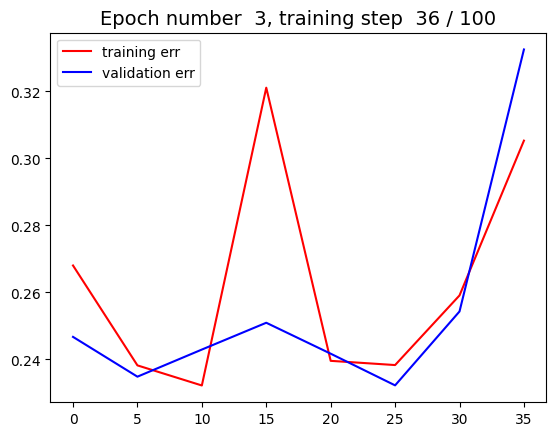

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  40.0 %
40
[0, 5, 10, 15, 20, 25, 30, 35, 40]
[0.2680568993091583, 0.23823986947536469, 0.23224245011806488, 0.3211318850517273, 0.23959632217884064, 0.23833708465099335, 0.25912031531333923, 0.3053230345249176, 0.42199933528900146]
[0.24674612283706665, 0.23486919701099396, 0.24296189844608307, 0.2509654760360718, 0.24173346161842346, 0.23227627575397491, 0.2543364465236664, 0.3325371742248535, 0.2574741244316101]


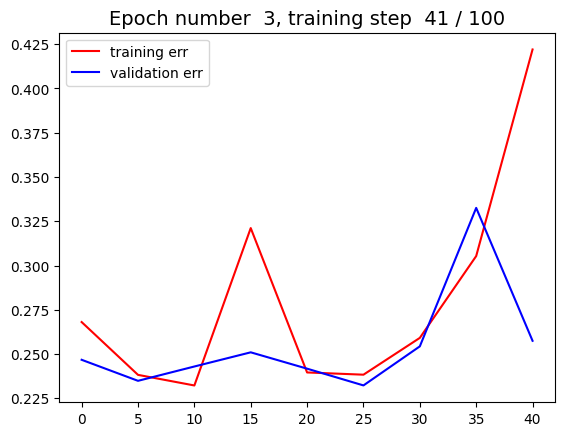

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  45.0 %
45
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
[0.2680568993091583, 0.23823986947536469, 0.23224245011806488, 0.3211318850517273, 0.23959632217884064, 0.23833708465099335, 0.25912031531333923, 0.3053230345249176, 0.42199933528900146, 0.2223839908838272]
[0.24674612283706665, 0.23486919701099396, 0.24296189844608307, 0.2509654760360718, 0.24173346161842346, 0.23227627575397491, 0.2543364465236664, 0.3325371742248535, 0.2574741244316101, 0.2252427637577057]


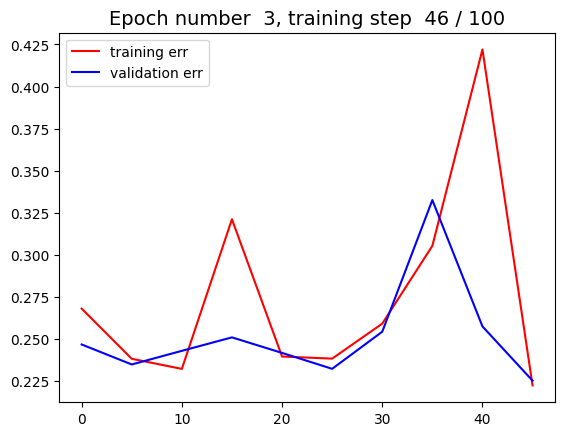

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  50.0 %
50
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]
[0.2680568993091583, 0.23823986947536469, 0.23224245011806488, 0.3211318850517273, 0.23959632217884064, 0.23833708465099335, 0.25912031531333923, 0.3053230345249176, 0.42199933528900146, 0.2223839908838272, 0.23214778304100037]
[0.24674612283706665, 0.23486919701099396, 0.24296189844608307, 0.2509654760360718, 0.24173346161842346, 0.23227627575397491, 0.2543364465236664, 0.3325371742248535, 0.2574741244316101, 0.2252427637577057, 0.24211850762367249]


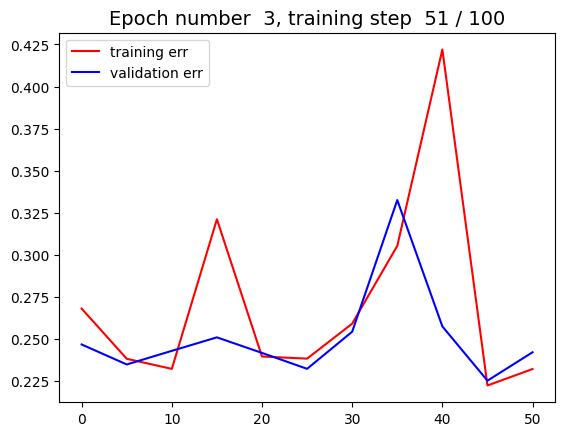

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  55.0 %
55
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55]
[0.2680568993091583, 0.23823986947536469, 0.23224245011806488, 0.3211318850517273, 0.23959632217884064, 0.23833708465099335, 0.25912031531333923, 0.3053230345249176, 0.42199933528900146, 0.2223839908838272, 0.23214778304100037, 0.2382773905992508]
[0.24674612283706665, 0.23486919701099396, 0.24296189844608307, 0.2509654760360718, 0.24173346161842346, 0.23227627575397491, 0.2543364465236664, 0.3325371742248535, 0.2574741244316101, 0.2252427637577057, 0.24211850762367249, 0.26521724462509155]


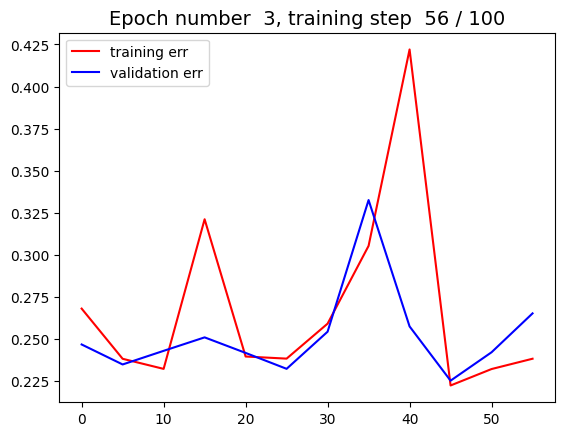

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  60.0 %
60
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]
[0.2680568993091583, 0.23823986947536469, 0.23224245011806488, 0.3211318850517273, 0.23959632217884064, 0.23833708465099335, 0.25912031531333923, 0.3053230345249176, 0.42199933528900146, 0.2223839908838272, 0.23214778304100037, 0.2382773905992508, 0.23742124438285828]
[0.24674612283706665, 0.23486919701099396, 0.24296189844608307, 0.2509654760360718, 0.24173346161842346, 0.23227627575397491, 0.2543364465236664, 0.3325371742248535, 0.2574741244316101, 0.2252427637577057, 0.24211850762367249, 0.26521724462509155, 0.2558339238166809]


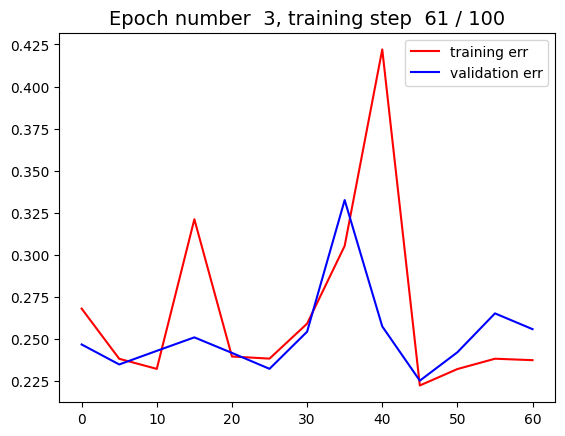

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  65.0 %
65
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65]
[0.2680568993091583, 0.23823986947536469, 0.23224245011806488, 0.3211318850517273, 0.23959632217884064, 0.23833708465099335, 0.25912031531333923, 0.3053230345249176, 0.42199933528900146, 0.2223839908838272, 0.23214778304100037, 0.2382773905992508, 0.23742124438285828, 0.2693902254104614]
[0.24674612283706665, 0.23486919701099396, 0.24296189844608307, 0.2509654760360718, 0.24173346161842346, 0.23227627575397491, 0.2543364465236664, 0.3325371742248535, 0.2574741244316101, 0.2252427637577057, 0.24211850762367249, 0.26521724462509155, 0.2558339238166809, 0.22124169766902924]


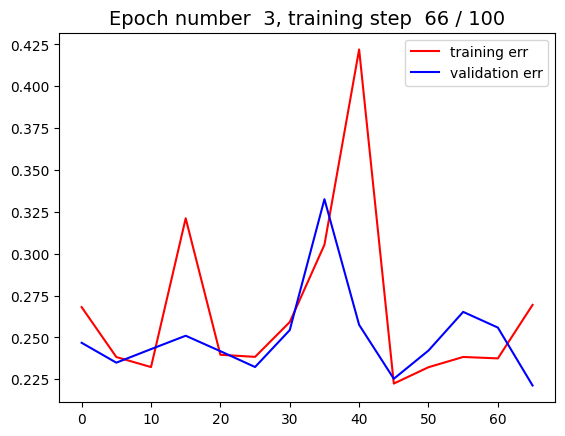

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  70.0 %
70
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70]
[0.2680568993091583, 0.23823986947536469, 0.23224245011806488, 0.3211318850517273, 0.23959632217884064, 0.23833708465099335, 0.25912031531333923, 0.3053230345249176, 0.42199933528900146, 0.2223839908838272, 0.23214778304100037, 0.2382773905992508, 0.23742124438285828, 0.2693902254104614, 0.24654492735862732]
[0.24674612283706665, 0.23486919701099396, 0.24296189844608307, 0.2509654760360718, 0.24173346161842346, 0.23227627575397491, 0.2543364465236664, 0.3325371742248535, 0.2574741244316101, 0.2252427637577057, 0.24211850762367249, 0.26521724462509155, 0.2558339238166809, 0.22124169766902924, 0.2729127109050751]


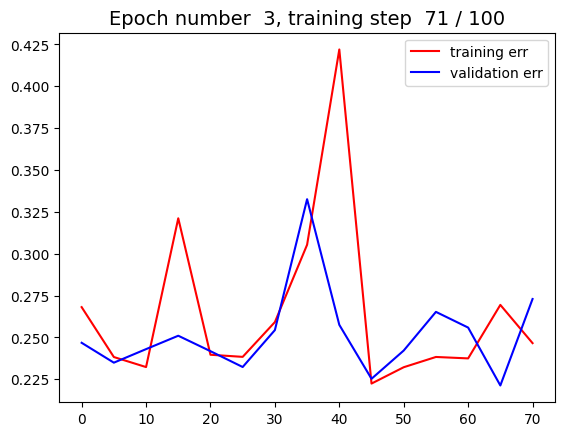

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  75.0 %
75
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75]
[0.2680568993091583, 0.23823986947536469, 0.23224245011806488, 0.3211318850517273, 0.23959632217884064, 0.23833708465099335, 0.25912031531333923, 0.3053230345249176, 0.42199933528900146, 0.2223839908838272, 0.23214778304100037, 0.2382773905992508, 0.23742124438285828, 0.2693902254104614, 0.24654492735862732, 0.2202393114566803]
[0.24674612283706665, 0.23486919701099396, 0.24296189844608307, 0.2509654760360718, 0.24173346161842346, 0.23227627575397491, 0.2543364465236664, 0.3325371742248535, 0.2574741244316101, 0.2252427637577057, 0.24211850762367249, 0.26521724462509155, 0.2558339238166809, 0.22124169766902924, 0.2729127109050751, 0.24938438832759857]


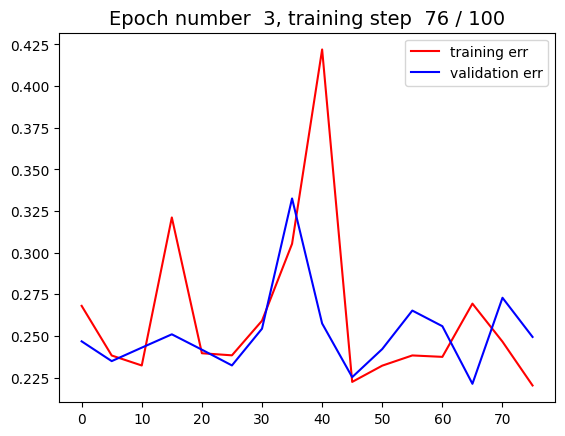

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  80.0 %
80
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80]
[0.2680568993091583, 0.23823986947536469, 0.23224245011806488, 0.3211318850517273, 0.23959632217884064, 0.23833708465099335, 0.25912031531333923, 0.3053230345249176, 0.42199933528900146, 0.2223839908838272, 0.23214778304100037, 0.2382773905992508, 0.23742124438285828, 0.2693902254104614, 0.24654492735862732, 0.2202393114566803, 0.22793786227703094]
[0.24674612283706665, 0.23486919701099396, 0.24296189844608307, 0.2509654760360718, 0.24173346161842346, 0.23227627575397491, 0.2543364465236664, 0.3325371742248535, 0.2574741244316101, 0.2252427637577057, 0.24211850762367249, 0.26521724462509155, 0.2558339238166809, 0.22124169766902924, 0.2729127109050751, 0.24938438832759857, 0.26330918073654175]


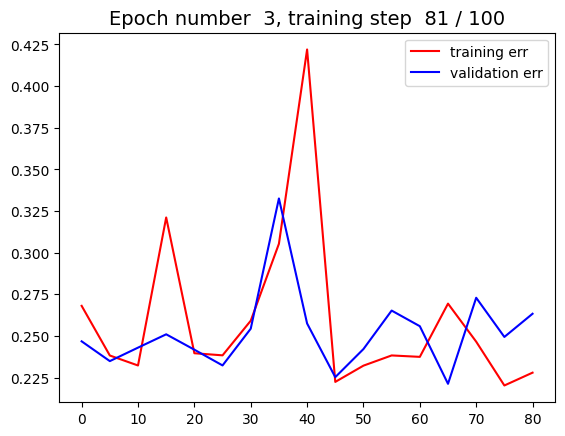

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  85.0 %
85
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85]
[0.2680568993091583, 0.23823986947536469, 0.23224245011806488, 0.3211318850517273, 0.23959632217884064, 0.23833708465099335, 0.25912031531333923, 0.3053230345249176, 0.42199933528900146, 0.2223839908838272, 0.23214778304100037, 0.2382773905992508, 0.23742124438285828, 0.2693902254104614, 0.24654492735862732, 0.2202393114566803, 0.22793786227703094, 0.23463669419288635]
[0.24674612283706665, 0.23486919701099396, 0.24296189844608307, 0.2509654760360718, 0.24173346161842346, 0.23227627575397491, 0.2543364465236664, 0.3325371742248535, 0.2574741244316101, 0.2252427637577057, 0.24211850762367249, 0.26521724462509155, 0.2558339238166809, 0.22124169766902924, 0.2729127109050751, 0.24938438832759857, 0.26330918073654175, 0.2543083131313324]


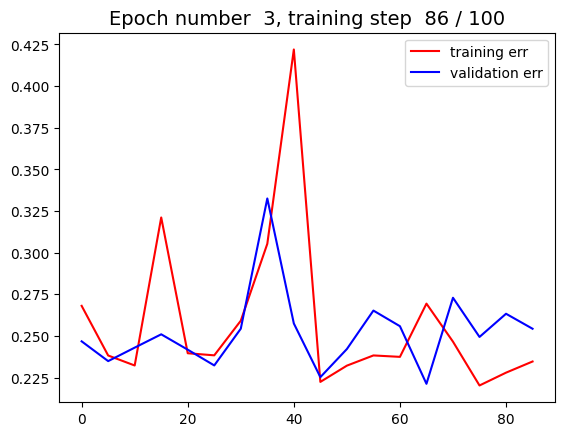

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  90.0 %
90
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90]
[0.2680568993091583, 0.23823986947536469, 0.23224245011806488, 0.3211318850517273, 0.23959632217884064, 0.23833708465099335, 0.25912031531333923, 0.3053230345249176, 0.42199933528900146, 0.2223839908838272, 0.23214778304100037, 0.2382773905992508, 0.23742124438285828, 0.2693902254104614, 0.24654492735862732, 0.2202393114566803, 0.22793786227703094, 0.23463669419288635, 0.2186364382505417]
[0.24674612283706665, 0.23486919701099396, 0.24296189844608307, 0.2509654760360718, 0.24173346161842346, 0.23227627575397491, 0.2543364465236664, 0.3325371742248535, 0.2574741244316101, 0.2252427637577057, 0.24211850762367249, 0.26521724462509155, 0.2558339238166809, 0.22124169766902924, 0.2729127109050751, 0.24938438832759857, 0.26330918073654175, 0.2543083131313324, 0.23450124263763428]


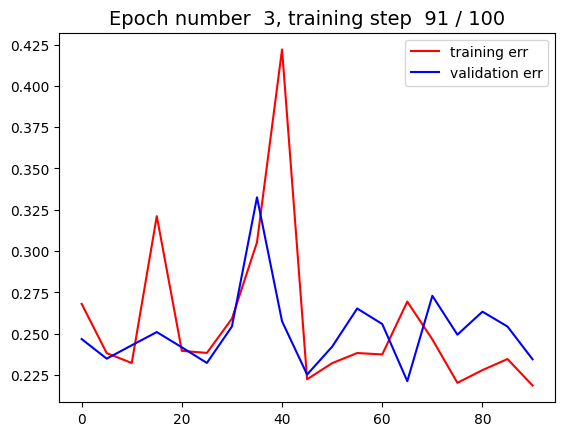

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  95.0 %
95
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95]
[0.2680568993091583, 0.23823986947536469, 0.23224245011806488, 0.3211318850517273, 0.23959632217884064, 0.23833708465099335, 0.25912031531333923, 0.3053230345249176, 0.42199933528900146, 0.2223839908838272, 0.23214778304100037, 0.2382773905992508, 0.23742124438285828, 0.2693902254104614, 0.24654492735862732, 0.2202393114566803, 0.22793786227703094, 0.23463669419288635, 0.2186364382505417, 0.20612677931785583]
[0.24674612283706665, 0.23486919701099396, 0.24296189844608307, 0.2509654760360718, 0.24173346161842346, 0.23227627575397491, 0.2543364465236664, 0.3325371742248535, 0.2574741244316101, 0.2252427637577057, 0.24211850762367249, 0.26521724462509155, 0.2558339238166809, 0.22124169766902924, 0.2729127109050751, 0.24938438832759857, 0.26330918073654175, 0.2543083131313324, 0.23450124263763428, 0.218

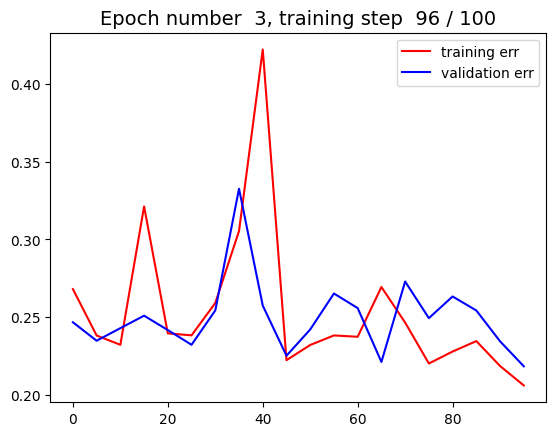

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  100.0 %
100
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
[0.2680568993091583, 0.23823986947536469, 0.23224245011806488, 0.3211318850517273, 0.23959632217884064, 0.23833708465099335, 0.25912031531333923, 0.3053230345249176, 0.42199933528900146, 0.2223839908838272, 0.23214778304100037, 0.2382773905992508, 0.23742124438285828, 0.2693902254104614, 0.24654492735862732, 0.2202393114566803, 0.22793786227703094, 0.23463669419288635, 0.2186364382505417, 0.20612677931785583, 0.20515026152133942]
[0.24674612283706665, 0.23486919701099396, 0.24296189844608307, 0.2509654760360718, 0.24173346161842346, 0.23227627575397491, 0.2543364465236664, 0.3325371742248535, 0.2574741244316101, 0.2252427637577057, 0.24211850762367249, 0.26521724462509155, 0.2558339238166809, 0.22124169766902924, 0.2729127109050751, 0.24938438832759857, 0.26330918073654175, 0.2543083131313324

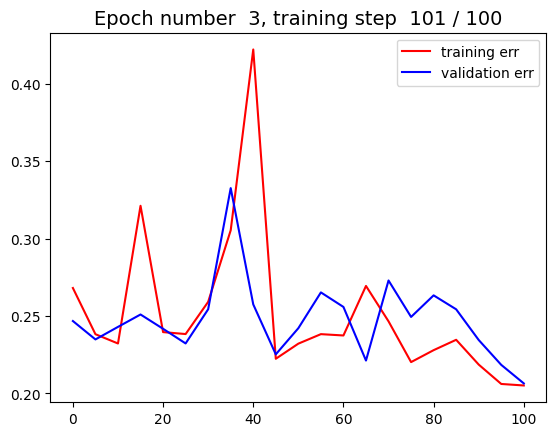

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  0.0 %
0
[0]
[0.23305726051330566]
[0.23319654166698456]


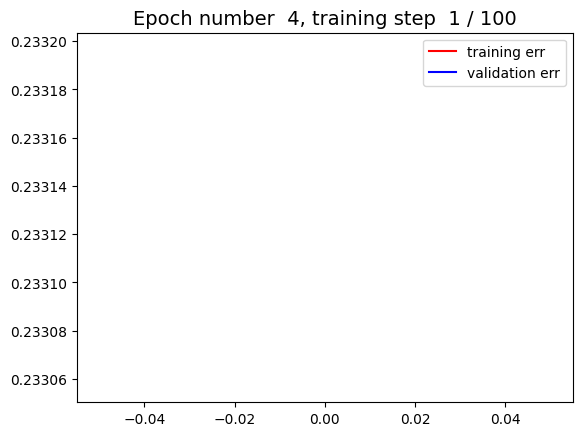

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  5.0 %
5
[0, 5]
[0.23305726051330566, 0.20917198061943054]
[0.23319654166698456, 0.25712254643440247]


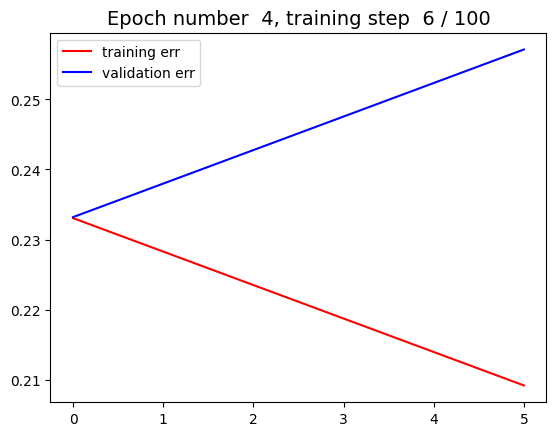

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  10.0 %
10
[0, 5, 10]
[0.23305726051330566, 0.20917198061943054, 0.24382330477237701]
[0.23319654166698456, 0.25712254643440247, 0.27166086435317993]


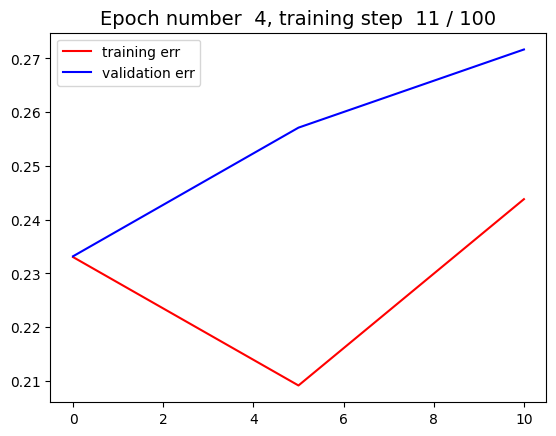

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  15.0 %
15
[0, 5, 10, 15]
[0.23305726051330566, 0.20917198061943054, 0.24382330477237701, 0.20649020373821259]
[0.23319654166698456, 0.25712254643440247, 0.27166086435317993, 0.25672173500061035]


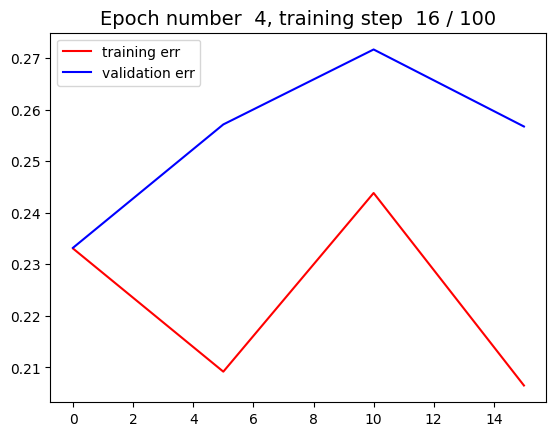

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  20.0 %
20
[0, 5, 10, 15, 20]
[0.23305726051330566, 0.20917198061943054, 0.24382330477237701, 0.20649020373821259, 0.19921976327896118]
[0.23319654166698456, 0.25712254643440247, 0.27166086435317993, 0.25672173500061035, 0.22813279926776886]


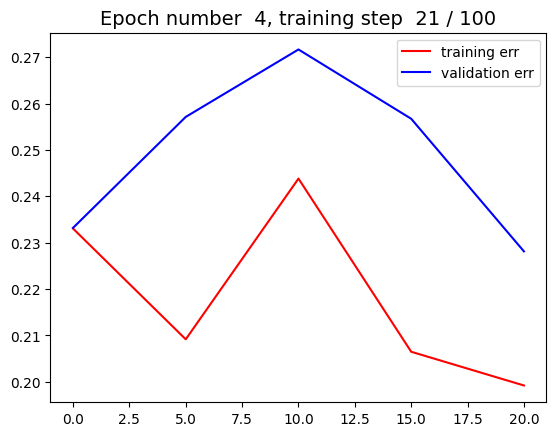

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  25.0 %
25
[0, 5, 10, 15, 20, 25]
[0.23305726051330566, 0.20917198061943054, 0.24382330477237701, 0.20649020373821259, 0.19921976327896118, 0.2398277223110199]
[0.23319654166698456, 0.25712254643440247, 0.27166086435317993, 0.25672173500061035, 0.22813279926776886, 0.31845617294311523]


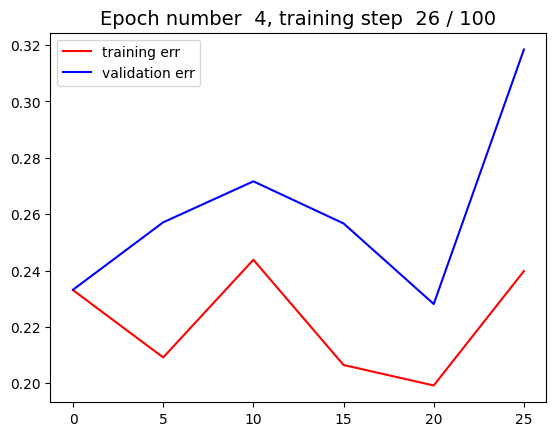

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  30.0 %
30
[0, 5, 10, 15, 20, 25, 30]
[0.23305726051330566, 0.20917198061943054, 0.24382330477237701, 0.20649020373821259, 0.19921976327896118, 0.2398277223110199, 0.265431672334671]
[0.23319654166698456, 0.25712254643440247, 0.27166086435317993, 0.25672173500061035, 0.22813279926776886, 0.31845617294311523, 0.21735961735248566]


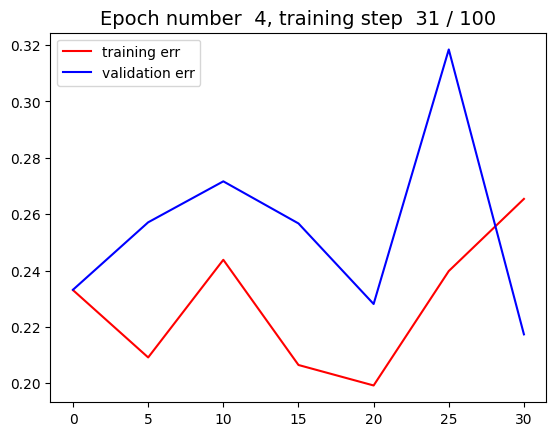

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  35.0 %
35
[0, 5, 10, 15, 20, 25, 30, 35]
[0.23305726051330566, 0.20917198061943054, 0.24382330477237701, 0.20649020373821259, 0.19921976327896118, 0.2398277223110199, 0.265431672334671, 0.20406034588813782]
[0.23319654166698456, 0.25712254643440247, 0.27166086435317993, 0.25672173500061035, 0.22813279926776886, 0.31845617294311523, 0.21735961735248566, 0.2058851569890976]


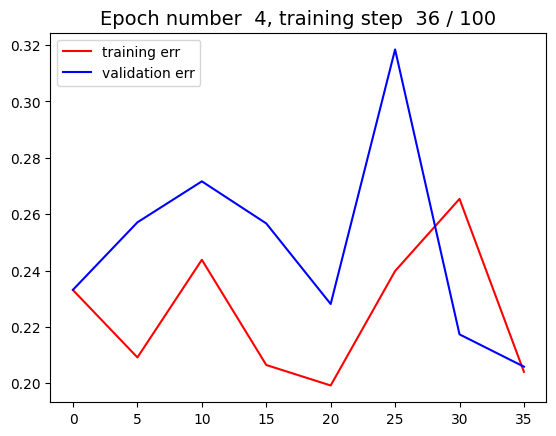

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  40.0 %
40
[0, 5, 10, 15, 20, 25, 30, 35, 40]
[0.23305726051330566, 0.20917198061943054, 0.24382330477237701, 0.20649020373821259, 0.19921976327896118, 0.2398277223110199, 0.265431672334671, 0.20406034588813782, 0.23692303895950317]
[0.23319654166698456, 0.25712254643440247, 0.27166086435317993, 0.25672173500061035, 0.22813279926776886, 0.31845617294311523, 0.21735961735248566, 0.2058851569890976, 0.24319791793823242]


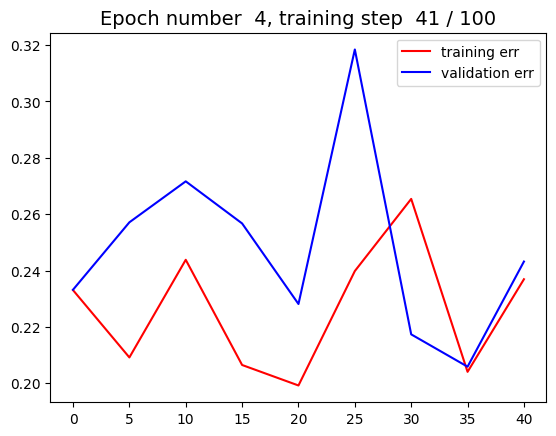

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  45.0 %
45
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
[0.23305726051330566, 0.20917198061943054, 0.24382330477237701, 0.20649020373821259, 0.19921976327896118, 0.2398277223110199, 0.265431672334671, 0.20406034588813782, 0.23692303895950317, 0.2960927188396454]
[0.23319654166698456, 0.25712254643440247, 0.27166086435317993, 0.25672173500061035, 0.22813279926776886, 0.31845617294311523, 0.21735961735248566, 0.2058851569890976, 0.24319791793823242, 0.20301787555217743]


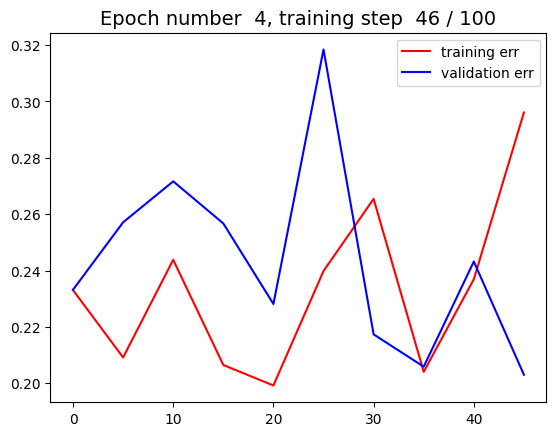

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  50.0 %
50
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]
[0.23305726051330566, 0.20917198061943054, 0.24382330477237701, 0.20649020373821259, 0.19921976327896118, 0.2398277223110199, 0.265431672334671, 0.20406034588813782, 0.23692303895950317, 0.2960927188396454, 0.20050320029258728]
[0.23319654166698456, 0.25712254643440247, 0.27166086435317993, 0.25672173500061035, 0.22813279926776886, 0.31845617294311523, 0.21735961735248566, 0.2058851569890976, 0.24319791793823242, 0.20301787555217743, 0.19345727562904358]


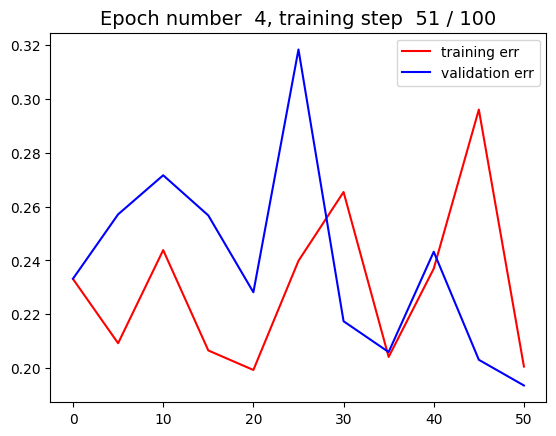

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  55.0 %
55
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55]
[0.23305726051330566, 0.20917198061943054, 0.24382330477237701, 0.20649020373821259, 0.19921976327896118, 0.2398277223110199, 0.265431672334671, 0.20406034588813782, 0.23692303895950317, 0.2960927188396454, 0.20050320029258728, 0.21008524298667908]
[0.23319654166698456, 0.25712254643440247, 0.27166086435317993, 0.25672173500061035, 0.22813279926776886, 0.31845617294311523, 0.21735961735248566, 0.2058851569890976, 0.24319791793823242, 0.20301787555217743, 0.19345727562904358, 0.19113317131996155]


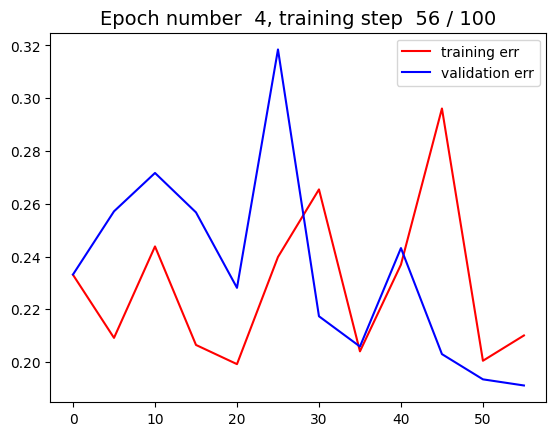

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  60.0 %
60
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]
[0.23305726051330566, 0.20917198061943054, 0.24382330477237701, 0.20649020373821259, 0.19921976327896118, 0.2398277223110199, 0.265431672334671, 0.20406034588813782, 0.23692303895950317, 0.2960927188396454, 0.20050320029258728, 0.21008524298667908, 0.1965850293636322]
[0.23319654166698456, 0.25712254643440247, 0.27166086435317993, 0.25672173500061035, 0.22813279926776886, 0.31845617294311523, 0.21735961735248566, 0.2058851569890976, 0.24319791793823242, 0.20301787555217743, 0.19345727562904358, 0.19113317131996155, 0.22341103851795197]


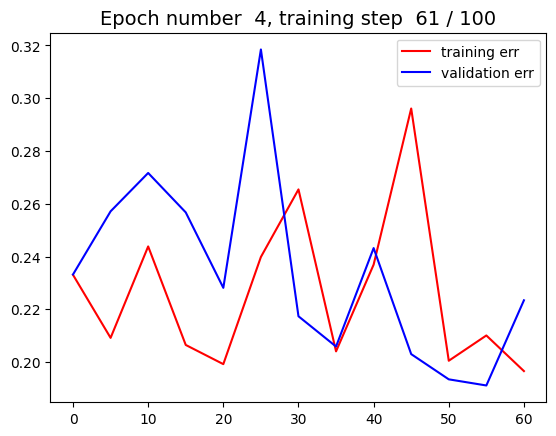

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  65.0 %
65
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65]
[0.23305726051330566, 0.20917198061943054, 0.24382330477237701, 0.20649020373821259, 0.19921976327896118, 0.2398277223110199, 0.265431672334671, 0.20406034588813782, 0.23692303895950317, 0.2960927188396454, 0.20050320029258728, 0.21008524298667908, 0.1965850293636322, 0.21539314091205597]
[0.23319654166698456, 0.25712254643440247, 0.27166086435317993, 0.25672173500061035, 0.22813279926776886, 0.31845617294311523, 0.21735961735248566, 0.2058851569890976, 0.24319791793823242, 0.20301787555217743, 0.19345727562904358, 0.19113317131996155, 0.22341103851795197, 0.23093630373477936]


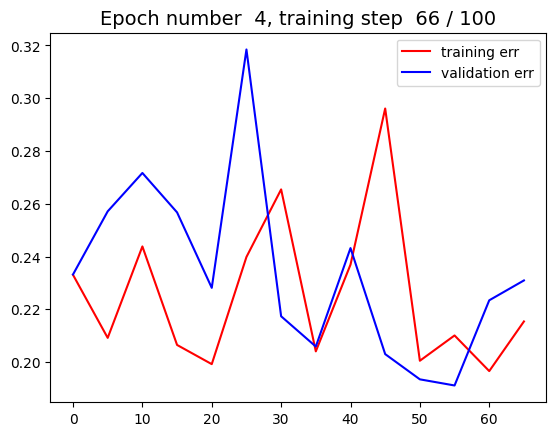

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  70.0 %
70
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70]
[0.23305726051330566, 0.20917198061943054, 0.24382330477237701, 0.20649020373821259, 0.19921976327896118, 0.2398277223110199, 0.265431672334671, 0.20406034588813782, 0.23692303895950317, 0.2960927188396454, 0.20050320029258728, 0.21008524298667908, 0.1965850293636322, 0.21539314091205597, 0.18881258368492126]
[0.23319654166698456, 0.25712254643440247, 0.27166086435317993, 0.25672173500061035, 0.22813279926776886, 0.31845617294311523, 0.21735961735248566, 0.2058851569890976, 0.24319791793823242, 0.20301787555217743, 0.19345727562904358, 0.19113317131996155, 0.22341103851795197, 0.23093630373477936, 0.2284451127052307]


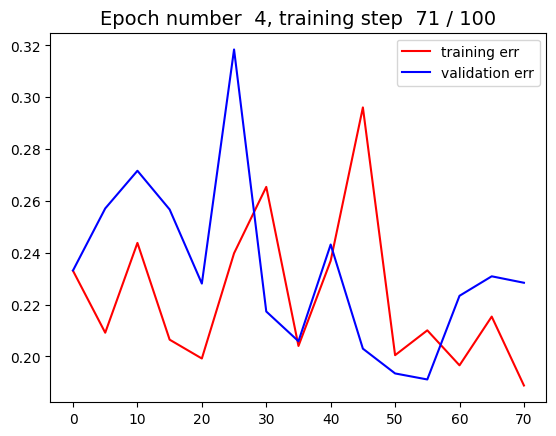

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  75.0 %
75
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75]
[0.23305726051330566, 0.20917198061943054, 0.24382330477237701, 0.20649020373821259, 0.19921976327896118, 0.2398277223110199, 0.265431672334671, 0.20406034588813782, 0.23692303895950317, 0.2960927188396454, 0.20050320029258728, 0.21008524298667908, 0.1965850293636322, 0.21539314091205597, 0.18881258368492126, 0.24927130341529846]
[0.23319654166698456, 0.25712254643440247, 0.27166086435317993, 0.25672173500061035, 0.22813279926776886, 0.31845617294311523, 0.21735961735248566, 0.2058851569890976, 0.24319791793823242, 0.20301787555217743, 0.19345727562904358, 0.19113317131996155, 0.22341103851795197, 0.23093630373477936, 0.2284451127052307, 0.20414012670516968]


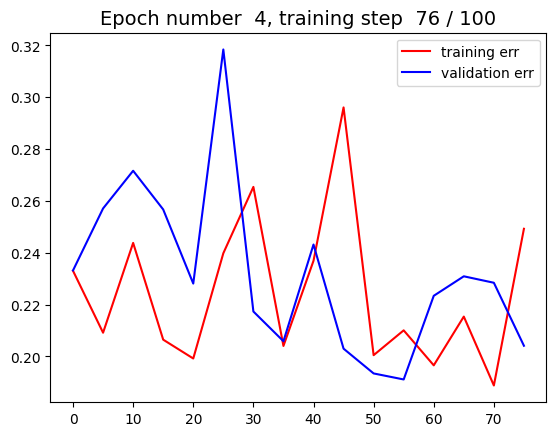

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  80.0 %
80
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80]
[0.23305726051330566, 0.20917198061943054, 0.24382330477237701, 0.20649020373821259, 0.19921976327896118, 0.2398277223110199, 0.265431672334671, 0.20406034588813782, 0.23692303895950317, 0.2960927188396454, 0.20050320029258728, 0.21008524298667908, 0.1965850293636322, 0.21539314091205597, 0.18881258368492126, 0.24927130341529846, 0.24330566823482513]
[0.23319654166698456, 0.25712254643440247, 0.27166086435317993, 0.25672173500061035, 0.22813279926776886, 0.31845617294311523, 0.21735961735248566, 0.2058851569890976, 0.24319791793823242, 0.20301787555217743, 0.19345727562904358, 0.19113317131996155, 0.22341103851795197, 0.23093630373477936, 0.2284451127052307, 0.20414012670516968, 0.18465086817741394]


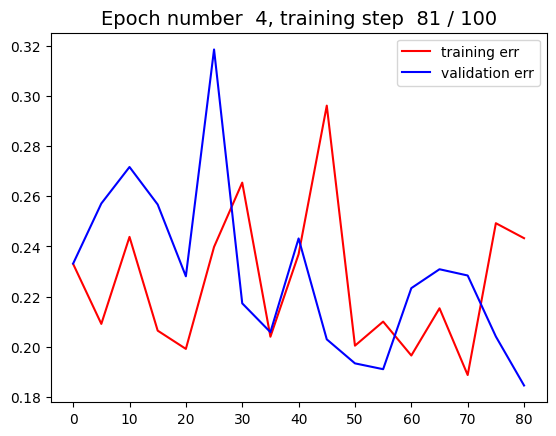

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  85.0 %
85
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85]
[0.23305726051330566, 0.20917198061943054, 0.24382330477237701, 0.20649020373821259, 0.19921976327896118, 0.2398277223110199, 0.265431672334671, 0.20406034588813782, 0.23692303895950317, 0.2960927188396454, 0.20050320029258728, 0.21008524298667908, 0.1965850293636322, 0.21539314091205597, 0.18881258368492126, 0.24927130341529846, 0.24330566823482513, 0.2334212064743042]
[0.23319654166698456, 0.25712254643440247, 0.27166086435317993, 0.25672173500061035, 0.22813279926776886, 0.31845617294311523, 0.21735961735248566, 0.2058851569890976, 0.24319791793823242, 0.20301787555217743, 0.19345727562904358, 0.19113317131996155, 0.22341103851795197, 0.23093630373477936, 0.2284451127052307, 0.20414012670516968, 0.18465086817741394, 0.18339918553829193]


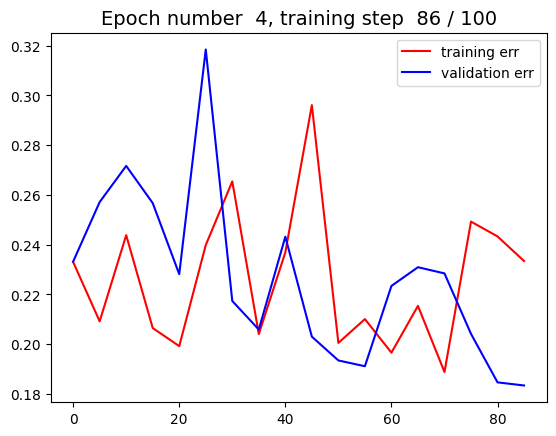

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  90.0 %
90
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90]
[0.23305726051330566, 0.20917198061943054, 0.24382330477237701, 0.20649020373821259, 0.19921976327896118, 0.2398277223110199, 0.265431672334671, 0.20406034588813782, 0.23692303895950317, 0.2960927188396454, 0.20050320029258728, 0.21008524298667908, 0.1965850293636322, 0.21539314091205597, 0.18881258368492126, 0.24927130341529846, 0.24330566823482513, 0.2334212064743042, 0.20865018665790558]
[0.23319654166698456, 0.25712254643440247, 0.27166086435317993, 0.25672173500061035, 0.22813279926776886, 0.31845617294311523, 0.21735961735248566, 0.2058851569890976, 0.24319791793823242, 0.20301787555217743, 0.19345727562904358, 0.19113317131996155, 0.22341103851795197, 0.23093630373477936, 0.2284451127052307, 0.20414012670516968, 0.18465086817741394, 0.18339918553829193, 0.21845649182796478]


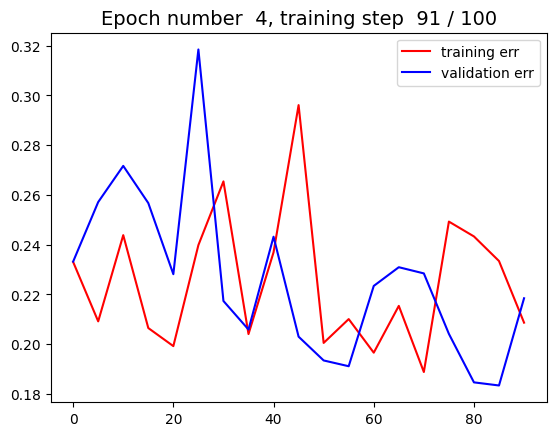

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  95.0 %
95
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95]
[0.23305726051330566, 0.20917198061943054, 0.24382330477237701, 0.20649020373821259, 0.19921976327896118, 0.2398277223110199, 0.265431672334671, 0.20406034588813782, 0.23692303895950317, 0.2960927188396454, 0.20050320029258728, 0.21008524298667908, 0.1965850293636322, 0.21539314091205597, 0.18881258368492126, 0.24927130341529846, 0.24330566823482513, 0.2334212064743042, 0.20865018665790558, 0.2077672779560089]
[0.23319654166698456, 0.25712254643440247, 0.27166086435317993, 0.25672173500061035, 0.22813279926776886, 0.31845617294311523, 0.21735961735248566, 0.2058851569890976, 0.24319791793823242, 0.20301787555217743, 0.19345727562904358, 0.19113317131996155, 0.22341103851795197, 0.23093630373477936, 0.2284451127052307, 0.20414012670516968, 0.18465086817741394, 0.18339918553829193, 0.21845649182796478

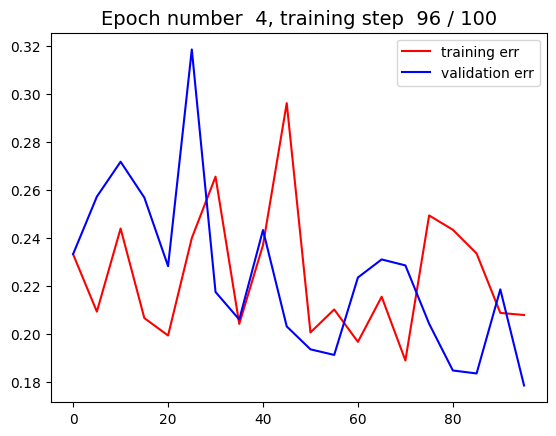

--------------------------------------------
Epoch number =  4 . Percentage of training completed =  100.0 %
100
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
[0.23305726051330566, 0.20917198061943054, 0.24382330477237701, 0.20649020373821259, 0.19921976327896118, 0.2398277223110199, 0.265431672334671, 0.20406034588813782, 0.23692303895950317, 0.2960927188396454, 0.20050320029258728, 0.21008524298667908, 0.1965850293636322, 0.21539314091205597, 0.18881258368492126, 0.24927130341529846, 0.24330566823482513, 0.2334212064743042, 0.20865018665790558, 0.2077672779560089, 0.22792278230190277]
[0.23319654166698456, 0.25712254643440247, 0.27166086435317993, 0.25672173500061035, 0.22813279926776886, 0.31845617294311523, 0.21735961735248566, 0.2058851569890976, 0.24319791793823242, 0.20301787555217743, 0.19345727562904358, 0.19113317131996155, 0.22341103851795197, 0.23093630373477936, 0.2284451127052307, 0.20414012670516968, 0.18465086817741394, 0.1833991855

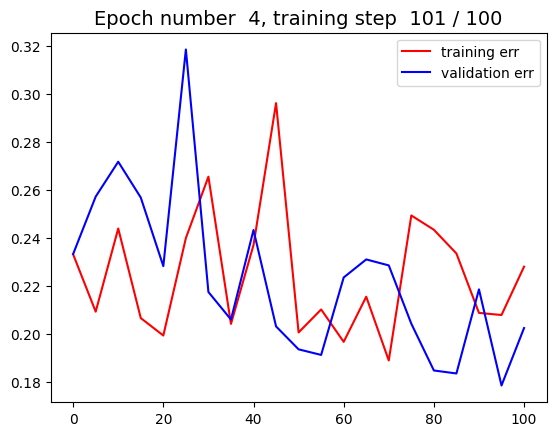

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  0.0 %
0
[0]
[0.1760350614786148]
[0.1825474500656128]


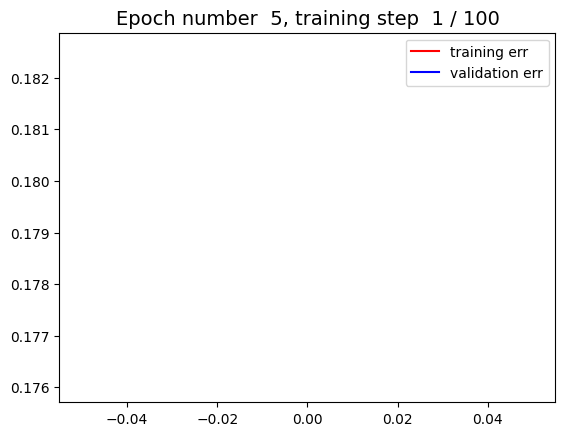

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  5.0 %
5
[0, 5]
[0.1760350614786148, 0.2863881587982178]
[0.1825474500656128, 0.1937890201807022]


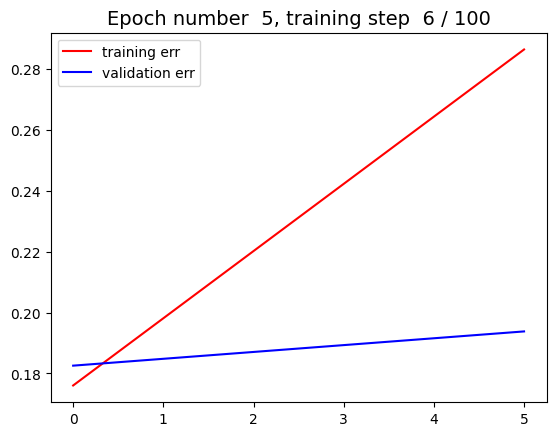

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  10.0 %
10
[0, 5, 10]
[0.1760350614786148, 0.2863881587982178, 0.178361713886261]
[0.1825474500656128, 0.1937890201807022, 0.22014755010604858]


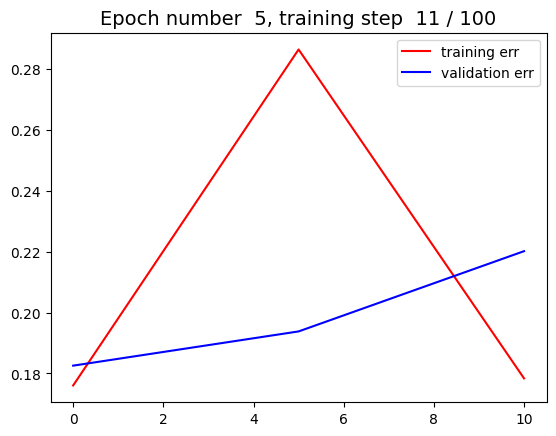

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  15.0 %
15
[0, 5, 10, 15]
[0.1760350614786148, 0.2863881587982178, 0.178361713886261, 0.2122851312160492]
[0.1825474500656128, 0.1937890201807022, 0.22014755010604858, 0.1809832900762558]


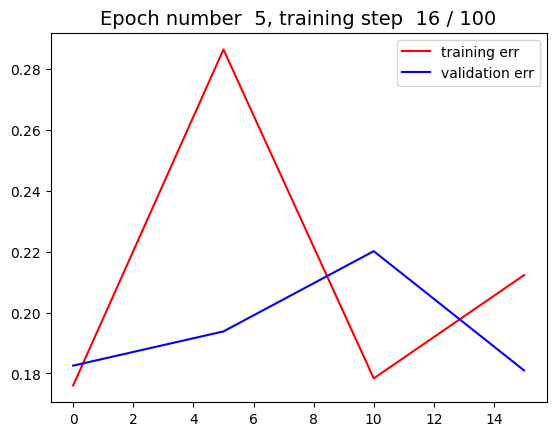

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  20.0 %
20
[0, 5, 10, 15, 20]
[0.1760350614786148, 0.2863881587982178, 0.178361713886261, 0.2122851312160492, 0.17457008361816406]
[0.1825474500656128, 0.1937890201807022, 0.22014755010604858, 0.1809832900762558, 0.19050271809101105]


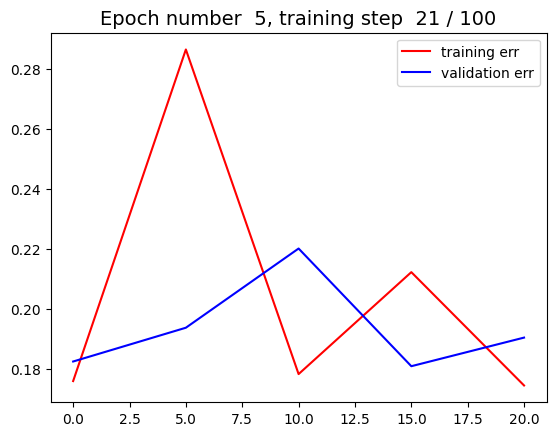

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  25.0 %
25
[0, 5, 10, 15, 20, 25]
[0.1760350614786148, 0.2863881587982178, 0.178361713886261, 0.2122851312160492, 0.17457008361816406, 0.19433602690696716]
[0.1825474500656128, 0.1937890201807022, 0.22014755010604858, 0.1809832900762558, 0.19050271809101105, 0.18147368729114532]


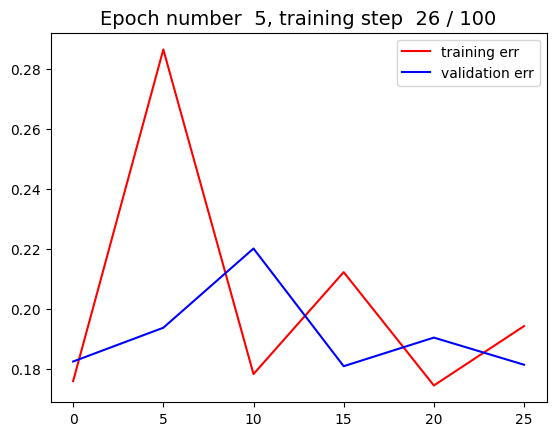

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  30.0 %
30
[0, 5, 10, 15, 20, 25, 30]
[0.1760350614786148, 0.2863881587982178, 0.178361713886261, 0.2122851312160492, 0.17457008361816406, 0.19433602690696716, 0.17006582021713257]
[0.1825474500656128, 0.1937890201807022, 0.22014755010604858, 0.1809832900762558, 0.19050271809101105, 0.18147368729114532, 0.18441015481948853]


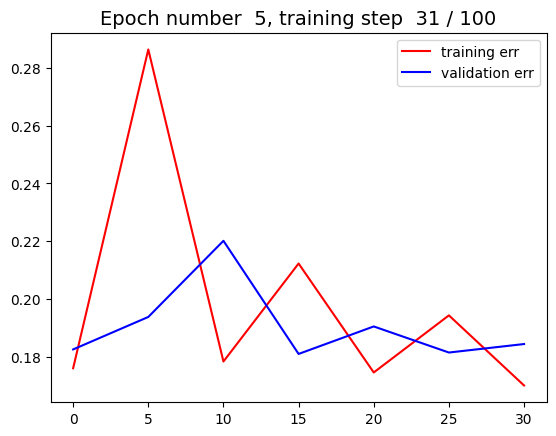

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  35.0 %
35
[0, 5, 10, 15, 20, 25, 30, 35]
[0.1760350614786148, 0.2863881587982178, 0.178361713886261, 0.2122851312160492, 0.17457008361816406, 0.19433602690696716, 0.17006582021713257, 0.20799484848976135]
[0.1825474500656128, 0.1937890201807022, 0.22014755010604858, 0.1809832900762558, 0.19050271809101105, 0.18147368729114532, 0.18441015481948853, 0.20446249842643738]


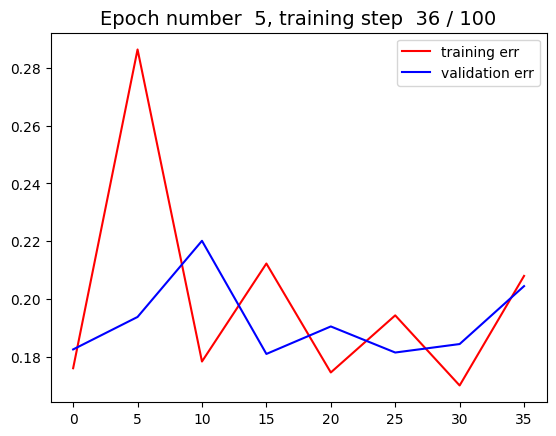

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  40.0 %
40
[0, 5, 10, 15, 20, 25, 30, 35, 40]
[0.1760350614786148, 0.2863881587982178, 0.178361713886261, 0.2122851312160492, 0.17457008361816406, 0.19433602690696716, 0.17006582021713257, 0.20799484848976135, 0.17726466059684753]
[0.1825474500656128, 0.1937890201807022, 0.22014755010604858, 0.1809832900762558, 0.19050271809101105, 0.18147368729114532, 0.18441015481948853, 0.20446249842643738, 0.19971932470798492]


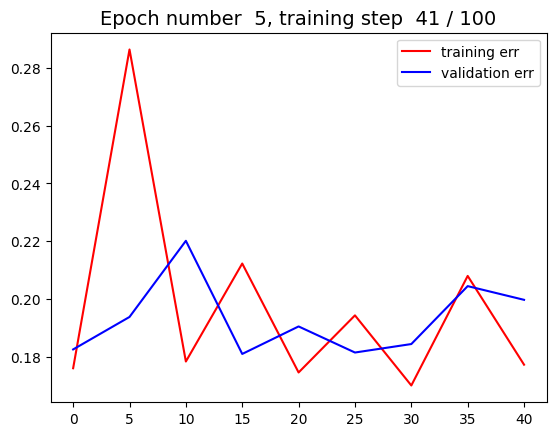

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  45.0 %
45
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
[0.1760350614786148, 0.2863881587982178, 0.178361713886261, 0.2122851312160492, 0.17457008361816406, 0.19433602690696716, 0.17006582021713257, 0.20799484848976135, 0.17726466059684753, 0.21457111835479736]
[0.1825474500656128, 0.1937890201807022, 0.22014755010604858, 0.1809832900762558, 0.19050271809101105, 0.18147368729114532, 0.18441015481948853, 0.20446249842643738, 0.19971932470798492, 0.17245393991470337]


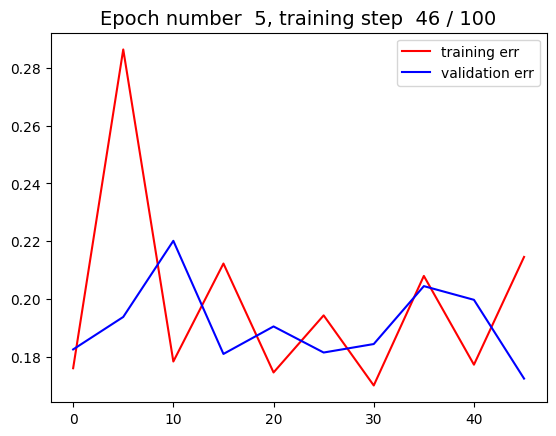

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  50.0 %
50
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]
[0.1760350614786148, 0.2863881587982178, 0.178361713886261, 0.2122851312160492, 0.17457008361816406, 0.19433602690696716, 0.17006582021713257, 0.20799484848976135, 0.17726466059684753, 0.21457111835479736, 0.17465580999851227]
[0.1825474500656128, 0.1937890201807022, 0.22014755010604858, 0.1809832900762558, 0.19050271809101105, 0.18147368729114532, 0.18441015481948853, 0.20446249842643738, 0.19971932470798492, 0.17245393991470337, 0.1684887409210205]


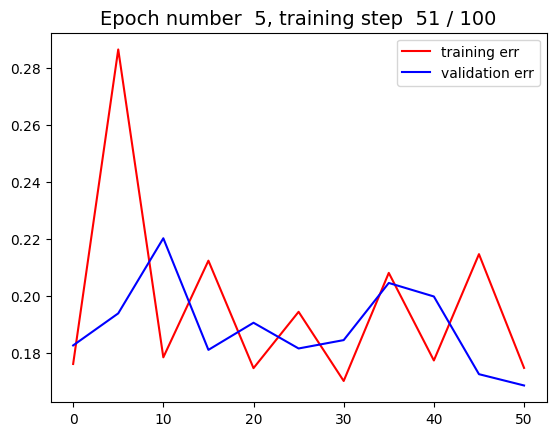

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  55.0 %
55
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55]
[0.1760350614786148, 0.2863881587982178, 0.178361713886261, 0.2122851312160492, 0.17457008361816406, 0.19433602690696716, 0.17006582021713257, 0.20799484848976135, 0.17726466059684753, 0.21457111835479736, 0.17465580999851227, 0.1673656702041626]
[0.1825474500656128, 0.1937890201807022, 0.22014755010604858, 0.1809832900762558, 0.19050271809101105, 0.18147368729114532, 0.18441015481948853, 0.20446249842643738, 0.19971932470798492, 0.17245393991470337, 0.1684887409210205, 0.1677142232656479]


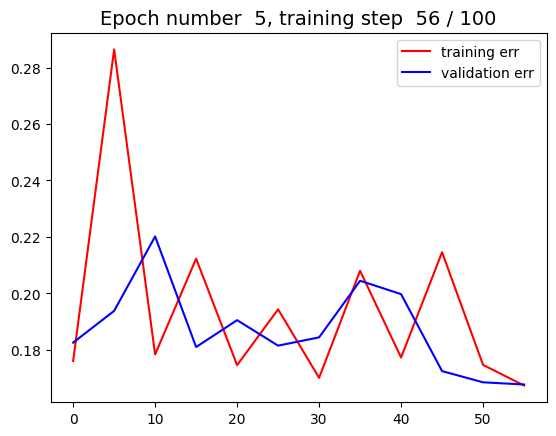

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  60.0 %
60
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]
[0.1760350614786148, 0.2863881587982178, 0.178361713886261, 0.2122851312160492, 0.17457008361816406, 0.19433602690696716, 0.17006582021713257, 0.20799484848976135, 0.17726466059684753, 0.21457111835479736, 0.17465580999851227, 0.1673656702041626, 0.20109397172927856]
[0.1825474500656128, 0.1937890201807022, 0.22014755010604858, 0.1809832900762558, 0.19050271809101105, 0.18147368729114532, 0.18441015481948853, 0.20446249842643738, 0.19971932470798492, 0.17245393991470337, 0.1684887409210205, 0.1677142232656479, 0.17032401263713837]


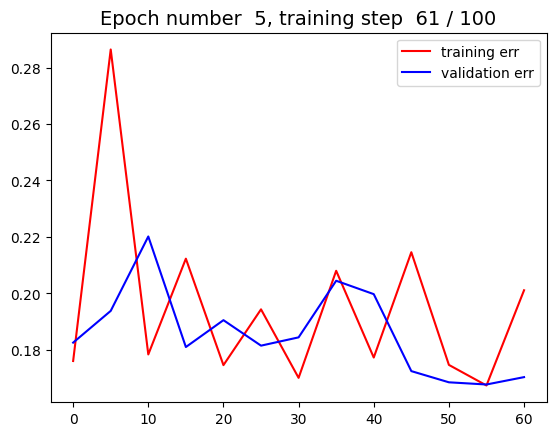

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  65.0 %
65
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65]
[0.1760350614786148, 0.2863881587982178, 0.178361713886261, 0.2122851312160492, 0.17457008361816406, 0.19433602690696716, 0.17006582021713257, 0.20799484848976135, 0.17726466059684753, 0.21457111835479736, 0.17465580999851227, 0.1673656702041626, 0.20109397172927856, 0.17271704971790314]
[0.1825474500656128, 0.1937890201807022, 0.22014755010604858, 0.1809832900762558, 0.19050271809101105, 0.18147368729114532, 0.18441015481948853, 0.20446249842643738, 0.19971932470798492, 0.17245393991470337, 0.1684887409210205, 0.1677142232656479, 0.17032401263713837, 0.22869858145713806]


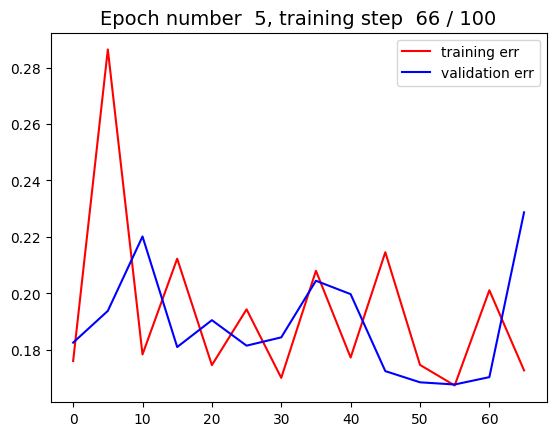

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  70.0 %
70
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70]
[0.1760350614786148, 0.2863881587982178, 0.178361713886261, 0.2122851312160492, 0.17457008361816406, 0.19433602690696716, 0.17006582021713257, 0.20799484848976135, 0.17726466059684753, 0.21457111835479736, 0.17465580999851227, 0.1673656702041626, 0.20109397172927856, 0.17271704971790314, 0.16863210499286652]
[0.1825474500656128, 0.1937890201807022, 0.22014755010604858, 0.1809832900762558, 0.19050271809101105, 0.18147368729114532, 0.18441015481948853, 0.20446249842643738, 0.19971932470798492, 0.17245393991470337, 0.1684887409210205, 0.1677142232656479, 0.17032401263713837, 0.22869858145713806, 0.21398130059242249]


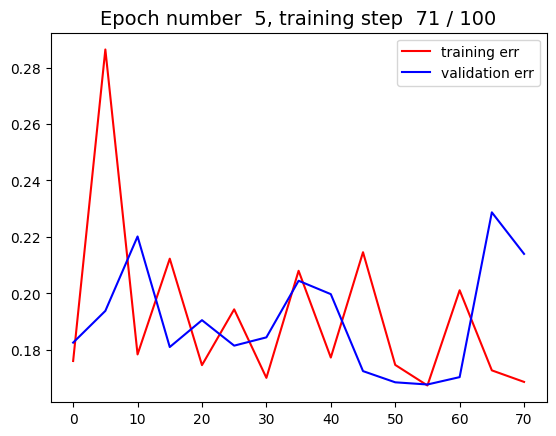

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  75.0 %
75
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75]
[0.1760350614786148, 0.2863881587982178, 0.178361713886261, 0.2122851312160492, 0.17457008361816406, 0.19433602690696716, 0.17006582021713257, 0.20799484848976135, 0.17726466059684753, 0.21457111835479736, 0.17465580999851227, 0.1673656702041626, 0.20109397172927856, 0.17271704971790314, 0.16863210499286652, 0.2832646071910858]
[0.1825474500656128, 0.1937890201807022, 0.22014755010604858, 0.1809832900762558, 0.19050271809101105, 0.18147368729114532, 0.18441015481948853, 0.20446249842643738, 0.19971932470798492, 0.17245393991470337, 0.1684887409210205, 0.1677142232656479, 0.17032401263713837, 0.22869858145713806, 0.21398130059242249, 0.3269619345664978]


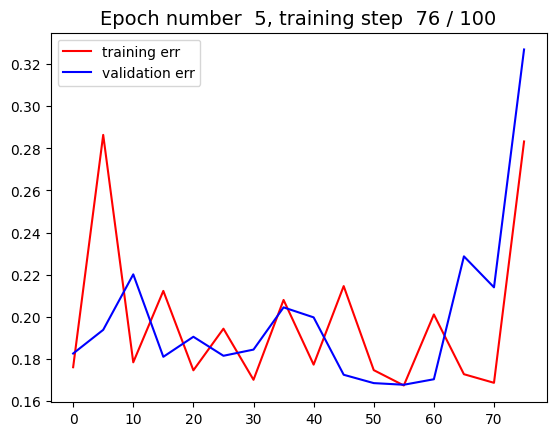

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  80.0 %
80
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80]
[0.1760350614786148, 0.2863881587982178, 0.178361713886261, 0.2122851312160492, 0.17457008361816406, 0.19433602690696716, 0.17006582021713257, 0.20799484848976135, 0.17726466059684753, 0.21457111835479736, 0.17465580999851227, 0.1673656702041626, 0.20109397172927856, 0.17271704971790314, 0.16863210499286652, 0.2832646071910858, 0.1959841549396515]
[0.1825474500656128, 0.1937890201807022, 0.22014755010604858, 0.1809832900762558, 0.19050271809101105, 0.18147368729114532, 0.18441015481948853, 0.20446249842643738, 0.19971932470798492, 0.17245393991470337, 0.1684887409210205, 0.1677142232656479, 0.17032401263713837, 0.22869858145713806, 0.21398130059242249, 0.3269619345664978, 0.16817283630371094]


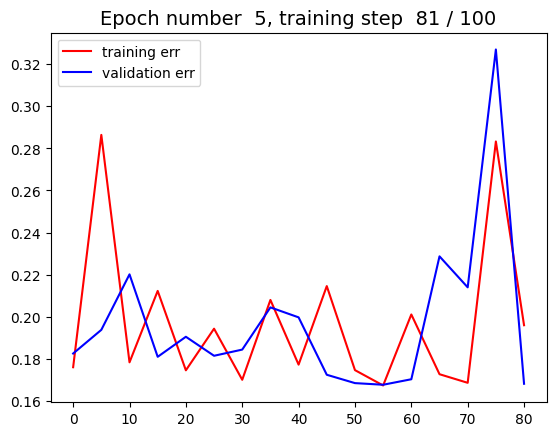

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  85.0 %
85
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85]
[0.1760350614786148, 0.2863881587982178, 0.178361713886261, 0.2122851312160492, 0.17457008361816406, 0.19433602690696716, 0.17006582021713257, 0.20799484848976135, 0.17726466059684753, 0.21457111835479736, 0.17465580999851227, 0.1673656702041626, 0.20109397172927856, 0.17271704971790314, 0.16863210499286652, 0.2832646071910858, 0.1959841549396515, 0.1578977108001709]
[0.1825474500656128, 0.1937890201807022, 0.22014755010604858, 0.1809832900762558, 0.19050271809101105, 0.18147368729114532, 0.18441015481948853, 0.20446249842643738, 0.19971932470798492, 0.17245393991470337, 0.1684887409210205, 0.1677142232656479, 0.17032401263713837, 0.22869858145713806, 0.21398130059242249, 0.3269619345664978, 0.16817283630371094, 0.16667331755161285]


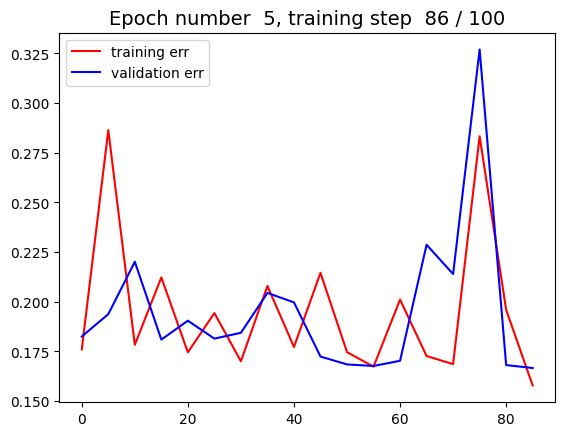

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  90.0 %
90
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90]
[0.1760350614786148, 0.2863881587982178, 0.178361713886261, 0.2122851312160492, 0.17457008361816406, 0.19433602690696716, 0.17006582021713257, 0.20799484848976135, 0.17726466059684753, 0.21457111835479736, 0.17465580999851227, 0.1673656702041626, 0.20109397172927856, 0.17271704971790314, 0.16863210499286652, 0.2832646071910858, 0.1959841549396515, 0.1578977108001709, 0.1804046630859375]
[0.1825474500656128, 0.1937890201807022, 0.22014755010604858, 0.1809832900762558, 0.19050271809101105, 0.18147368729114532, 0.18441015481948853, 0.20446249842643738, 0.19971932470798492, 0.17245393991470337, 0.1684887409210205, 0.1677142232656479, 0.17032401263713837, 0.22869858145713806, 0.21398130059242249, 0.3269619345664978, 0.16817283630371094, 0.16667331755161285, 0.16285373270511627]


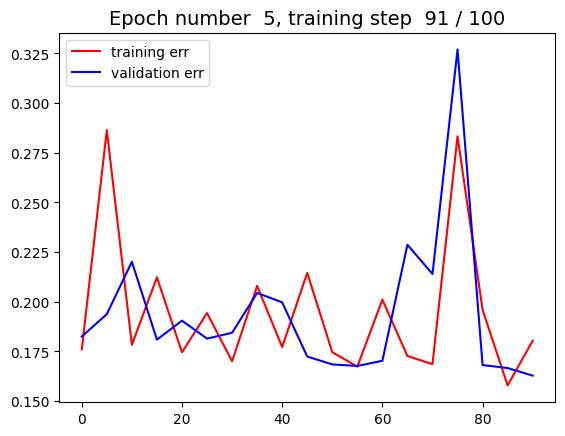

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  95.0 %
95
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95]
[0.1760350614786148, 0.2863881587982178, 0.178361713886261, 0.2122851312160492, 0.17457008361816406, 0.19433602690696716, 0.17006582021713257, 0.20799484848976135, 0.17726466059684753, 0.21457111835479736, 0.17465580999851227, 0.1673656702041626, 0.20109397172927856, 0.17271704971790314, 0.16863210499286652, 0.2832646071910858, 0.1959841549396515, 0.1578977108001709, 0.1804046630859375, 0.18880541622638702]
[0.1825474500656128, 0.1937890201807022, 0.22014755010604858, 0.1809832900762558, 0.19050271809101105, 0.18147368729114532, 0.18441015481948853, 0.20446249842643738, 0.19971932470798492, 0.17245393991470337, 0.1684887409210205, 0.1677142232656479, 0.17032401263713837, 0.22869858145713806, 0.21398130059242249, 0.3269619345664978, 0.16817283630371094, 0.16667331755161285, 0.16285373270511627, 0.170

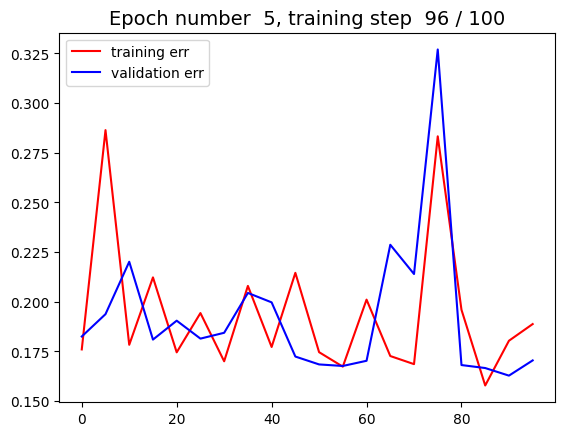

--------------------------------------------
Epoch number =  5 . Percentage of training completed =  100.0 %
100
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
[0.1760350614786148, 0.2863881587982178, 0.178361713886261, 0.2122851312160492, 0.17457008361816406, 0.19433602690696716, 0.17006582021713257, 0.20799484848976135, 0.17726466059684753, 0.21457111835479736, 0.17465580999851227, 0.1673656702041626, 0.20109397172927856, 0.17271704971790314, 0.16863210499286652, 0.2832646071910858, 0.1959841549396515, 0.1578977108001709, 0.1804046630859375, 0.18880541622638702, 0.20906436443328857]
[0.1825474500656128, 0.1937890201807022, 0.22014755010604858, 0.1809832900762558, 0.19050271809101105, 0.18147368729114532, 0.18441015481948853, 0.20446249842643738, 0.19971932470798492, 0.17245393991470337, 0.1684887409210205, 0.1677142232656479, 0.17032401263713837, 0.22869858145713806, 0.21398130059242249, 0.3269619345664978, 0.16817283630371094, 0.16667331755161285

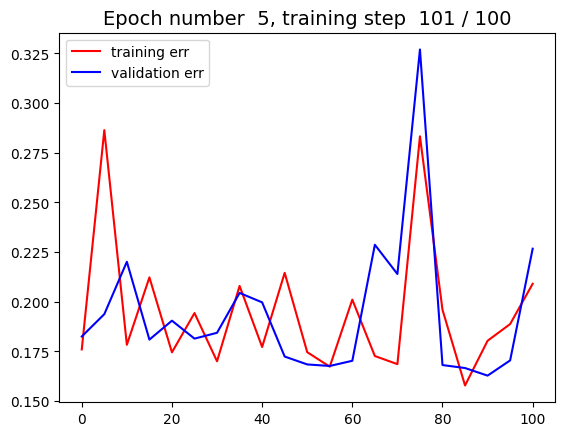

--------------------------------------------
Exiting early, validation error array:  [0.16817284 0.16667332 0.16285373 0.1705144  0.22671612] . Training error array:  [0.19598415 0.15789771 0.18040466 0.18880542 0.20906436]
Completed training for clique = 
Completed training for clique =  60 % correct on test set = [100.0] $k/sqrt{n}$ = [6.0]
Clique size is now:  55
Epoch number =  1 . Percentage of training completed =  0.0 %
0
[0]
[0.197710320353508]
[0.29090428352355957]


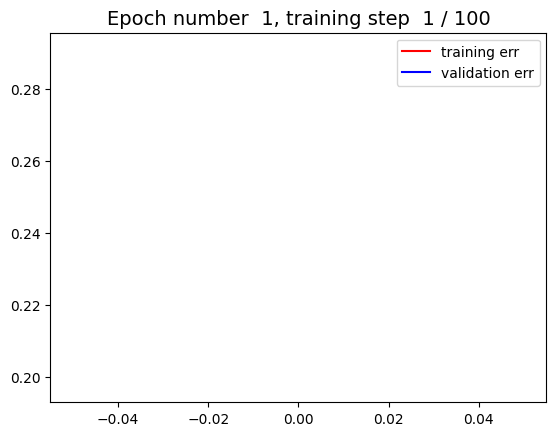

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  5.0 %
5
[0, 5]
[0.197710320353508, 0.21735724806785583]
[0.29090428352355957, 0.17398123443126678]


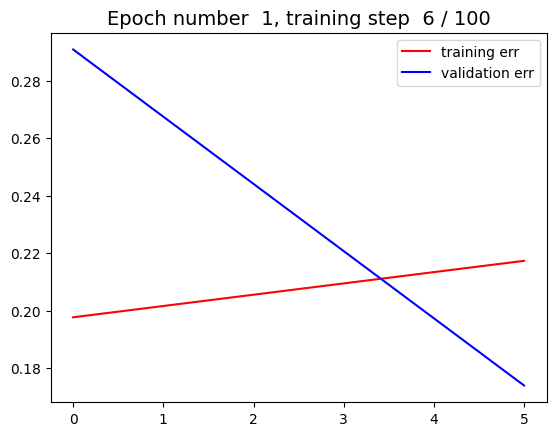

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  10.0 %
10
[0, 5, 10]
[0.197710320353508, 0.21735724806785583, 0.31365078687667847]
[0.29090428352355957, 0.17398123443126678, 0.280825138092041]


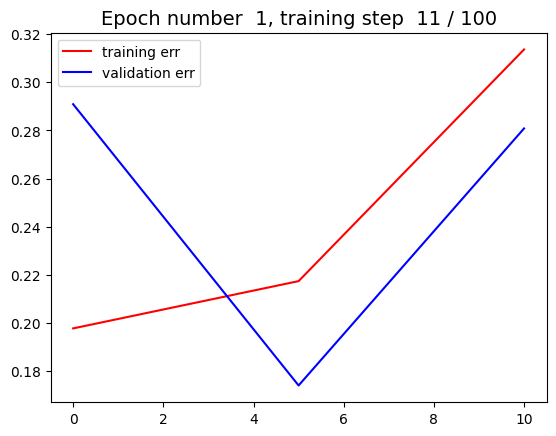

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  15.0 %
15
[0, 5, 10, 15]
[0.197710320353508, 0.21735724806785583, 0.31365078687667847, 0.17363882064819336]
[0.29090428352355957, 0.17398123443126678, 0.280825138092041, 0.19827477633953094]


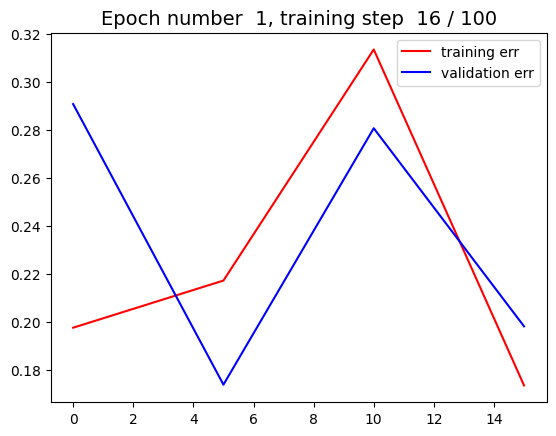

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  20.0 %
20
[0, 5, 10, 15, 20]
[0.197710320353508, 0.21735724806785583, 0.31365078687667847, 0.17363882064819336, 0.22870150208473206]
[0.29090428352355957, 0.17398123443126678, 0.280825138092041, 0.19827477633953094, 0.16378049552440643]


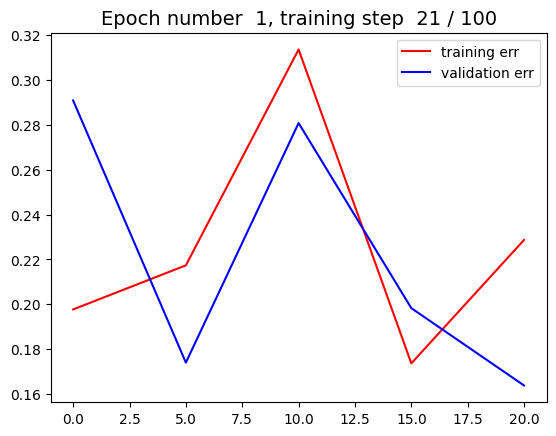

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  25.0 %
25
[0, 5, 10, 15, 20, 25]
[0.197710320353508, 0.21735724806785583, 0.31365078687667847, 0.17363882064819336, 0.22870150208473206, 0.1786981076002121]
[0.29090428352355957, 0.17398123443126678, 0.280825138092041, 0.19827477633953094, 0.16378049552440643, 0.26161715388298035]


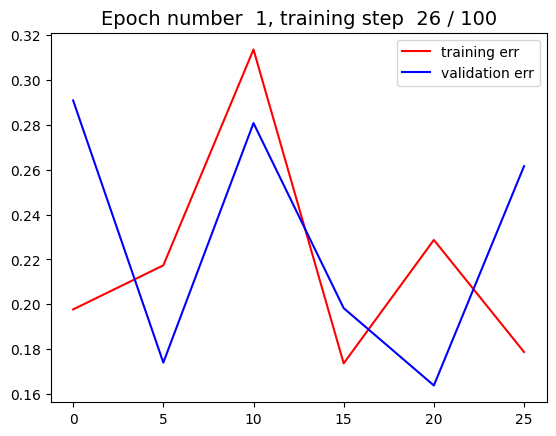

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  30.0 %
30
[0, 5, 10, 15, 20, 25, 30]
[0.197710320353508, 0.21735724806785583, 0.31365078687667847, 0.17363882064819336, 0.22870150208473206, 0.1786981076002121, 0.226866215467453]
[0.29090428352355957, 0.17398123443126678, 0.280825138092041, 0.19827477633953094, 0.16378049552440643, 0.26161715388298035, 0.1955150067806244]


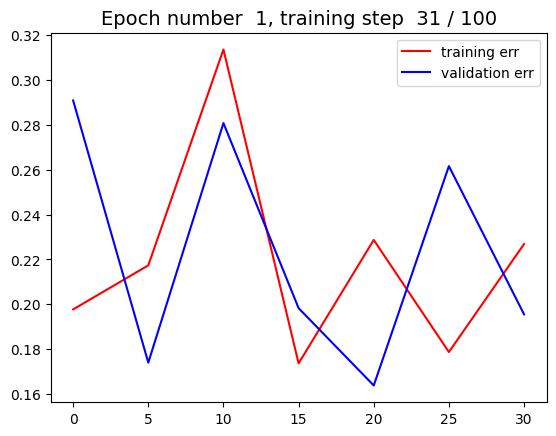

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  35.0 %
35
[0, 5, 10, 15, 20, 25, 30, 35]
[0.197710320353508, 0.21735724806785583, 0.31365078687667847, 0.17363882064819336, 0.22870150208473206, 0.1786981076002121, 0.226866215467453, 0.25755301117897034]
[0.29090428352355957, 0.17398123443126678, 0.280825138092041, 0.19827477633953094, 0.16378049552440643, 0.26161715388298035, 0.1955150067806244, 0.15572676062583923]


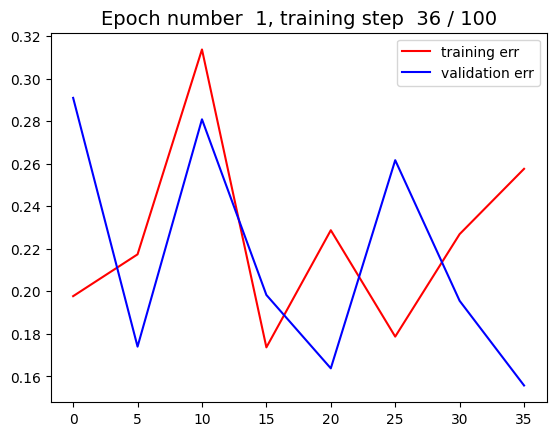

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  40.0 %
40
[0, 5, 10, 15, 20, 25, 30, 35, 40]
[0.197710320353508, 0.21735724806785583, 0.31365078687667847, 0.17363882064819336, 0.22870150208473206, 0.1786981076002121, 0.226866215467453, 0.25755301117897034, 0.16095882654190063]
[0.29090428352355957, 0.17398123443126678, 0.280825138092041, 0.19827477633953094, 0.16378049552440643, 0.26161715388298035, 0.1955150067806244, 0.15572676062583923, 0.3211674988269806]


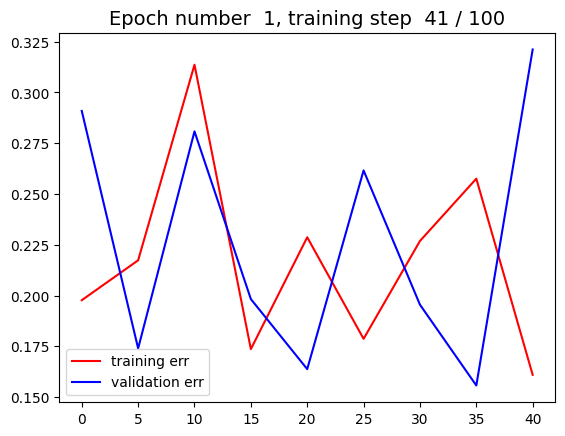

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  45.0 %
45
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
[0.197710320353508, 0.21735724806785583, 0.31365078687667847, 0.17363882064819336, 0.22870150208473206, 0.1786981076002121, 0.226866215467453, 0.25755301117897034, 0.16095882654190063, 0.18697009980678558]
[0.29090428352355957, 0.17398123443126678, 0.280825138092041, 0.19827477633953094, 0.16378049552440643, 0.26161715388298035, 0.1955150067806244, 0.15572676062583923, 0.3211674988269806, 0.22226545214653015]


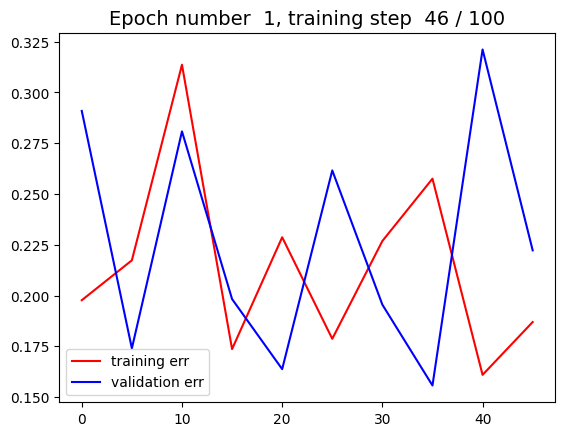

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  50.0 %
50
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]
[0.197710320353508, 0.21735724806785583, 0.31365078687667847, 0.17363882064819336, 0.22870150208473206, 0.1786981076002121, 0.226866215467453, 0.25755301117897034, 0.16095882654190063, 0.18697009980678558, 0.16570456326007843]
[0.29090428352355957, 0.17398123443126678, 0.280825138092041, 0.19827477633953094, 0.16378049552440643, 0.26161715388298035, 0.1955150067806244, 0.15572676062583923, 0.3211674988269806, 0.22226545214653015, 0.16508613526821136]


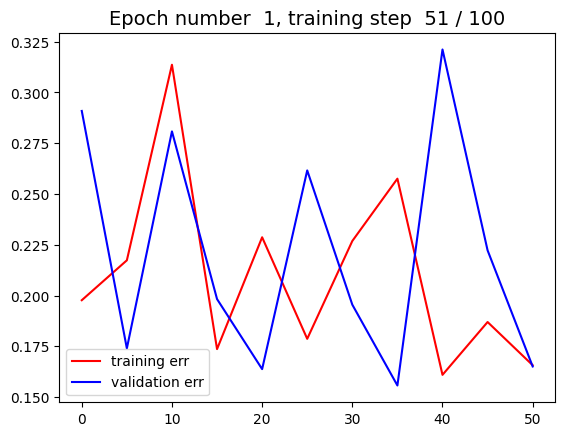

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  55.0 %
55
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55]
[0.197710320353508, 0.21735724806785583, 0.31365078687667847, 0.17363882064819336, 0.22870150208473206, 0.1786981076002121, 0.226866215467453, 0.25755301117897034, 0.16095882654190063, 0.18697009980678558, 0.16570456326007843, 0.16681353747844696]
[0.29090428352355957, 0.17398123443126678, 0.280825138092041, 0.19827477633953094, 0.16378049552440643, 0.26161715388298035, 0.1955150067806244, 0.15572676062583923, 0.3211674988269806, 0.22226545214653015, 0.16508613526821136, 0.24714937806129456]


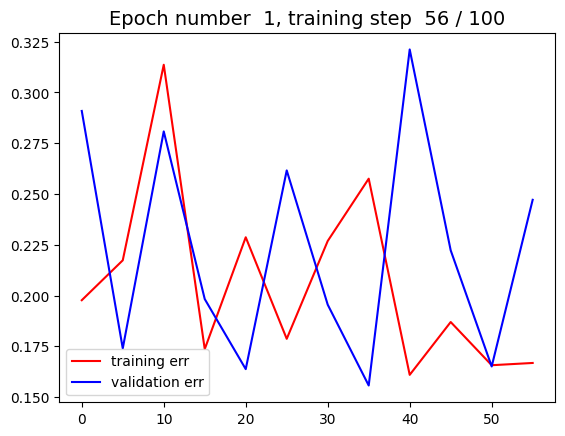

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  60.0 %
60
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]
[0.197710320353508, 0.21735724806785583, 0.31365078687667847, 0.17363882064819336, 0.22870150208473206, 0.1786981076002121, 0.226866215467453, 0.25755301117897034, 0.16095882654190063, 0.18697009980678558, 0.16570456326007843, 0.16681353747844696, 0.2137194722890854]
[0.29090428352355957, 0.17398123443126678, 0.280825138092041, 0.19827477633953094, 0.16378049552440643, 0.26161715388298035, 0.1955150067806244, 0.15572676062583923, 0.3211674988269806, 0.22226545214653015, 0.16508613526821136, 0.24714937806129456, 0.2071325182914734]


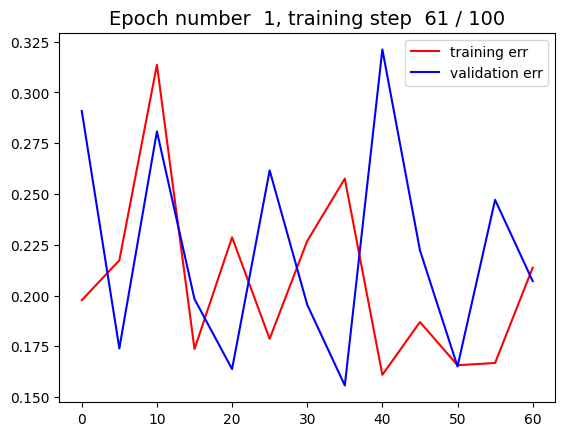

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  65.0 %
65
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65]
[0.197710320353508, 0.21735724806785583, 0.31365078687667847, 0.17363882064819336, 0.22870150208473206, 0.1786981076002121, 0.226866215467453, 0.25755301117897034, 0.16095882654190063, 0.18697009980678558, 0.16570456326007843, 0.16681353747844696, 0.2137194722890854, 0.1782122552394867]
[0.29090428352355957, 0.17398123443126678, 0.280825138092041, 0.19827477633953094, 0.16378049552440643, 0.26161715388298035, 0.1955150067806244, 0.15572676062583923, 0.3211674988269806, 0.22226545214653015, 0.16508613526821136, 0.24714937806129456, 0.2071325182914734, 0.200351282954216]


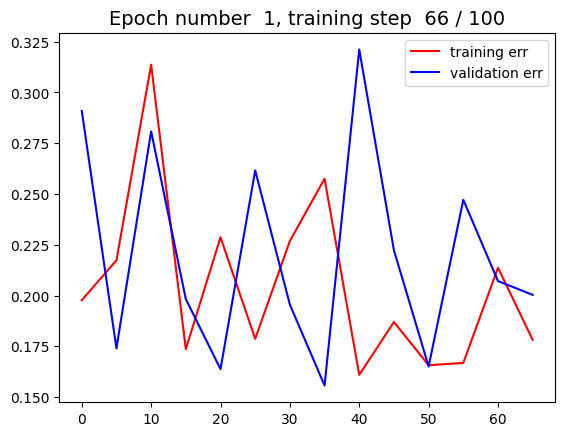

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  70.0 %
70
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70]
[0.197710320353508, 0.21735724806785583, 0.31365078687667847, 0.17363882064819336, 0.22870150208473206, 0.1786981076002121, 0.226866215467453, 0.25755301117897034, 0.16095882654190063, 0.18697009980678558, 0.16570456326007843, 0.16681353747844696, 0.2137194722890854, 0.1782122552394867, 0.20155669748783112]
[0.29090428352355957, 0.17398123443126678, 0.280825138092041, 0.19827477633953094, 0.16378049552440643, 0.26161715388298035, 0.1955150067806244, 0.15572676062583923, 0.3211674988269806, 0.22226545214653015, 0.16508613526821136, 0.24714937806129456, 0.2071325182914734, 0.200351282954216, 0.23145785927772522]


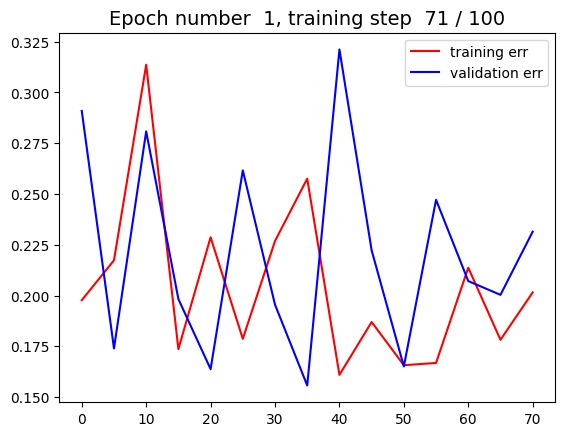

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  75.0 %
75
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75]
[0.197710320353508, 0.21735724806785583, 0.31365078687667847, 0.17363882064819336, 0.22870150208473206, 0.1786981076002121, 0.226866215467453, 0.25755301117897034, 0.16095882654190063, 0.18697009980678558, 0.16570456326007843, 0.16681353747844696, 0.2137194722890854, 0.1782122552394867, 0.20155669748783112, 0.17092399299144745]
[0.29090428352355957, 0.17398123443126678, 0.280825138092041, 0.19827477633953094, 0.16378049552440643, 0.26161715388298035, 0.1955150067806244, 0.15572676062583923, 0.3211674988269806, 0.22226545214653015, 0.16508613526821136, 0.24714937806129456, 0.2071325182914734, 0.200351282954216, 0.23145785927772522, 0.1492876261472702]


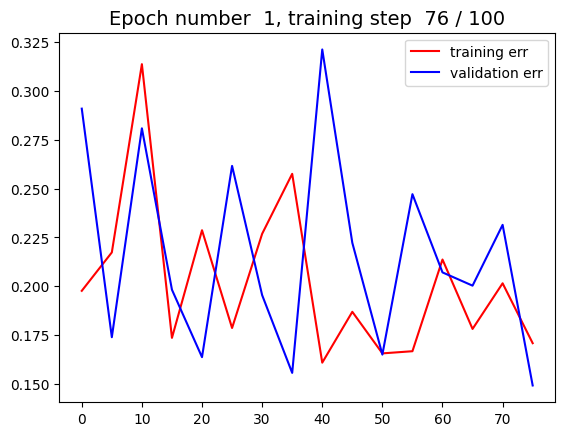

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  80.0 %
80
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80]
[0.197710320353508, 0.21735724806785583, 0.31365078687667847, 0.17363882064819336, 0.22870150208473206, 0.1786981076002121, 0.226866215467453, 0.25755301117897034, 0.16095882654190063, 0.18697009980678558, 0.16570456326007843, 0.16681353747844696, 0.2137194722890854, 0.1782122552394867, 0.20155669748783112, 0.17092399299144745, 0.14402137696743011]
[0.29090428352355957, 0.17398123443126678, 0.280825138092041, 0.19827477633953094, 0.16378049552440643, 0.26161715388298035, 0.1955150067806244, 0.15572676062583923, 0.3211674988269806, 0.22226545214653015, 0.16508613526821136, 0.24714937806129456, 0.2071325182914734, 0.200351282954216, 0.23145785927772522, 0.1492876261472702, 0.22509120404720306]


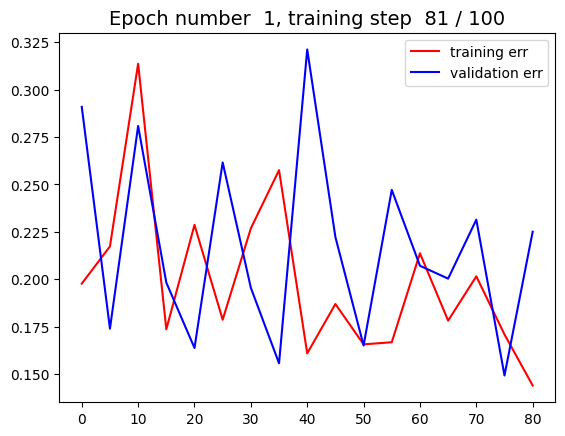

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  85.0 %
85
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85]
[0.197710320353508, 0.21735724806785583, 0.31365078687667847, 0.17363882064819336, 0.22870150208473206, 0.1786981076002121, 0.226866215467453, 0.25755301117897034, 0.16095882654190063, 0.18697009980678558, 0.16570456326007843, 0.16681353747844696, 0.2137194722890854, 0.1782122552394867, 0.20155669748783112, 0.17092399299144745, 0.14402137696743011, 0.15509691834449768]
[0.29090428352355957, 0.17398123443126678, 0.280825138092041, 0.19827477633953094, 0.16378049552440643, 0.26161715388298035, 0.1955150067806244, 0.15572676062583923, 0.3211674988269806, 0.22226545214653015, 0.16508613526821136, 0.24714937806129456, 0.2071325182914734, 0.200351282954216, 0.23145785927772522, 0.1492876261472702, 0.22509120404720306, 0.2136077880859375]


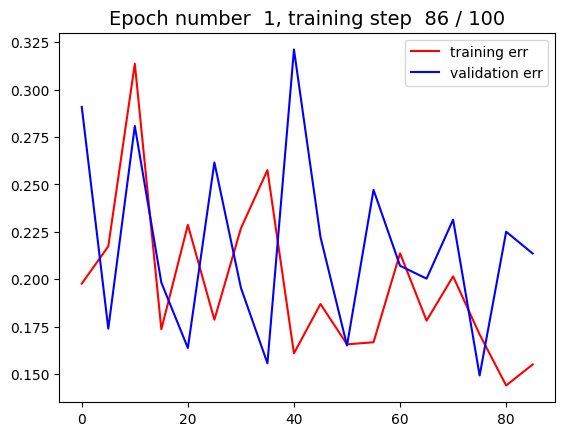

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  90.0 %
90
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90]
[0.197710320353508, 0.21735724806785583, 0.31365078687667847, 0.17363882064819336, 0.22870150208473206, 0.1786981076002121, 0.226866215467453, 0.25755301117897034, 0.16095882654190063, 0.18697009980678558, 0.16570456326007843, 0.16681353747844696, 0.2137194722890854, 0.1782122552394867, 0.20155669748783112, 0.17092399299144745, 0.14402137696743011, 0.15509691834449768, 0.18068449199199677]
[0.29090428352355957, 0.17398123443126678, 0.280825138092041, 0.19827477633953094, 0.16378049552440643, 0.26161715388298035, 0.1955150067806244, 0.15572676062583923, 0.3211674988269806, 0.22226545214653015, 0.16508613526821136, 0.24714937806129456, 0.2071325182914734, 0.200351282954216, 0.23145785927772522, 0.1492876261472702, 0.22509120404720306, 0.2136077880859375, 0.2346908301115036]


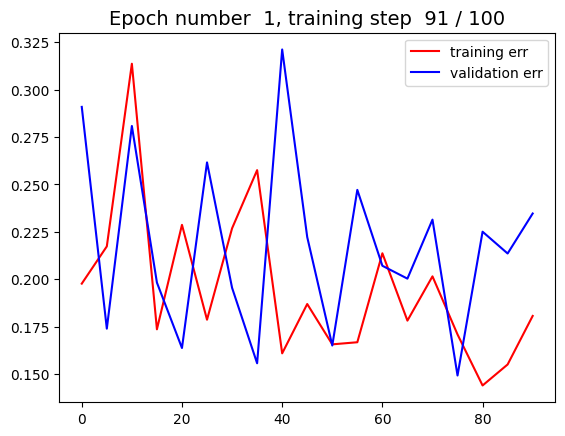

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  95.0 %
95
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95]
[0.197710320353508, 0.21735724806785583, 0.31365078687667847, 0.17363882064819336, 0.22870150208473206, 0.1786981076002121, 0.226866215467453, 0.25755301117897034, 0.16095882654190063, 0.18697009980678558, 0.16570456326007843, 0.16681353747844696, 0.2137194722890854, 0.1782122552394867, 0.20155669748783112, 0.17092399299144745, 0.14402137696743011, 0.15509691834449768, 0.18068449199199677, 0.18664473295211792]
[0.29090428352355957, 0.17398123443126678, 0.280825138092041, 0.19827477633953094, 0.16378049552440643, 0.26161715388298035, 0.1955150067806244, 0.15572676062583923, 0.3211674988269806, 0.22226545214653015, 0.16508613526821136, 0.24714937806129456, 0.2071325182914734, 0.200351282954216, 0.23145785927772522, 0.1492876261472702, 0.22509120404720306, 0.2136077880859375, 0.2346908301115036, 0.2089

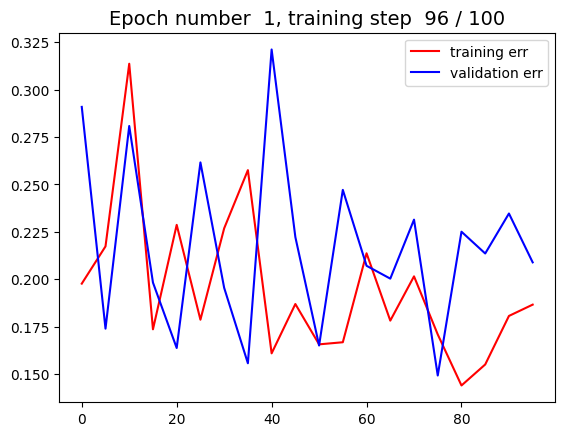

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  100.0 %
100
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
[0.197710320353508, 0.21735724806785583, 0.31365078687667847, 0.17363882064819336, 0.22870150208473206, 0.1786981076002121, 0.226866215467453, 0.25755301117897034, 0.16095882654190063, 0.18697009980678558, 0.16570456326007843, 0.16681353747844696, 0.2137194722890854, 0.1782122552394867, 0.20155669748783112, 0.17092399299144745, 0.14402137696743011, 0.15509691834449768, 0.18068449199199677, 0.18664473295211792, 0.23061488568782806]
[0.29090428352355957, 0.17398123443126678, 0.280825138092041, 0.19827477633953094, 0.16378049552440643, 0.26161715388298035, 0.1955150067806244, 0.15572676062583923, 0.3211674988269806, 0.22226545214653015, 0.16508613526821136, 0.24714937806129456, 0.2071325182914734, 0.200351282954216, 0.23145785927772522, 0.1492876261472702, 0.22509120404720306, 0.2136077880859375

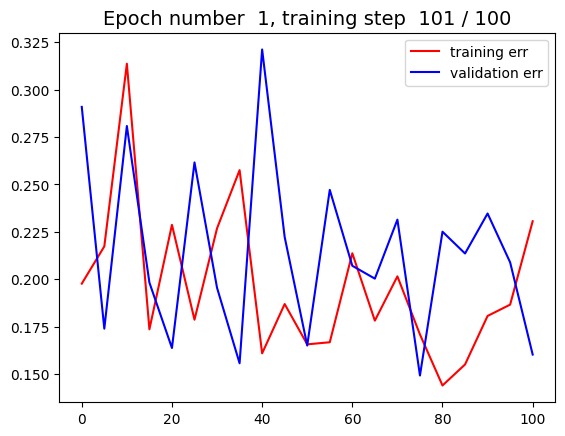

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  0.0 %
0
[0]
[0.27297544479370117]
[0.18011030554771423]


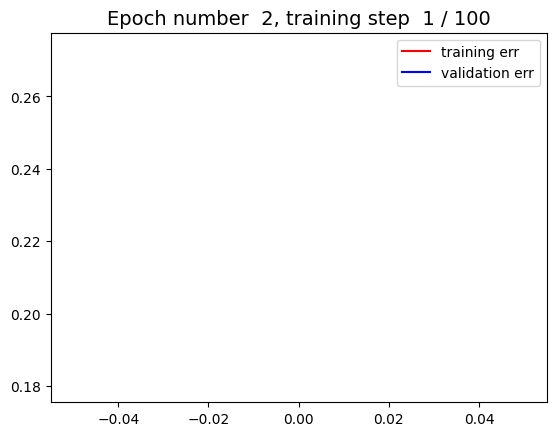

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  5.0 %
5
[0, 5]
[0.27297544479370117, 0.3354904055595398]
[0.18011030554771423, 0.18190328776836395]


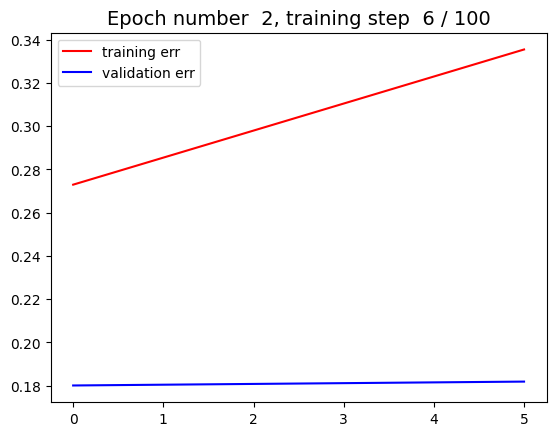

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  10.0 %
10
[0, 5, 10]
[0.27297544479370117, 0.3354904055595398, 0.1944674700498581]
[0.18011030554771423, 0.18190328776836395, 0.2726893126964569]


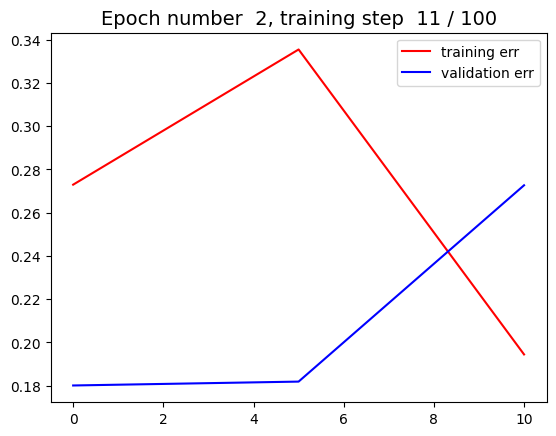

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  15.0 %
15
[0, 5, 10, 15]
[0.27297544479370117, 0.3354904055595398, 0.1944674700498581, 0.18695665895938873]
[0.18011030554771423, 0.18190328776836395, 0.2726893126964569, 0.25775954127311707]


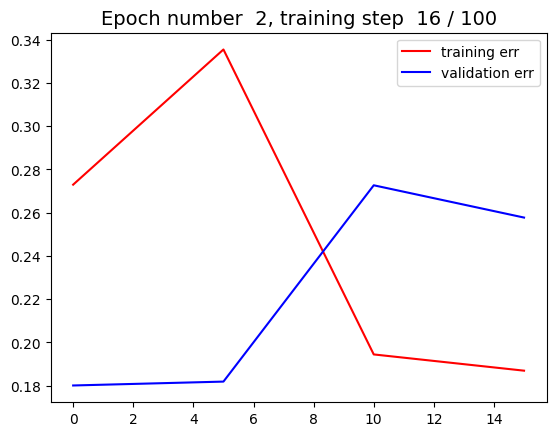

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  20.0 %
20
[0, 5, 10, 15, 20]
[0.27297544479370117, 0.3354904055595398, 0.1944674700498581, 0.18695665895938873, 0.14262162148952484]
[0.18011030554771423, 0.18190328776836395, 0.2726893126964569, 0.25775954127311707, 0.14511430263519287]


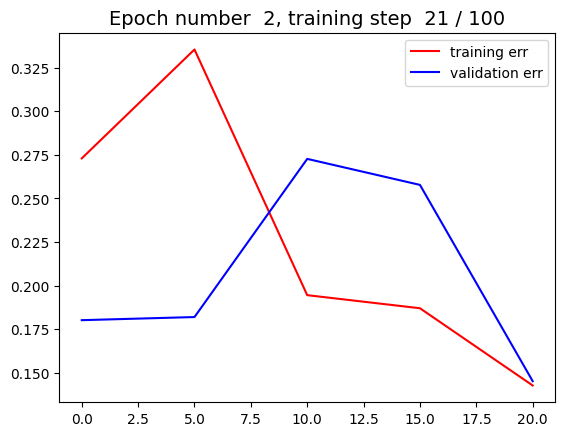

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  25.0 %
25
[0, 5, 10, 15, 20, 25]
[0.27297544479370117, 0.3354904055595398, 0.1944674700498581, 0.18695665895938873, 0.14262162148952484, 0.14494375884532928]
[0.18011030554771423, 0.18190328776836395, 0.2726893126964569, 0.25775954127311707, 0.14511430263519287, 0.16246438026428223]


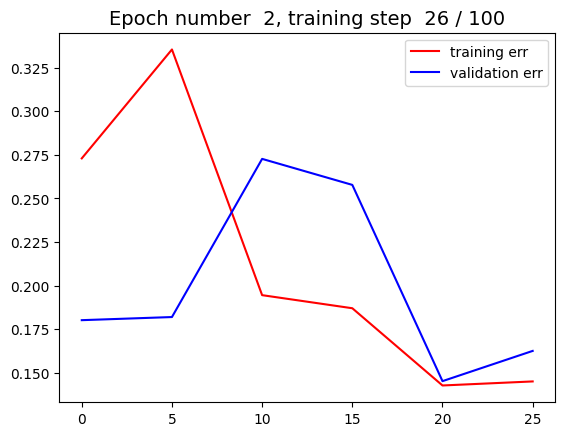

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  30.0 %
30
[0, 5, 10, 15, 20, 25, 30]
[0.27297544479370117, 0.3354904055595398, 0.1944674700498581, 0.18695665895938873, 0.14262162148952484, 0.14494375884532928, 0.14469876885414124]
[0.18011030554771423, 0.18190328776836395, 0.2726893126964569, 0.25775954127311707, 0.14511430263519287, 0.16246438026428223, 0.24554306268692017]


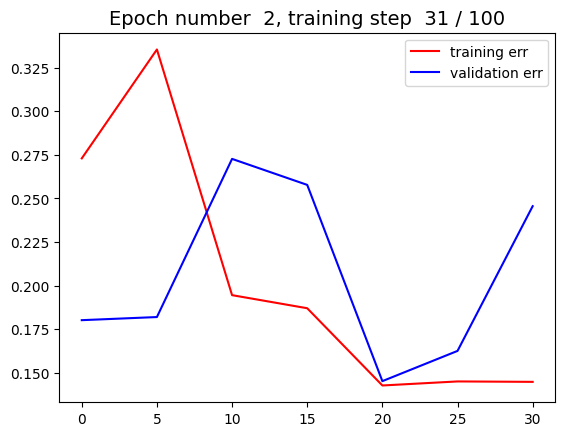

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  35.0 %
35
[0, 5, 10, 15, 20, 25, 30, 35]
[0.27297544479370117, 0.3354904055595398, 0.1944674700498581, 0.18695665895938873, 0.14262162148952484, 0.14494375884532928, 0.14469876885414124, 0.16478446125984192]
[0.18011030554771423, 0.18190328776836395, 0.2726893126964569, 0.25775954127311707, 0.14511430263519287, 0.16246438026428223, 0.24554306268692017, 0.16527670621871948]


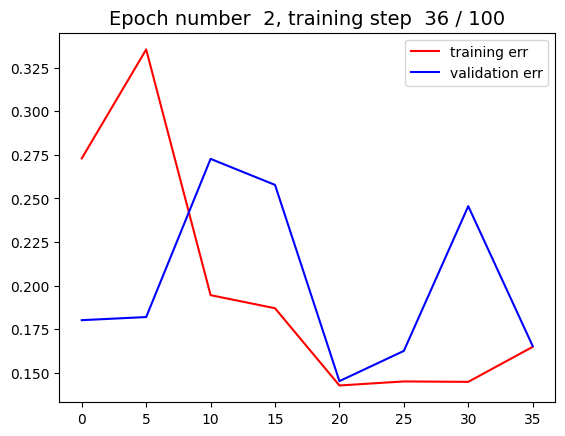

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  40.0 %
40
[0, 5, 10, 15, 20, 25, 30, 35, 40]
[0.27297544479370117, 0.3354904055595398, 0.1944674700498581, 0.18695665895938873, 0.14262162148952484, 0.14494375884532928, 0.14469876885414124, 0.16478446125984192, 0.13890212774276733]
[0.18011030554771423, 0.18190328776836395, 0.2726893126964569, 0.25775954127311707, 0.14511430263519287, 0.16246438026428223, 0.24554306268692017, 0.16527670621871948, 0.1413993537425995]


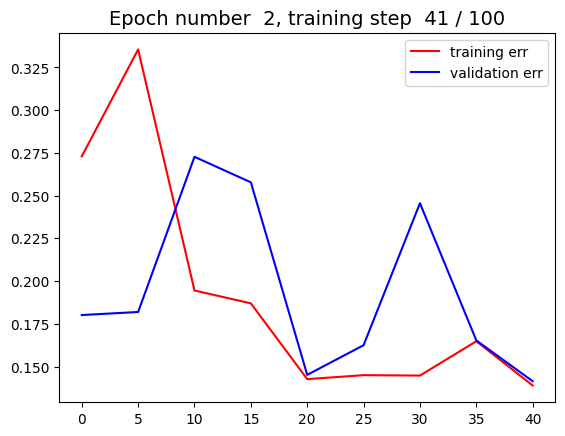

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  45.0 %
45
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
[0.27297544479370117, 0.3354904055595398, 0.1944674700498581, 0.18695665895938873, 0.14262162148952484, 0.14494375884532928, 0.14469876885414124, 0.16478446125984192, 0.13890212774276733, 0.1767207384109497]
[0.18011030554771423, 0.18190328776836395, 0.2726893126964569, 0.25775954127311707, 0.14511430263519287, 0.16246438026428223, 0.24554306268692017, 0.16527670621871948, 0.1413993537425995, 0.22034406661987305]


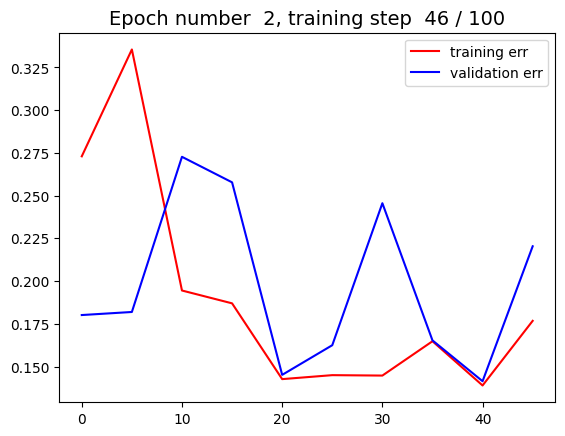

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  50.0 %
50
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]
[0.27297544479370117, 0.3354904055595398, 0.1944674700498581, 0.18695665895938873, 0.14262162148952484, 0.14494375884532928, 0.14469876885414124, 0.16478446125984192, 0.13890212774276733, 0.1767207384109497, 0.1531188189983368]
[0.18011030554771423, 0.18190328776836395, 0.2726893126964569, 0.25775954127311707, 0.14511430263519287, 0.16246438026428223, 0.24554306268692017, 0.16527670621871948, 0.1413993537425995, 0.22034406661987305, 0.18068958818912506]


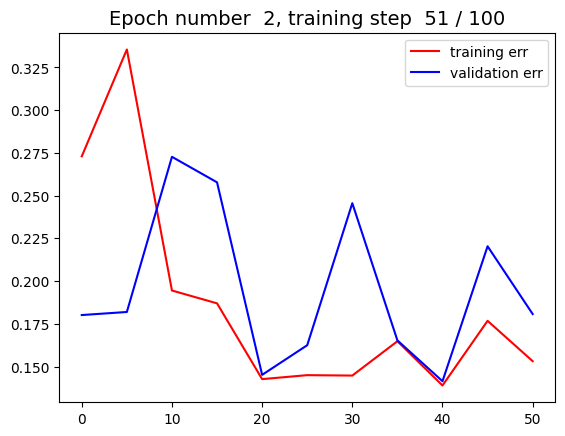

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  55.0 %
55
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55]
[0.27297544479370117, 0.3354904055595398, 0.1944674700498581, 0.18695665895938873, 0.14262162148952484, 0.14494375884532928, 0.14469876885414124, 0.16478446125984192, 0.13890212774276733, 0.1767207384109497, 0.1531188189983368, 0.18989035487174988]
[0.18011030554771423, 0.18190328776836395, 0.2726893126964569, 0.25775954127311707, 0.14511430263519287, 0.16246438026428223, 0.24554306268692017, 0.16527670621871948, 0.1413993537425995, 0.22034406661987305, 0.18068958818912506, 0.24539195001125336]


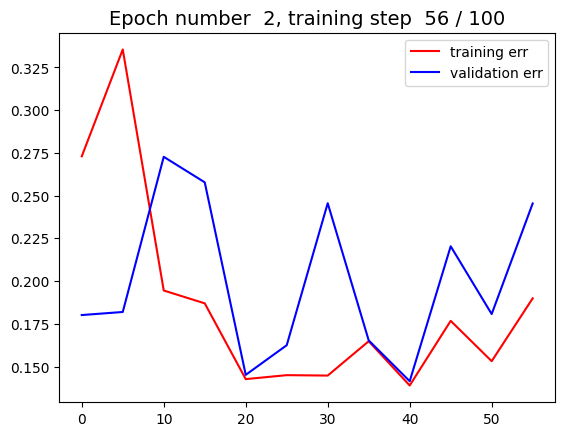

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  60.0 %
60
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]
[0.27297544479370117, 0.3354904055595398, 0.1944674700498581, 0.18695665895938873, 0.14262162148952484, 0.14494375884532928, 0.14469876885414124, 0.16478446125984192, 0.13890212774276733, 0.1767207384109497, 0.1531188189983368, 0.18989035487174988, 0.1807246059179306]
[0.18011030554771423, 0.18190328776836395, 0.2726893126964569, 0.25775954127311707, 0.14511430263519287, 0.16246438026428223, 0.24554306268692017, 0.16527670621871948, 0.1413993537425995, 0.22034406661987305, 0.18068958818912506, 0.24539195001125336, 0.19555167853832245]


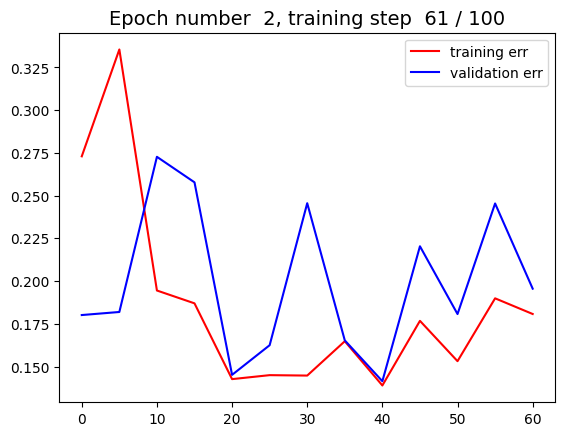

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  65.0 %
65
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65]
[0.27297544479370117, 0.3354904055595398, 0.1944674700498581, 0.18695665895938873, 0.14262162148952484, 0.14494375884532928, 0.14469876885414124, 0.16478446125984192, 0.13890212774276733, 0.1767207384109497, 0.1531188189983368, 0.18989035487174988, 0.1807246059179306, 0.1740468591451645]
[0.18011030554771423, 0.18190328776836395, 0.2726893126964569, 0.25775954127311707, 0.14511430263519287, 0.16246438026428223, 0.24554306268692017, 0.16527670621871948, 0.1413993537425995, 0.22034406661987305, 0.18068958818912506, 0.24539195001125336, 0.19555167853832245, 0.16604238748550415]


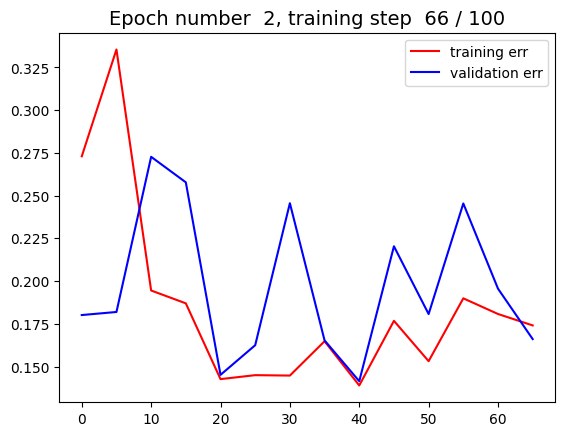

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  70.0 %
70
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70]
[0.27297544479370117, 0.3354904055595398, 0.1944674700498581, 0.18695665895938873, 0.14262162148952484, 0.14494375884532928, 0.14469876885414124, 0.16478446125984192, 0.13890212774276733, 0.1767207384109497, 0.1531188189983368, 0.18989035487174988, 0.1807246059179306, 0.1740468591451645, 0.2184431105852127]
[0.18011030554771423, 0.18190328776836395, 0.2726893126964569, 0.25775954127311707, 0.14511430263519287, 0.16246438026428223, 0.24554306268692017, 0.16527670621871948, 0.1413993537425995, 0.22034406661987305, 0.18068958818912506, 0.24539195001125336, 0.19555167853832245, 0.16604238748550415, 0.13741041719913483]


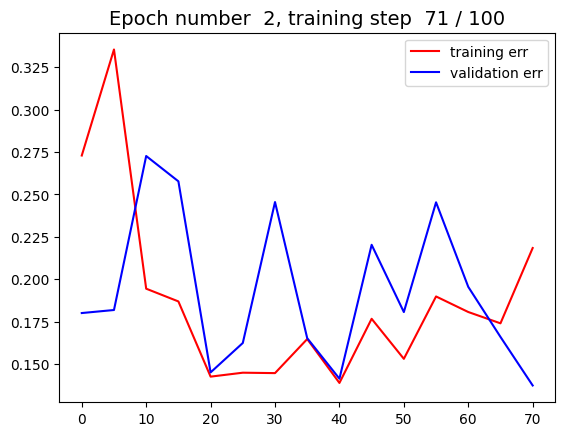

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  75.0 %
75
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75]
[0.27297544479370117, 0.3354904055595398, 0.1944674700498581, 0.18695665895938873, 0.14262162148952484, 0.14494375884532928, 0.14469876885414124, 0.16478446125984192, 0.13890212774276733, 0.1767207384109497, 0.1531188189983368, 0.18989035487174988, 0.1807246059179306, 0.1740468591451645, 0.2184431105852127, 0.2129107266664505]
[0.18011030554771423, 0.18190328776836395, 0.2726893126964569, 0.25775954127311707, 0.14511430263519287, 0.16246438026428223, 0.24554306268692017, 0.16527670621871948, 0.1413993537425995, 0.22034406661987305, 0.18068958818912506, 0.24539195001125336, 0.19555167853832245, 0.16604238748550415, 0.13741041719913483, 0.20485737919807434]


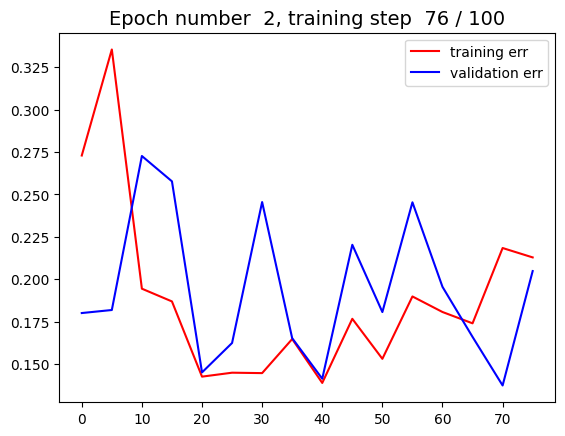

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  80.0 %
80
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80]
[0.27297544479370117, 0.3354904055595398, 0.1944674700498581, 0.18695665895938873, 0.14262162148952484, 0.14494375884532928, 0.14469876885414124, 0.16478446125984192, 0.13890212774276733, 0.1767207384109497, 0.1531188189983368, 0.18989035487174988, 0.1807246059179306, 0.1740468591451645, 0.2184431105852127, 0.2129107266664505, 0.17064133286476135]
[0.18011030554771423, 0.18190328776836395, 0.2726893126964569, 0.25775954127311707, 0.14511430263519287, 0.16246438026428223, 0.24554306268692017, 0.16527670621871948, 0.1413993537425995, 0.22034406661987305, 0.18068958818912506, 0.24539195001125336, 0.19555167853832245, 0.16604238748550415, 0.13741041719913483, 0.20485737919807434, 0.16260197758674622]


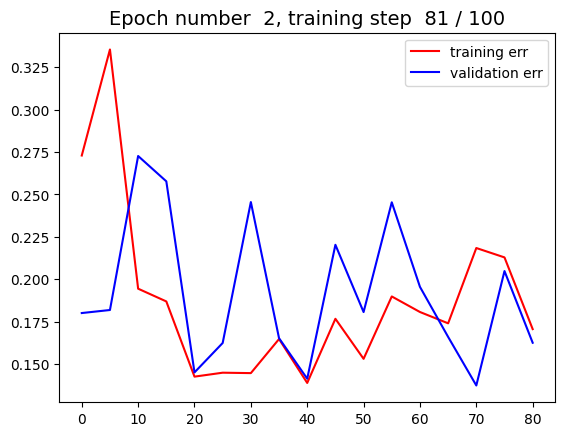

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  85.0 %
85
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85]
[0.27297544479370117, 0.3354904055595398, 0.1944674700498581, 0.18695665895938873, 0.14262162148952484, 0.14494375884532928, 0.14469876885414124, 0.16478446125984192, 0.13890212774276733, 0.1767207384109497, 0.1531188189983368, 0.18989035487174988, 0.1807246059179306, 0.1740468591451645, 0.2184431105852127, 0.2129107266664505, 0.17064133286476135, 0.15967009961605072]
[0.18011030554771423, 0.18190328776836395, 0.2726893126964569, 0.25775954127311707, 0.14511430263519287, 0.16246438026428223, 0.24554306268692017, 0.16527670621871948, 0.1413993537425995, 0.22034406661987305, 0.18068958818912506, 0.24539195001125336, 0.19555167853832245, 0.16604238748550415, 0.13741041719913483, 0.20485737919807434, 0.16260197758674622, 0.13513898849487305]


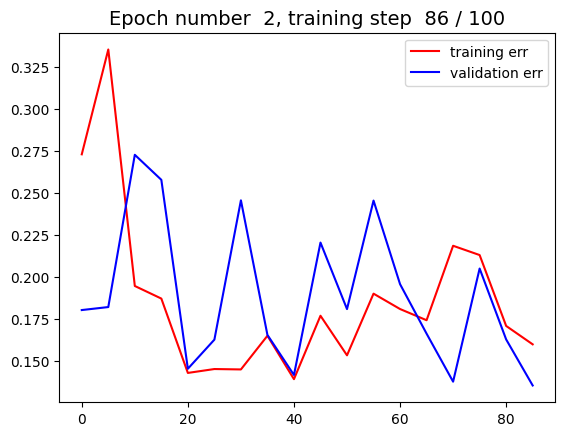

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  90.0 %
90
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90]
[0.27297544479370117, 0.3354904055595398, 0.1944674700498581, 0.18695665895938873, 0.14262162148952484, 0.14494375884532928, 0.14469876885414124, 0.16478446125984192, 0.13890212774276733, 0.1767207384109497, 0.1531188189983368, 0.18989035487174988, 0.1807246059179306, 0.1740468591451645, 0.2184431105852127, 0.2129107266664505, 0.17064133286476135, 0.15967009961605072, 0.1533866822719574]
[0.18011030554771423, 0.18190328776836395, 0.2726893126964569, 0.25775954127311707, 0.14511430263519287, 0.16246438026428223, 0.24554306268692017, 0.16527670621871948, 0.1413993537425995, 0.22034406661987305, 0.18068958818912506, 0.24539195001125336, 0.19555167853832245, 0.16604238748550415, 0.13741041719913483, 0.20485737919807434, 0.16260197758674622, 0.13513898849487305, 0.13841792941093445]


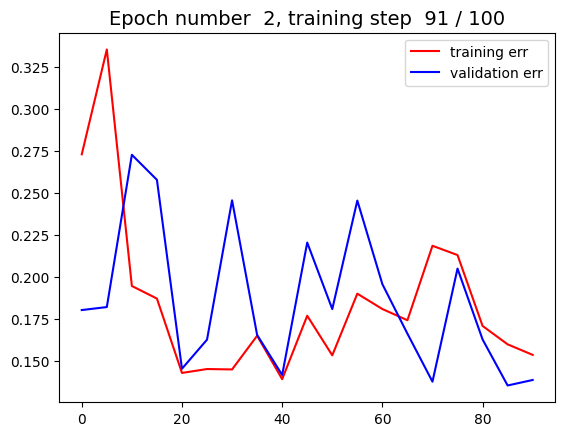

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  95.0 %
95
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95]
[0.27297544479370117, 0.3354904055595398, 0.1944674700498581, 0.18695665895938873, 0.14262162148952484, 0.14494375884532928, 0.14469876885414124, 0.16478446125984192, 0.13890212774276733, 0.1767207384109497, 0.1531188189983368, 0.18989035487174988, 0.1807246059179306, 0.1740468591451645, 0.2184431105852127, 0.2129107266664505, 0.17064133286476135, 0.15967009961605072, 0.1533866822719574, 0.1274740844964981]
[0.18011030554771423, 0.18190328776836395, 0.2726893126964569, 0.25775954127311707, 0.14511430263519287, 0.16246438026428223, 0.24554306268692017, 0.16527670621871948, 0.1413993537425995, 0.22034406661987305, 0.18068958818912506, 0.24539195001125336, 0.19555167853832245, 0.16604238748550415, 0.13741041719913483, 0.20485737919807434, 0.16260197758674622, 0.13513898849487305, 0.13841792941093445, 0

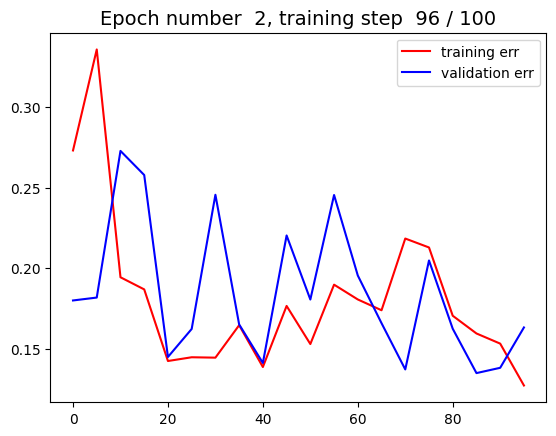

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  100.0 %
100
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
[0.27297544479370117, 0.3354904055595398, 0.1944674700498581, 0.18695665895938873, 0.14262162148952484, 0.14494375884532928, 0.14469876885414124, 0.16478446125984192, 0.13890212774276733, 0.1767207384109497, 0.1531188189983368, 0.18989035487174988, 0.1807246059179306, 0.1740468591451645, 0.2184431105852127, 0.2129107266664505, 0.17064133286476135, 0.15967009961605072, 0.1533866822719574, 0.1274740844964981, 0.1583869308233261]
[0.18011030554771423, 0.18190328776836395, 0.2726893126964569, 0.25775954127311707, 0.14511430263519287, 0.16246438026428223, 0.24554306268692017, 0.16527670621871948, 0.1413993537425995, 0.22034406661987305, 0.18068958818912506, 0.24539195001125336, 0.19555167853832245, 0.16604238748550415, 0.13741041719913483, 0.20485737919807434, 0.16260197758674622, 0.13513898849487

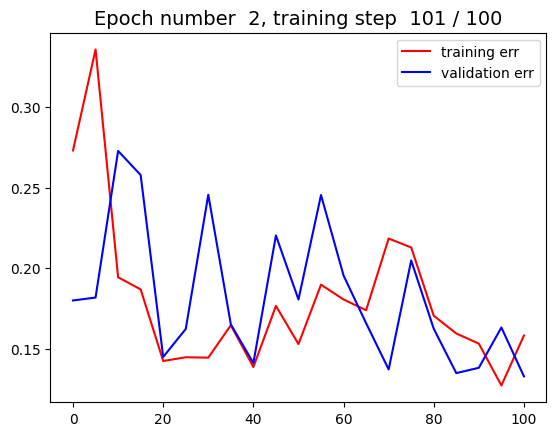

--------------------------------------------
Exiting early, validation error array:  [0.16260198 0.13513899 0.13841793 0.1633943  0.13311428] . Training error array:  [0.17064133 0.1596701  0.15338668 0.12747408 0.15838693]
Completed training for clique = 
Completed training for clique =  55 % correct on test set = [100.0, 100.0] $k/sqrt{n}$ = [6.0, 5.5]
Clique size is now:  50
Epoch number =  1 . Percentage of training completed =  0.0 %
0
[0]
[0.17852576076984406]
[0.19461409747600555]


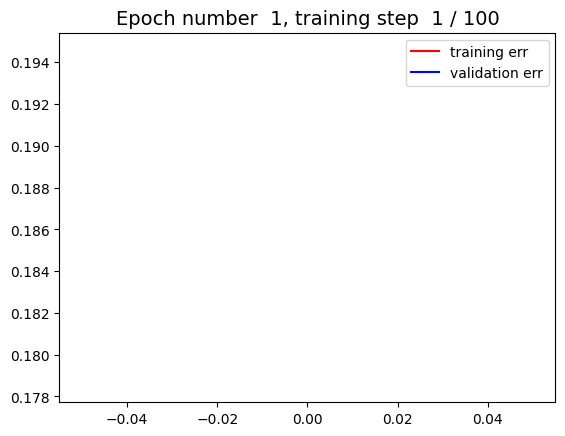

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  5.0 %
5
[0, 5]
[0.17852576076984406, 0.12461437284946442]
[0.19461409747600555, 0.1431826651096344]


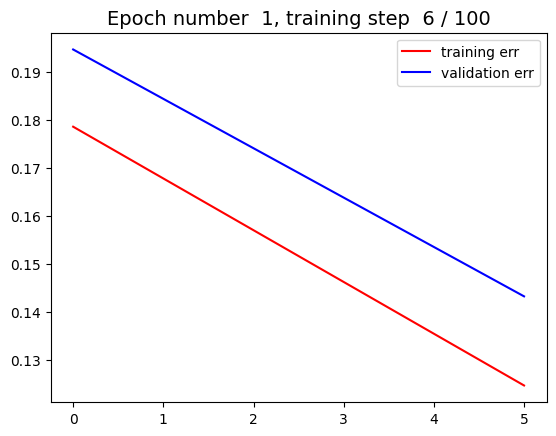

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  10.0 %
10
[0, 5, 10]
[0.17852576076984406, 0.12461437284946442, 0.2746336758136749]
[0.19461409747600555, 0.1431826651096344, 0.2803327739238739]


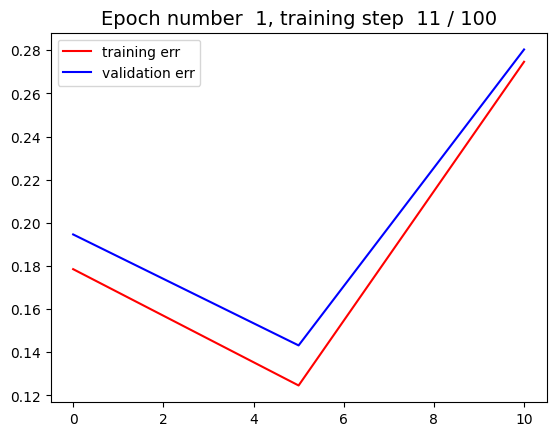

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  15.0 %
15
[0, 5, 10, 15]
[0.17852576076984406, 0.12461437284946442, 0.2746336758136749, 0.30698636174201965]
[0.19461409747600555, 0.1431826651096344, 0.2803327739238739, 0.30615514516830444]


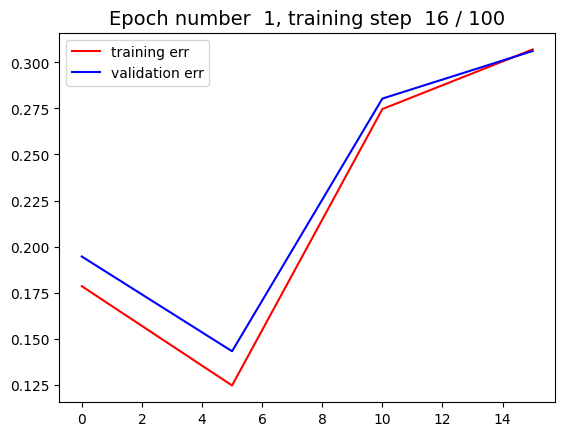

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  20.0 %
20
[0, 5, 10, 15, 20]
[0.17852576076984406, 0.12461437284946442, 0.2746336758136749, 0.30698636174201965, 0.2129882127046585]
[0.19461409747600555, 0.1431826651096344, 0.2803327739238739, 0.30615514516830444, 0.13604386150836945]


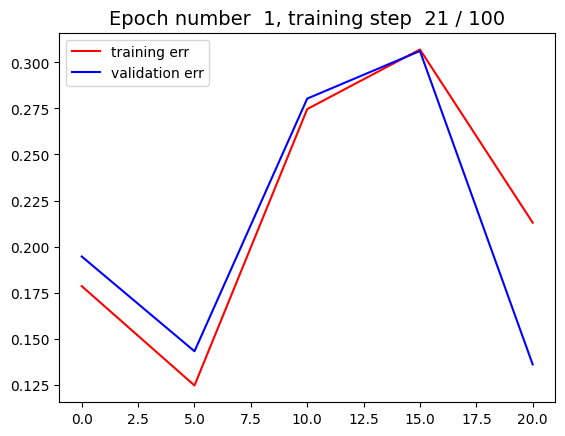

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  25.0 %
25
[0, 5, 10, 15, 20, 25]
[0.17852576076984406, 0.12461437284946442, 0.2746336758136749, 0.30698636174201965, 0.2129882127046585, 0.20207569003105164]
[0.19461409747600555, 0.1431826651096344, 0.2803327739238739, 0.30615514516830444, 0.13604386150836945, 0.20368307828903198]


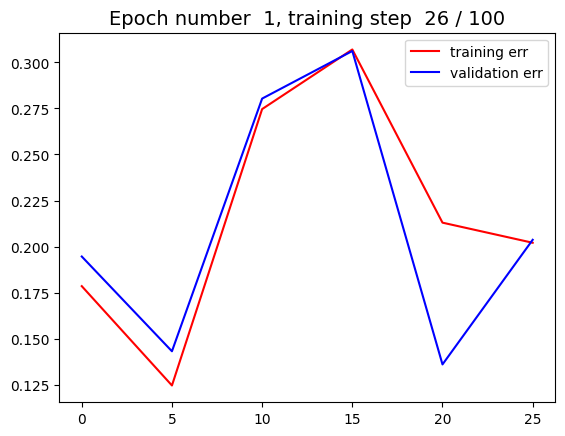

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  30.0 %
30
[0, 5, 10, 15, 20, 25, 30]
[0.17852576076984406, 0.12461437284946442, 0.2746336758136749, 0.30698636174201965, 0.2129882127046585, 0.20207569003105164, 0.1801871508359909]
[0.19461409747600555, 0.1431826651096344, 0.2803327739238739, 0.30615514516830444, 0.13604386150836945, 0.20368307828903198, 0.1951560378074646]


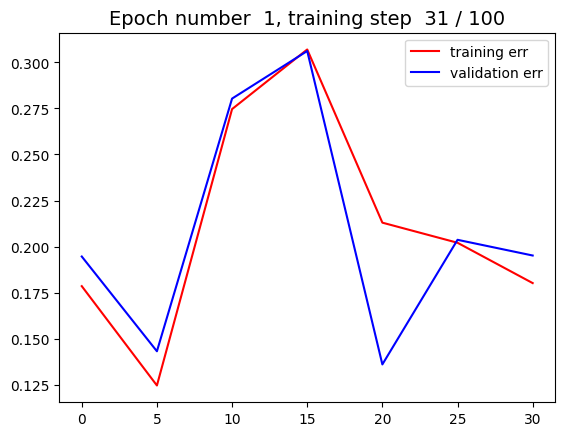

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  35.0 %
35
[0, 5, 10, 15, 20, 25, 30, 35]
[0.17852576076984406, 0.12461437284946442, 0.2746336758136749, 0.30698636174201965, 0.2129882127046585, 0.20207569003105164, 0.1801871508359909, 0.1676337867975235]
[0.19461409747600555, 0.1431826651096344, 0.2803327739238739, 0.30615514516830444, 0.13604386150836945, 0.20368307828903198, 0.1951560378074646, 0.21920739114284515]


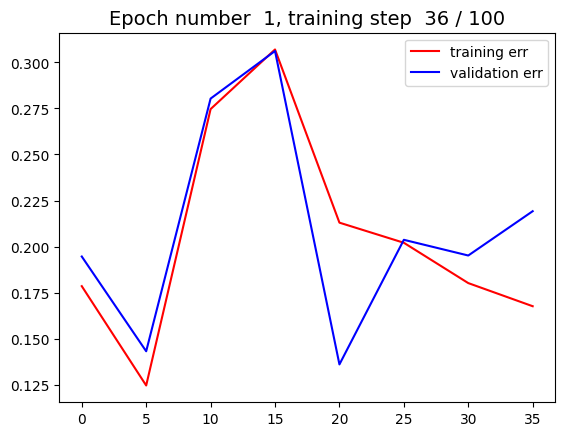

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  40.0 %
40
[0, 5, 10, 15, 20, 25, 30, 35, 40]
[0.17852576076984406, 0.12461437284946442, 0.2746336758136749, 0.30698636174201965, 0.2129882127046585, 0.20207569003105164, 0.1801871508359909, 0.1676337867975235, 0.23747409880161285]
[0.19461409747600555, 0.1431826651096344, 0.2803327739238739, 0.30615514516830444, 0.13604386150836945, 0.20368307828903198, 0.1951560378074646, 0.21920739114284515, 0.19616442918777466]


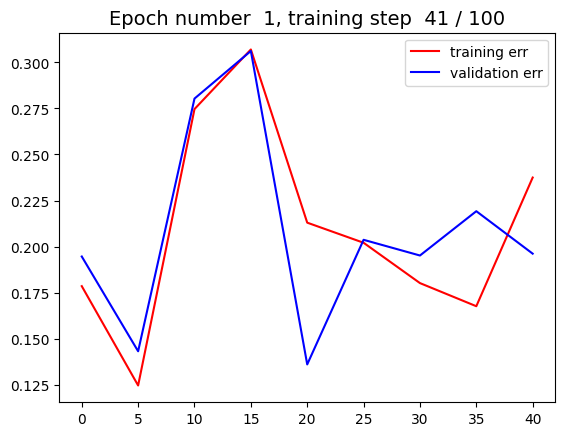

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  45.0 %
45
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
[0.17852576076984406, 0.12461437284946442, 0.2746336758136749, 0.30698636174201965, 0.2129882127046585, 0.20207569003105164, 0.1801871508359909, 0.1676337867975235, 0.23747409880161285, 0.2286064475774765]
[0.19461409747600555, 0.1431826651096344, 0.2803327739238739, 0.30615514516830444, 0.13604386150836945, 0.20368307828903198, 0.1951560378074646, 0.21920739114284515, 0.19616442918777466, 0.23800893127918243]


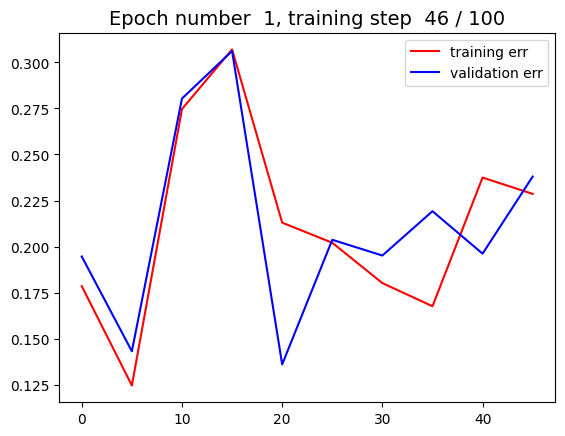

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  50.0 %
50
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]
[0.17852576076984406, 0.12461437284946442, 0.2746336758136749, 0.30698636174201965, 0.2129882127046585, 0.20207569003105164, 0.1801871508359909, 0.1676337867975235, 0.23747409880161285, 0.2286064475774765, 0.22237351536750793]
[0.19461409747600555, 0.1431826651096344, 0.2803327739238739, 0.30615514516830444, 0.13604386150836945, 0.20368307828903198, 0.1951560378074646, 0.21920739114284515, 0.19616442918777466, 0.23800893127918243, 0.147466242313385]


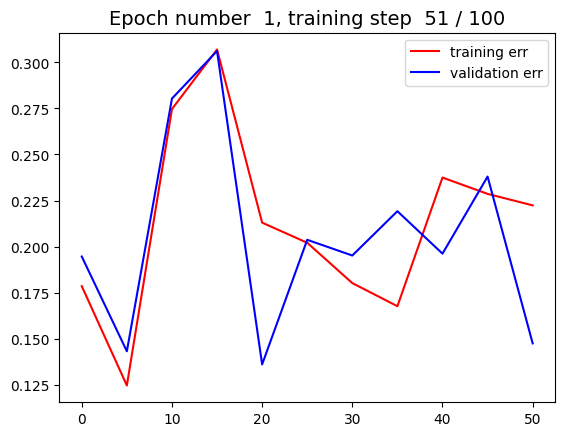

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  55.0 %
55
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55]
[0.17852576076984406, 0.12461437284946442, 0.2746336758136749, 0.30698636174201965, 0.2129882127046585, 0.20207569003105164, 0.1801871508359909, 0.1676337867975235, 0.23747409880161285, 0.2286064475774765, 0.22237351536750793, 0.2444126307964325]
[0.19461409747600555, 0.1431826651096344, 0.2803327739238739, 0.30615514516830444, 0.13604386150836945, 0.20368307828903198, 0.1951560378074646, 0.21920739114284515, 0.19616442918777466, 0.23800893127918243, 0.147466242313385, 0.1335771530866623]


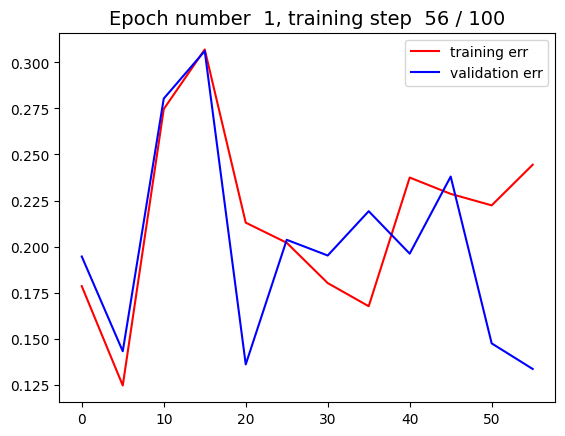

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  60.0 %
60
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]
[0.17852576076984406, 0.12461437284946442, 0.2746336758136749, 0.30698636174201965, 0.2129882127046585, 0.20207569003105164, 0.1801871508359909, 0.1676337867975235, 0.23747409880161285, 0.2286064475774765, 0.22237351536750793, 0.2444126307964325, 0.15730738639831543]
[0.19461409747600555, 0.1431826651096344, 0.2803327739238739, 0.30615514516830444, 0.13604386150836945, 0.20368307828903198, 0.1951560378074646, 0.21920739114284515, 0.19616442918777466, 0.23800893127918243, 0.147466242313385, 0.1335771530866623, 0.13828885555267334]


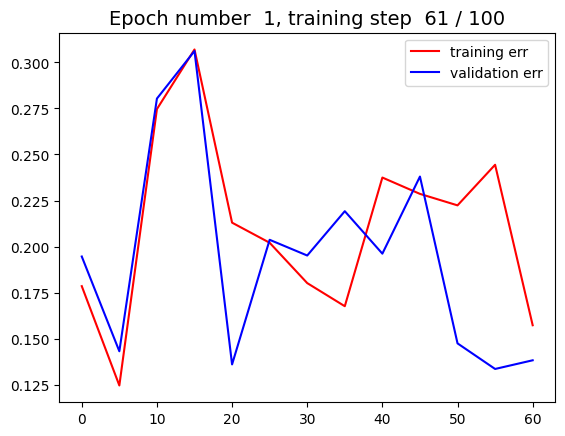

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  65.0 %
65
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65]
[0.17852576076984406, 0.12461437284946442, 0.2746336758136749, 0.30698636174201965, 0.2129882127046585, 0.20207569003105164, 0.1801871508359909, 0.1676337867975235, 0.23747409880161285, 0.2286064475774765, 0.22237351536750793, 0.2444126307964325, 0.15730738639831543, 0.14069704711437225]
[0.19461409747600555, 0.1431826651096344, 0.2803327739238739, 0.30615514516830444, 0.13604386150836945, 0.20368307828903198, 0.1951560378074646, 0.21920739114284515, 0.19616442918777466, 0.23800893127918243, 0.147466242313385, 0.1335771530866623, 0.13828885555267334, 0.22932259738445282]


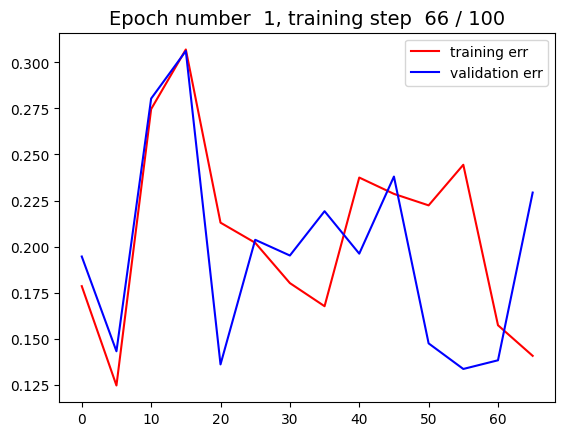

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  70.0 %
70
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70]
[0.17852576076984406, 0.12461437284946442, 0.2746336758136749, 0.30698636174201965, 0.2129882127046585, 0.20207569003105164, 0.1801871508359909, 0.1676337867975235, 0.23747409880161285, 0.2286064475774765, 0.22237351536750793, 0.2444126307964325, 0.15730738639831543, 0.14069704711437225, 0.24423742294311523]
[0.19461409747600555, 0.1431826651096344, 0.2803327739238739, 0.30615514516830444, 0.13604386150836945, 0.20368307828903198, 0.1951560378074646, 0.21920739114284515, 0.19616442918777466, 0.23800893127918243, 0.147466242313385, 0.1335771530866623, 0.13828885555267334, 0.22932259738445282, 0.21209855377674103]


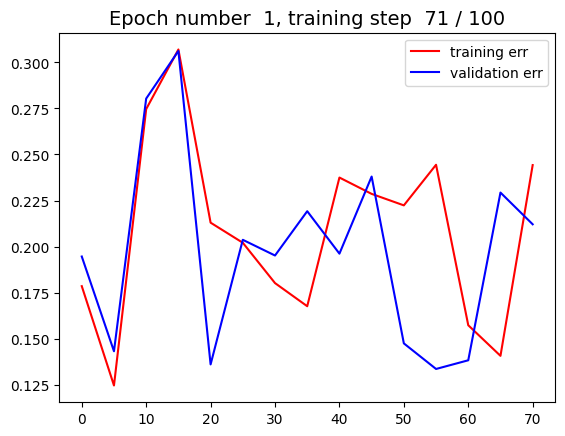

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  75.0 %
75
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75]
[0.17852576076984406, 0.12461437284946442, 0.2746336758136749, 0.30698636174201965, 0.2129882127046585, 0.20207569003105164, 0.1801871508359909, 0.1676337867975235, 0.23747409880161285, 0.2286064475774765, 0.22237351536750793, 0.2444126307964325, 0.15730738639831543, 0.14069704711437225, 0.24423742294311523, 0.2119675725698471]
[0.19461409747600555, 0.1431826651096344, 0.2803327739238739, 0.30615514516830444, 0.13604386150836945, 0.20368307828903198, 0.1951560378074646, 0.21920739114284515, 0.19616442918777466, 0.23800893127918243, 0.147466242313385, 0.1335771530866623, 0.13828885555267334, 0.22932259738445282, 0.21209855377674103, 0.25398626923561096]


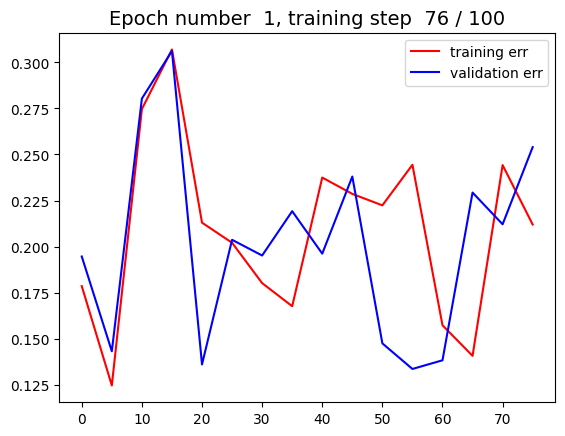

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  80.0 %
80
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80]
[0.17852576076984406, 0.12461437284946442, 0.2746336758136749, 0.30698636174201965, 0.2129882127046585, 0.20207569003105164, 0.1801871508359909, 0.1676337867975235, 0.23747409880161285, 0.2286064475774765, 0.22237351536750793, 0.2444126307964325, 0.15730738639831543, 0.14069704711437225, 0.24423742294311523, 0.2119675725698471, 0.236918643116951]
[0.19461409747600555, 0.1431826651096344, 0.2803327739238739, 0.30615514516830444, 0.13604386150836945, 0.20368307828903198, 0.1951560378074646, 0.21920739114284515, 0.19616442918777466, 0.23800893127918243, 0.147466242313385, 0.1335771530866623, 0.13828885555267334, 0.22932259738445282, 0.21209855377674103, 0.25398626923561096, 0.2096591293811798]


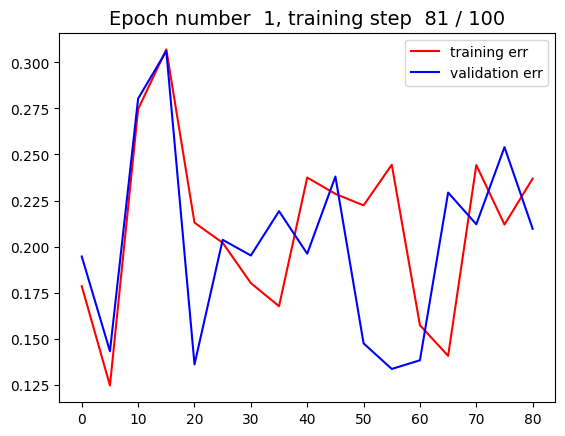

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  85.0 %
85
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85]
[0.17852576076984406, 0.12461437284946442, 0.2746336758136749, 0.30698636174201965, 0.2129882127046585, 0.20207569003105164, 0.1801871508359909, 0.1676337867975235, 0.23747409880161285, 0.2286064475774765, 0.22237351536750793, 0.2444126307964325, 0.15730738639831543, 0.14069704711437225, 0.24423742294311523, 0.2119675725698471, 0.236918643116951, 0.15848217904567719]
[0.19461409747600555, 0.1431826651096344, 0.2803327739238739, 0.30615514516830444, 0.13604386150836945, 0.20368307828903198, 0.1951560378074646, 0.21920739114284515, 0.19616442918777466, 0.23800893127918243, 0.147466242313385, 0.1335771530866623, 0.13828885555267334, 0.22932259738445282, 0.21209855377674103, 0.25398626923561096, 0.2096591293811798, 0.3788377046585083]


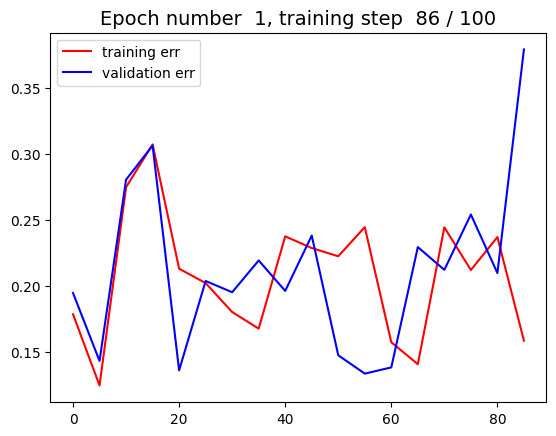

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  90.0 %
90
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90]
[0.17852576076984406, 0.12461437284946442, 0.2746336758136749, 0.30698636174201965, 0.2129882127046585, 0.20207569003105164, 0.1801871508359909, 0.1676337867975235, 0.23747409880161285, 0.2286064475774765, 0.22237351536750793, 0.2444126307964325, 0.15730738639831543, 0.14069704711437225, 0.24423742294311523, 0.2119675725698471, 0.236918643116951, 0.15848217904567719, 0.24282206594944]
[0.19461409747600555, 0.1431826651096344, 0.2803327739238739, 0.30615514516830444, 0.13604386150836945, 0.20368307828903198, 0.1951560378074646, 0.21920739114284515, 0.19616442918777466, 0.23800893127918243, 0.147466242313385, 0.1335771530866623, 0.13828885555267334, 0.22932259738445282, 0.21209855377674103, 0.25398626923561096, 0.2096591293811798, 0.3788377046585083, 0.3583943545818329]


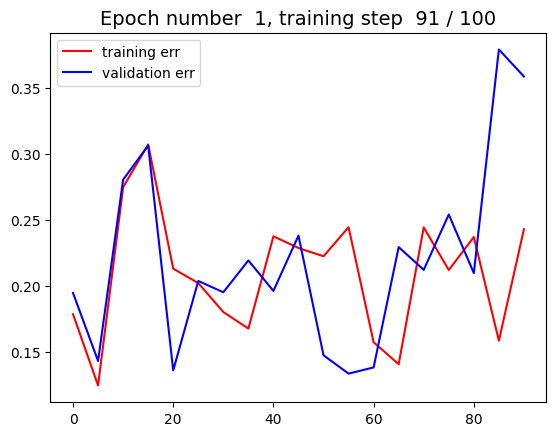

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  95.0 %
95
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95]
[0.17852576076984406, 0.12461437284946442, 0.2746336758136749, 0.30698636174201965, 0.2129882127046585, 0.20207569003105164, 0.1801871508359909, 0.1676337867975235, 0.23747409880161285, 0.2286064475774765, 0.22237351536750793, 0.2444126307964325, 0.15730738639831543, 0.14069704711437225, 0.24423742294311523, 0.2119675725698471, 0.236918643116951, 0.15848217904567719, 0.24282206594944, 0.1990944743156433]
[0.19461409747600555, 0.1431826651096344, 0.2803327739238739, 0.30615514516830444, 0.13604386150836945, 0.20368307828903198, 0.1951560378074646, 0.21920739114284515, 0.19616442918777466, 0.23800893127918243, 0.147466242313385, 0.1335771530866623, 0.13828885555267334, 0.22932259738445282, 0.21209855377674103, 0.25398626923561096, 0.2096591293811798, 0.3788377046585083, 0.3583943545818329, 0.262232333

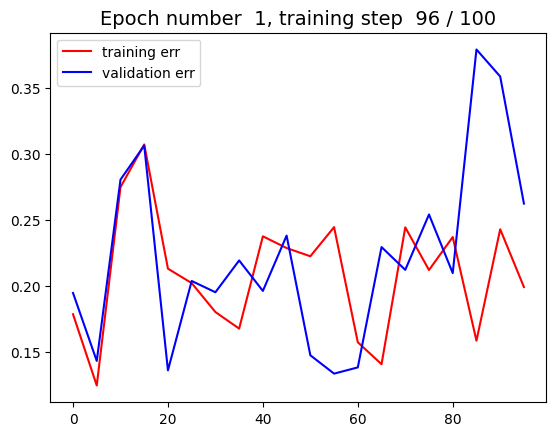

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  100.0 %
100
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
[0.17852576076984406, 0.12461437284946442, 0.2746336758136749, 0.30698636174201965, 0.2129882127046585, 0.20207569003105164, 0.1801871508359909, 0.1676337867975235, 0.23747409880161285, 0.2286064475774765, 0.22237351536750793, 0.2444126307964325, 0.15730738639831543, 0.14069704711437225, 0.24423742294311523, 0.2119675725698471, 0.236918643116951, 0.15848217904567719, 0.24282206594944, 0.1990944743156433, 0.25765278935432434]
[0.19461409747600555, 0.1431826651096344, 0.2803327739238739, 0.30615514516830444, 0.13604386150836945, 0.20368307828903198, 0.1951560378074646, 0.21920739114284515, 0.19616442918777466, 0.23800893127918243, 0.147466242313385, 0.1335771530866623, 0.13828885555267334, 0.22932259738445282, 0.21209855377674103, 0.25398626923561096, 0.2096591293811798, 0.3788377046585083, 0.3

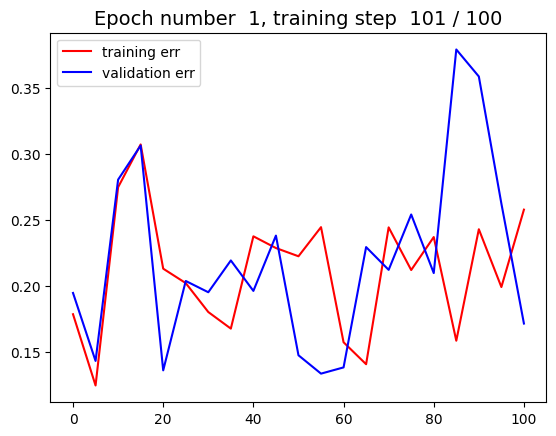

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  0.0 %
0
[0]
[0.23251092433929443]
[0.15310390293598175]


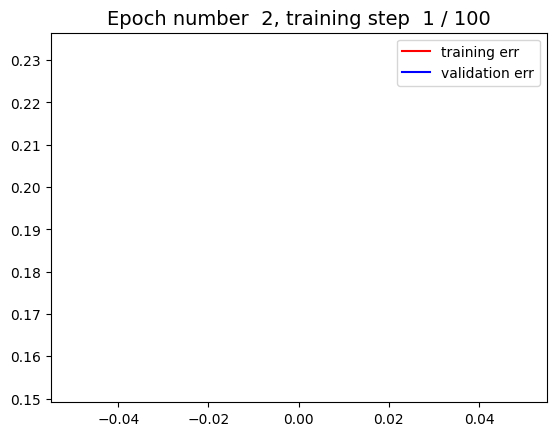

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  5.0 %
5
[0, 5]
[0.23251092433929443, 0.24099422991275787]
[0.15310390293598175, 0.18551962077617645]


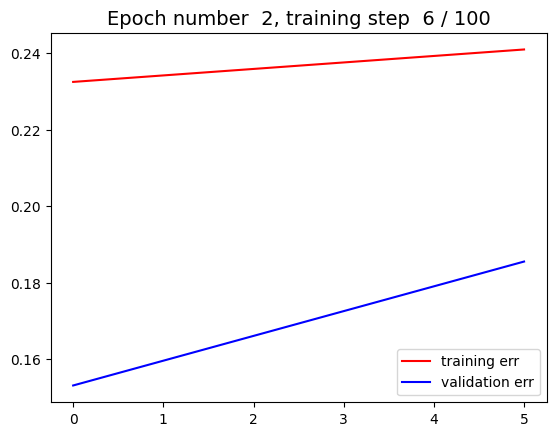

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  10.0 %
10
[0, 5, 10]
[0.23251092433929443, 0.24099422991275787, 0.15655319392681122]
[0.15310390293598175, 0.18551962077617645, 0.1811022162437439]


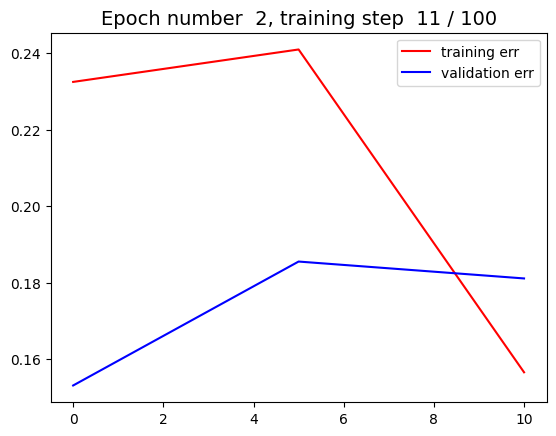

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  15.0 %
15
[0, 5, 10, 15]
[0.23251092433929443, 0.24099422991275787, 0.15655319392681122, 0.15264101326465607]
[0.15310390293598175, 0.18551962077617645, 0.1811022162437439, 0.1735982894897461]


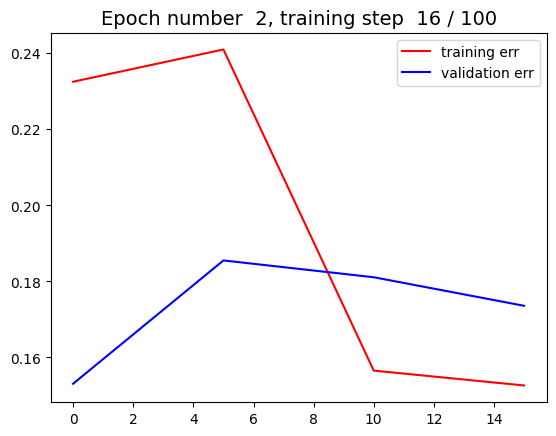

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  20.0 %
20
[0, 5, 10, 15, 20]
[0.23251092433929443, 0.24099422991275787, 0.15655319392681122, 0.15264101326465607, 0.19124513864517212]
[0.15310390293598175, 0.18551962077617645, 0.1811022162437439, 0.1735982894897461, 0.13484340906143188]


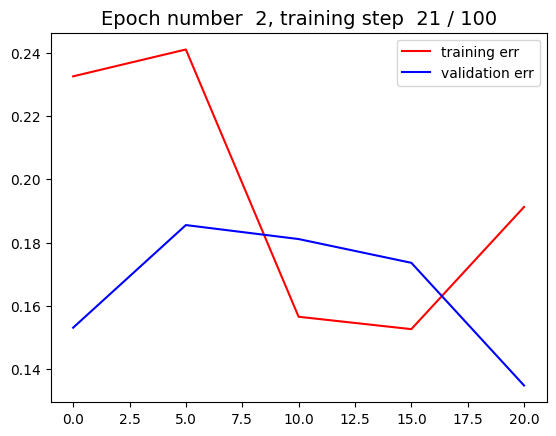

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  25.0 %
25
[0, 5, 10, 15, 20, 25]
[0.23251092433929443, 0.24099422991275787, 0.15655319392681122, 0.15264101326465607, 0.19124513864517212, 0.13203111290931702]
[0.15310390293598175, 0.18551962077617645, 0.1811022162437439, 0.1735982894897461, 0.13484340906143188, 0.15444287657737732]


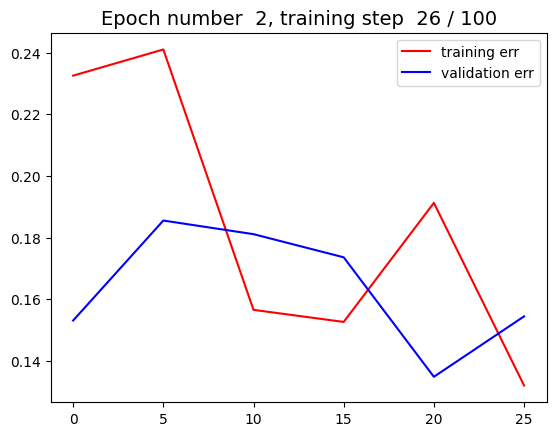

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  30.0 %
30
[0, 5, 10, 15, 20, 25, 30]
[0.23251092433929443, 0.24099422991275787, 0.15655319392681122, 0.15264101326465607, 0.19124513864517212, 0.13203111290931702, 0.21026626229286194]
[0.15310390293598175, 0.18551962077617645, 0.1811022162437439, 0.1735982894897461, 0.13484340906143188, 0.15444287657737732, 0.26770541071891785]


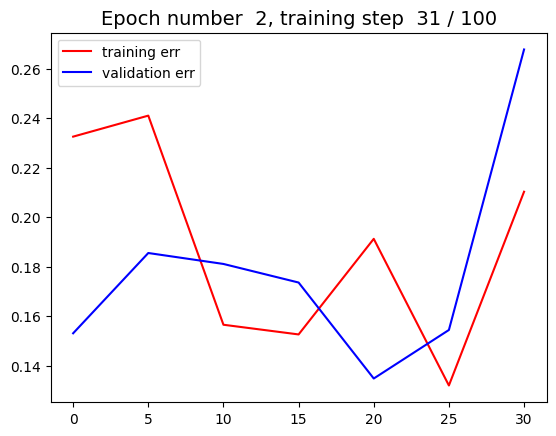

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  35.0 %
35
[0, 5, 10, 15, 20, 25, 30, 35]
[0.23251092433929443, 0.24099422991275787, 0.15655319392681122, 0.15264101326465607, 0.19124513864517212, 0.13203111290931702, 0.21026626229286194, 0.11684054136276245]
[0.15310390293598175, 0.18551962077617645, 0.1811022162437439, 0.1735982894897461, 0.13484340906143188, 0.15444287657737732, 0.26770541071891785, 0.14096736907958984]


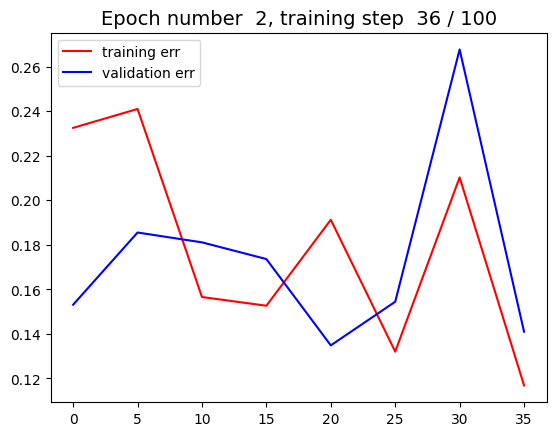

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  40.0 %
40
[0, 5, 10, 15, 20, 25, 30, 35, 40]
[0.23251092433929443, 0.24099422991275787, 0.15655319392681122, 0.15264101326465607, 0.19124513864517212, 0.13203111290931702, 0.21026626229286194, 0.11684054136276245, 0.16307051479816437]
[0.15310390293598175, 0.18551962077617645, 0.1811022162437439, 0.1735982894897461, 0.13484340906143188, 0.15444287657737732, 0.26770541071891785, 0.14096736907958984, 0.25320085883140564]


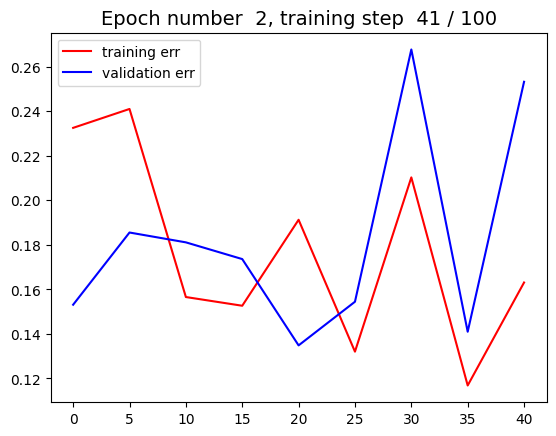

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  45.0 %
45
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
[0.23251092433929443, 0.24099422991275787, 0.15655319392681122, 0.15264101326465607, 0.19124513864517212, 0.13203111290931702, 0.21026626229286194, 0.11684054136276245, 0.16307051479816437, 0.14598338305950165]
[0.15310390293598175, 0.18551962077617645, 0.1811022162437439, 0.1735982894897461, 0.13484340906143188, 0.15444287657737732, 0.26770541071891785, 0.14096736907958984, 0.25320085883140564, 0.13345883786678314]


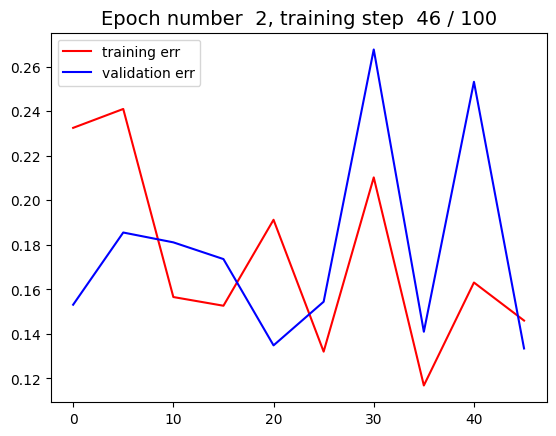

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  50.0 %
50
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]
[0.23251092433929443, 0.24099422991275787, 0.15655319392681122, 0.15264101326465607, 0.19124513864517212, 0.13203111290931702, 0.21026626229286194, 0.11684054136276245, 0.16307051479816437, 0.14598338305950165, 0.24826401472091675]
[0.15310390293598175, 0.18551962077617645, 0.1811022162437439, 0.1735982894897461, 0.13484340906143188, 0.15444287657737732, 0.26770541071891785, 0.14096736907958984, 0.25320085883140564, 0.13345883786678314, 0.12479551136493683]


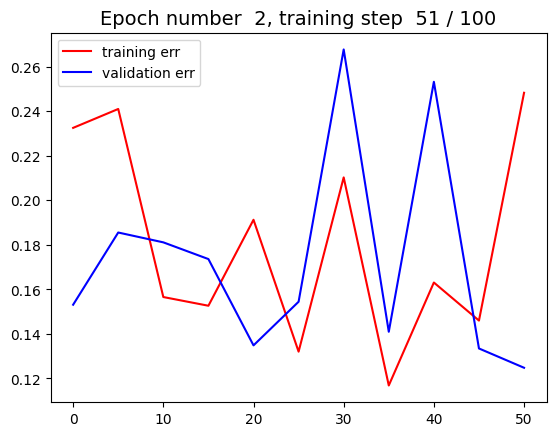

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  55.0 %
55
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55]
[0.23251092433929443, 0.24099422991275787, 0.15655319392681122, 0.15264101326465607, 0.19124513864517212, 0.13203111290931702, 0.21026626229286194, 0.11684054136276245, 0.16307051479816437, 0.14598338305950165, 0.24826401472091675, 0.31559744477272034]
[0.15310390293598175, 0.18551962077617645, 0.1811022162437439, 0.1735982894897461, 0.13484340906143188, 0.15444287657737732, 0.26770541071891785, 0.14096736907958984, 0.25320085883140564, 0.13345883786678314, 0.12479551136493683, 0.12449372559785843]


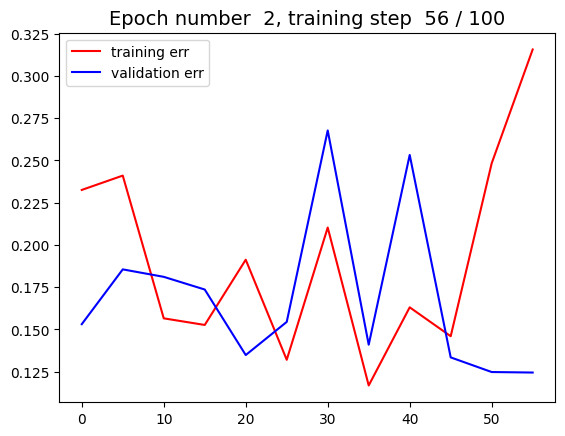

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  60.0 %
60
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]
[0.23251092433929443, 0.24099422991275787, 0.15655319392681122, 0.15264101326465607, 0.19124513864517212, 0.13203111290931702, 0.21026626229286194, 0.11684054136276245, 0.16307051479816437, 0.14598338305950165, 0.24826401472091675, 0.31559744477272034, 0.12014158070087433]
[0.15310390293598175, 0.18551962077617645, 0.1811022162437439, 0.1735982894897461, 0.13484340906143188, 0.15444287657737732, 0.26770541071891785, 0.14096736907958984, 0.25320085883140564, 0.13345883786678314, 0.12479551136493683, 0.12449372559785843, 0.2283271998167038]


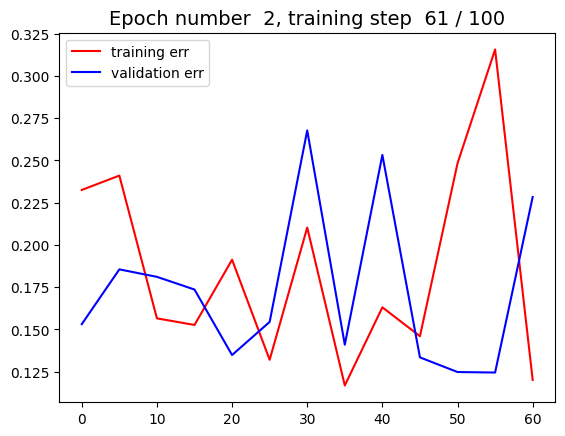

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  65.0 %
65
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65]
[0.23251092433929443, 0.24099422991275787, 0.15655319392681122, 0.15264101326465607, 0.19124513864517212, 0.13203111290931702, 0.21026626229286194, 0.11684054136276245, 0.16307051479816437, 0.14598338305950165, 0.24826401472091675, 0.31559744477272034, 0.12014158070087433, 0.14805810153484344]
[0.15310390293598175, 0.18551962077617645, 0.1811022162437439, 0.1735982894897461, 0.13484340906143188, 0.15444287657737732, 0.26770541071891785, 0.14096736907958984, 0.25320085883140564, 0.13345883786678314, 0.12479551136493683, 0.12449372559785843, 0.2283271998167038, 0.1953052282333374]


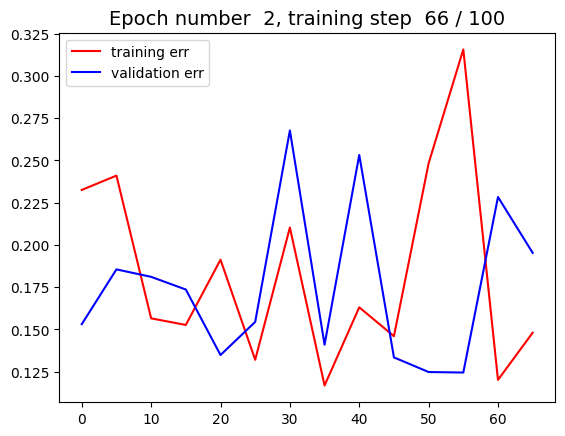

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  70.0 %
70
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70]
[0.23251092433929443, 0.24099422991275787, 0.15655319392681122, 0.15264101326465607, 0.19124513864517212, 0.13203111290931702, 0.21026626229286194, 0.11684054136276245, 0.16307051479816437, 0.14598338305950165, 0.24826401472091675, 0.31559744477272034, 0.12014158070087433, 0.14805810153484344, 0.16436907649040222]
[0.15310390293598175, 0.18551962077617645, 0.1811022162437439, 0.1735982894897461, 0.13484340906143188, 0.15444287657737732, 0.26770541071891785, 0.14096736907958984, 0.25320085883140564, 0.13345883786678314, 0.12479551136493683, 0.12449372559785843, 0.2283271998167038, 0.1953052282333374, 0.18104781210422516]


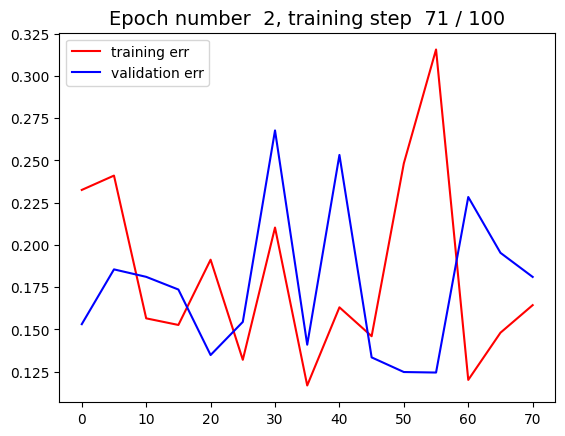

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  75.0 %
75
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75]
[0.23251092433929443, 0.24099422991275787, 0.15655319392681122, 0.15264101326465607, 0.19124513864517212, 0.13203111290931702, 0.21026626229286194, 0.11684054136276245, 0.16307051479816437, 0.14598338305950165, 0.24826401472091675, 0.31559744477272034, 0.12014158070087433, 0.14805810153484344, 0.16436907649040222, 0.2839473783969879]
[0.15310390293598175, 0.18551962077617645, 0.1811022162437439, 0.1735982894897461, 0.13484340906143188, 0.15444287657737732, 0.26770541071891785, 0.14096736907958984, 0.25320085883140564, 0.13345883786678314, 0.12479551136493683, 0.12449372559785843, 0.2283271998167038, 0.1953052282333374, 0.18104781210422516, 0.25692155957221985]


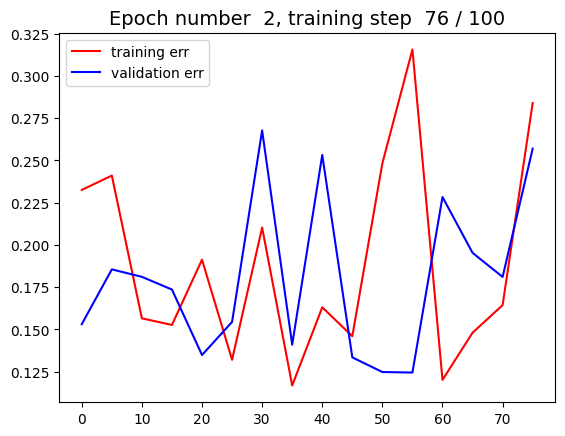

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  80.0 %
80
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80]
[0.23251092433929443, 0.24099422991275787, 0.15655319392681122, 0.15264101326465607, 0.19124513864517212, 0.13203111290931702, 0.21026626229286194, 0.11684054136276245, 0.16307051479816437, 0.14598338305950165, 0.24826401472091675, 0.31559744477272034, 0.12014158070087433, 0.14805810153484344, 0.16436907649040222, 0.2839473783969879, 0.15513049066066742]
[0.15310390293598175, 0.18551962077617645, 0.1811022162437439, 0.1735982894897461, 0.13484340906143188, 0.15444287657737732, 0.26770541071891785, 0.14096736907958984, 0.25320085883140564, 0.13345883786678314, 0.12479551136493683, 0.12449372559785843, 0.2283271998167038, 0.1953052282333374, 0.18104781210422516, 0.25692155957221985, 0.15291495621204376]


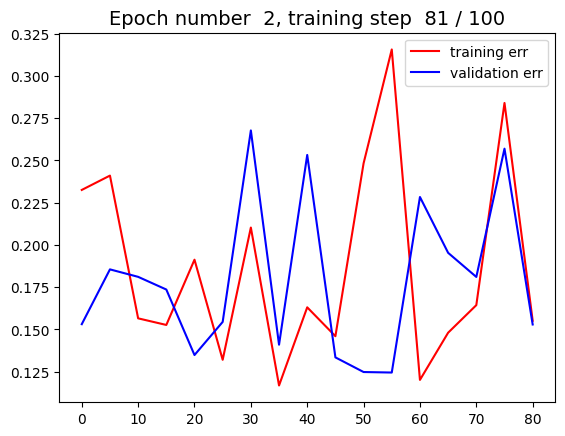

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  85.0 %
85
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85]
[0.23251092433929443, 0.24099422991275787, 0.15655319392681122, 0.15264101326465607, 0.19124513864517212, 0.13203111290931702, 0.21026626229286194, 0.11684054136276245, 0.16307051479816437, 0.14598338305950165, 0.24826401472091675, 0.31559744477272034, 0.12014158070087433, 0.14805810153484344, 0.16436907649040222, 0.2839473783969879, 0.15513049066066742, 0.1595143973827362]
[0.15310390293598175, 0.18551962077617645, 0.1811022162437439, 0.1735982894897461, 0.13484340906143188, 0.15444287657737732, 0.26770541071891785, 0.14096736907958984, 0.25320085883140564, 0.13345883786678314, 0.12479551136493683, 0.12449372559785843, 0.2283271998167038, 0.1953052282333374, 0.18104781210422516, 0.25692155957221985, 0.15291495621204376, 0.13950027525424957]


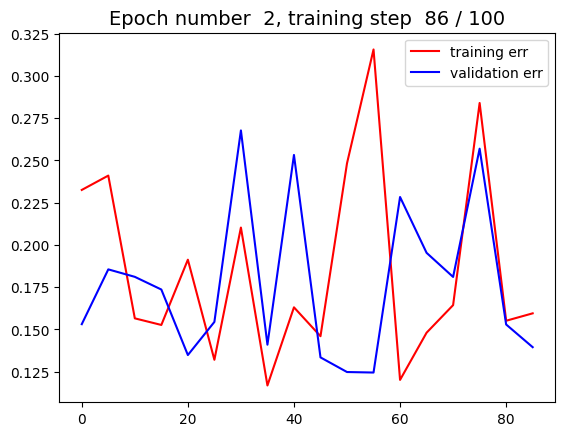

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  90.0 %
90
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90]
[0.23251092433929443, 0.24099422991275787, 0.15655319392681122, 0.15264101326465607, 0.19124513864517212, 0.13203111290931702, 0.21026626229286194, 0.11684054136276245, 0.16307051479816437, 0.14598338305950165, 0.24826401472091675, 0.31559744477272034, 0.12014158070087433, 0.14805810153484344, 0.16436907649040222, 0.2839473783969879, 0.15513049066066742, 0.1595143973827362, 0.20218536257743835]
[0.15310390293598175, 0.18551962077617645, 0.1811022162437439, 0.1735982894897461, 0.13484340906143188, 0.15444287657737732, 0.26770541071891785, 0.14096736907958984, 0.25320085883140564, 0.13345883786678314, 0.12479551136493683, 0.12449372559785843, 0.2283271998167038, 0.1953052282333374, 0.18104781210422516, 0.25692155957221985, 0.15291495621204376, 0.13950027525424957, 0.23124609887599945]


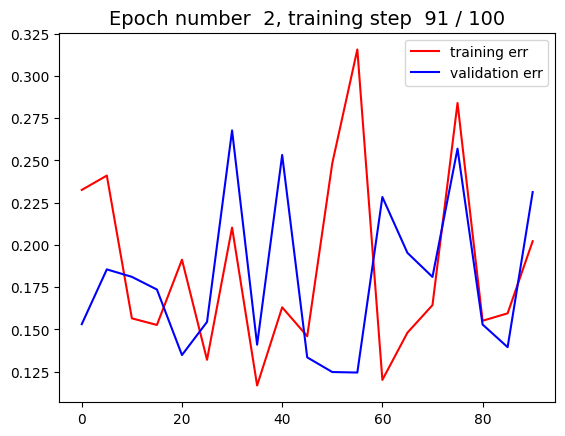

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  95.0 %
95
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95]
[0.23251092433929443, 0.24099422991275787, 0.15655319392681122, 0.15264101326465607, 0.19124513864517212, 0.13203111290931702, 0.21026626229286194, 0.11684054136276245, 0.16307051479816437, 0.14598338305950165, 0.24826401472091675, 0.31559744477272034, 0.12014158070087433, 0.14805810153484344, 0.16436907649040222, 0.2839473783969879, 0.15513049066066742, 0.1595143973827362, 0.20218536257743835, 0.12191440165042877]
[0.15310390293598175, 0.18551962077617645, 0.1811022162437439, 0.1735982894897461, 0.13484340906143188, 0.15444287657737732, 0.26770541071891785, 0.14096736907958984, 0.25320085883140564, 0.13345883786678314, 0.12479551136493683, 0.12449372559785843, 0.2283271998167038, 0.1953052282333374, 0.18104781210422516, 0.25692155957221985, 0.15291495621204376, 0.13950027525424957, 0.23124609887599

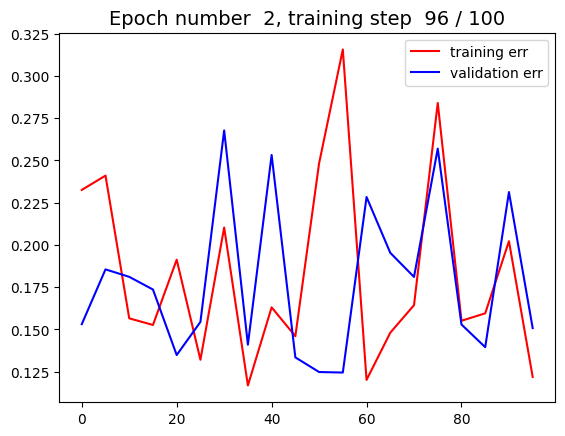

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  100.0 %
100
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
[0.23251092433929443, 0.24099422991275787, 0.15655319392681122, 0.15264101326465607, 0.19124513864517212, 0.13203111290931702, 0.21026626229286194, 0.11684054136276245, 0.16307051479816437, 0.14598338305950165, 0.24826401472091675, 0.31559744477272034, 0.12014158070087433, 0.14805810153484344, 0.16436907649040222, 0.2839473783969879, 0.15513049066066742, 0.1595143973827362, 0.20218536257743835, 0.12191440165042877, 0.18772582709789276]
[0.15310390293598175, 0.18551962077617645, 0.1811022162437439, 0.1735982894897461, 0.13484340906143188, 0.15444287657737732, 0.26770541071891785, 0.14096736907958984, 0.25320085883140564, 0.13345883786678314, 0.12479551136493683, 0.12449372559785843, 0.2283271998167038, 0.1953052282333374, 0.18104781210422516, 0.25692155957221985, 0.15291495621204376, 0.1395002

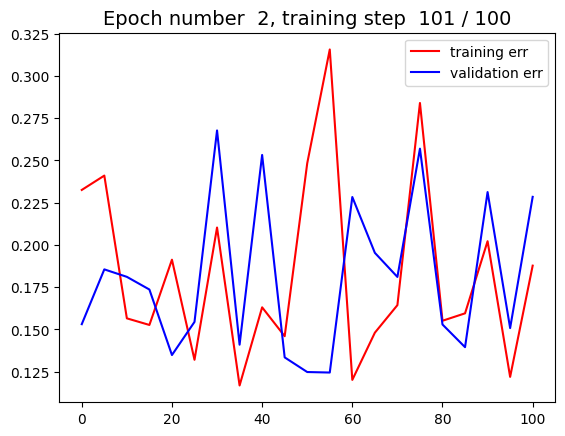

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  0.0 %
0
[0]
[0.2791348695755005]
[0.15189820528030396]


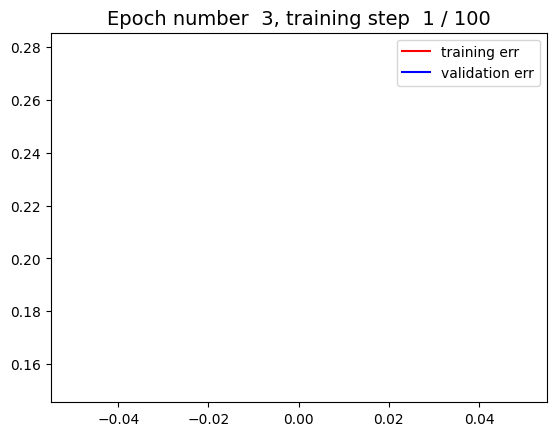

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  5.0 %
5
[0, 5]
[0.2791348695755005, 0.22331182658672333]
[0.15189820528030396, 0.14716696739196777]


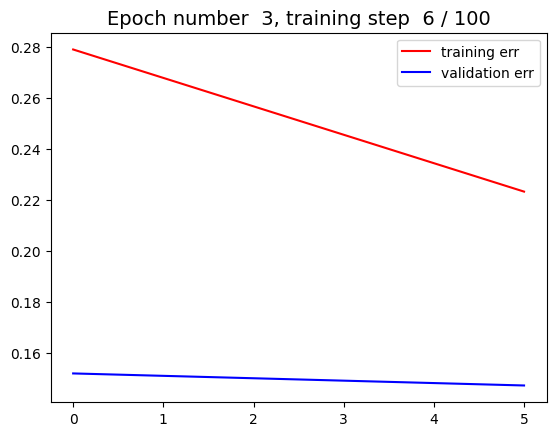

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  10.0 %
10
[0, 5, 10]
[0.2791348695755005, 0.22331182658672333, 0.19347114861011505]
[0.15189820528030396, 0.14716696739196777, 0.18098531663417816]


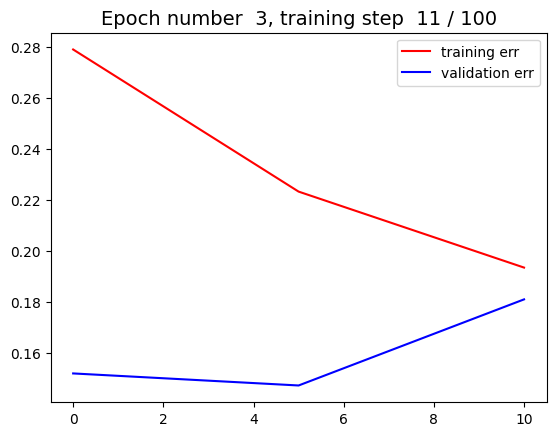

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  15.0 %
15
[0, 5, 10, 15]
[0.2791348695755005, 0.22331182658672333, 0.19347114861011505, 0.13371680676937103]
[0.15189820528030396, 0.14716696739196777, 0.18098531663417816, 0.15282483398914337]


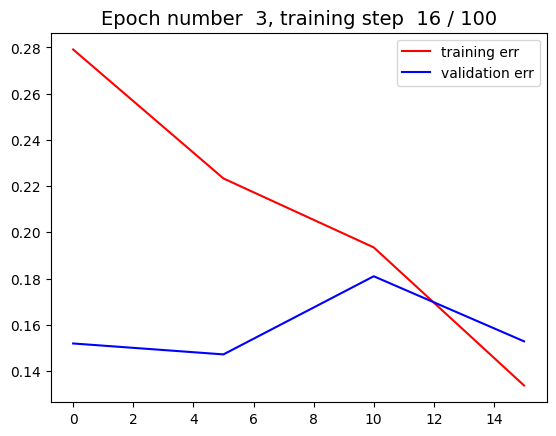

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  20.0 %
20
[0, 5, 10, 15, 20]
[0.2791348695755005, 0.22331182658672333, 0.19347114861011505, 0.13371680676937103, 0.1835695207118988]
[0.15189820528030396, 0.14716696739196777, 0.18098531663417816, 0.15282483398914337, 0.15129037201404572]


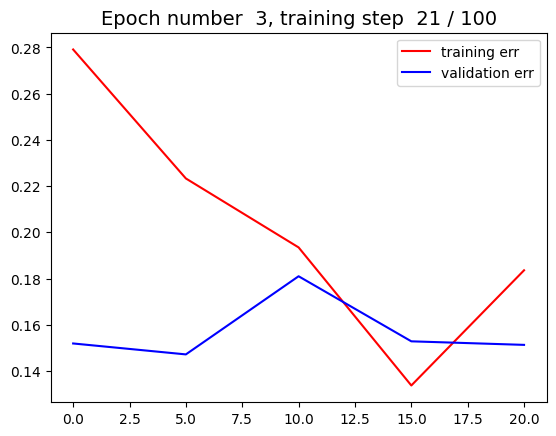

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  25.0 %
25
[0, 5, 10, 15, 20, 25]
[0.2791348695755005, 0.22331182658672333, 0.19347114861011505, 0.13371680676937103, 0.1835695207118988, 0.16297170519828796]
[0.15189820528030396, 0.14716696739196777, 0.18098531663417816, 0.15282483398914337, 0.15129037201404572, 0.22722354531288147]


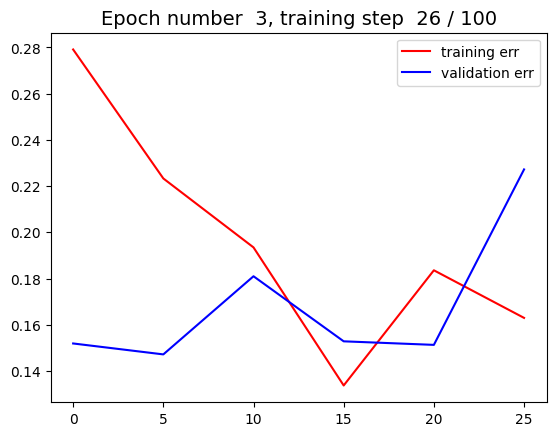

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  30.0 %
30
[0, 5, 10, 15, 20, 25, 30]
[0.2791348695755005, 0.22331182658672333, 0.19347114861011505, 0.13371680676937103, 0.1835695207118988, 0.16297170519828796, 0.11122974753379822]
[0.15189820528030396, 0.14716696739196777, 0.18098531663417816, 0.15282483398914337, 0.15129037201404572, 0.22722354531288147, 0.12772460281848907]


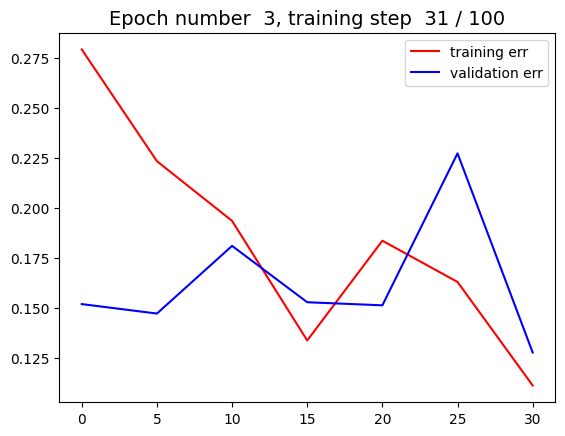

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  35.0 %
35
[0, 5, 10, 15, 20, 25, 30, 35]
[0.2791348695755005, 0.22331182658672333, 0.19347114861011505, 0.13371680676937103, 0.1835695207118988, 0.16297170519828796, 0.11122974753379822, 0.2684601843357086]
[0.15189820528030396, 0.14716696739196777, 0.18098531663417816, 0.15282483398914337, 0.15129037201404572, 0.22722354531288147, 0.12772460281848907, 0.2390093207359314]


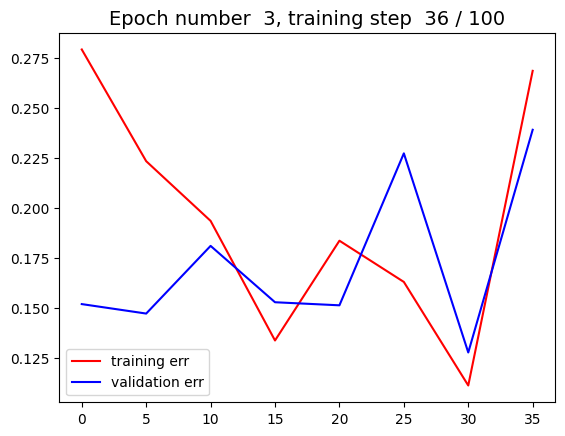

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  40.0 %
40
[0, 5, 10, 15, 20, 25, 30, 35, 40]
[0.2791348695755005, 0.22331182658672333, 0.19347114861011505, 0.13371680676937103, 0.1835695207118988, 0.16297170519828796, 0.11122974753379822, 0.2684601843357086, 0.19645282626152039]
[0.15189820528030396, 0.14716696739196777, 0.18098531663417816, 0.15282483398914337, 0.15129037201404572, 0.22722354531288147, 0.12772460281848907, 0.2390093207359314, 0.19433878362178802]


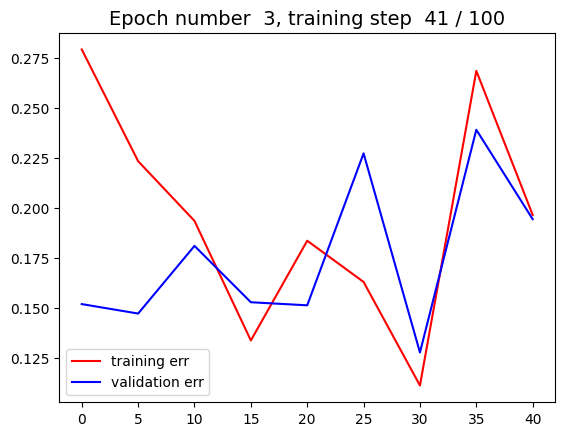

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  45.0 %
45
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
[0.2791348695755005, 0.22331182658672333, 0.19347114861011505, 0.13371680676937103, 0.1835695207118988, 0.16297170519828796, 0.11122974753379822, 0.2684601843357086, 0.19645282626152039, 0.11024357378482819]
[0.15189820528030396, 0.14716696739196777, 0.18098531663417816, 0.15282483398914337, 0.15129037201404572, 0.22722354531288147, 0.12772460281848907, 0.2390093207359314, 0.19433878362178802, 0.18104331195354462]


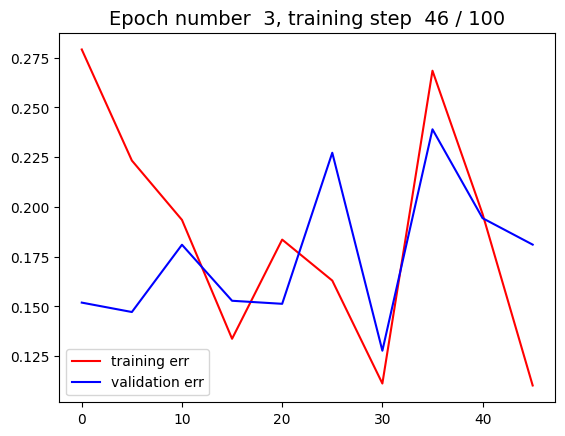

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  50.0 %
50
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]
[0.2791348695755005, 0.22331182658672333, 0.19347114861011505, 0.13371680676937103, 0.1835695207118988, 0.16297170519828796, 0.11122974753379822, 0.2684601843357086, 0.19645282626152039, 0.11024357378482819, 0.10729778558015823]
[0.15189820528030396, 0.14716696739196777, 0.18098531663417816, 0.15282483398914337, 0.15129037201404572, 0.22722354531288147, 0.12772460281848907, 0.2390093207359314, 0.19433878362178802, 0.18104331195354462, 0.11901237070560455]


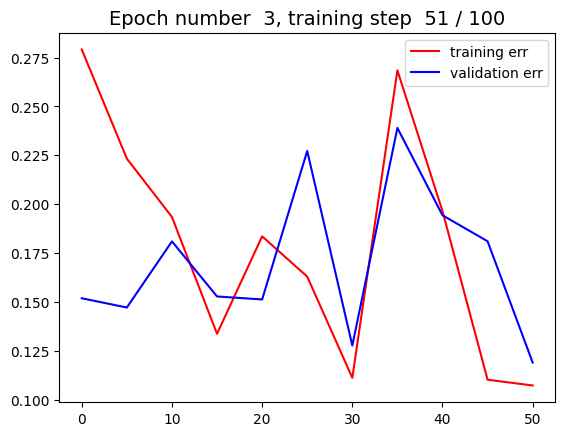

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  55.0 %
55
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55]
[0.2791348695755005, 0.22331182658672333, 0.19347114861011505, 0.13371680676937103, 0.1835695207118988, 0.16297170519828796, 0.11122974753379822, 0.2684601843357086, 0.19645282626152039, 0.11024357378482819, 0.10729778558015823, 0.1484731137752533]
[0.15189820528030396, 0.14716696739196777, 0.18098531663417816, 0.15282483398914337, 0.15129037201404572, 0.22722354531288147, 0.12772460281848907, 0.2390093207359314, 0.19433878362178802, 0.18104331195354462, 0.11901237070560455, 0.0989043191075325]


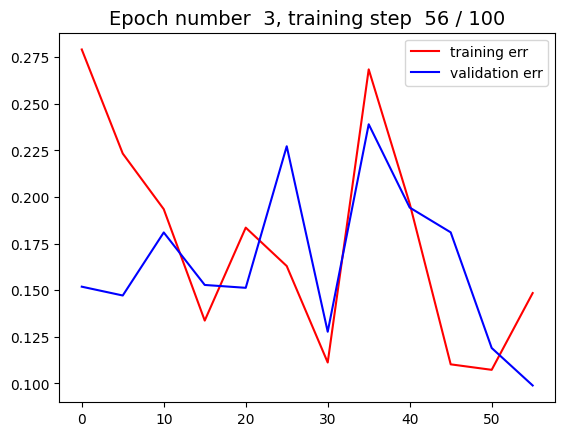

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  60.0 %
60
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]
[0.2791348695755005, 0.22331182658672333, 0.19347114861011505, 0.13371680676937103, 0.1835695207118988, 0.16297170519828796, 0.11122974753379822, 0.2684601843357086, 0.19645282626152039, 0.11024357378482819, 0.10729778558015823, 0.1484731137752533, 0.11854558438062668]
[0.15189820528030396, 0.14716696739196777, 0.18098531663417816, 0.15282483398914337, 0.15129037201404572, 0.22722354531288147, 0.12772460281848907, 0.2390093207359314, 0.19433878362178802, 0.18104331195354462, 0.11901237070560455, 0.0989043191075325, 0.22451801598072052]


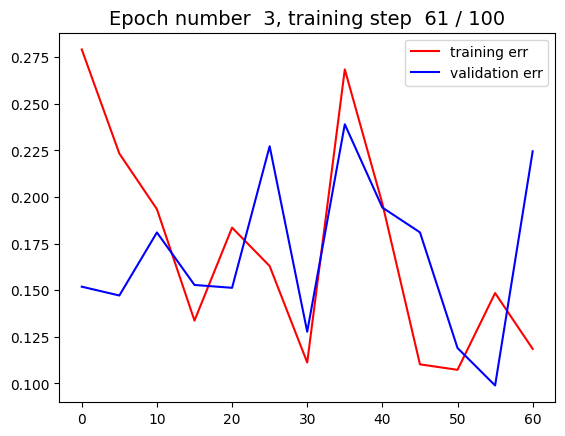

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  65.0 %
65
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65]
[0.2791348695755005, 0.22331182658672333, 0.19347114861011505, 0.13371680676937103, 0.1835695207118988, 0.16297170519828796, 0.11122974753379822, 0.2684601843357086, 0.19645282626152039, 0.11024357378482819, 0.10729778558015823, 0.1484731137752533, 0.11854558438062668, 0.12823794782161713]
[0.15189820528030396, 0.14716696739196777, 0.18098531663417816, 0.15282483398914337, 0.15129037201404572, 0.22722354531288147, 0.12772460281848907, 0.2390093207359314, 0.19433878362178802, 0.18104331195354462, 0.11901237070560455, 0.0989043191075325, 0.22451801598072052, 0.13492707908153534]


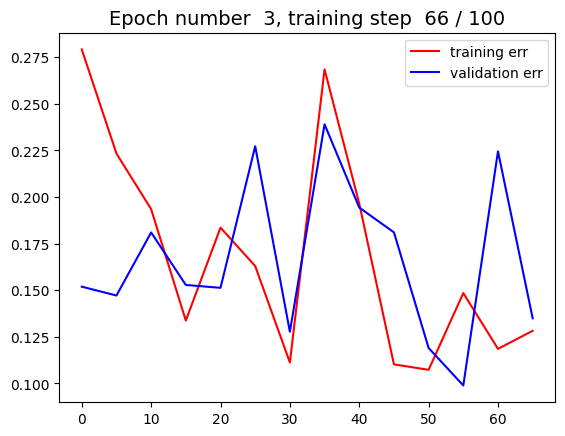

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  70.0 %
70
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70]
[0.2791348695755005, 0.22331182658672333, 0.19347114861011505, 0.13371680676937103, 0.1835695207118988, 0.16297170519828796, 0.11122974753379822, 0.2684601843357086, 0.19645282626152039, 0.11024357378482819, 0.10729778558015823, 0.1484731137752533, 0.11854558438062668, 0.12823794782161713, 0.1649618148803711]
[0.15189820528030396, 0.14716696739196777, 0.18098531663417816, 0.15282483398914337, 0.15129037201404572, 0.22722354531288147, 0.12772460281848907, 0.2390093207359314, 0.19433878362178802, 0.18104331195354462, 0.11901237070560455, 0.0989043191075325, 0.22451801598072052, 0.13492707908153534, 0.14276304841041565]


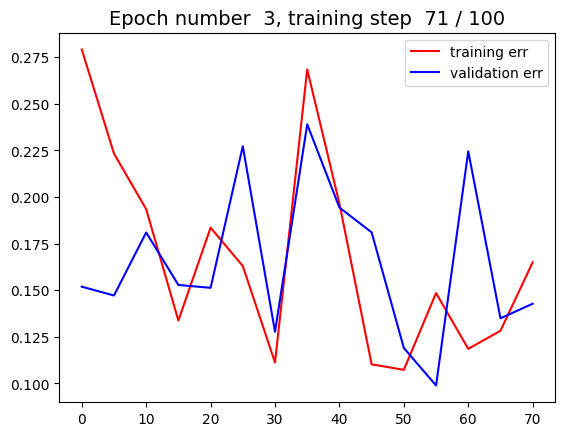

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  75.0 %
75
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75]
[0.2791348695755005, 0.22331182658672333, 0.19347114861011505, 0.13371680676937103, 0.1835695207118988, 0.16297170519828796, 0.11122974753379822, 0.2684601843357086, 0.19645282626152039, 0.11024357378482819, 0.10729778558015823, 0.1484731137752533, 0.11854558438062668, 0.12823794782161713, 0.1649618148803711, 0.10425006598234177]
[0.15189820528030396, 0.14716696739196777, 0.18098531663417816, 0.15282483398914337, 0.15129037201404572, 0.22722354531288147, 0.12772460281848907, 0.2390093207359314, 0.19433878362178802, 0.18104331195354462, 0.11901237070560455, 0.0989043191075325, 0.22451801598072052, 0.13492707908153534, 0.14276304841041565, 0.17406044900417328]


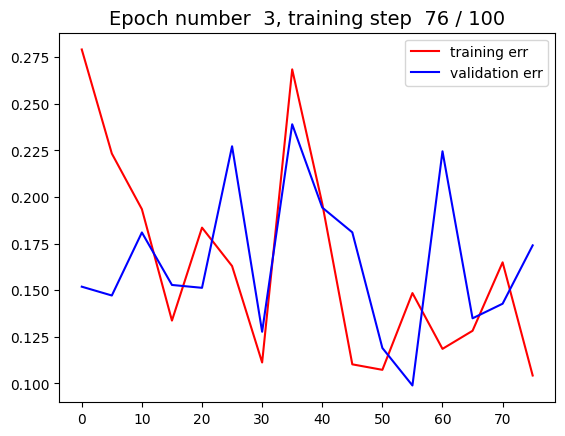

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  80.0 %
80
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80]
[0.2791348695755005, 0.22331182658672333, 0.19347114861011505, 0.13371680676937103, 0.1835695207118988, 0.16297170519828796, 0.11122974753379822, 0.2684601843357086, 0.19645282626152039, 0.11024357378482819, 0.10729778558015823, 0.1484731137752533, 0.11854558438062668, 0.12823794782161713, 0.1649618148803711, 0.10425006598234177, 0.22337128221988678]
[0.15189820528030396, 0.14716696739196777, 0.18098531663417816, 0.15282483398914337, 0.15129037201404572, 0.22722354531288147, 0.12772460281848907, 0.2390093207359314, 0.19433878362178802, 0.18104331195354462, 0.11901237070560455, 0.0989043191075325, 0.22451801598072052, 0.13492707908153534, 0.14276304841041565, 0.17406044900417328, 0.10363359749317169]


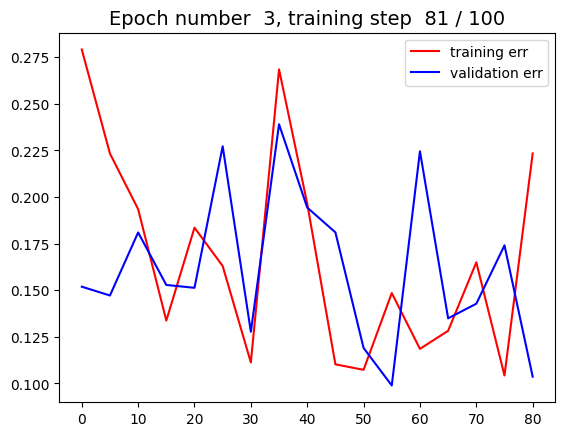

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  85.0 %
85
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85]
[0.2791348695755005, 0.22331182658672333, 0.19347114861011505, 0.13371680676937103, 0.1835695207118988, 0.16297170519828796, 0.11122974753379822, 0.2684601843357086, 0.19645282626152039, 0.11024357378482819, 0.10729778558015823, 0.1484731137752533, 0.11854558438062668, 0.12823794782161713, 0.1649618148803711, 0.10425006598234177, 0.22337128221988678, 0.10519878566265106]
[0.15189820528030396, 0.14716696739196777, 0.18098531663417816, 0.15282483398914337, 0.15129037201404572, 0.22722354531288147, 0.12772460281848907, 0.2390093207359314, 0.19433878362178802, 0.18104331195354462, 0.11901237070560455, 0.0989043191075325, 0.22451801598072052, 0.13492707908153534, 0.14276304841041565, 0.17406044900417328, 0.10363359749317169, 0.1406158059835434]


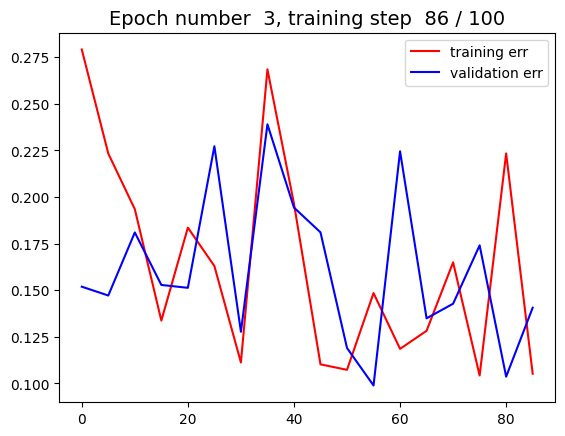

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  90.0 %
90
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90]
[0.2791348695755005, 0.22331182658672333, 0.19347114861011505, 0.13371680676937103, 0.1835695207118988, 0.16297170519828796, 0.11122974753379822, 0.2684601843357086, 0.19645282626152039, 0.11024357378482819, 0.10729778558015823, 0.1484731137752533, 0.11854558438062668, 0.12823794782161713, 0.1649618148803711, 0.10425006598234177, 0.22337128221988678, 0.10519878566265106, 0.1313571184873581]
[0.15189820528030396, 0.14716696739196777, 0.18098531663417816, 0.15282483398914337, 0.15129037201404572, 0.22722354531288147, 0.12772460281848907, 0.2390093207359314, 0.19433878362178802, 0.18104331195354462, 0.11901237070560455, 0.0989043191075325, 0.22451801598072052, 0.13492707908153534, 0.14276304841041565, 0.17406044900417328, 0.10363359749317169, 0.1406158059835434, 0.17075428366661072]


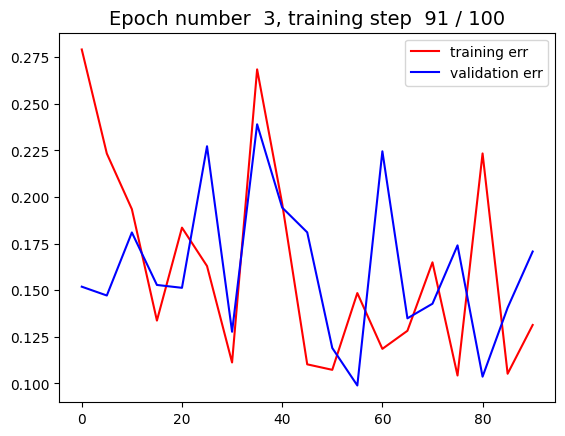

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  95.0 %
95
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95]
[0.2791348695755005, 0.22331182658672333, 0.19347114861011505, 0.13371680676937103, 0.1835695207118988, 0.16297170519828796, 0.11122974753379822, 0.2684601843357086, 0.19645282626152039, 0.11024357378482819, 0.10729778558015823, 0.1484731137752533, 0.11854558438062668, 0.12823794782161713, 0.1649618148803711, 0.10425006598234177, 0.22337128221988678, 0.10519878566265106, 0.1313571184873581, 0.2005493938922882]
[0.15189820528030396, 0.14716696739196777, 0.18098531663417816, 0.15282483398914337, 0.15129037201404572, 0.22722354531288147, 0.12772460281848907, 0.2390093207359314, 0.19433878362178802, 0.18104331195354462, 0.11901237070560455, 0.0989043191075325, 0.22451801598072052, 0.13492707908153534, 0.14276304841041565, 0.17406044900417328, 0.10363359749317169, 0.1406158059835434, 0.17075428366661072,

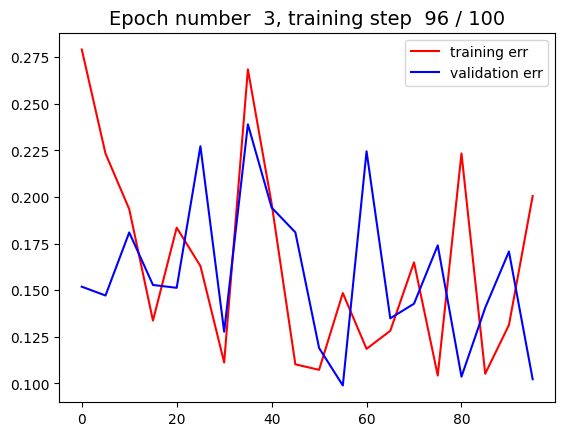

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  100.0 %
100
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
[0.2791348695755005, 0.22331182658672333, 0.19347114861011505, 0.13371680676937103, 0.1835695207118988, 0.16297170519828796, 0.11122974753379822, 0.2684601843357086, 0.19645282626152039, 0.11024357378482819, 0.10729778558015823, 0.1484731137752533, 0.11854558438062668, 0.12823794782161713, 0.1649618148803711, 0.10425006598234177, 0.22337128221988678, 0.10519878566265106, 0.1313571184873581, 0.2005493938922882, 0.19593068957328796]
[0.15189820528030396, 0.14716696739196777, 0.18098531663417816, 0.15282483398914337, 0.15129037201404572, 0.22722354531288147, 0.12772460281848907, 0.2390093207359314, 0.19433878362178802, 0.18104331195354462, 0.11901237070560455, 0.0989043191075325, 0.22451801598072052, 0.13492707908153534, 0.14276304841041565, 0.17406044900417328, 0.10363359749317169, 0.1406158059

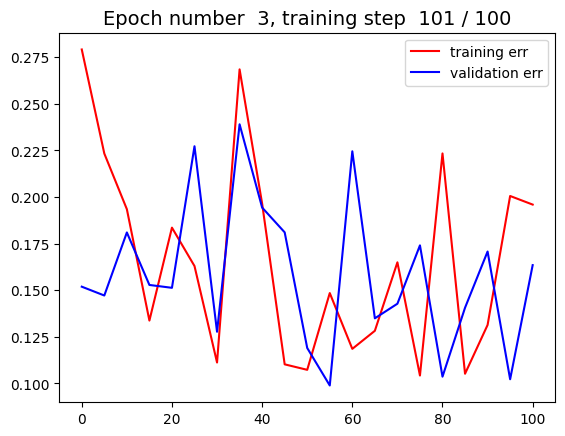

--------------------------------------------
Exiting early, validation error array:  [0.1036336  0.14061581 0.17075428 0.10223914 0.16345932] . Training error array:  [0.22337128 0.10519879 0.13135712 0.20054939 0.19593069]
Completed training for clique = 
Completed training for clique =  50 % correct on test set = [100.0, 100.0, 87.5] $k/sqrt{n}$ = [6.0, 5.5, 5.0]
Clique size is now:  45
Epoch number =  1 . Percentage of training completed =  0.0 %
0
[0]
[0.25628897547721863]
[0.1578013002872467]


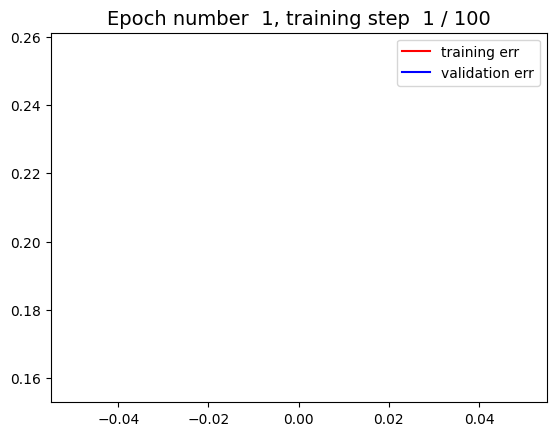

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  5.0 %
5
[0, 5]
[0.25628897547721863, 0.10176907479763031]
[0.1578013002872467, 0.21246367692947388]


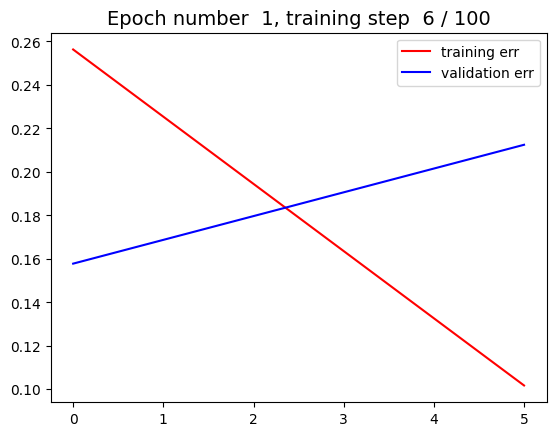

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  10.0 %
10
[0, 5, 10]
[0.25628897547721863, 0.10176907479763031, 0.18133707344532013]
[0.1578013002872467, 0.21246367692947388, 0.2897399961948395]


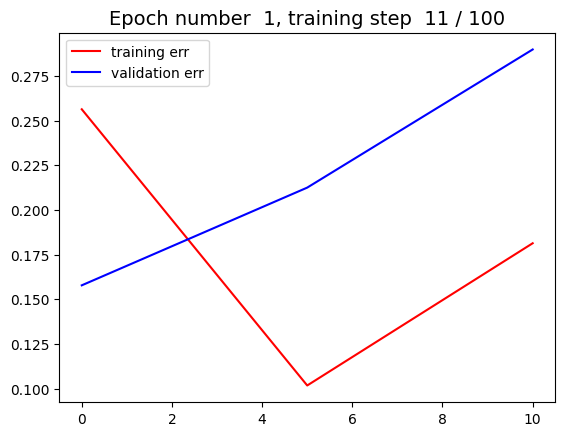

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  15.0 %
15
[0, 5, 10, 15]
[0.25628897547721863, 0.10176907479763031, 0.18133707344532013, 0.12121916562318802]
[0.1578013002872467, 0.21246367692947388, 0.2897399961948395, 0.23631717264652252]


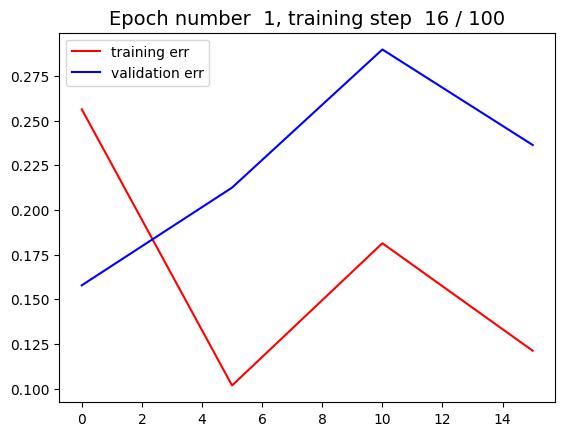

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  20.0 %
20
[0, 5, 10, 15, 20]
[0.25628897547721863, 0.10176907479763031, 0.18133707344532013, 0.12121916562318802, 0.21036766469478607]
[0.1578013002872467, 0.21246367692947388, 0.2897399961948395, 0.23631717264652252, 0.21568968892097473]


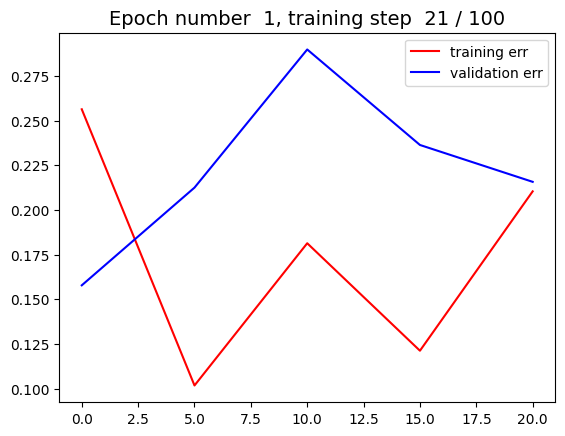

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  25.0 %
25
[0, 5, 10, 15, 20, 25]
[0.25628897547721863, 0.10176907479763031, 0.18133707344532013, 0.12121916562318802, 0.21036766469478607, 0.1502210795879364]
[0.1578013002872467, 0.21246367692947388, 0.2897399961948395, 0.23631717264652252, 0.21568968892097473, 0.24074946343898773]


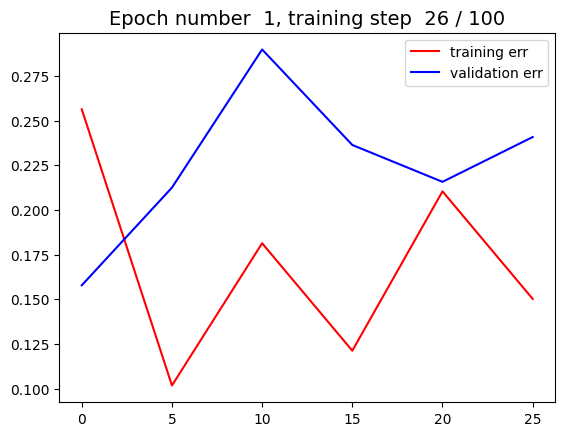

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  30.0 %
30
[0, 5, 10, 15, 20, 25, 30]
[0.25628897547721863, 0.10176907479763031, 0.18133707344532013, 0.12121916562318802, 0.21036766469478607, 0.1502210795879364, 0.3152165710926056]
[0.1578013002872467, 0.21246367692947388, 0.2897399961948395, 0.23631717264652252, 0.21568968892097473, 0.24074946343898773, 0.17504064738750458]


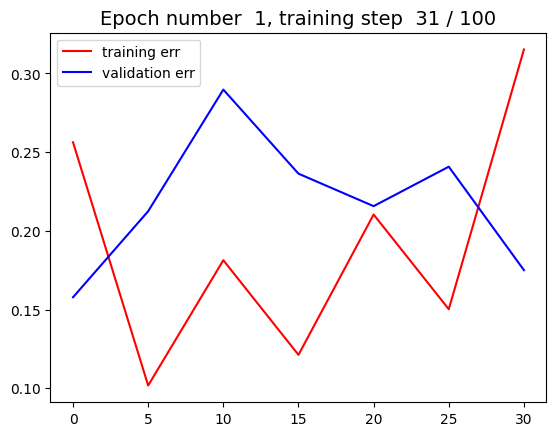

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  35.0 %
35
[0, 5, 10, 15, 20, 25, 30, 35]
[0.25628897547721863, 0.10176907479763031, 0.18133707344532013, 0.12121916562318802, 0.21036766469478607, 0.1502210795879364, 0.3152165710926056, 0.1950731873512268]
[0.1578013002872467, 0.21246367692947388, 0.2897399961948395, 0.23631717264652252, 0.21568968892097473, 0.24074946343898773, 0.17504064738750458, 0.15712209045886993]


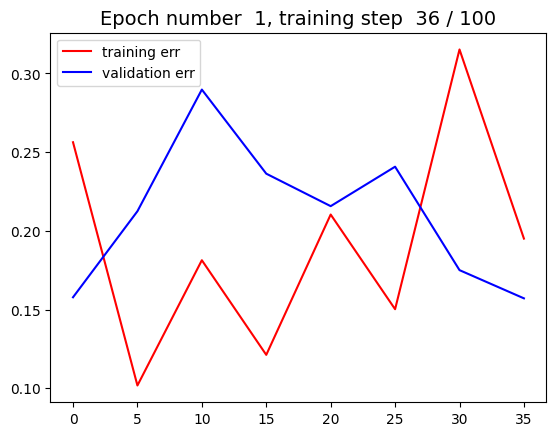

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  40.0 %
40
[0, 5, 10, 15, 20, 25, 30, 35, 40]
[0.25628897547721863, 0.10176907479763031, 0.18133707344532013, 0.12121916562318802, 0.21036766469478607, 0.1502210795879364, 0.3152165710926056, 0.1950731873512268, 0.21752160787582397]
[0.1578013002872467, 0.21246367692947388, 0.2897399961948395, 0.23631717264652252, 0.21568968892097473, 0.24074946343898773, 0.17504064738750458, 0.15712209045886993, 0.12122377753257751]


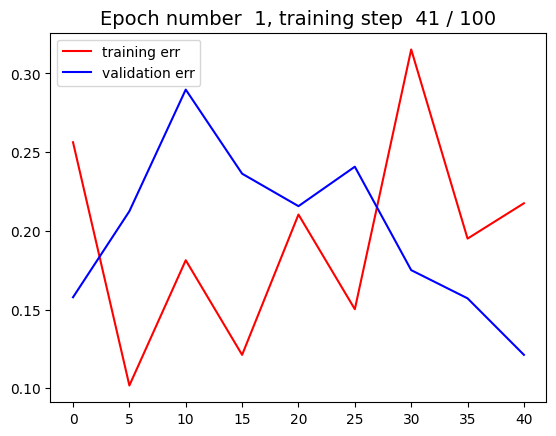

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  45.0 %
45
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
[0.25628897547721863, 0.10176907479763031, 0.18133707344532013, 0.12121916562318802, 0.21036766469478607, 0.1502210795879364, 0.3152165710926056, 0.1950731873512268, 0.21752160787582397, 0.24554844200611115]
[0.1578013002872467, 0.21246367692947388, 0.2897399961948395, 0.23631717264652252, 0.21568968892097473, 0.24074946343898773, 0.17504064738750458, 0.15712209045886993, 0.12122377753257751, 0.17846907675266266]


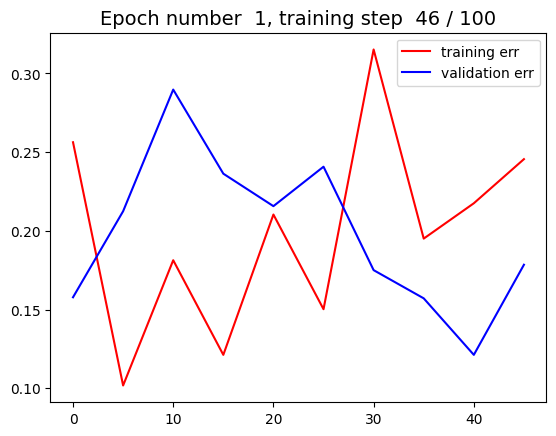

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  50.0 %
50
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]
[0.25628897547721863, 0.10176907479763031, 0.18133707344532013, 0.12121916562318802, 0.21036766469478607, 0.1502210795879364, 0.3152165710926056, 0.1950731873512268, 0.21752160787582397, 0.24554844200611115, 0.26315832138061523]
[0.1578013002872467, 0.21246367692947388, 0.2897399961948395, 0.23631717264652252, 0.21568968892097473, 0.24074946343898773, 0.17504064738750458, 0.15712209045886993, 0.12122377753257751, 0.17846907675266266, 0.1798238754272461]


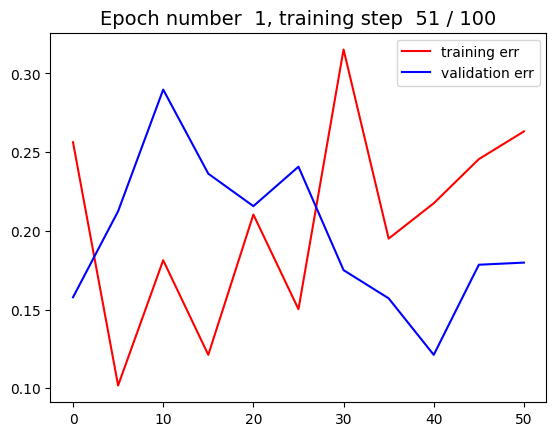

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  55.0 %
55
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55]
[0.25628897547721863, 0.10176907479763031, 0.18133707344532013, 0.12121916562318802, 0.21036766469478607, 0.1502210795879364, 0.3152165710926056, 0.1950731873512268, 0.21752160787582397, 0.24554844200611115, 0.26315832138061523, 0.17829689383506775]
[0.1578013002872467, 0.21246367692947388, 0.2897399961948395, 0.23631717264652252, 0.21568968892097473, 0.24074946343898773, 0.17504064738750458, 0.15712209045886993, 0.12122377753257751, 0.17846907675266266, 0.1798238754272461, 0.17850856482982635]


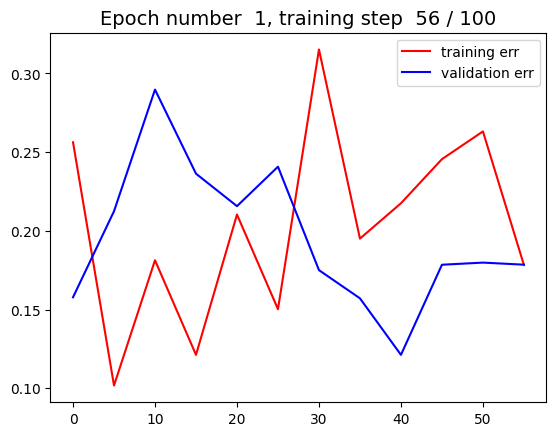

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  60.0 %
60
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]
[0.25628897547721863, 0.10176907479763031, 0.18133707344532013, 0.12121916562318802, 0.21036766469478607, 0.1502210795879364, 0.3152165710926056, 0.1950731873512268, 0.21752160787582397, 0.24554844200611115, 0.26315832138061523, 0.17829689383506775, 0.1806139349937439]
[0.1578013002872467, 0.21246367692947388, 0.2897399961948395, 0.23631717264652252, 0.21568968892097473, 0.24074946343898773, 0.17504064738750458, 0.15712209045886993, 0.12122377753257751, 0.17846907675266266, 0.1798238754272461, 0.17850856482982635, 0.16069740056991577]


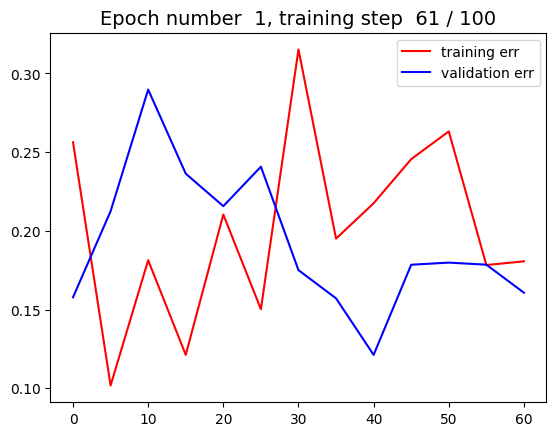

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  65.0 %
65
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65]
[0.25628897547721863, 0.10176907479763031, 0.18133707344532013, 0.12121916562318802, 0.21036766469478607, 0.1502210795879364, 0.3152165710926056, 0.1950731873512268, 0.21752160787582397, 0.24554844200611115, 0.26315832138061523, 0.17829689383506775, 0.1806139349937439, 0.3182598948478699]
[0.1578013002872467, 0.21246367692947388, 0.2897399961948395, 0.23631717264652252, 0.21568968892097473, 0.24074946343898773, 0.17504064738750458, 0.15712209045886993, 0.12122377753257751, 0.17846907675266266, 0.1798238754272461, 0.17850856482982635, 0.16069740056991577, 0.17474226653575897]


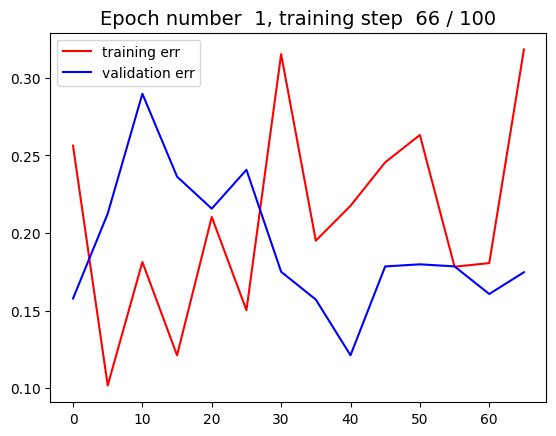

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  70.0 %
70
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70]
[0.25628897547721863, 0.10176907479763031, 0.18133707344532013, 0.12121916562318802, 0.21036766469478607, 0.1502210795879364, 0.3152165710926056, 0.1950731873512268, 0.21752160787582397, 0.24554844200611115, 0.26315832138061523, 0.17829689383506775, 0.1806139349937439, 0.3182598948478699, 0.17375200986862183]
[0.1578013002872467, 0.21246367692947388, 0.2897399961948395, 0.23631717264652252, 0.21568968892097473, 0.24074946343898773, 0.17504064738750458, 0.15712209045886993, 0.12122377753257751, 0.17846907675266266, 0.1798238754272461, 0.17850856482982635, 0.16069740056991577, 0.17474226653575897, 0.48592641949653625]


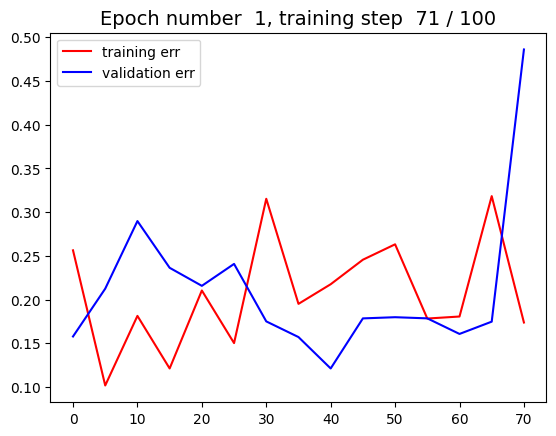

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  75.0 %
75
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75]
[0.25628897547721863, 0.10176907479763031, 0.18133707344532013, 0.12121916562318802, 0.21036766469478607, 0.1502210795879364, 0.3152165710926056, 0.1950731873512268, 0.21752160787582397, 0.24554844200611115, 0.26315832138061523, 0.17829689383506775, 0.1806139349937439, 0.3182598948478699, 0.17375200986862183, 0.31006988883018494]
[0.1578013002872467, 0.21246367692947388, 0.2897399961948395, 0.23631717264652252, 0.21568968892097473, 0.24074946343898773, 0.17504064738750458, 0.15712209045886993, 0.12122377753257751, 0.17846907675266266, 0.1798238754272461, 0.17850856482982635, 0.16069740056991577, 0.17474226653575897, 0.48592641949653625, 0.22219495475292206]


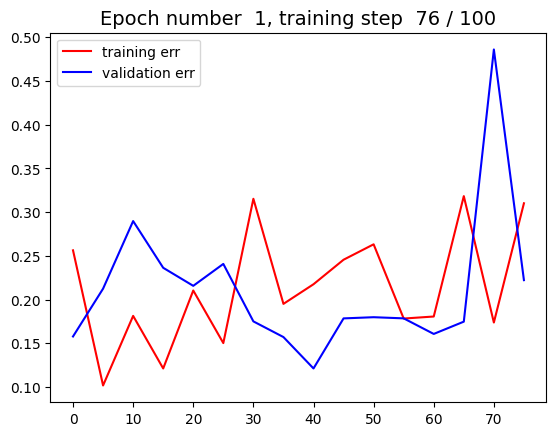

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  80.0 %
80
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80]
[0.25628897547721863, 0.10176907479763031, 0.18133707344532013, 0.12121916562318802, 0.21036766469478607, 0.1502210795879364, 0.3152165710926056, 0.1950731873512268, 0.21752160787582397, 0.24554844200611115, 0.26315832138061523, 0.17829689383506775, 0.1806139349937439, 0.3182598948478699, 0.17375200986862183, 0.31006988883018494, 0.21466681361198425]
[0.1578013002872467, 0.21246367692947388, 0.2897399961948395, 0.23631717264652252, 0.21568968892097473, 0.24074946343898773, 0.17504064738750458, 0.15712209045886993, 0.12122377753257751, 0.17846907675266266, 0.1798238754272461, 0.17850856482982635, 0.16069740056991577, 0.17474226653575897, 0.48592641949653625, 0.22219495475292206, 0.2238934338092804]


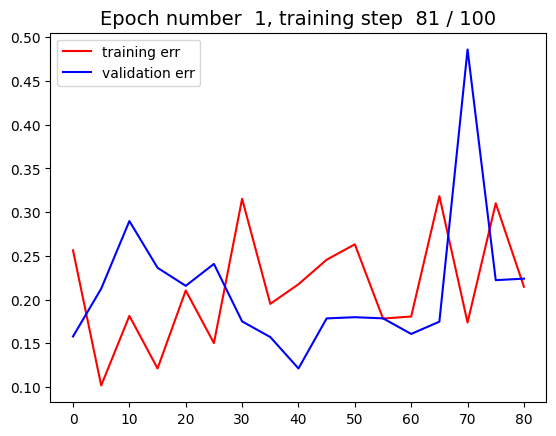

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  85.0 %
85
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85]
[0.25628897547721863, 0.10176907479763031, 0.18133707344532013, 0.12121916562318802, 0.21036766469478607, 0.1502210795879364, 0.3152165710926056, 0.1950731873512268, 0.21752160787582397, 0.24554844200611115, 0.26315832138061523, 0.17829689383506775, 0.1806139349937439, 0.3182598948478699, 0.17375200986862183, 0.31006988883018494, 0.21466681361198425, 0.22026142477989197]
[0.1578013002872467, 0.21246367692947388, 0.2897399961948395, 0.23631717264652252, 0.21568968892097473, 0.24074946343898773, 0.17504064738750458, 0.15712209045886993, 0.12122377753257751, 0.17846907675266266, 0.1798238754272461, 0.17850856482982635, 0.16069740056991577, 0.17474226653575897, 0.48592641949653625, 0.22219495475292206, 0.2238934338092804, 0.20627102255821228]


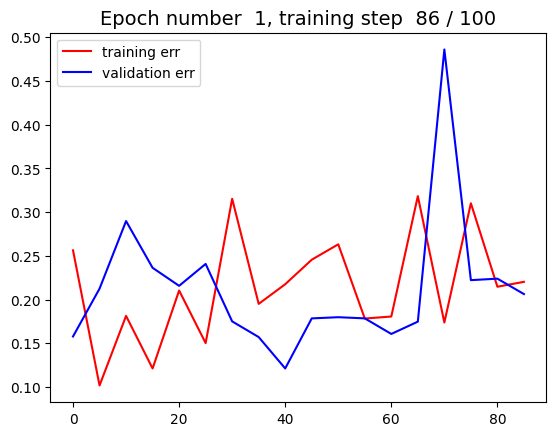

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  90.0 %
90
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90]
[0.25628897547721863, 0.10176907479763031, 0.18133707344532013, 0.12121916562318802, 0.21036766469478607, 0.1502210795879364, 0.3152165710926056, 0.1950731873512268, 0.21752160787582397, 0.24554844200611115, 0.26315832138061523, 0.17829689383506775, 0.1806139349937439, 0.3182598948478699, 0.17375200986862183, 0.31006988883018494, 0.21466681361198425, 0.22026142477989197, 0.24844542145729065]
[0.1578013002872467, 0.21246367692947388, 0.2897399961948395, 0.23631717264652252, 0.21568968892097473, 0.24074946343898773, 0.17504064738750458, 0.15712209045886993, 0.12122377753257751, 0.17846907675266266, 0.1798238754272461, 0.17850856482982635, 0.16069740056991577, 0.17474226653575897, 0.48592641949653625, 0.22219495475292206, 0.2238934338092804, 0.20627102255821228, 0.16380718350410461]


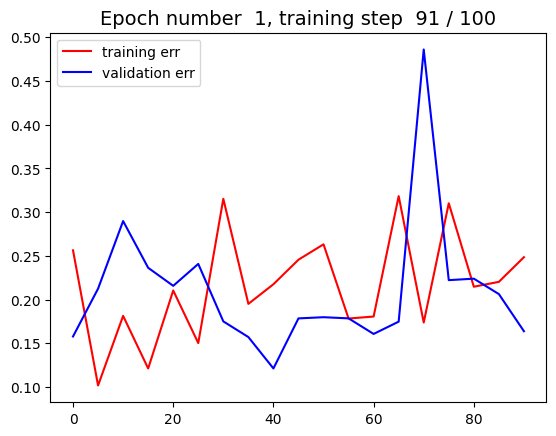

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  95.0 %
95
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95]
[0.25628897547721863, 0.10176907479763031, 0.18133707344532013, 0.12121916562318802, 0.21036766469478607, 0.1502210795879364, 0.3152165710926056, 0.1950731873512268, 0.21752160787582397, 0.24554844200611115, 0.26315832138061523, 0.17829689383506775, 0.1806139349937439, 0.3182598948478699, 0.17375200986862183, 0.31006988883018494, 0.21466681361198425, 0.22026142477989197, 0.24844542145729065, 0.16500642895698547]
[0.1578013002872467, 0.21246367692947388, 0.2897399961948395, 0.23631717264652252, 0.21568968892097473, 0.24074946343898773, 0.17504064738750458, 0.15712209045886993, 0.12122377753257751, 0.17846907675266266, 0.1798238754272461, 0.17850856482982635, 0.16069740056991577, 0.17474226653575897, 0.48592641949653625, 0.22219495475292206, 0.2238934338092804, 0.20627102255821228, 0.16380718350410461

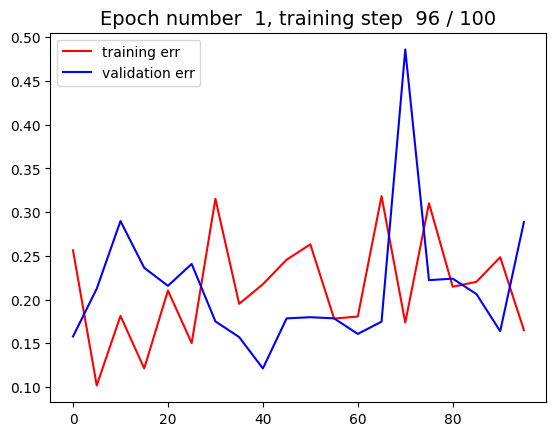

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  100.0 %
100
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
[0.25628897547721863, 0.10176907479763031, 0.18133707344532013, 0.12121916562318802, 0.21036766469478607, 0.1502210795879364, 0.3152165710926056, 0.1950731873512268, 0.21752160787582397, 0.24554844200611115, 0.26315832138061523, 0.17829689383506775, 0.1806139349937439, 0.3182598948478699, 0.17375200986862183, 0.31006988883018494, 0.21466681361198425, 0.22026142477989197, 0.24844542145729065, 0.16500642895698547, 0.2307976335287094]
[0.1578013002872467, 0.21246367692947388, 0.2897399961948395, 0.23631717264652252, 0.21568968892097473, 0.24074946343898773, 0.17504064738750458, 0.15712209045886993, 0.12122377753257751, 0.17846907675266266, 0.1798238754272461, 0.17850856482982635, 0.16069740056991577, 0.17474226653575897, 0.48592641949653625, 0.22219495475292206, 0.2238934338092804, 0.20627102255

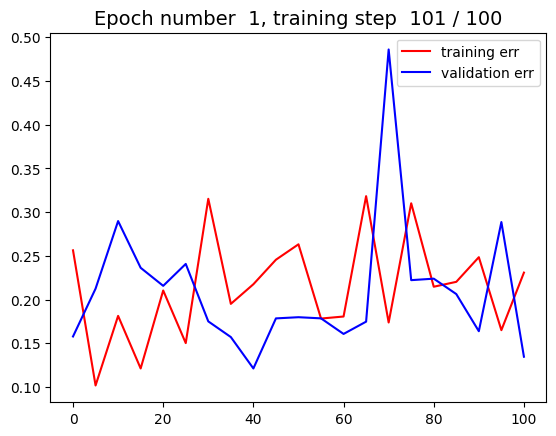

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  0.0 %
0
[0]
[0.1604163497686386]
[0.1772976517677307]


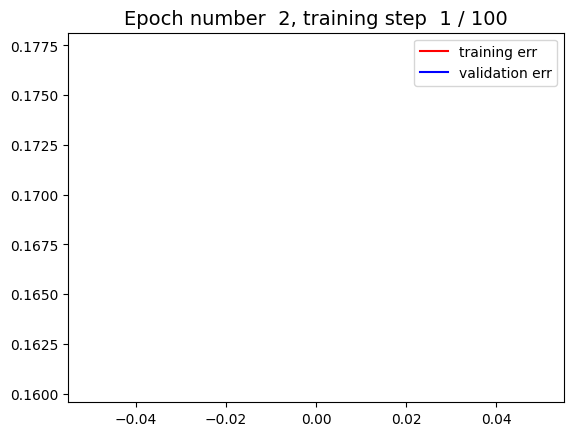

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  5.0 %
5
[0, 5]
[0.1604163497686386, 0.2292104810476303]
[0.1772976517677307, 0.09487808495759964]


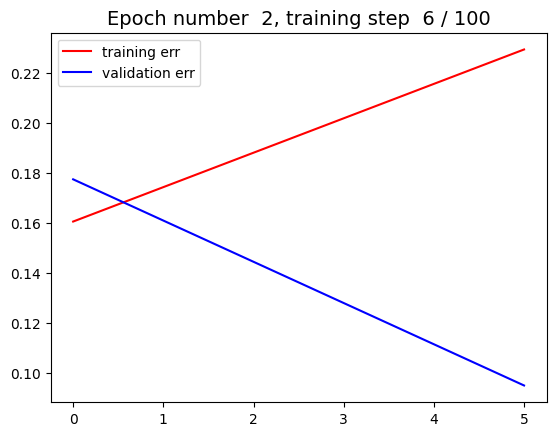

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  10.0 %
10
[0, 5, 10]
[0.1604163497686386, 0.2292104810476303, 0.220694437623024]
[0.1772976517677307, 0.09487808495759964, 0.1874116063117981]


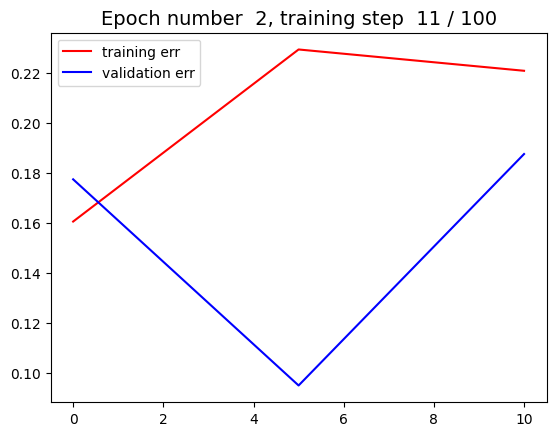

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  15.0 %
15
[0, 5, 10, 15]
[0.1604163497686386, 0.2292104810476303, 0.220694437623024, 0.15690618753433228]
[0.1772976517677307, 0.09487808495759964, 0.1874116063117981, 0.14314216375350952]


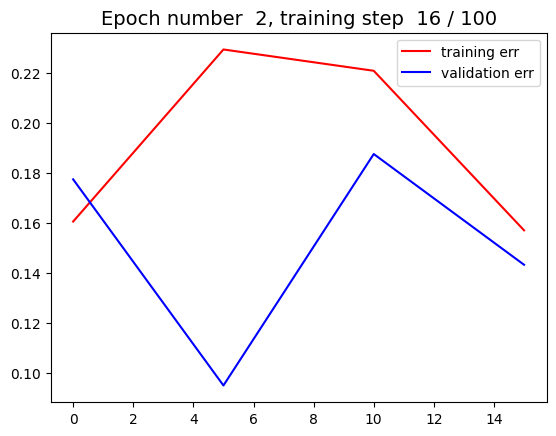

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  20.0 %
20
[0, 5, 10, 15, 20]
[0.1604163497686386, 0.2292104810476303, 0.220694437623024, 0.15690618753433228, 0.14309272170066833]
[0.1772976517677307, 0.09487808495759964, 0.1874116063117981, 0.14314216375350952, 0.13827387988567352]


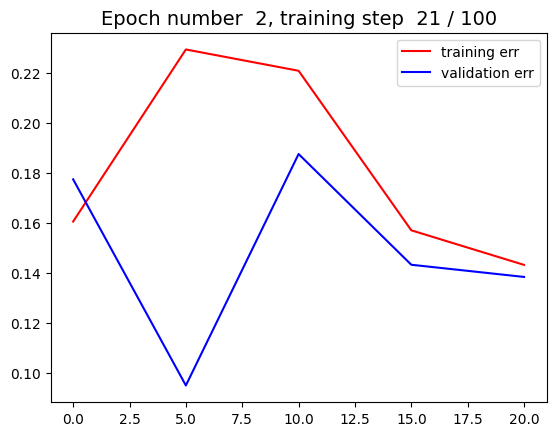

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  25.0 %
25
[0, 5, 10, 15, 20, 25]
[0.1604163497686386, 0.2292104810476303, 0.220694437623024, 0.15690618753433228, 0.14309272170066833, 0.1461203396320343]
[0.1772976517677307, 0.09487808495759964, 0.1874116063117981, 0.14314216375350952, 0.13827387988567352, 0.19007594883441925]


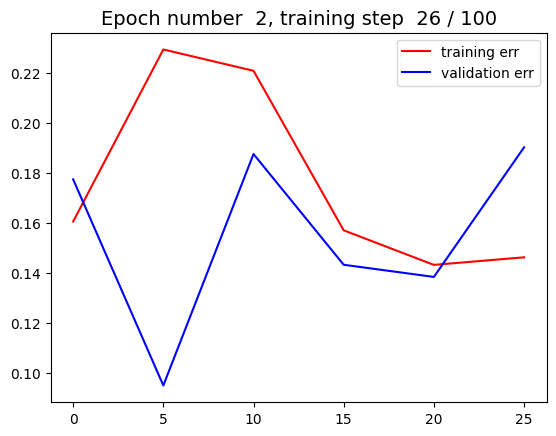

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  30.0 %
30
[0, 5, 10, 15, 20, 25, 30]
[0.1604163497686386, 0.2292104810476303, 0.220694437623024, 0.15690618753433228, 0.14309272170066833, 0.1461203396320343, 0.13127684593200684]
[0.1772976517677307, 0.09487808495759964, 0.1874116063117981, 0.14314216375350952, 0.13827387988567352, 0.19007594883441925, 0.2730084955692291]


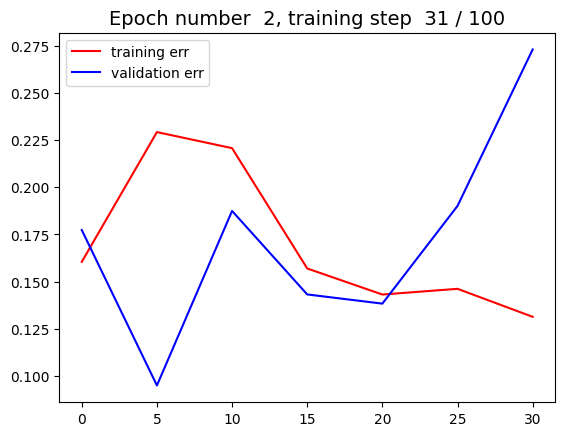

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  35.0 %
35
[0, 5, 10, 15, 20, 25, 30, 35]
[0.1604163497686386, 0.2292104810476303, 0.220694437623024, 0.15690618753433228, 0.14309272170066833, 0.1461203396320343, 0.13127684593200684, 0.19803178310394287]
[0.1772976517677307, 0.09487808495759964, 0.1874116063117981, 0.14314216375350952, 0.13827387988567352, 0.19007594883441925, 0.2730084955692291, 0.19594836235046387]


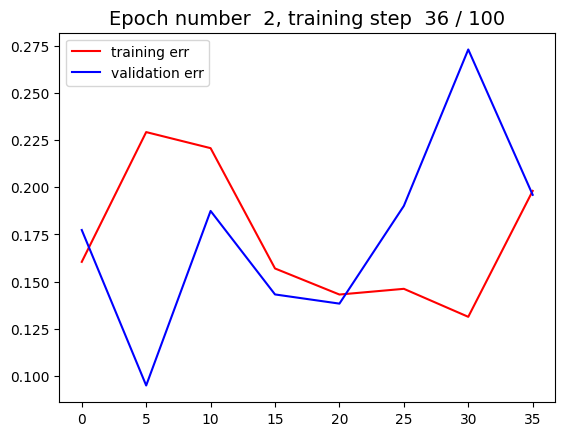

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  40.0 %
40
[0, 5, 10, 15, 20, 25, 30, 35, 40]
[0.1604163497686386, 0.2292104810476303, 0.220694437623024, 0.15690618753433228, 0.14309272170066833, 0.1461203396320343, 0.13127684593200684, 0.19803178310394287, 0.205072820186615]
[0.1772976517677307, 0.09487808495759964, 0.1874116063117981, 0.14314216375350952, 0.13827387988567352, 0.19007594883441925, 0.2730084955692291, 0.19594836235046387, 0.22930419445037842]


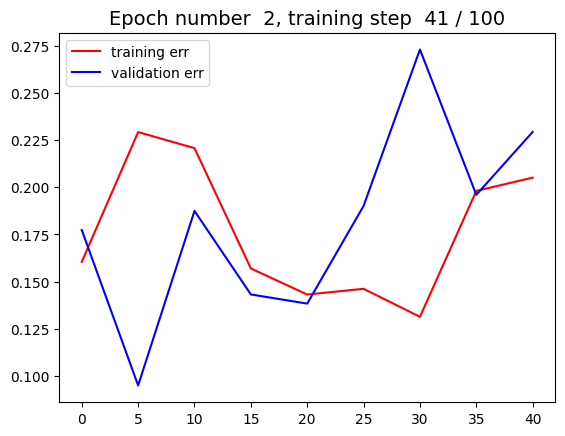

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  45.0 %
45
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
[0.1604163497686386, 0.2292104810476303, 0.220694437623024, 0.15690618753433228, 0.14309272170066833, 0.1461203396320343, 0.13127684593200684, 0.19803178310394287, 0.205072820186615, 0.23244807124137878]
[0.1772976517677307, 0.09487808495759964, 0.1874116063117981, 0.14314216375350952, 0.13827387988567352, 0.19007594883441925, 0.2730084955692291, 0.19594836235046387, 0.22930419445037842, 0.1634652018547058]


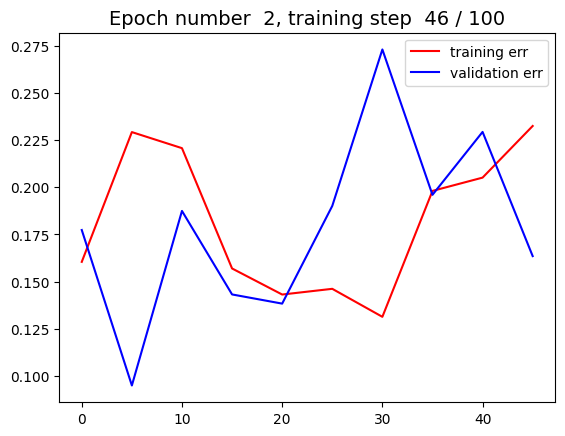

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  50.0 %
50
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]
[0.1604163497686386, 0.2292104810476303, 0.220694437623024, 0.15690618753433228, 0.14309272170066833, 0.1461203396320343, 0.13127684593200684, 0.19803178310394287, 0.205072820186615, 0.23244807124137878, 0.10501110553741455]
[0.1772976517677307, 0.09487808495759964, 0.1874116063117981, 0.14314216375350952, 0.13827387988567352, 0.19007594883441925, 0.2730084955692291, 0.19594836235046387, 0.22930419445037842, 0.1634652018547058, 0.1283312439918518]


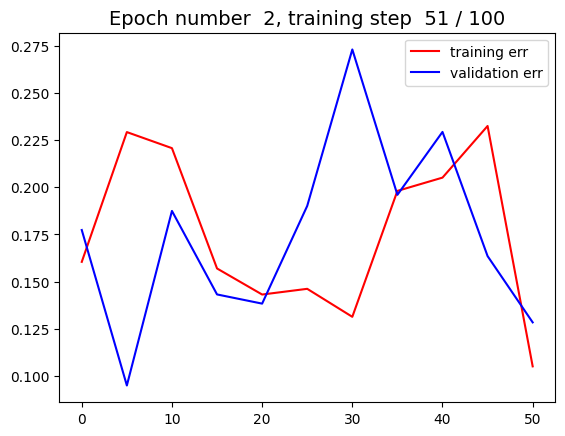

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  55.0 %
55
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55]
[0.1604163497686386, 0.2292104810476303, 0.220694437623024, 0.15690618753433228, 0.14309272170066833, 0.1461203396320343, 0.13127684593200684, 0.19803178310394287, 0.205072820186615, 0.23244807124137878, 0.10501110553741455, 0.12777721881866455]
[0.1772976517677307, 0.09487808495759964, 0.1874116063117981, 0.14314216375350952, 0.13827387988567352, 0.19007594883441925, 0.2730084955692291, 0.19594836235046387, 0.22930419445037842, 0.1634652018547058, 0.1283312439918518, 0.2445736974477768]


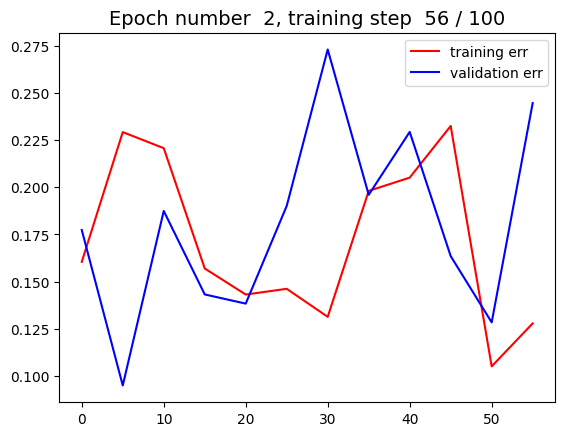

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  60.0 %
60
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]
[0.1604163497686386, 0.2292104810476303, 0.220694437623024, 0.15690618753433228, 0.14309272170066833, 0.1461203396320343, 0.13127684593200684, 0.19803178310394287, 0.205072820186615, 0.23244807124137878, 0.10501110553741455, 0.12777721881866455, 0.16928191483020782]
[0.1772976517677307, 0.09487808495759964, 0.1874116063117981, 0.14314216375350952, 0.13827387988567352, 0.19007594883441925, 0.2730084955692291, 0.19594836235046387, 0.22930419445037842, 0.1634652018547058, 0.1283312439918518, 0.2445736974477768, 0.13975751399993896]


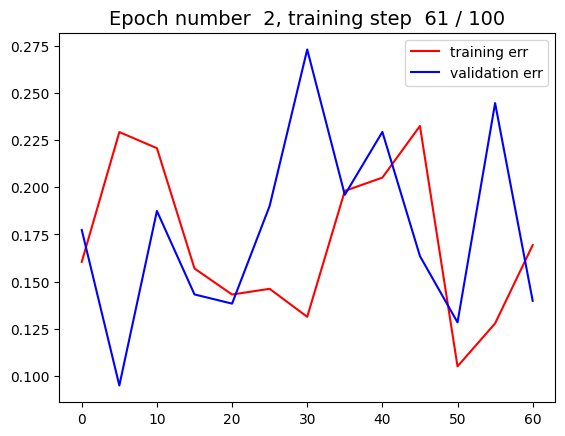

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  65.0 %
65
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65]
[0.1604163497686386, 0.2292104810476303, 0.220694437623024, 0.15690618753433228, 0.14309272170066833, 0.1461203396320343, 0.13127684593200684, 0.19803178310394287, 0.205072820186615, 0.23244807124137878, 0.10501110553741455, 0.12777721881866455, 0.16928191483020782, 0.34364640712738037]
[0.1772976517677307, 0.09487808495759964, 0.1874116063117981, 0.14314216375350952, 0.13827387988567352, 0.19007594883441925, 0.2730084955692291, 0.19594836235046387, 0.22930419445037842, 0.1634652018547058, 0.1283312439918518, 0.2445736974477768, 0.13975751399993896, 0.11331993341445923]


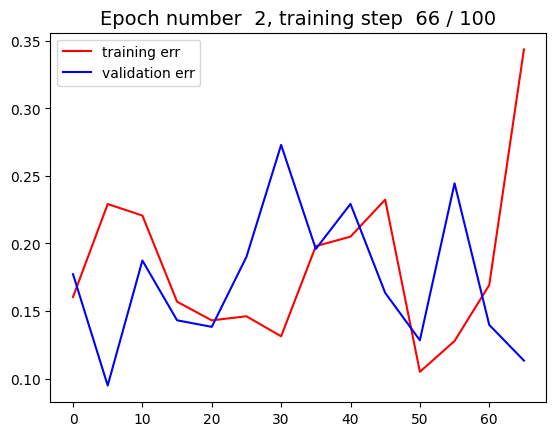

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  70.0 %
70
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70]
[0.1604163497686386, 0.2292104810476303, 0.220694437623024, 0.15690618753433228, 0.14309272170066833, 0.1461203396320343, 0.13127684593200684, 0.19803178310394287, 0.205072820186615, 0.23244807124137878, 0.10501110553741455, 0.12777721881866455, 0.16928191483020782, 0.34364640712738037, 0.20348350703716278]
[0.1772976517677307, 0.09487808495759964, 0.1874116063117981, 0.14314216375350952, 0.13827387988567352, 0.19007594883441925, 0.2730084955692291, 0.19594836235046387, 0.22930419445037842, 0.1634652018547058, 0.1283312439918518, 0.2445736974477768, 0.13975751399993896, 0.11331993341445923, 0.20932327210903168]


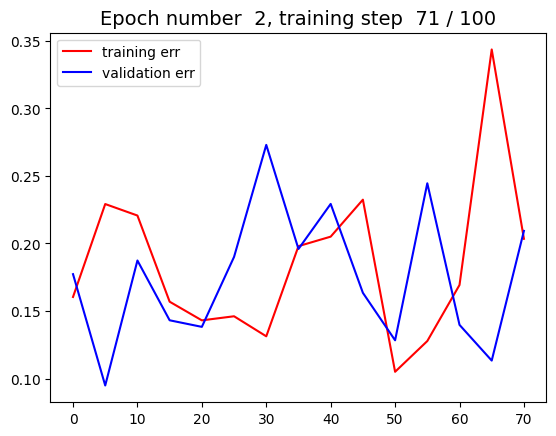

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  75.0 %
75
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75]
[0.1604163497686386, 0.2292104810476303, 0.220694437623024, 0.15690618753433228, 0.14309272170066833, 0.1461203396320343, 0.13127684593200684, 0.19803178310394287, 0.205072820186615, 0.23244807124137878, 0.10501110553741455, 0.12777721881866455, 0.16928191483020782, 0.34364640712738037, 0.20348350703716278, 0.118136927485466]
[0.1772976517677307, 0.09487808495759964, 0.1874116063117981, 0.14314216375350952, 0.13827387988567352, 0.19007594883441925, 0.2730084955692291, 0.19594836235046387, 0.22930419445037842, 0.1634652018547058, 0.1283312439918518, 0.2445736974477768, 0.13975751399993896, 0.11331993341445923, 0.20932327210903168, 0.24463507533073425]


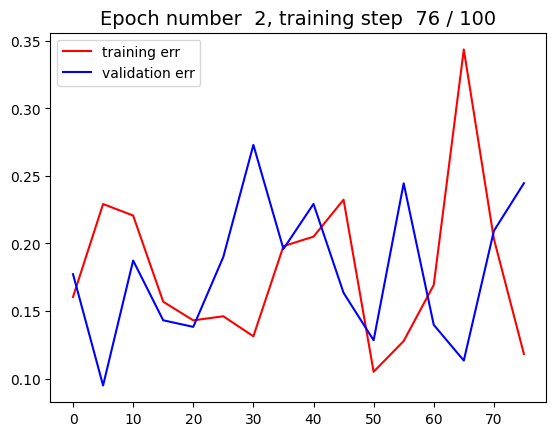

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  80.0 %
80
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80]
[0.1604163497686386, 0.2292104810476303, 0.220694437623024, 0.15690618753433228, 0.14309272170066833, 0.1461203396320343, 0.13127684593200684, 0.19803178310394287, 0.205072820186615, 0.23244807124137878, 0.10501110553741455, 0.12777721881866455, 0.16928191483020782, 0.34364640712738037, 0.20348350703716278, 0.118136927485466, 0.12926815450191498]
[0.1772976517677307, 0.09487808495759964, 0.1874116063117981, 0.14314216375350952, 0.13827387988567352, 0.19007594883441925, 0.2730084955692291, 0.19594836235046387, 0.22930419445037842, 0.1634652018547058, 0.1283312439918518, 0.2445736974477768, 0.13975751399993896, 0.11331993341445923, 0.20932327210903168, 0.24463507533073425, 0.22563347220420837]


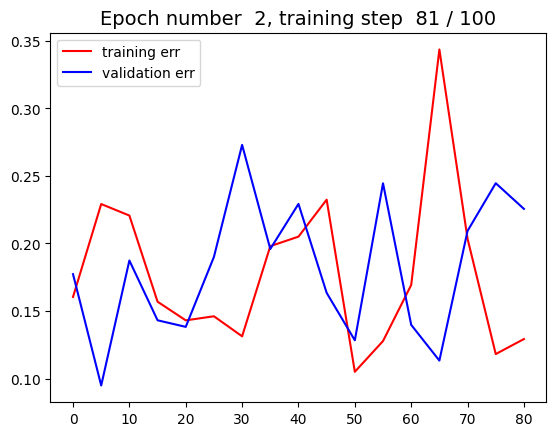

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  85.0 %
85
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85]
[0.1604163497686386, 0.2292104810476303, 0.220694437623024, 0.15690618753433228, 0.14309272170066833, 0.1461203396320343, 0.13127684593200684, 0.19803178310394287, 0.205072820186615, 0.23244807124137878, 0.10501110553741455, 0.12777721881866455, 0.16928191483020782, 0.34364640712738037, 0.20348350703716278, 0.118136927485466, 0.12926815450191498, 0.15409913659095764]
[0.1772976517677307, 0.09487808495759964, 0.1874116063117981, 0.14314216375350952, 0.13827387988567352, 0.19007594883441925, 0.2730084955692291, 0.19594836235046387, 0.22930419445037842, 0.1634652018547058, 0.1283312439918518, 0.2445736974477768, 0.13975751399993896, 0.11331993341445923, 0.20932327210903168, 0.24463507533073425, 0.22563347220420837, 0.17132693529129028]


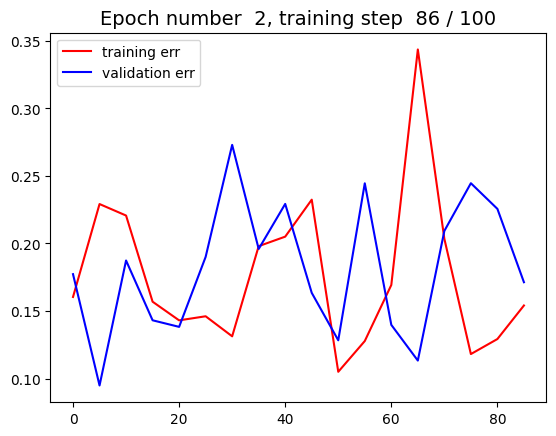

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  90.0 %
90
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90]
[0.1604163497686386, 0.2292104810476303, 0.220694437623024, 0.15690618753433228, 0.14309272170066833, 0.1461203396320343, 0.13127684593200684, 0.19803178310394287, 0.205072820186615, 0.23244807124137878, 0.10501110553741455, 0.12777721881866455, 0.16928191483020782, 0.34364640712738037, 0.20348350703716278, 0.118136927485466, 0.12926815450191498, 0.15409913659095764, 0.3302624821662903]
[0.1772976517677307, 0.09487808495759964, 0.1874116063117981, 0.14314216375350952, 0.13827387988567352, 0.19007594883441925, 0.2730084955692291, 0.19594836235046387, 0.22930419445037842, 0.1634652018547058, 0.1283312439918518, 0.2445736974477768, 0.13975751399993896, 0.11331993341445923, 0.20932327210903168, 0.24463507533073425, 0.22563347220420837, 0.17132693529129028, 0.12127135694026947]


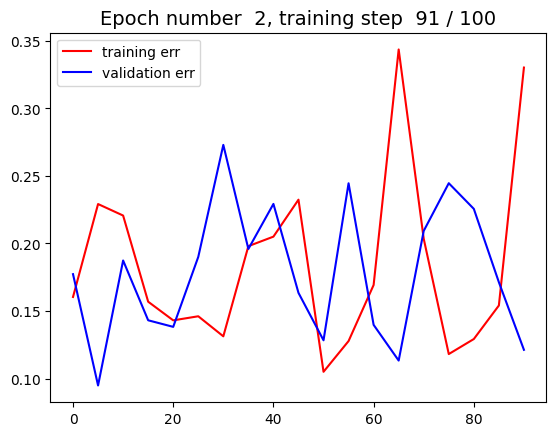

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  95.0 %
95
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95]
[0.1604163497686386, 0.2292104810476303, 0.220694437623024, 0.15690618753433228, 0.14309272170066833, 0.1461203396320343, 0.13127684593200684, 0.19803178310394287, 0.205072820186615, 0.23244807124137878, 0.10501110553741455, 0.12777721881866455, 0.16928191483020782, 0.34364640712738037, 0.20348350703716278, 0.118136927485466, 0.12926815450191498, 0.15409913659095764, 0.3302624821662903, 0.1984887719154358]
[0.1772976517677307, 0.09487808495759964, 0.1874116063117981, 0.14314216375350952, 0.13827387988567352, 0.19007594883441925, 0.2730084955692291, 0.19594836235046387, 0.22930419445037842, 0.1634652018547058, 0.1283312439918518, 0.2445736974477768, 0.13975751399993896, 0.11331993341445923, 0.20932327210903168, 0.24463507533073425, 0.22563347220420837, 0.17132693529129028, 0.12127135694026947, 0.1087

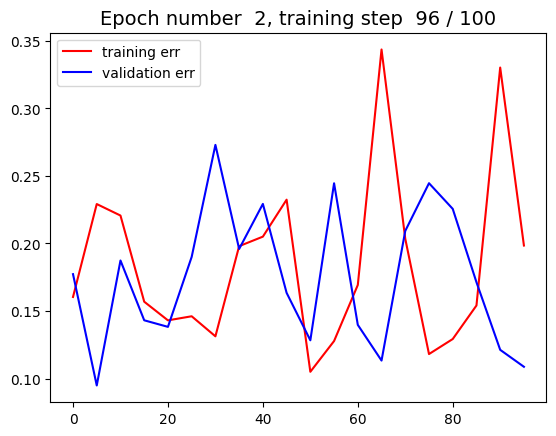

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  100.0 %
100
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
[0.1604163497686386, 0.2292104810476303, 0.220694437623024, 0.15690618753433228, 0.14309272170066833, 0.1461203396320343, 0.13127684593200684, 0.19803178310394287, 0.205072820186615, 0.23244807124137878, 0.10501110553741455, 0.12777721881866455, 0.16928191483020782, 0.34364640712738037, 0.20348350703716278, 0.118136927485466, 0.12926815450191498, 0.15409913659095764, 0.3302624821662903, 0.1984887719154358, 0.20489312708377838]
[0.1772976517677307, 0.09487808495759964, 0.1874116063117981, 0.14314216375350952, 0.13827387988567352, 0.19007594883441925, 0.2730084955692291, 0.19594836235046387, 0.22930419445037842, 0.1634652018547058, 0.1283312439918518, 0.2445736974477768, 0.13975751399993896, 0.11331993341445923, 0.20932327210903168, 0.24463507533073425, 0.22563347220420837, 0.17132693529129028,

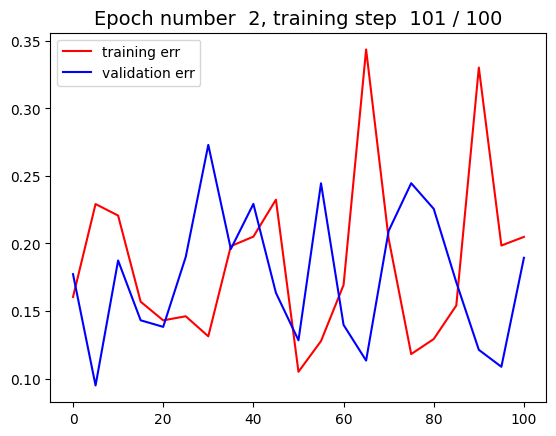

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  0.0 %
0
[0]
[0.19557324051856995]
[0.31522631645202637]


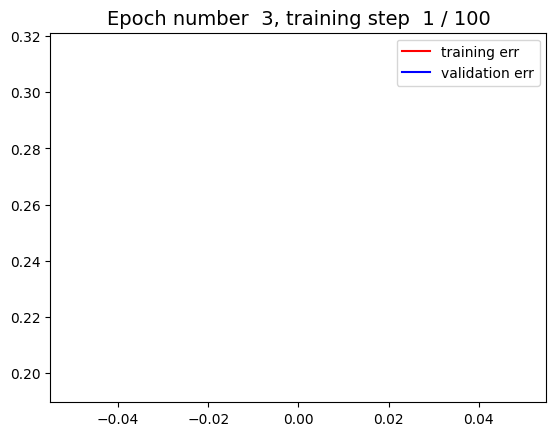

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  5.0 %
5
[0, 5]
[0.19557324051856995, 0.1375863254070282]
[0.31522631645202637, 0.1231859028339386]


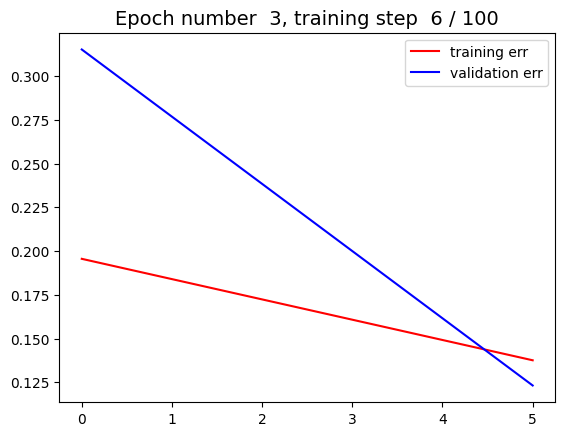

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  10.0 %
10
[0, 5, 10]
[0.19557324051856995, 0.1375863254070282, 0.1656149923801422]
[0.31522631645202637, 0.1231859028339386, 0.1625077724456787]


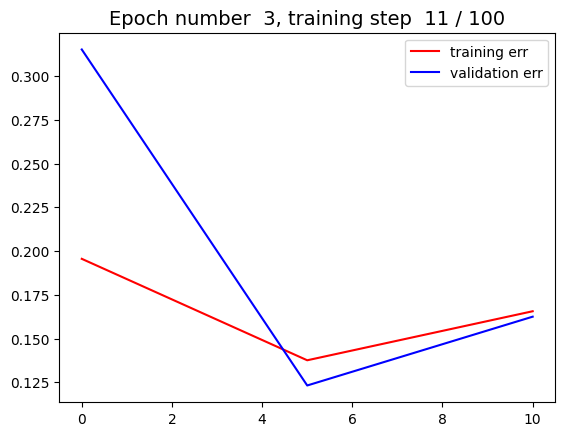

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  15.0 %
15
[0, 5, 10, 15]
[0.19557324051856995, 0.1375863254070282, 0.1656149923801422, 0.10057930648326874]
[0.31522631645202637, 0.1231859028339386, 0.1625077724456787, 0.27139151096343994]


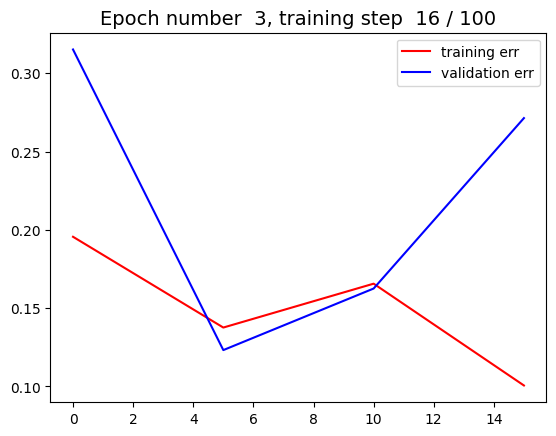

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  20.0 %
20
[0, 5, 10, 15, 20]
[0.19557324051856995, 0.1375863254070282, 0.1656149923801422, 0.10057930648326874, 0.11659786850214005]
[0.31522631645202637, 0.1231859028339386, 0.1625077724456787, 0.27139151096343994, 0.15772728621959686]


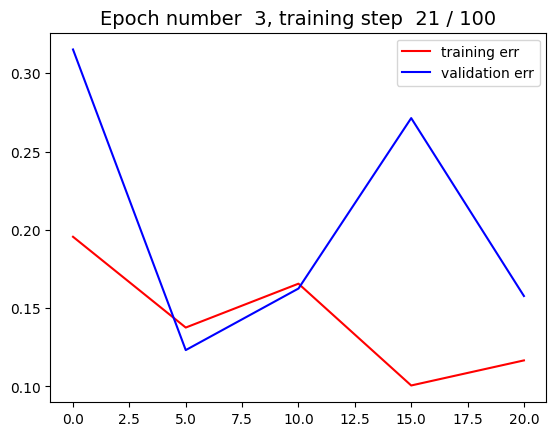

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  25.0 %
25
[0, 5, 10, 15, 20, 25]
[0.19557324051856995, 0.1375863254070282, 0.1656149923801422, 0.10057930648326874, 0.11659786850214005, 0.11181169748306274]
[0.31522631645202637, 0.1231859028339386, 0.1625077724456787, 0.27139151096343994, 0.15772728621959686, 0.25613242387771606]


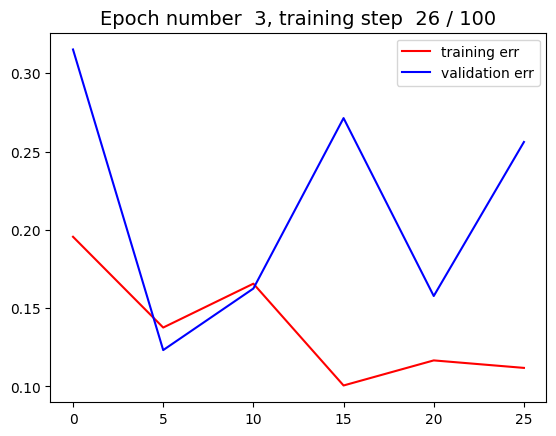

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  30.0 %
30
[0, 5, 10, 15, 20, 25, 30]
[0.19557324051856995, 0.1375863254070282, 0.1656149923801422, 0.10057930648326874, 0.11659786850214005, 0.11181169748306274, 0.11097614467144012]
[0.31522631645202637, 0.1231859028339386, 0.1625077724456787, 0.27139151096343994, 0.15772728621959686, 0.25613242387771606, 0.17112234234809875]


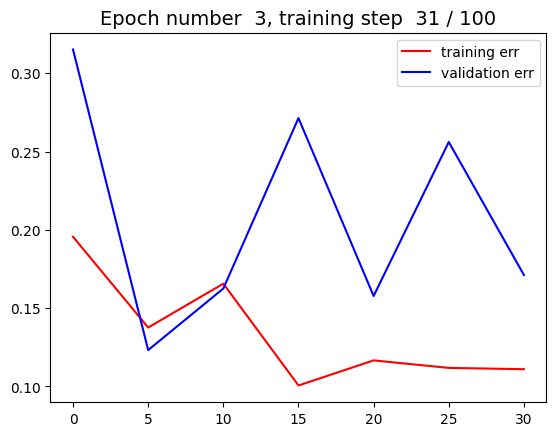

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  35.0 %
35
[0, 5, 10, 15, 20, 25, 30, 35]
[0.19557324051856995, 0.1375863254070282, 0.1656149923801422, 0.10057930648326874, 0.11659786850214005, 0.11181169748306274, 0.11097614467144012, 0.16966061294078827]
[0.31522631645202637, 0.1231859028339386, 0.1625077724456787, 0.27139151096343994, 0.15772728621959686, 0.25613242387771606, 0.17112234234809875, 0.2362080216407776]


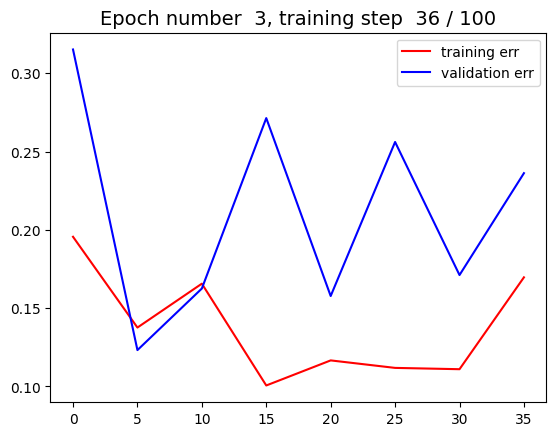

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  40.0 %
40
[0, 5, 10, 15, 20, 25, 30, 35, 40]
[0.19557324051856995, 0.1375863254070282, 0.1656149923801422, 0.10057930648326874, 0.11659786850214005, 0.11181169748306274, 0.11097614467144012, 0.16966061294078827, 0.09964849054813385]
[0.31522631645202637, 0.1231859028339386, 0.1625077724456787, 0.27139151096343994, 0.15772728621959686, 0.25613242387771606, 0.17112234234809875, 0.2362080216407776, 0.22191846370697021]


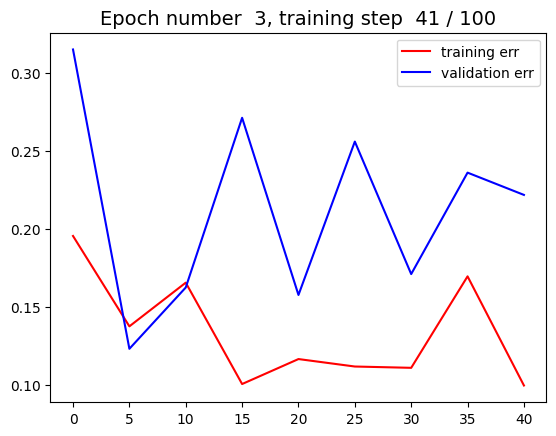

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  45.0 %
45
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
[0.19557324051856995, 0.1375863254070282, 0.1656149923801422, 0.10057930648326874, 0.11659786850214005, 0.11181169748306274, 0.11097614467144012, 0.16966061294078827, 0.09964849054813385, 0.1983048915863037]
[0.31522631645202637, 0.1231859028339386, 0.1625077724456787, 0.27139151096343994, 0.15772728621959686, 0.25613242387771606, 0.17112234234809875, 0.2362080216407776, 0.22191846370697021, 0.14257818460464478]


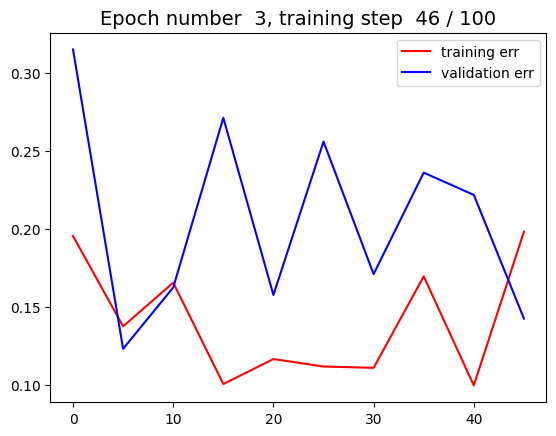

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  50.0 %
50
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]
[0.19557324051856995, 0.1375863254070282, 0.1656149923801422, 0.10057930648326874, 0.11659786850214005, 0.11181169748306274, 0.11097614467144012, 0.16966061294078827, 0.09964849054813385, 0.1983048915863037, 0.1608789712190628]
[0.31522631645202637, 0.1231859028339386, 0.1625077724456787, 0.27139151096343994, 0.15772728621959686, 0.25613242387771606, 0.17112234234809875, 0.2362080216407776, 0.22191846370697021, 0.14257818460464478, 0.10788408666849136]


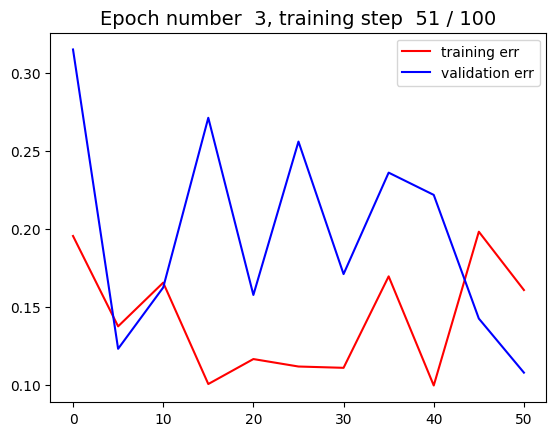

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  55.0 %
55
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55]
[0.19557324051856995, 0.1375863254070282, 0.1656149923801422, 0.10057930648326874, 0.11659786850214005, 0.11181169748306274, 0.11097614467144012, 0.16966061294078827, 0.09964849054813385, 0.1983048915863037, 0.1608789712190628, 0.19211655855178833]
[0.31522631645202637, 0.1231859028339386, 0.1625077724456787, 0.27139151096343994, 0.15772728621959686, 0.25613242387771606, 0.17112234234809875, 0.2362080216407776, 0.22191846370697021, 0.14257818460464478, 0.10788408666849136, 0.10715731233358383]


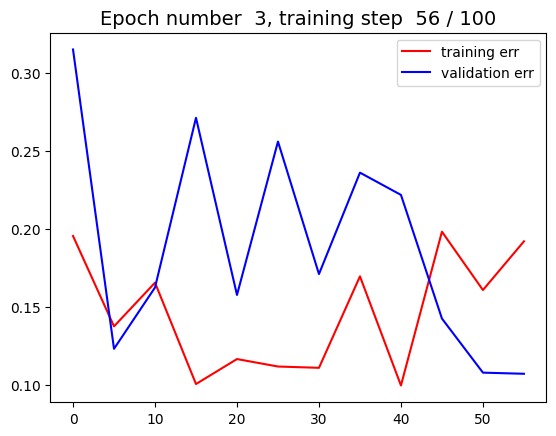

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  60.0 %
60
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]
[0.19557324051856995, 0.1375863254070282, 0.1656149923801422, 0.10057930648326874, 0.11659786850214005, 0.11181169748306274, 0.11097614467144012, 0.16966061294078827, 0.09964849054813385, 0.1983048915863037, 0.1608789712190628, 0.19211655855178833, 0.18589720129966736]
[0.31522631645202637, 0.1231859028339386, 0.1625077724456787, 0.27139151096343994, 0.15772728621959686, 0.25613242387771606, 0.17112234234809875, 0.2362080216407776, 0.22191846370697021, 0.14257818460464478, 0.10788408666849136, 0.10715731233358383, 0.10163208097219467]


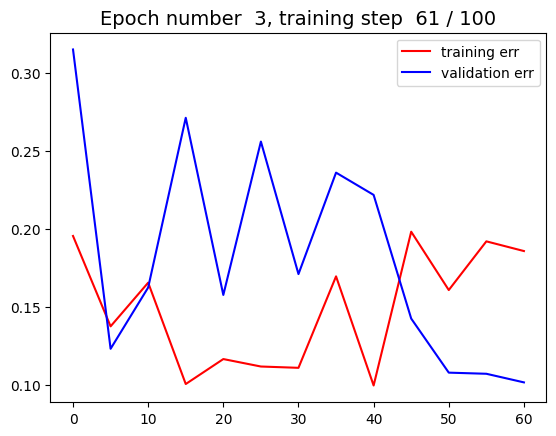

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  65.0 %
65
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65]
[0.19557324051856995, 0.1375863254070282, 0.1656149923801422, 0.10057930648326874, 0.11659786850214005, 0.11181169748306274, 0.11097614467144012, 0.16966061294078827, 0.09964849054813385, 0.1983048915863037, 0.1608789712190628, 0.19211655855178833, 0.18589720129966736, 0.2728535234928131]
[0.31522631645202637, 0.1231859028339386, 0.1625077724456787, 0.27139151096343994, 0.15772728621959686, 0.25613242387771606, 0.17112234234809875, 0.2362080216407776, 0.22191846370697021, 0.14257818460464478, 0.10788408666849136, 0.10715731233358383, 0.10163208097219467, 0.09633614122867584]


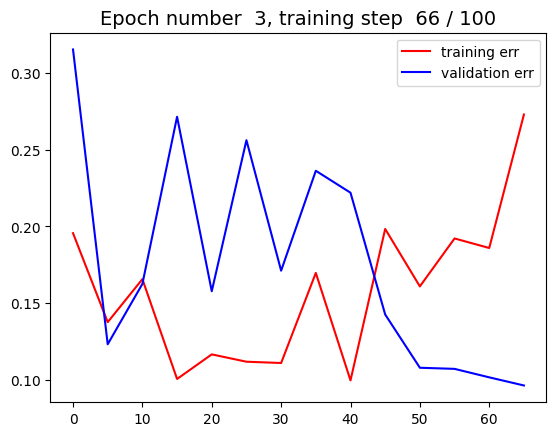

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  70.0 %
70
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70]
[0.19557324051856995, 0.1375863254070282, 0.1656149923801422, 0.10057930648326874, 0.11659786850214005, 0.11181169748306274, 0.11097614467144012, 0.16966061294078827, 0.09964849054813385, 0.1983048915863037, 0.1608789712190628, 0.19211655855178833, 0.18589720129966736, 0.2728535234928131, 0.0910312756896019]
[0.31522631645202637, 0.1231859028339386, 0.1625077724456787, 0.27139151096343994, 0.15772728621959686, 0.25613242387771606, 0.17112234234809875, 0.2362080216407776, 0.22191846370697021, 0.14257818460464478, 0.10788408666849136, 0.10715731233358383, 0.10163208097219467, 0.09633614122867584, 0.1168944239616394]


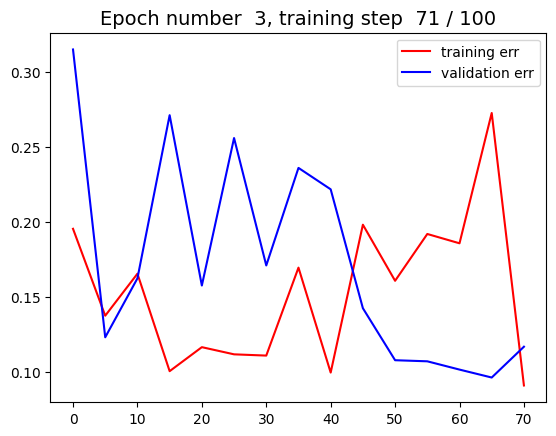

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  75.0 %
75
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75]
[0.19557324051856995, 0.1375863254070282, 0.1656149923801422, 0.10057930648326874, 0.11659786850214005, 0.11181169748306274, 0.11097614467144012, 0.16966061294078827, 0.09964849054813385, 0.1983048915863037, 0.1608789712190628, 0.19211655855178833, 0.18589720129966736, 0.2728535234928131, 0.0910312756896019, 0.17334924638271332]
[0.31522631645202637, 0.1231859028339386, 0.1625077724456787, 0.27139151096343994, 0.15772728621959686, 0.25613242387771606, 0.17112234234809875, 0.2362080216407776, 0.22191846370697021, 0.14257818460464478, 0.10788408666849136, 0.10715731233358383, 0.10163208097219467, 0.09633614122867584, 0.1168944239616394, 0.2128528356552124]


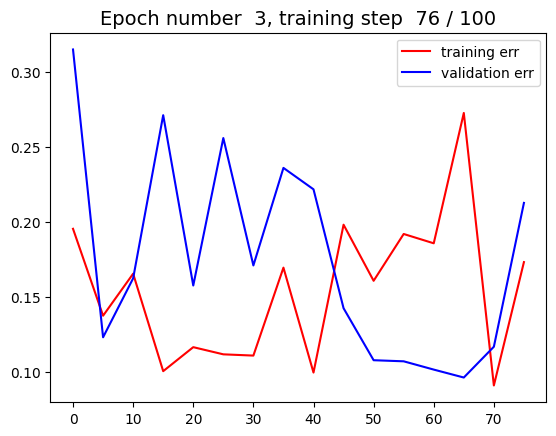

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  80.0 %
80
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80]
[0.19557324051856995, 0.1375863254070282, 0.1656149923801422, 0.10057930648326874, 0.11659786850214005, 0.11181169748306274, 0.11097614467144012, 0.16966061294078827, 0.09964849054813385, 0.1983048915863037, 0.1608789712190628, 0.19211655855178833, 0.18589720129966736, 0.2728535234928131, 0.0910312756896019, 0.17334924638271332, 0.16443735361099243]
[0.31522631645202637, 0.1231859028339386, 0.1625077724456787, 0.27139151096343994, 0.15772728621959686, 0.25613242387771606, 0.17112234234809875, 0.2362080216407776, 0.22191846370697021, 0.14257818460464478, 0.10788408666849136, 0.10715731233358383, 0.10163208097219467, 0.09633614122867584, 0.1168944239616394, 0.2128528356552124, 0.10817887634038925]


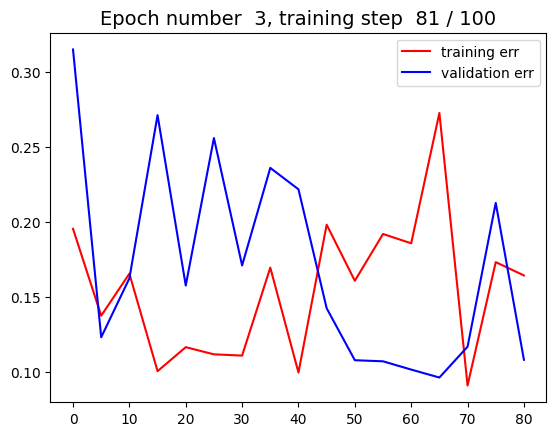

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  85.0 %
85
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85]
[0.19557324051856995, 0.1375863254070282, 0.1656149923801422, 0.10057930648326874, 0.11659786850214005, 0.11181169748306274, 0.11097614467144012, 0.16966061294078827, 0.09964849054813385, 0.1983048915863037, 0.1608789712190628, 0.19211655855178833, 0.18589720129966736, 0.2728535234928131, 0.0910312756896019, 0.17334924638271332, 0.16443735361099243, 0.22168640792369843]
[0.31522631645202637, 0.1231859028339386, 0.1625077724456787, 0.27139151096343994, 0.15772728621959686, 0.25613242387771606, 0.17112234234809875, 0.2362080216407776, 0.22191846370697021, 0.14257818460464478, 0.10788408666849136, 0.10715731233358383, 0.10163208097219467, 0.09633614122867584, 0.1168944239616394, 0.2128528356552124, 0.10817887634038925, 0.2656155526638031]


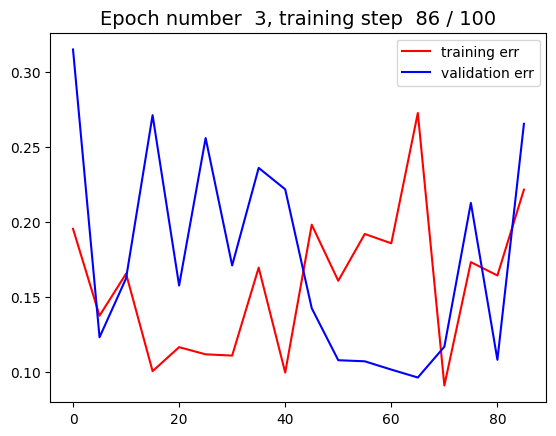

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  90.0 %
90
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90]
[0.19557324051856995, 0.1375863254070282, 0.1656149923801422, 0.10057930648326874, 0.11659786850214005, 0.11181169748306274, 0.11097614467144012, 0.16966061294078827, 0.09964849054813385, 0.1983048915863037, 0.1608789712190628, 0.19211655855178833, 0.18589720129966736, 0.2728535234928131, 0.0910312756896019, 0.17334924638271332, 0.16443735361099243, 0.22168640792369843, 0.13749456405639648]
[0.31522631645202637, 0.1231859028339386, 0.1625077724456787, 0.27139151096343994, 0.15772728621959686, 0.25613242387771606, 0.17112234234809875, 0.2362080216407776, 0.22191846370697021, 0.14257818460464478, 0.10788408666849136, 0.10715731233358383, 0.10163208097219467, 0.09633614122867584, 0.1168944239616394, 0.2128528356552124, 0.10817887634038925, 0.2656155526638031, 0.1953640878200531]


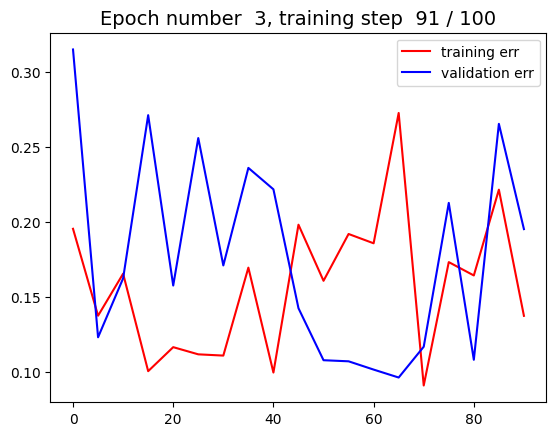

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  95.0 %
95
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95]
[0.19557324051856995, 0.1375863254070282, 0.1656149923801422, 0.10057930648326874, 0.11659786850214005, 0.11181169748306274, 0.11097614467144012, 0.16966061294078827, 0.09964849054813385, 0.1983048915863037, 0.1608789712190628, 0.19211655855178833, 0.18589720129966736, 0.2728535234928131, 0.0910312756896019, 0.17334924638271332, 0.16443735361099243, 0.22168640792369843, 0.13749456405639648, 0.1310959905385971]
[0.31522631645202637, 0.1231859028339386, 0.1625077724456787, 0.27139151096343994, 0.15772728621959686, 0.25613242387771606, 0.17112234234809875, 0.2362080216407776, 0.22191846370697021, 0.14257818460464478, 0.10788408666849136, 0.10715731233358383, 0.10163208097219467, 0.09633614122867584, 0.1168944239616394, 0.2128528356552124, 0.10817887634038925, 0.2656155526638031, 0.1953640878200531, 0.1

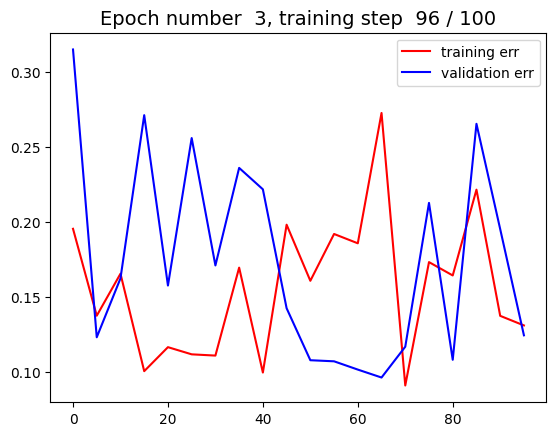

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  100.0 %
100
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
[0.19557324051856995, 0.1375863254070282, 0.1656149923801422, 0.10057930648326874, 0.11659786850214005, 0.11181169748306274, 0.11097614467144012, 0.16966061294078827, 0.09964849054813385, 0.1983048915863037, 0.1608789712190628, 0.19211655855178833, 0.18589720129966736, 0.2728535234928131, 0.0910312756896019, 0.17334924638271332, 0.16443735361099243, 0.22168640792369843, 0.13749456405639648, 0.1310959905385971, 0.20690344274044037]
[0.31522631645202637, 0.1231859028339386, 0.1625077724456787, 0.27139151096343994, 0.15772728621959686, 0.25613242387771606, 0.17112234234809875, 0.2362080216407776, 0.22191846370697021, 0.14257818460464478, 0.10788408666849136, 0.10715731233358383, 0.10163208097219467, 0.09633614122867584, 0.1168944239616394, 0.2128528356552124, 0.10817887634038925, 0.2656155526638

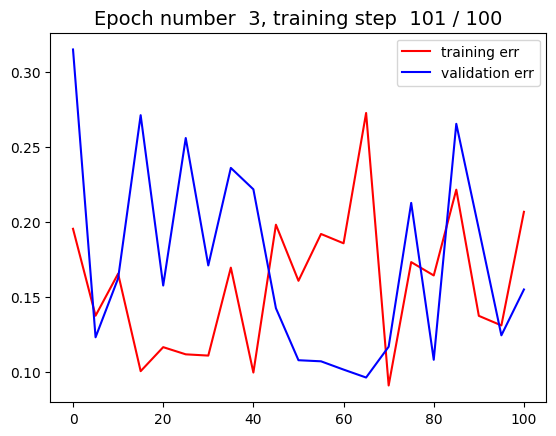

--------------------------------------------
Exiting early, validation error array:  [0.10817888 0.26561555 0.19536409 0.12450059 0.15507901] . Training error array:  [0.16443735 0.22168641 0.13749456 0.13109599 0.20690344]
Completed training for clique = 
Completed training for clique =  45 % correct on test set = [100.0, 100.0, 87.5, 96.875] $k/sqrt{n}$ = [6.0, 5.5, 5.0, 4.5]
Clique size is now:  40
Epoch number =  1 . Percentage of training completed =  0.0 %
0
[0]
[0.37279582023620605]
[0.2488025724887848]


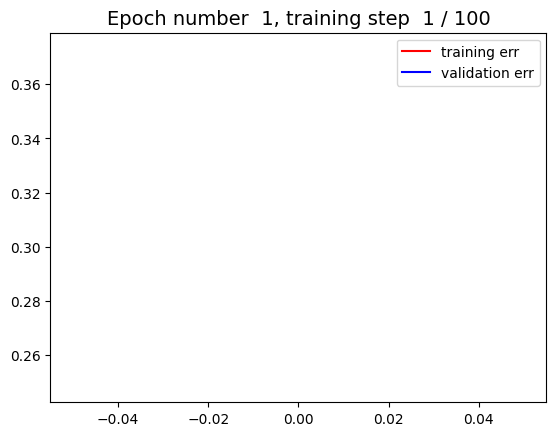

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  5.0 %
5
[0, 5]
[0.37279582023620605, 0.13194584846496582]
[0.2488025724887848, 0.17832712829113007]


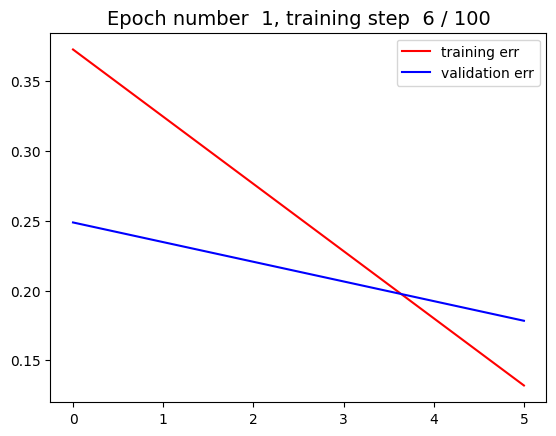

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  10.0 %
10
[0, 5, 10]
[0.37279582023620605, 0.13194584846496582, 0.24186135828495026]
[0.2488025724887848, 0.17832712829113007, 0.1388184279203415]


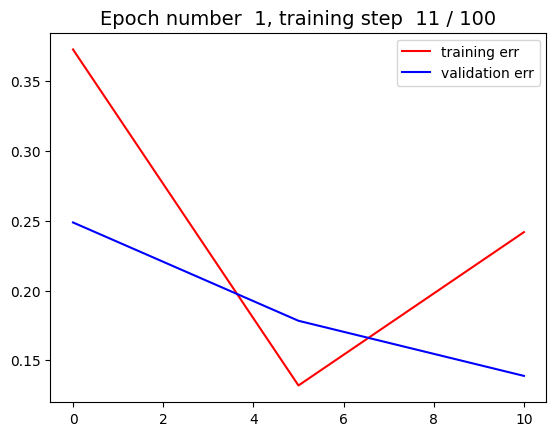

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  15.0 %
15
[0, 5, 10, 15]
[0.37279582023620605, 0.13194584846496582, 0.24186135828495026, 0.29009583592414856]
[0.2488025724887848, 0.17832712829113007, 0.1388184279203415, 0.27620211243629456]


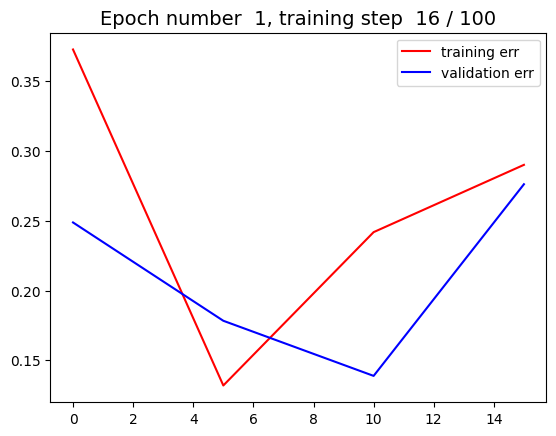

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  20.0 %
20
[0, 5, 10, 15, 20]
[0.37279582023620605, 0.13194584846496582, 0.24186135828495026, 0.29009583592414856, 0.12118542939424515]
[0.2488025724887848, 0.17832712829113007, 0.1388184279203415, 0.27620211243629456, 0.25242483615875244]


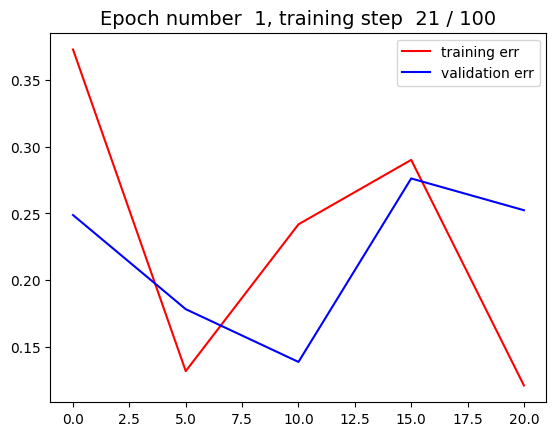

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  25.0 %
25
[0, 5, 10, 15, 20, 25]
[0.37279582023620605, 0.13194584846496582, 0.24186135828495026, 0.29009583592414856, 0.12118542939424515, 0.18574489653110504]
[0.2488025724887848, 0.17832712829113007, 0.1388184279203415, 0.27620211243629456, 0.25242483615875244, 0.28652089834213257]


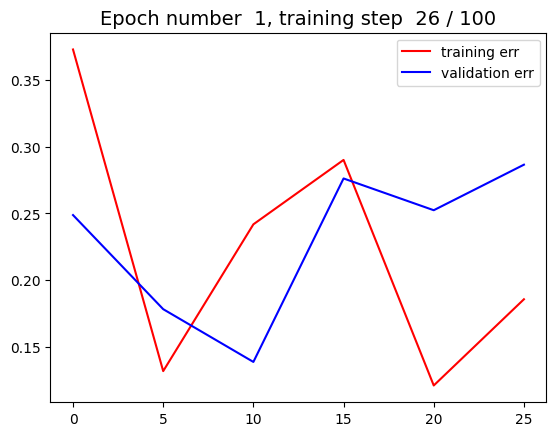

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  30.0 %
30
[0, 5, 10, 15, 20, 25, 30]
[0.37279582023620605, 0.13194584846496582, 0.24186135828495026, 0.29009583592414856, 0.12118542939424515, 0.18574489653110504, 0.2748313248157501]
[0.2488025724887848, 0.17832712829113007, 0.1388184279203415, 0.27620211243629456, 0.25242483615875244, 0.28652089834213257, 0.2859658896923065]


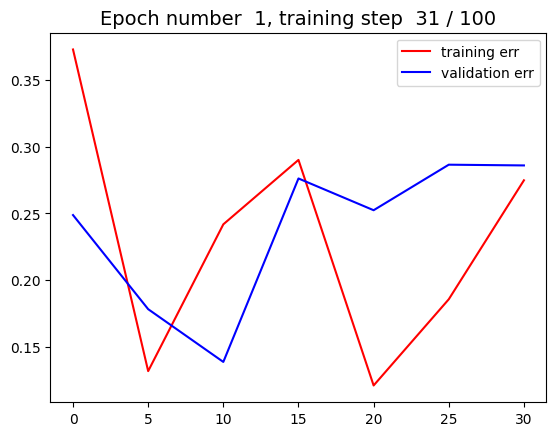

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  35.0 %
35
[0, 5, 10, 15, 20, 25, 30, 35]
[0.37279582023620605, 0.13194584846496582, 0.24186135828495026, 0.29009583592414856, 0.12118542939424515, 0.18574489653110504, 0.2748313248157501, 0.22404125332832336]
[0.2488025724887848, 0.17832712829113007, 0.1388184279203415, 0.27620211243629456, 0.25242483615875244, 0.28652089834213257, 0.2859658896923065, 0.3139246702194214]


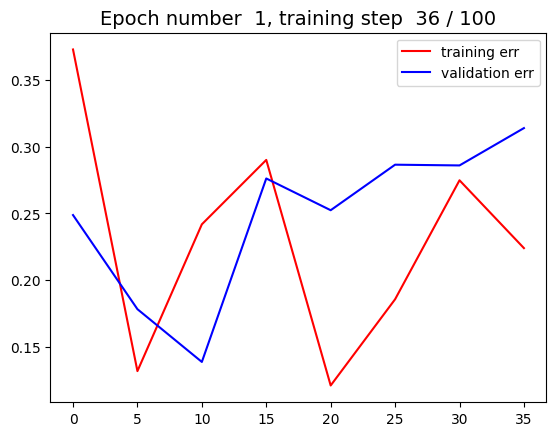

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  40.0 %
40
[0, 5, 10, 15, 20, 25, 30, 35, 40]
[0.37279582023620605, 0.13194584846496582, 0.24186135828495026, 0.29009583592414856, 0.12118542939424515, 0.18574489653110504, 0.2748313248157501, 0.22404125332832336, 0.20962555706501007]
[0.2488025724887848, 0.17832712829113007, 0.1388184279203415, 0.27620211243629456, 0.25242483615875244, 0.28652089834213257, 0.2859658896923065, 0.3139246702194214, 0.2794986665248871]


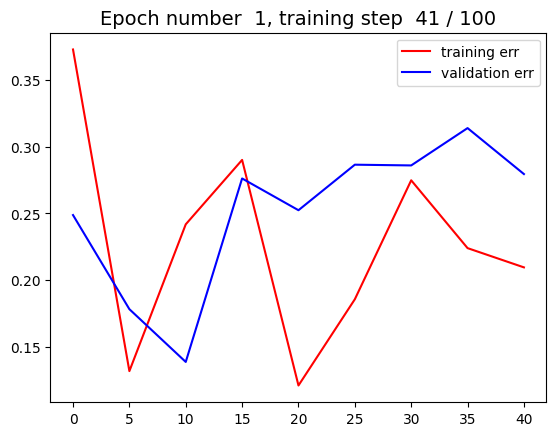

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  45.0 %
45
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
[0.37279582023620605, 0.13194584846496582, 0.24186135828495026, 0.29009583592414856, 0.12118542939424515, 0.18574489653110504, 0.2748313248157501, 0.22404125332832336, 0.20962555706501007, 0.3683759570121765]
[0.2488025724887848, 0.17832712829113007, 0.1388184279203415, 0.27620211243629456, 0.25242483615875244, 0.28652089834213257, 0.2859658896923065, 0.3139246702194214, 0.2794986665248871, 0.17640450596809387]


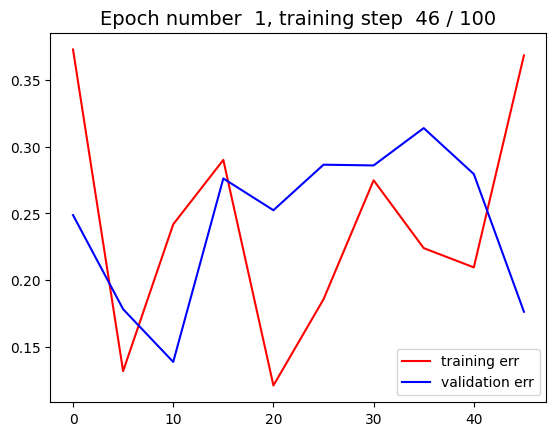

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  50.0 %
50
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]
[0.37279582023620605, 0.13194584846496582, 0.24186135828495026, 0.29009583592414856, 0.12118542939424515, 0.18574489653110504, 0.2748313248157501, 0.22404125332832336, 0.20962555706501007, 0.3683759570121765, 0.18400228023529053]
[0.2488025724887848, 0.17832712829113007, 0.1388184279203415, 0.27620211243629456, 0.25242483615875244, 0.28652089834213257, 0.2859658896923065, 0.3139246702194214, 0.2794986665248871, 0.17640450596809387, 0.1717144399881363]


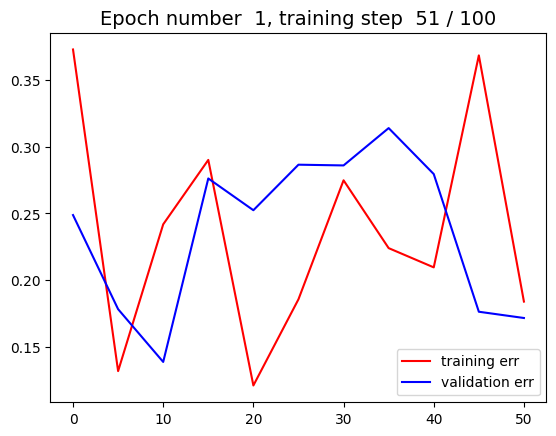

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  55.0 %
55
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55]
[0.37279582023620605, 0.13194584846496582, 0.24186135828495026, 0.29009583592414856, 0.12118542939424515, 0.18574489653110504, 0.2748313248157501, 0.22404125332832336, 0.20962555706501007, 0.3683759570121765, 0.18400228023529053, 0.2291930466890335]
[0.2488025724887848, 0.17832712829113007, 0.1388184279203415, 0.27620211243629456, 0.25242483615875244, 0.28652089834213257, 0.2859658896923065, 0.3139246702194214, 0.2794986665248871, 0.17640450596809387, 0.1717144399881363, 0.30996131896972656]


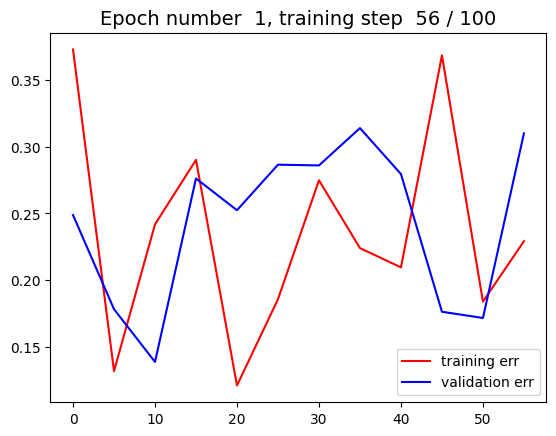

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  60.0 %
60
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]
[0.37279582023620605, 0.13194584846496582, 0.24186135828495026, 0.29009583592414856, 0.12118542939424515, 0.18574489653110504, 0.2748313248157501, 0.22404125332832336, 0.20962555706501007, 0.3683759570121765, 0.18400228023529053, 0.2291930466890335, 0.21387122571468353]
[0.2488025724887848, 0.17832712829113007, 0.1388184279203415, 0.27620211243629456, 0.25242483615875244, 0.28652089834213257, 0.2859658896923065, 0.3139246702194214, 0.2794986665248871, 0.17640450596809387, 0.1717144399881363, 0.30996131896972656, 0.23267951607704163]


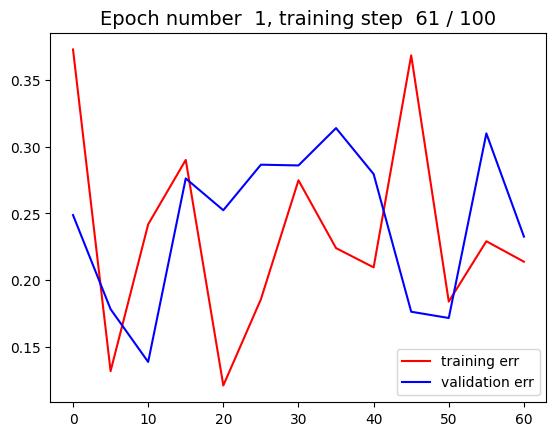

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  65.0 %
65
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65]
[0.37279582023620605, 0.13194584846496582, 0.24186135828495026, 0.29009583592414856, 0.12118542939424515, 0.18574489653110504, 0.2748313248157501, 0.22404125332832336, 0.20962555706501007, 0.3683759570121765, 0.18400228023529053, 0.2291930466890335, 0.21387122571468353, 0.21492767333984375]
[0.2488025724887848, 0.17832712829113007, 0.1388184279203415, 0.27620211243629456, 0.25242483615875244, 0.28652089834213257, 0.2859658896923065, 0.3139246702194214, 0.2794986665248871, 0.17640450596809387, 0.1717144399881363, 0.30996131896972656, 0.23267951607704163, 0.27030080556869507]


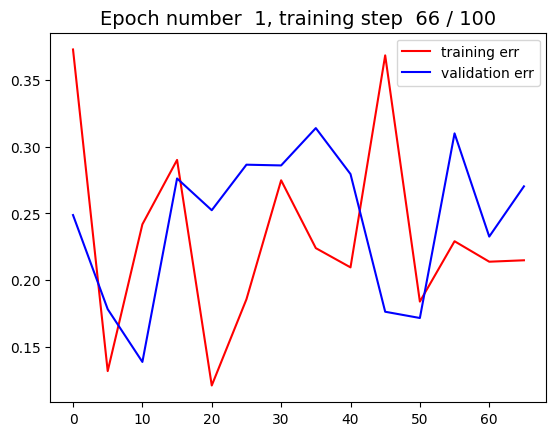

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  70.0 %
70
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70]
[0.37279582023620605, 0.13194584846496582, 0.24186135828495026, 0.29009583592414856, 0.12118542939424515, 0.18574489653110504, 0.2748313248157501, 0.22404125332832336, 0.20962555706501007, 0.3683759570121765, 0.18400228023529053, 0.2291930466890335, 0.21387122571468353, 0.21492767333984375, 0.26771730184555054]
[0.2488025724887848, 0.17832712829113007, 0.1388184279203415, 0.27620211243629456, 0.25242483615875244, 0.28652089834213257, 0.2859658896923065, 0.3139246702194214, 0.2794986665248871, 0.17640450596809387, 0.1717144399881363, 0.30996131896972656, 0.23267951607704163, 0.27030080556869507, 0.22814643383026123]


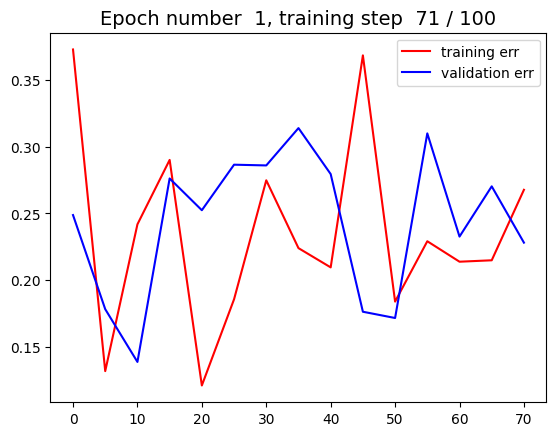

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  75.0 %
75
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75]
[0.37279582023620605, 0.13194584846496582, 0.24186135828495026, 0.29009583592414856, 0.12118542939424515, 0.18574489653110504, 0.2748313248157501, 0.22404125332832336, 0.20962555706501007, 0.3683759570121765, 0.18400228023529053, 0.2291930466890335, 0.21387122571468353, 0.21492767333984375, 0.26771730184555054, 0.39723271131515503]
[0.2488025724887848, 0.17832712829113007, 0.1388184279203415, 0.27620211243629456, 0.25242483615875244, 0.28652089834213257, 0.2859658896923065, 0.3139246702194214, 0.2794986665248871, 0.17640450596809387, 0.1717144399881363, 0.30996131896972656, 0.23267951607704163, 0.27030080556869507, 0.22814643383026123, 0.17986346781253815]


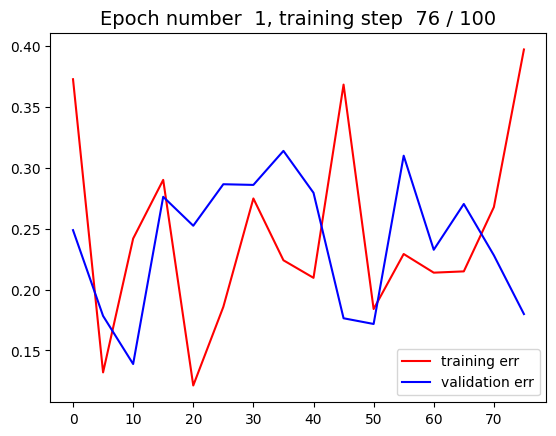

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  80.0 %
80
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80]
[0.37279582023620605, 0.13194584846496582, 0.24186135828495026, 0.29009583592414856, 0.12118542939424515, 0.18574489653110504, 0.2748313248157501, 0.22404125332832336, 0.20962555706501007, 0.3683759570121765, 0.18400228023529053, 0.2291930466890335, 0.21387122571468353, 0.21492767333984375, 0.26771730184555054, 0.39723271131515503, 0.1504155844449997]
[0.2488025724887848, 0.17832712829113007, 0.1388184279203415, 0.27620211243629456, 0.25242483615875244, 0.28652089834213257, 0.2859658896923065, 0.3139246702194214, 0.2794986665248871, 0.17640450596809387, 0.1717144399881363, 0.30996131896972656, 0.23267951607704163, 0.27030080556869507, 0.22814643383026123, 0.17986346781253815, 0.1498432606458664]


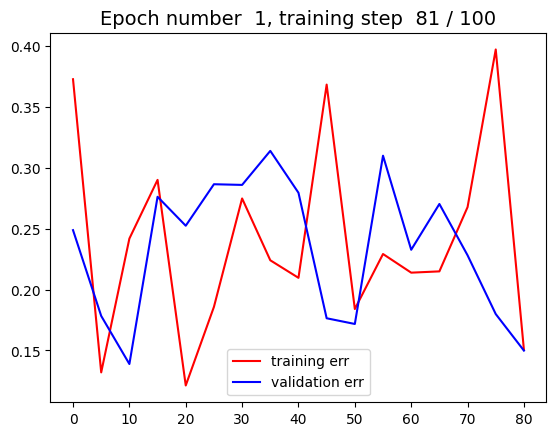

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  85.0 %
85
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85]
[0.37279582023620605, 0.13194584846496582, 0.24186135828495026, 0.29009583592414856, 0.12118542939424515, 0.18574489653110504, 0.2748313248157501, 0.22404125332832336, 0.20962555706501007, 0.3683759570121765, 0.18400228023529053, 0.2291930466890335, 0.21387122571468353, 0.21492767333984375, 0.26771730184555054, 0.39723271131515503, 0.1504155844449997, 0.1310768872499466]
[0.2488025724887848, 0.17832712829113007, 0.1388184279203415, 0.27620211243629456, 0.25242483615875244, 0.28652089834213257, 0.2859658896923065, 0.3139246702194214, 0.2794986665248871, 0.17640450596809387, 0.1717144399881363, 0.30996131896972656, 0.23267951607704163, 0.27030080556869507, 0.22814643383026123, 0.17986346781253815, 0.1498432606458664, 0.3343878388404846]


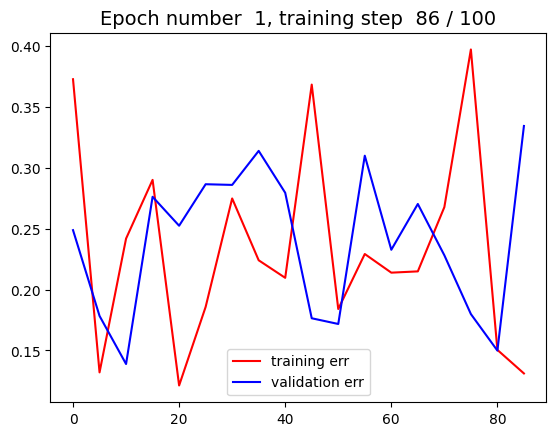

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  90.0 %
90
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90]
[0.37279582023620605, 0.13194584846496582, 0.24186135828495026, 0.29009583592414856, 0.12118542939424515, 0.18574489653110504, 0.2748313248157501, 0.22404125332832336, 0.20962555706501007, 0.3683759570121765, 0.18400228023529053, 0.2291930466890335, 0.21387122571468353, 0.21492767333984375, 0.26771730184555054, 0.39723271131515503, 0.1504155844449997, 0.1310768872499466, 0.26490360498428345]
[0.2488025724887848, 0.17832712829113007, 0.1388184279203415, 0.27620211243629456, 0.25242483615875244, 0.28652089834213257, 0.2859658896923065, 0.3139246702194214, 0.2794986665248871, 0.17640450596809387, 0.1717144399881363, 0.30996131896972656, 0.23267951607704163, 0.27030080556869507, 0.22814643383026123, 0.17986346781253815, 0.1498432606458664, 0.3343878388404846, 0.23641067743301392]


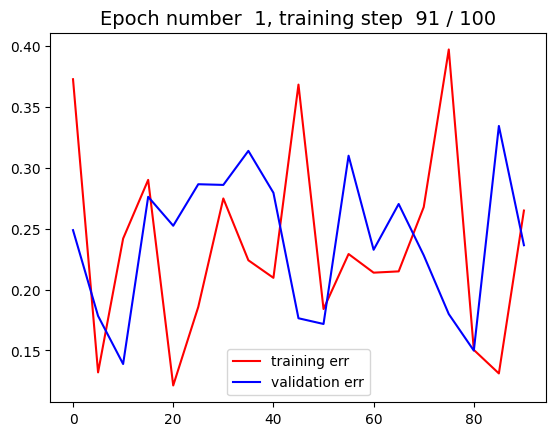

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  95.0 %
95
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95]
[0.37279582023620605, 0.13194584846496582, 0.24186135828495026, 0.29009583592414856, 0.12118542939424515, 0.18574489653110504, 0.2748313248157501, 0.22404125332832336, 0.20962555706501007, 0.3683759570121765, 0.18400228023529053, 0.2291930466890335, 0.21387122571468353, 0.21492767333984375, 0.26771730184555054, 0.39723271131515503, 0.1504155844449997, 0.1310768872499466, 0.26490360498428345, 0.37095797061920166]
[0.2488025724887848, 0.17832712829113007, 0.1388184279203415, 0.27620211243629456, 0.25242483615875244, 0.28652089834213257, 0.2859658896923065, 0.3139246702194214, 0.2794986665248871, 0.17640450596809387, 0.1717144399881363, 0.30996131896972656, 0.23267951607704163, 0.27030080556869507, 0.22814643383026123, 0.17986346781253815, 0.1498432606458664, 0.3343878388404846, 0.23641067743301392, 0.

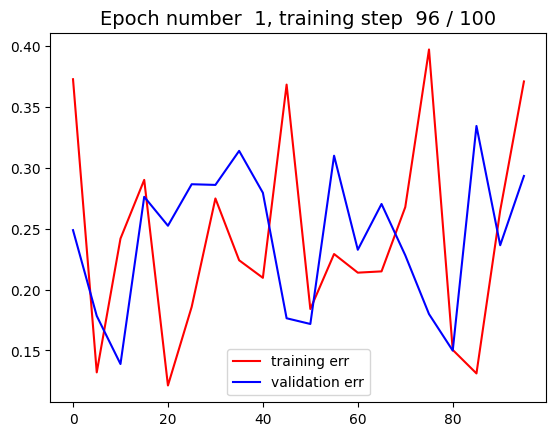

--------------------------------------------
Epoch number =  1 . Percentage of training completed =  100.0 %
100
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
[0.37279582023620605, 0.13194584846496582, 0.24186135828495026, 0.29009583592414856, 0.12118542939424515, 0.18574489653110504, 0.2748313248157501, 0.22404125332832336, 0.20962555706501007, 0.3683759570121765, 0.18400228023529053, 0.2291930466890335, 0.21387122571468353, 0.21492767333984375, 0.26771730184555054, 0.39723271131515503, 0.1504155844449997, 0.1310768872499466, 0.26490360498428345, 0.37095797061920166, 0.2503938674926758]
[0.2488025724887848, 0.17832712829113007, 0.1388184279203415, 0.27620211243629456, 0.25242483615875244, 0.28652089834213257, 0.2859658896923065, 0.3139246702194214, 0.2794986665248871, 0.17640450596809387, 0.1717144399881363, 0.30996131896972656, 0.23267951607704163, 0.27030080556869507, 0.22814643383026123, 0.17986346781253815, 0.1498432606458664, 0.33438783884048

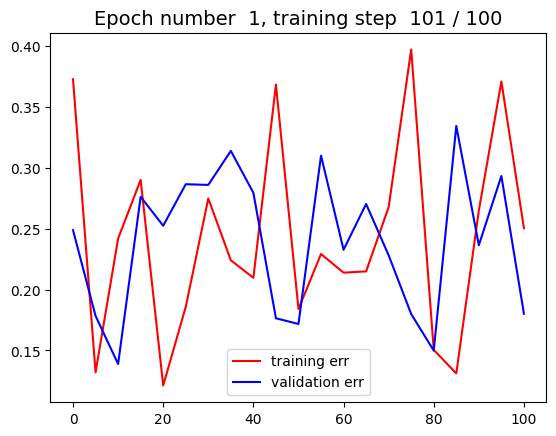

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  0.0 %
0
[0]
[0.525514543056488]
[0.4907626807689667]


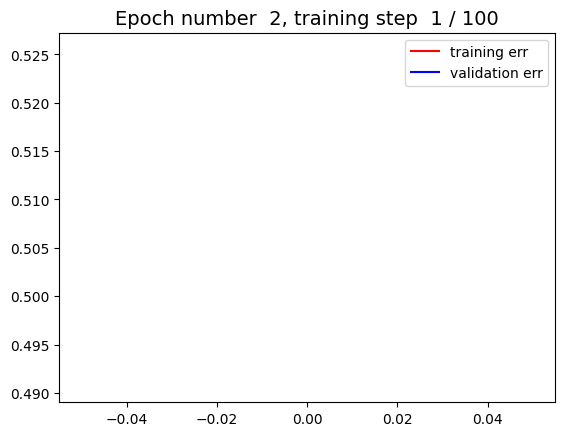

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  5.0 %
5
[0, 5]
[0.525514543056488, 0.22514653205871582]
[0.4907626807689667, 0.15483947098255157]


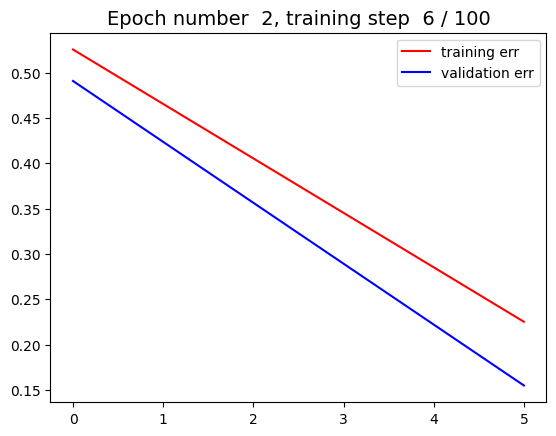

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  10.0 %
10
[0, 5, 10]
[0.525514543056488, 0.22514653205871582, 0.27249112725257874]
[0.4907626807689667, 0.15483947098255157, 0.16321544349193573]


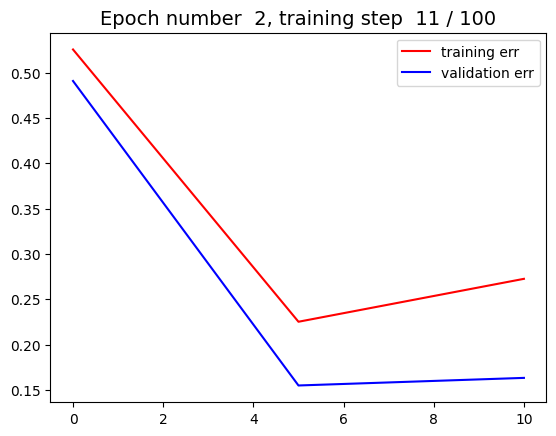

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  15.0 %
15
[0, 5, 10, 15]
[0.525514543056488, 0.22514653205871582, 0.27249112725257874, 0.20700886845588684]
[0.4907626807689667, 0.15483947098255157, 0.16321544349193573, 0.21802327036857605]


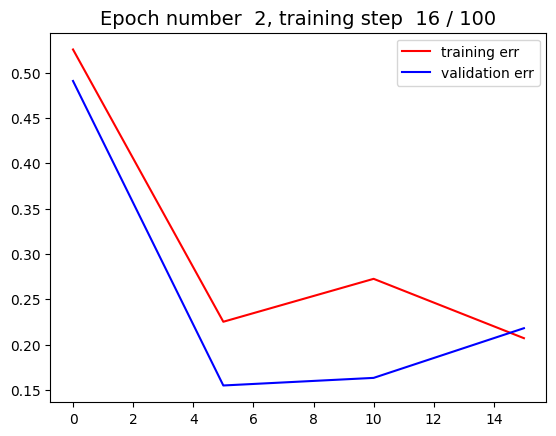

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  20.0 %
20
[0, 5, 10, 15, 20]
[0.525514543056488, 0.22514653205871582, 0.27249112725257874, 0.20700886845588684, 0.3223772943019867]
[0.4907626807689667, 0.15483947098255157, 0.16321544349193573, 0.21802327036857605, 0.2966011166572571]


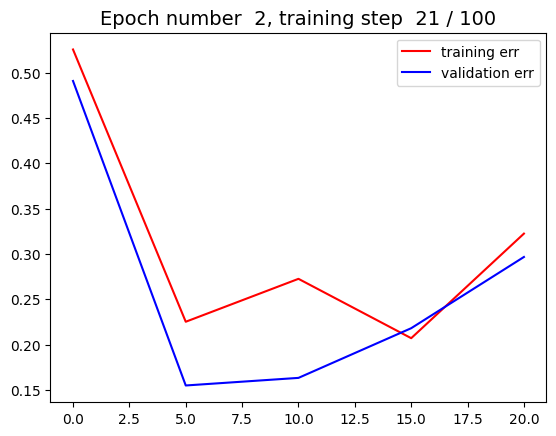

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  25.0 %
25
[0, 5, 10, 15, 20, 25]
[0.525514543056488, 0.22514653205871582, 0.27249112725257874, 0.20700886845588684, 0.3223772943019867, 0.35124072432518005]
[0.4907626807689667, 0.15483947098255157, 0.16321544349193573, 0.21802327036857605, 0.2966011166572571, 0.1546294242143631]


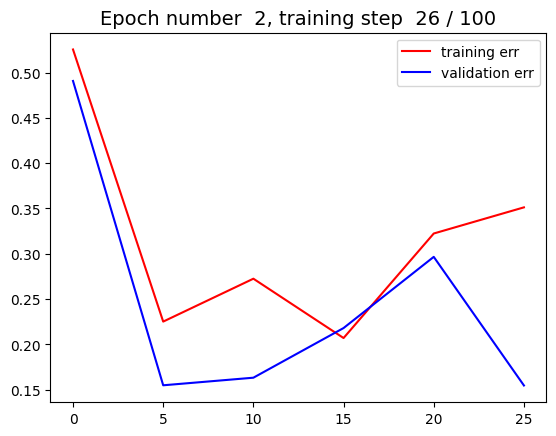

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  30.0 %
30
[0, 5, 10, 15, 20, 25, 30]
[0.525514543056488, 0.22514653205871582, 0.27249112725257874, 0.20700886845588684, 0.3223772943019867, 0.35124072432518005, 0.3288381099700928]
[0.4907626807689667, 0.15483947098255157, 0.16321544349193573, 0.21802327036857605, 0.2966011166572571, 0.1546294242143631, 0.2468727082014084]


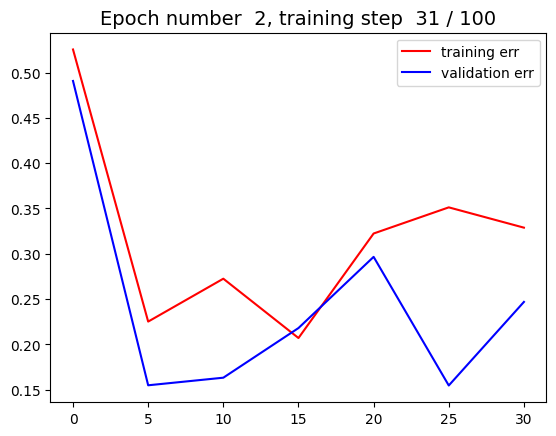

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  35.0 %
35
[0, 5, 10, 15, 20, 25, 30, 35]
[0.525514543056488, 0.22514653205871582, 0.27249112725257874, 0.20700886845588684, 0.3223772943019867, 0.35124072432518005, 0.3288381099700928, 0.17641501128673553]
[0.4907626807689667, 0.15483947098255157, 0.16321544349193573, 0.21802327036857605, 0.2966011166572571, 0.1546294242143631, 0.2468727082014084, 0.16104604303836823]


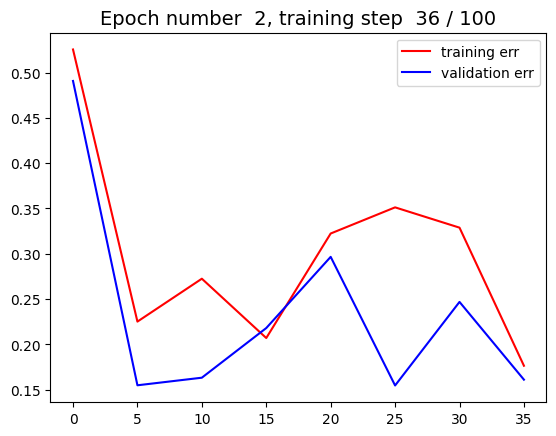

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  40.0 %
40
[0, 5, 10, 15, 20, 25, 30, 35, 40]
[0.525514543056488, 0.22514653205871582, 0.27249112725257874, 0.20700886845588684, 0.3223772943019867, 0.35124072432518005, 0.3288381099700928, 0.17641501128673553, 0.18481093645095825]
[0.4907626807689667, 0.15483947098255157, 0.16321544349193573, 0.21802327036857605, 0.2966011166572571, 0.1546294242143631, 0.2468727082014084, 0.16104604303836823, 0.19131214916706085]


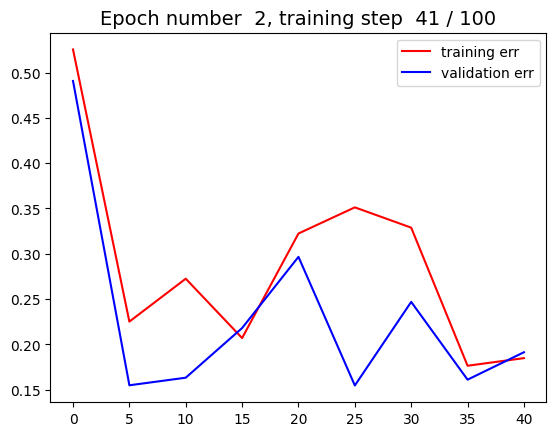

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  45.0 %
45
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
[0.525514543056488, 0.22514653205871582, 0.27249112725257874, 0.20700886845588684, 0.3223772943019867, 0.35124072432518005, 0.3288381099700928, 0.17641501128673553, 0.18481093645095825, 0.37345293164253235]
[0.4907626807689667, 0.15483947098255157, 0.16321544349193573, 0.21802327036857605, 0.2966011166572571, 0.1546294242143631, 0.2468727082014084, 0.16104604303836823, 0.19131214916706085, 0.1671214997768402]


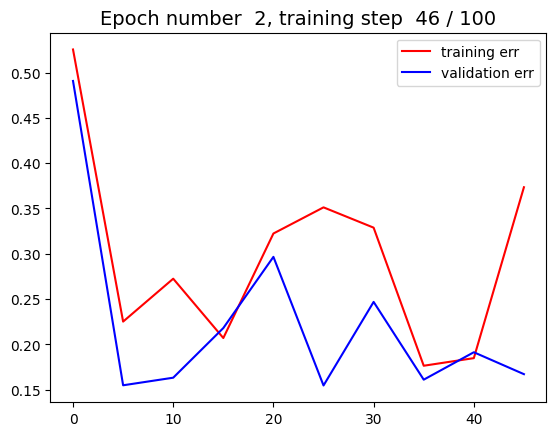

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  50.0 %
50
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]
[0.525514543056488, 0.22514653205871582, 0.27249112725257874, 0.20700886845588684, 0.3223772943019867, 0.35124072432518005, 0.3288381099700928, 0.17641501128673553, 0.18481093645095825, 0.37345293164253235, 0.13529115915298462]
[0.4907626807689667, 0.15483947098255157, 0.16321544349193573, 0.21802327036857605, 0.2966011166572571, 0.1546294242143631, 0.2468727082014084, 0.16104604303836823, 0.19131214916706085, 0.1671214997768402, 0.1016111671924591]


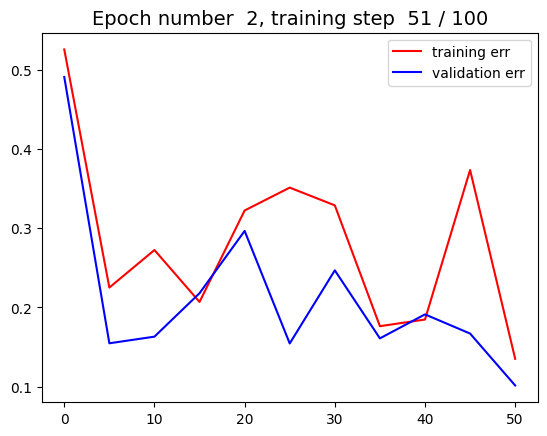

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  55.0 %
55
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55]
[0.525514543056488, 0.22514653205871582, 0.27249112725257874, 0.20700886845588684, 0.3223772943019867, 0.35124072432518005, 0.3288381099700928, 0.17641501128673553, 0.18481093645095825, 0.37345293164253235, 0.13529115915298462, 0.1357678771018982]
[0.4907626807689667, 0.15483947098255157, 0.16321544349193573, 0.21802327036857605, 0.2966011166572571, 0.1546294242143631, 0.2468727082014084, 0.16104604303836823, 0.19131214916706085, 0.1671214997768402, 0.1016111671924591, 0.20231692492961884]


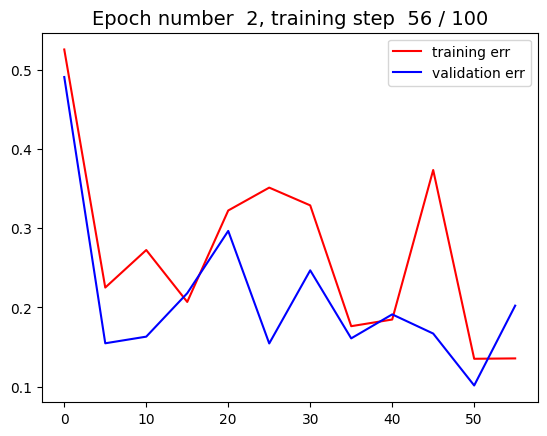

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  60.0 %
60
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]
[0.525514543056488, 0.22514653205871582, 0.27249112725257874, 0.20700886845588684, 0.3223772943019867, 0.35124072432518005, 0.3288381099700928, 0.17641501128673553, 0.18481093645095825, 0.37345293164253235, 0.13529115915298462, 0.1357678771018982, 0.43863651156425476]
[0.4907626807689667, 0.15483947098255157, 0.16321544349193573, 0.21802327036857605, 0.2966011166572571, 0.1546294242143631, 0.2468727082014084, 0.16104604303836823, 0.19131214916706085, 0.1671214997768402, 0.1016111671924591, 0.20231692492961884, 0.18674702942371368]


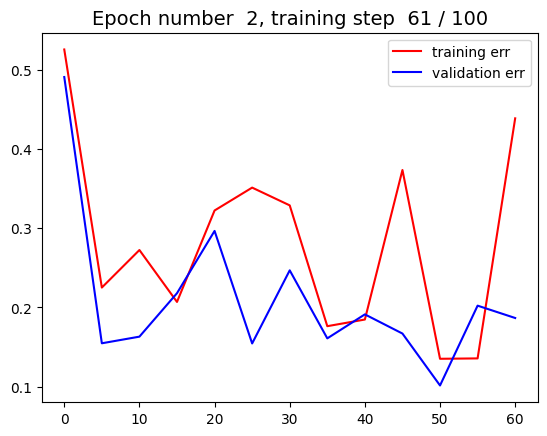

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  65.0 %
65
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65]
[0.525514543056488, 0.22514653205871582, 0.27249112725257874, 0.20700886845588684, 0.3223772943019867, 0.35124072432518005, 0.3288381099700928, 0.17641501128673553, 0.18481093645095825, 0.37345293164253235, 0.13529115915298462, 0.1357678771018982, 0.43863651156425476, 0.12498437613248825]
[0.4907626807689667, 0.15483947098255157, 0.16321544349193573, 0.21802327036857605, 0.2966011166572571, 0.1546294242143631, 0.2468727082014084, 0.16104604303836823, 0.19131214916706085, 0.1671214997768402, 0.1016111671924591, 0.20231692492961884, 0.18674702942371368, 0.18553541600704193]


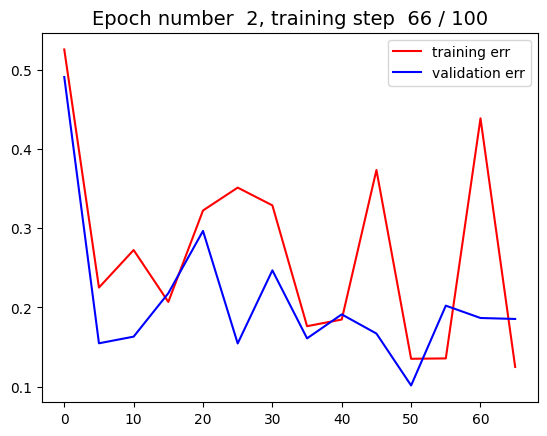

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  70.0 %
70
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70]
[0.525514543056488, 0.22514653205871582, 0.27249112725257874, 0.20700886845588684, 0.3223772943019867, 0.35124072432518005, 0.3288381099700928, 0.17641501128673553, 0.18481093645095825, 0.37345293164253235, 0.13529115915298462, 0.1357678771018982, 0.43863651156425476, 0.12498437613248825, 0.09155302494764328]
[0.4907626807689667, 0.15483947098255157, 0.16321544349193573, 0.21802327036857605, 0.2966011166572571, 0.1546294242143631, 0.2468727082014084, 0.16104604303836823, 0.19131214916706085, 0.1671214997768402, 0.1016111671924591, 0.20231692492961884, 0.18674702942371368, 0.18553541600704193, 0.1278579831123352]


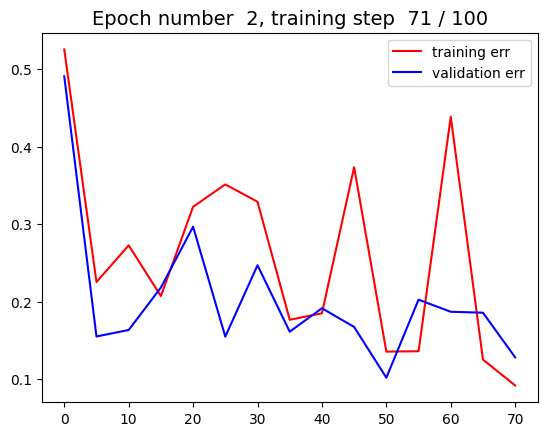

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  75.0 %
75
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75]
[0.525514543056488, 0.22514653205871582, 0.27249112725257874, 0.20700886845588684, 0.3223772943019867, 0.35124072432518005, 0.3288381099700928, 0.17641501128673553, 0.18481093645095825, 0.37345293164253235, 0.13529115915298462, 0.1357678771018982, 0.43863651156425476, 0.12498437613248825, 0.09155302494764328, 0.20434121787548065]
[0.4907626807689667, 0.15483947098255157, 0.16321544349193573, 0.21802327036857605, 0.2966011166572571, 0.1546294242143631, 0.2468727082014084, 0.16104604303836823, 0.19131214916706085, 0.1671214997768402, 0.1016111671924591, 0.20231692492961884, 0.18674702942371368, 0.18553541600704193, 0.1278579831123352, 0.16683000326156616]


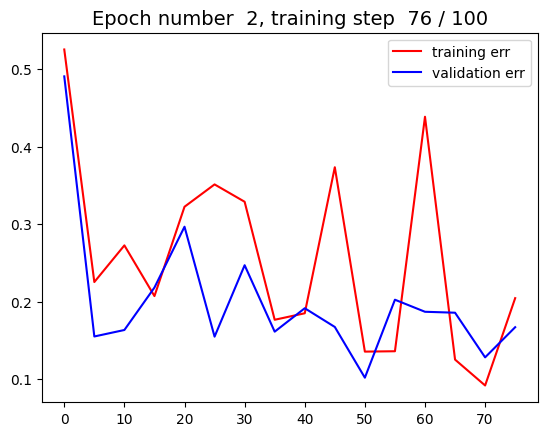

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  80.0 %
80
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80]
[0.525514543056488, 0.22514653205871582, 0.27249112725257874, 0.20700886845588684, 0.3223772943019867, 0.35124072432518005, 0.3288381099700928, 0.17641501128673553, 0.18481093645095825, 0.37345293164253235, 0.13529115915298462, 0.1357678771018982, 0.43863651156425476, 0.12498437613248825, 0.09155302494764328, 0.20434121787548065, 0.3543945252895355]
[0.4907626807689667, 0.15483947098255157, 0.16321544349193573, 0.21802327036857605, 0.2966011166572571, 0.1546294242143631, 0.2468727082014084, 0.16104604303836823, 0.19131214916706085, 0.1671214997768402, 0.1016111671924591, 0.20231692492961884, 0.18674702942371368, 0.18553541600704193, 0.1278579831123352, 0.16683000326156616, 0.10898284614086151]


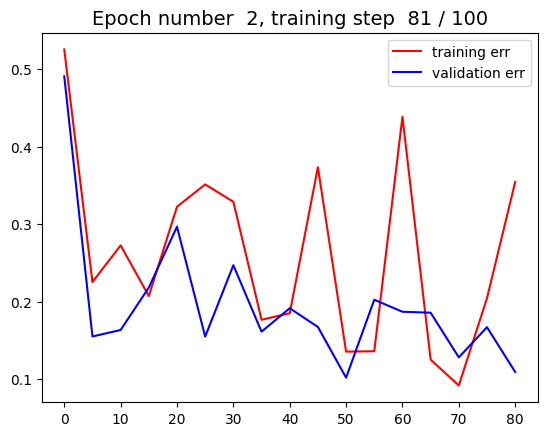

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  85.0 %
85
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85]
[0.525514543056488, 0.22514653205871582, 0.27249112725257874, 0.20700886845588684, 0.3223772943019867, 0.35124072432518005, 0.3288381099700928, 0.17641501128673553, 0.18481093645095825, 0.37345293164253235, 0.13529115915298462, 0.1357678771018982, 0.43863651156425476, 0.12498437613248825, 0.09155302494764328, 0.20434121787548065, 0.3543945252895355, 0.3702496290206909]
[0.4907626807689667, 0.15483947098255157, 0.16321544349193573, 0.21802327036857605, 0.2966011166572571, 0.1546294242143631, 0.2468727082014084, 0.16104604303836823, 0.19131214916706085, 0.1671214997768402, 0.1016111671924591, 0.20231692492961884, 0.18674702942371368, 0.18553541600704193, 0.1278579831123352, 0.16683000326156616, 0.10898284614086151, 0.21585646271705627]


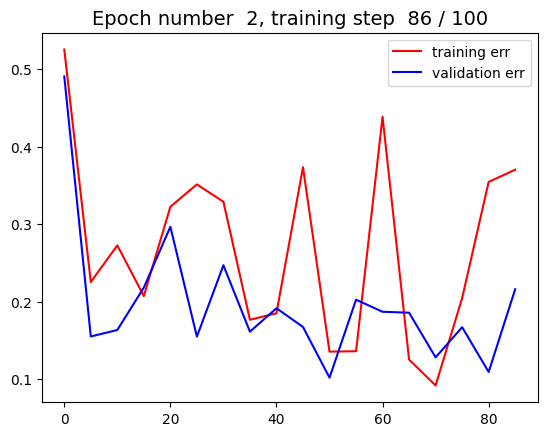

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  90.0 %
90
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90]
[0.525514543056488, 0.22514653205871582, 0.27249112725257874, 0.20700886845588684, 0.3223772943019867, 0.35124072432518005, 0.3288381099700928, 0.17641501128673553, 0.18481093645095825, 0.37345293164253235, 0.13529115915298462, 0.1357678771018982, 0.43863651156425476, 0.12498437613248825, 0.09155302494764328, 0.20434121787548065, 0.3543945252895355, 0.3702496290206909, 0.19764234125614166]
[0.4907626807689667, 0.15483947098255157, 0.16321544349193573, 0.21802327036857605, 0.2966011166572571, 0.1546294242143631, 0.2468727082014084, 0.16104604303836823, 0.19131214916706085, 0.1671214997768402, 0.1016111671924591, 0.20231692492961884, 0.18674702942371368, 0.18553541600704193, 0.1278579831123352, 0.16683000326156616, 0.10898284614086151, 0.21585646271705627, 0.19129838049411774]


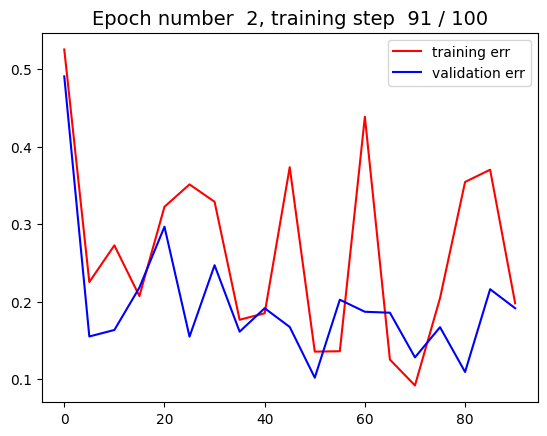

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  95.0 %
95
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95]
[0.525514543056488, 0.22514653205871582, 0.27249112725257874, 0.20700886845588684, 0.3223772943019867, 0.35124072432518005, 0.3288381099700928, 0.17641501128673553, 0.18481093645095825, 0.37345293164253235, 0.13529115915298462, 0.1357678771018982, 0.43863651156425476, 0.12498437613248825, 0.09155302494764328, 0.20434121787548065, 0.3543945252895355, 0.3702496290206909, 0.19764234125614166, 0.31730830669403076]
[0.4907626807689667, 0.15483947098255157, 0.16321544349193573, 0.21802327036857605, 0.2966011166572571, 0.1546294242143631, 0.2468727082014084, 0.16104604303836823, 0.19131214916706085, 0.1671214997768402, 0.1016111671924591, 0.20231692492961884, 0.18674702942371368, 0.18553541600704193, 0.1278579831123352, 0.16683000326156616, 0.10898284614086151, 0.21585646271705627, 0.19129838049411774, 0.3

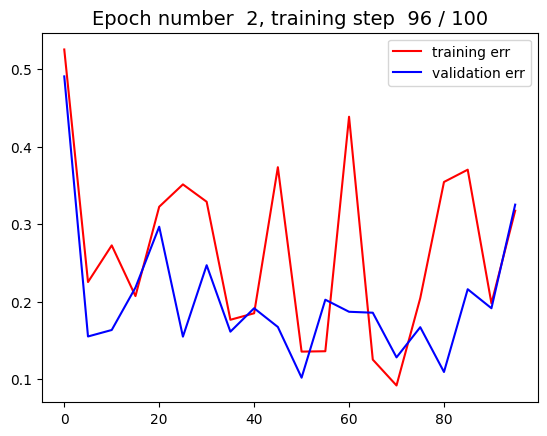

--------------------------------------------
Epoch number =  2 . Percentage of training completed =  100.0 %
100
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
[0.525514543056488, 0.22514653205871582, 0.27249112725257874, 0.20700886845588684, 0.3223772943019867, 0.35124072432518005, 0.3288381099700928, 0.17641501128673553, 0.18481093645095825, 0.37345293164253235, 0.13529115915298462, 0.1357678771018982, 0.43863651156425476, 0.12498437613248825, 0.09155302494764328, 0.20434121787548065, 0.3543945252895355, 0.3702496290206909, 0.19764234125614166, 0.31730830669403076, 0.3432494103908539]
[0.4907626807689667, 0.15483947098255157, 0.16321544349193573, 0.21802327036857605, 0.2966011166572571, 0.1546294242143631, 0.2468727082014084, 0.16104604303836823, 0.19131214916706085, 0.1671214997768402, 0.1016111671924591, 0.20231692492961884, 0.18674702942371368, 0.18553541600704193, 0.1278579831123352, 0.16683000326156616, 0.10898284614086151, 0.2158564627170562

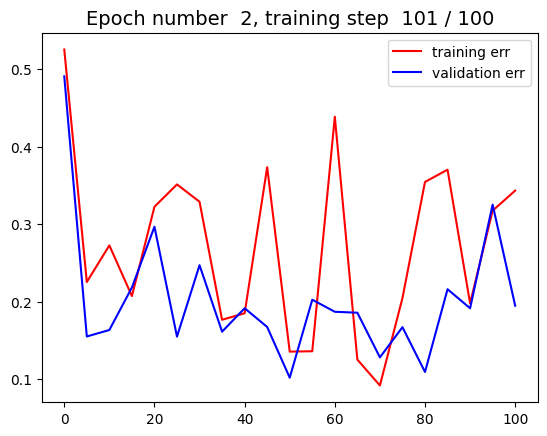

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  0.0 %
0
[0]
[0.415344774723053]
[0.12996956706047058]


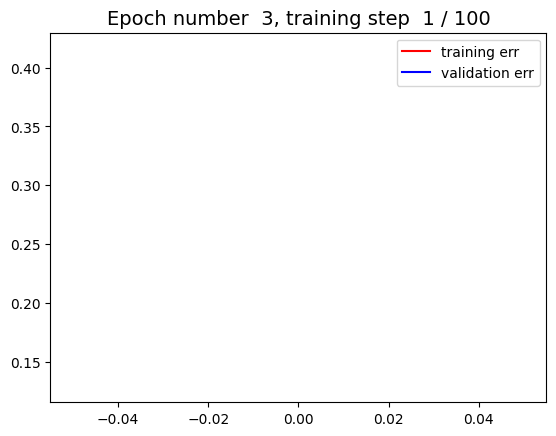

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  5.0 %
5
[0, 5]
[0.415344774723053, 0.11536482721567154]
[0.12996956706047058, 0.13087227940559387]


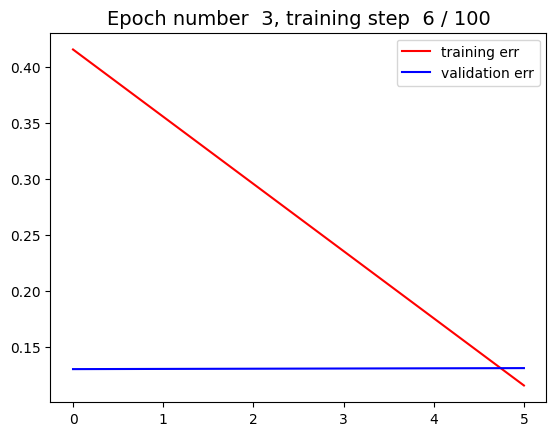

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  10.0 %
10
[0, 5, 10]
[0.415344774723053, 0.11536482721567154, 0.3031594753265381]
[0.12996956706047058, 0.13087227940559387, 0.13754895329475403]


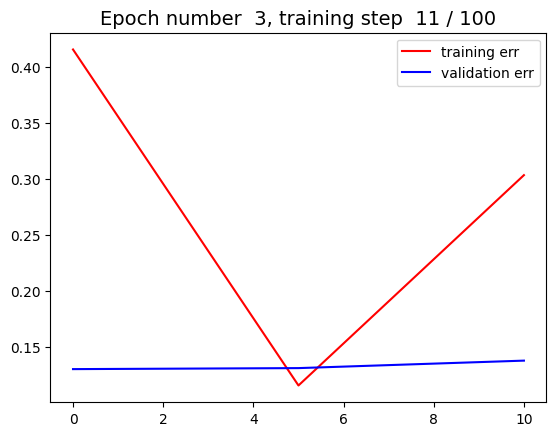

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  15.0 %
15
[0, 5, 10, 15]
[0.415344774723053, 0.11536482721567154, 0.3031594753265381, 0.29794803261756897]
[0.12996956706047058, 0.13087227940559387, 0.13754895329475403, 0.24317201972007751]


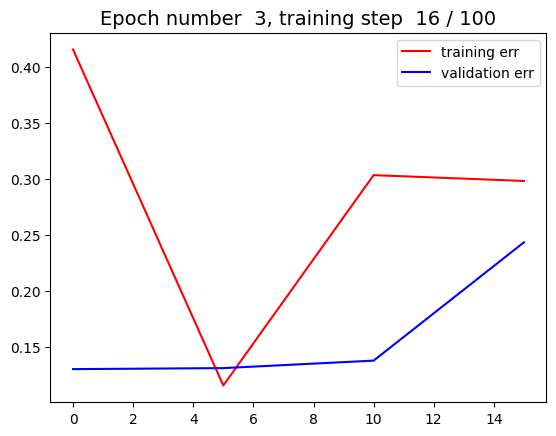

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  20.0 %
20
[0, 5, 10, 15, 20]
[0.415344774723053, 0.11536482721567154, 0.3031594753265381, 0.29794803261756897, 0.21196386218070984]
[0.12996956706047058, 0.13087227940559387, 0.13754895329475403, 0.24317201972007751, 0.18511928617954254]


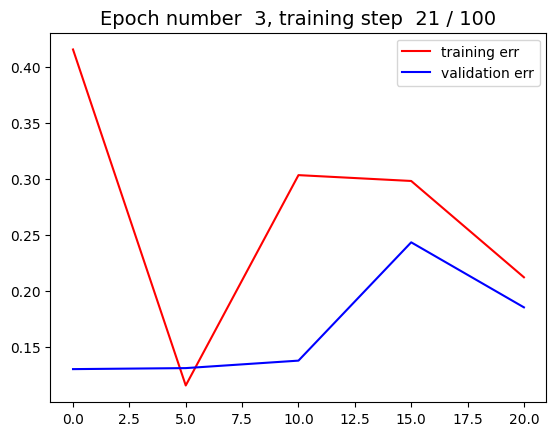

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  25.0 %
25
[0, 5, 10, 15, 20, 25]
[0.415344774723053, 0.11536482721567154, 0.3031594753265381, 0.29794803261756897, 0.21196386218070984, 0.25767070055007935]
[0.12996956706047058, 0.13087227940559387, 0.13754895329475403, 0.24317201972007751, 0.18511928617954254, 0.21321609616279602]


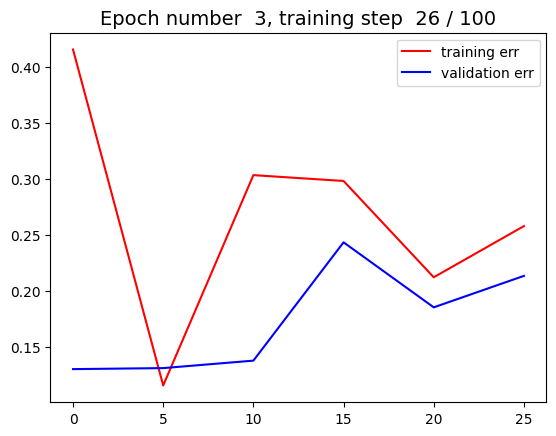

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  30.0 %
30
[0, 5, 10, 15, 20, 25, 30]
[0.415344774723053, 0.11536482721567154, 0.3031594753265381, 0.29794803261756897, 0.21196386218070984, 0.25767070055007935, 0.35386812686920166]
[0.12996956706047058, 0.13087227940559387, 0.13754895329475403, 0.24317201972007751, 0.18511928617954254, 0.21321609616279602, 0.11659227311611176]


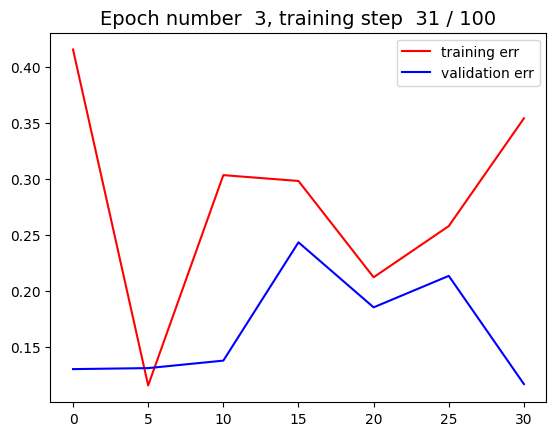

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  35.0 %
35
[0, 5, 10, 15, 20, 25, 30, 35]
[0.415344774723053, 0.11536482721567154, 0.3031594753265381, 0.29794803261756897, 0.21196386218070984, 0.25767070055007935, 0.35386812686920166, 0.21911880373954773]
[0.12996956706047058, 0.13087227940559387, 0.13754895329475403, 0.24317201972007751, 0.18511928617954254, 0.21321609616279602, 0.11659227311611176, 0.3223392963409424]


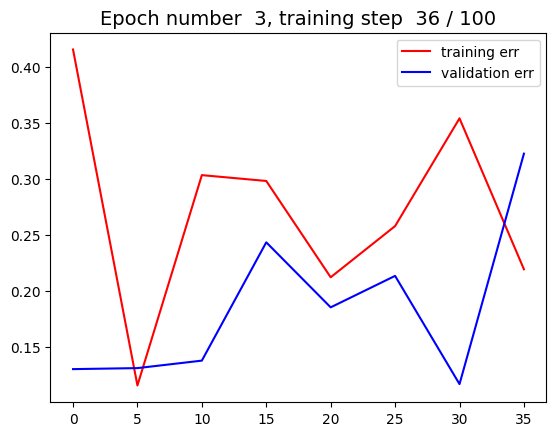

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  40.0 %
40
[0, 5, 10, 15, 20, 25, 30, 35, 40]
[0.415344774723053, 0.11536482721567154, 0.3031594753265381, 0.29794803261756897, 0.21196386218070984, 0.25767070055007935, 0.35386812686920166, 0.21911880373954773, 0.1650821566581726]
[0.12996956706047058, 0.13087227940559387, 0.13754895329475403, 0.24317201972007751, 0.18511928617954254, 0.21321609616279602, 0.11659227311611176, 0.3223392963409424, 0.27268925309181213]


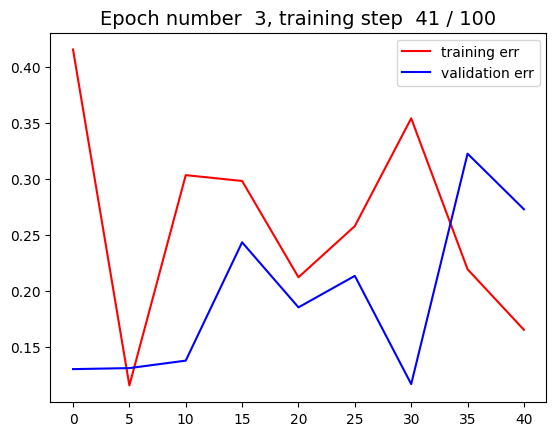

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  45.0 %
45
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
[0.415344774723053, 0.11536482721567154, 0.3031594753265381, 0.29794803261756897, 0.21196386218070984, 0.25767070055007935, 0.35386812686920166, 0.21911880373954773, 0.1650821566581726, 0.1444685459136963]
[0.12996956706047058, 0.13087227940559387, 0.13754895329475403, 0.24317201972007751, 0.18511928617954254, 0.21321609616279602, 0.11659227311611176, 0.3223392963409424, 0.27268925309181213, 0.16707323491573334]


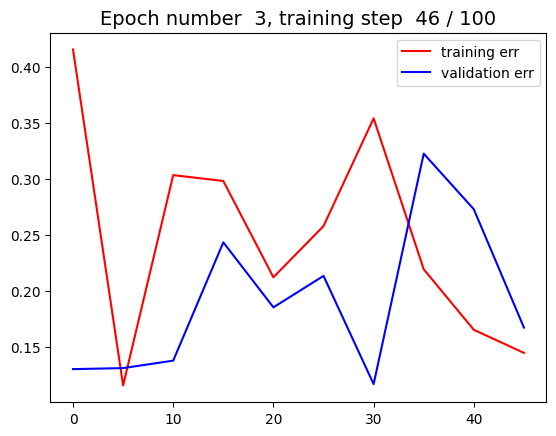

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  50.0 %
50
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]
[0.415344774723053, 0.11536482721567154, 0.3031594753265381, 0.29794803261756897, 0.21196386218070984, 0.25767070055007935, 0.35386812686920166, 0.21911880373954773, 0.1650821566581726, 0.1444685459136963, 0.31374800205230713]
[0.12996956706047058, 0.13087227940559387, 0.13754895329475403, 0.24317201972007751, 0.18511928617954254, 0.21321609616279602, 0.11659227311611176, 0.3223392963409424, 0.27268925309181213, 0.16707323491573334, 0.10158354789018631]


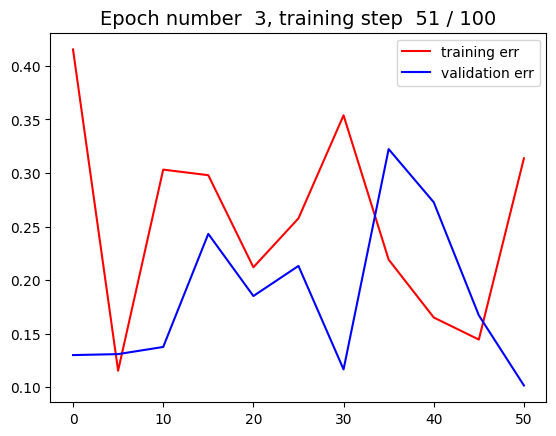

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  55.0 %
55
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55]
[0.415344774723053, 0.11536482721567154, 0.3031594753265381, 0.29794803261756897, 0.21196386218070984, 0.25767070055007935, 0.35386812686920166, 0.21911880373954773, 0.1650821566581726, 0.1444685459136963, 0.31374800205230713, 0.14493146538734436]
[0.12996956706047058, 0.13087227940559387, 0.13754895329475403, 0.24317201972007751, 0.18511928617954254, 0.21321609616279602, 0.11659227311611176, 0.3223392963409424, 0.27268925309181213, 0.16707323491573334, 0.10158354789018631, 0.08118788152933121]


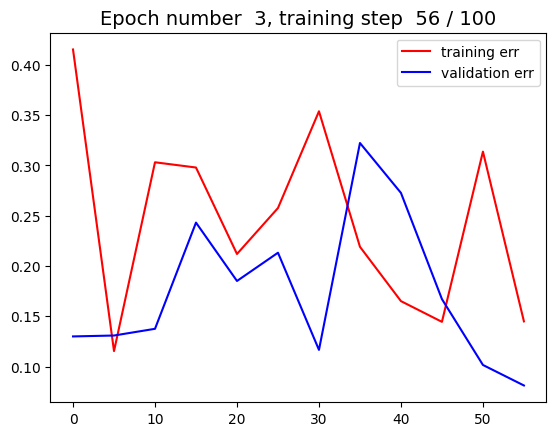

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  60.0 %
60
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]
[0.415344774723053, 0.11536482721567154, 0.3031594753265381, 0.29794803261756897, 0.21196386218070984, 0.25767070055007935, 0.35386812686920166, 0.21911880373954773, 0.1650821566581726, 0.1444685459136963, 0.31374800205230713, 0.14493146538734436, 0.17789329588413239]
[0.12996956706047058, 0.13087227940559387, 0.13754895329475403, 0.24317201972007751, 0.18511928617954254, 0.21321609616279602, 0.11659227311611176, 0.3223392963409424, 0.27268925309181213, 0.16707323491573334, 0.10158354789018631, 0.08118788152933121, 0.20566537976264954]


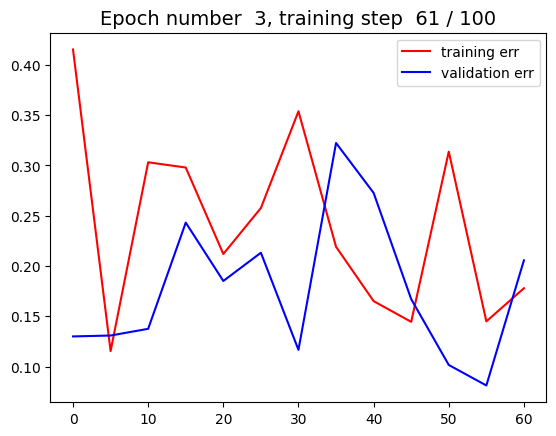

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  65.0 %
65
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65]
[0.415344774723053, 0.11536482721567154, 0.3031594753265381, 0.29794803261756897, 0.21196386218070984, 0.25767070055007935, 0.35386812686920166, 0.21911880373954773, 0.1650821566581726, 0.1444685459136963, 0.31374800205230713, 0.14493146538734436, 0.17789329588413239, 0.150263711810112]
[0.12996956706047058, 0.13087227940559387, 0.13754895329475403, 0.24317201972007751, 0.18511928617954254, 0.21321609616279602, 0.11659227311611176, 0.3223392963409424, 0.27268925309181213, 0.16707323491573334, 0.10158354789018631, 0.08118788152933121, 0.20566537976264954, 0.2566284239292145]


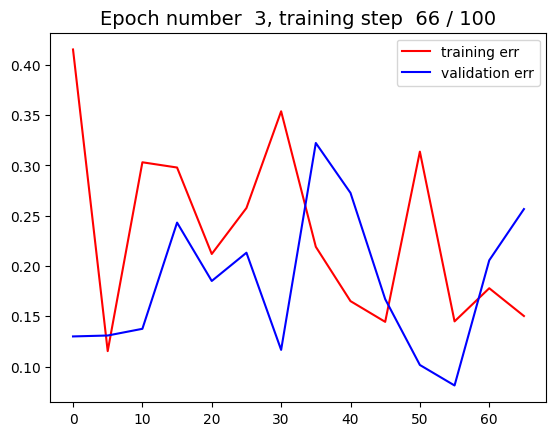

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  70.0 %
70
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70]
[0.415344774723053, 0.11536482721567154, 0.3031594753265381, 0.29794803261756897, 0.21196386218070984, 0.25767070055007935, 0.35386812686920166, 0.21911880373954773, 0.1650821566581726, 0.1444685459136963, 0.31374800205230713, 0.14493146538734436, 0.17789329588413239, 0.150263711810112, 0.21737715601921082]
[0.12996956706047058, 0.13087227940559387, 0.13754895329475403, 0.24317201972007751, 0.18511928617954254, 0.21321609616279602, 0.11659227311611176, 0.3223392963409424, 0.27268925309181213, 0.16707323491573334, 0.10158354789018631, 0.08118788152933121, 0.20566537976264954, 0.2566284239292145, 0.29965895414352417]


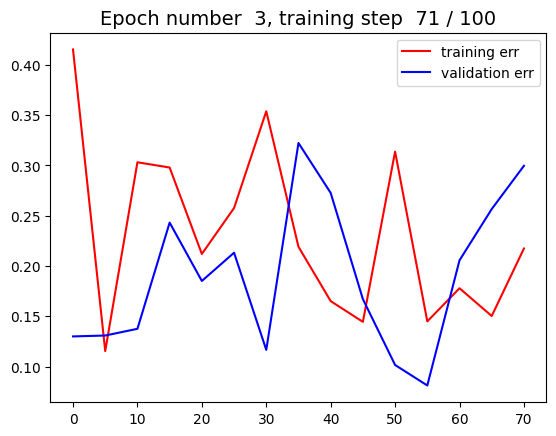

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  75.0 %
75
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75]
[0.415344774723053, 0.11536482721567154, 0.3031594753265381, 0.29794803261756897, 0.21196386218070984, 0.25767070055007935, 0.35386812686920166, 0.21911880373954773, 0.1650821566581726, 0.1444685459136963, 0.31374800205230713, 0.14493146538734436, 0.17789329588413239, 0.150263711810112, 0.21737715601921082, 0.146627277135849]
[0.12996956706047058, 0.13087227940559387, 0.13754895329475403, 0.24317201972007751, 0.18511928617954254, 0.21321609616279602, 0.11659227311611176, 0.3223392963409424, 0.27268925309181213, 0.16707323491573334, 0.10158354789018631, 0.08118788152933121, 0.20566537976264954, 0.2566284239292145, 0.29965895414352417, 0.19599540531635284]


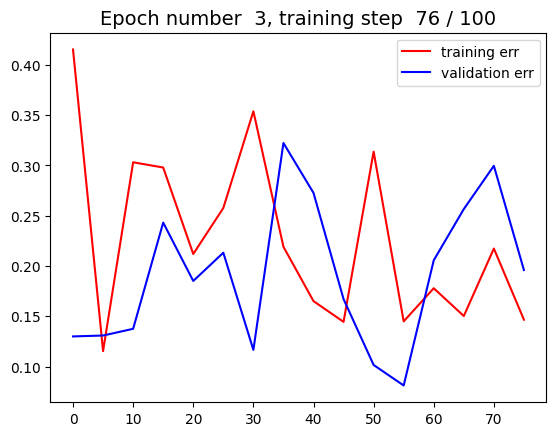

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  80.0 %
80
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80]
[0.415344774723053, 0.11536482721567154, 0.3031594753265381, 0.29794803261756897, 0.21196386218070984, 0.25767070055007935, 0.35386812686920166, 0.21911880373954773, 0.1650821566581726, 0.1444685459136963, 0.31374800205230713, 0.14493146538734436, 0.17789329588413239, 0.150263711810112, 0.21737715601921082, 0.146627277135849, 0.17830124497413635]
[0.12996956706047058, 0.13087227940559387, 0.13754895329475403, 0.24317201972007751, 0.18511928617954254, 0.21321609616279602, 0.11659227311611176, 0.3223392963409424, 0.27268925309181213, 0.16707323491573334, 0.10158354789018631, 0.08118788152933121, 0.20566537976264954, 0.2566284239292145, 0.29965895414352417, 0.19599540531635284, 0.3189963400363922]


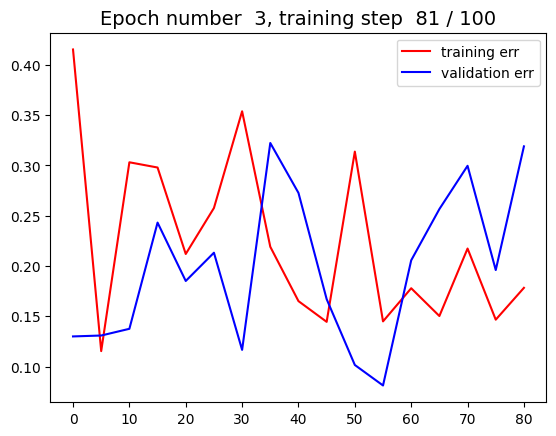

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  85.0 %
85
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85]
[0.415344774723053, 0.11536482721567154, 0.3031594753265381, 0.29794803261756897, 0.21196386218070984, 0.25767070055007935, 0.35386812686920166, 0.21911880373954773, 0.1650821566581726, 0.1444685459136963, 0.31374800205230713, 0.14493146538734436, 0.17789329588413239, 0.150263711810112, 0.21737715601921082, 0.146627277135849, 0.17830124497413635, 0.16884031891822815]
[0.12996956706047058, 0.13087227940559387, 0.13754895329475403, 0.24317201972007751, 0.18511928617954254, 0.21321609616279602, 0.11659227311611176, 0.3223392963409424, 0.27268925309181213, 0.16707323491573334, 0.10158354789018631, 0.08118788152933121, 0.20566537976264954, 0.2566284239292145, 0.29965895414352417, 0.19599540531635284, 0.3189963400363922, 0.1749628633260727]


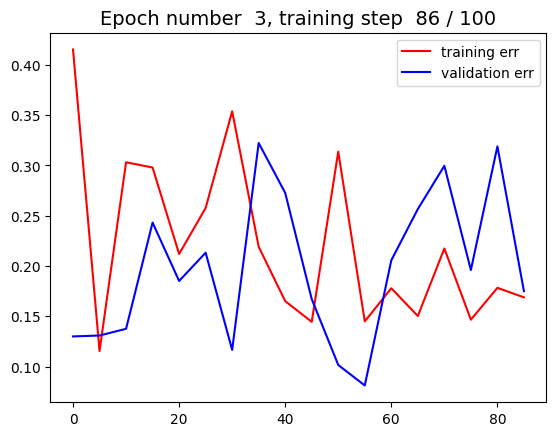

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  90.0 %
90
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90]
[0.415344774723053, 0.11536482721567154, 0.3031594753265381, 0.29794803261756897, 0.21196386218070984, 0.25767070055007935, 0.35386812686920166, 0.21911880373954773, 0.1650821566581726, 0.1444685459136963, 0.31374800205230713, 0.14493146538734436, 0.17789329588413239, 0.150263711810112, 0.21737715601921082, 0.146627277135849, 0.17830124497413635, 0.16884031891822815, 0.10219366103410721]
[0.12996956706047058, 0.13087227940559387, 0.13754895329475403, 0.24317201972007751, 0.18511928617954254, 0.21321609616279602, 0.11659227311611176, 0.3223392963409424, 0.27268925309181213, 0.16707323491573334, 0.10158354789018631, 0.08118788152933121, 0.20566537976264954, 0.2566284239292145, 0.29965895414352417, 0.19599540531635284, 0.3189963400363922, 0.1749628633260727, 0.10095827281475067]


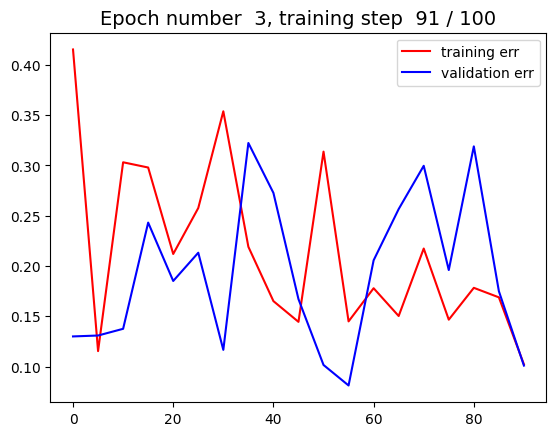

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  95.0 %
95
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95]
[0.415344774723053, 0.11536482721567154, 0.3031594753265381, 0.29794803261756897, 0.21196386218070984, 0.25767070055007935, 0.35386812686920166, 0.21911880373954773, 0.1650821566581726, 0.1444685459136963, 0.31374800205230713, 0.14493146538734436, 0.17789329588413239, 0.150263711810112, 0.21737715601921082, 0.146627277135849, 0.17830124497413635, 0.16884031891822815, 0.10219366103410721, 0.10043662041425705]
[0.12996956706047058, 0.13087227940559387, 0.13754895329475403, 0.24317201972007751, 0.18511928617954254, 0.21321609616279602, 0.11659227311611176, 0.3223392963409424, 0.27268925309181213, 0.16707323491573334, 0.10158354789018631, 0.08118788152933121, 0.20566537976264954, 0.2566284239292145, 0.29965895414352417, 0.19599540531635284, 0.3189963400363922, 0.1749628633260727, 0.10095827281475067, 0.

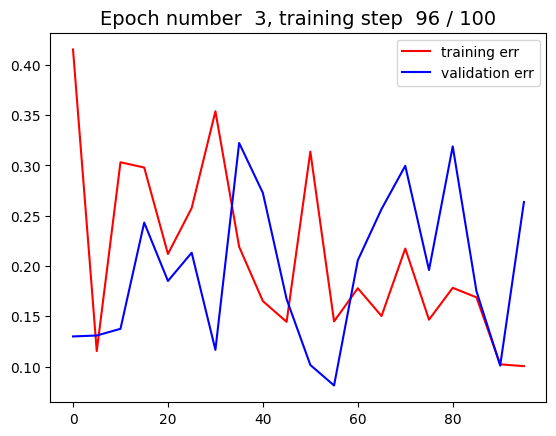

--------------------------------------------
Epoch number =  3 . Percentage of training completed =  100.0 %
100
[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
[0.415344774723053, 0.11536482721567154, 0.3031594753265381, 0.29794803261756897, 0.21196386218070984, 0.25767070055007935, 0.35386812686920166, 0.21911880373954773, 0.1650821566581726, 0.1444685459136963, 0.31374800205230713, 0.14493146538734436, 0.17789329588413239, 0.150263711810112, 0.21737715601921082, 0.146627277135849, 0.17830124497413635, 0.16884031891822815, 0.10219366103410721, 0.10043662041425705, 0.15096822381019592]
[0.12996956706047058, 0.13087227940559387, 0.13754895329475403, 0.24317201972007751, 0.18511928617954254, 0.21321609616279602, 0.11659227311611176, 0.3223392963409424, 0.27268925309181213, 0.16707323491573334, 0.10158354789018631, 0.08118788152933121, 0.20566537976264954, 0.2566284239292145, 0.29965895414352417, 0.19599540531635284, 0.3189963400363922, 0.1749628633260

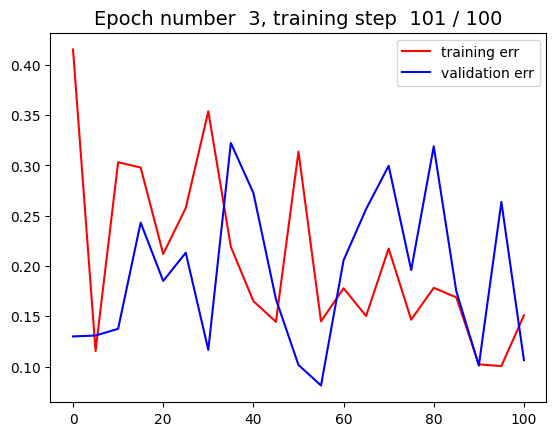

--------------------------------------------
Exiting early, validation error array:  [0.31899634 0.17496286 0.10095827 0.263704   0.10637228] . Training error array:  [0.17830124 0.16884032 0.10219366 0.10043662 0.15096822]
Completed training for clique = 
Completed training for clique =  40 % correct on test set = [100.0, 100.0, 87.5, 96.875, 100.0] $k/sqrt{n}$ = [6.0, 5.5, 5.0, 4.5, 4.0]


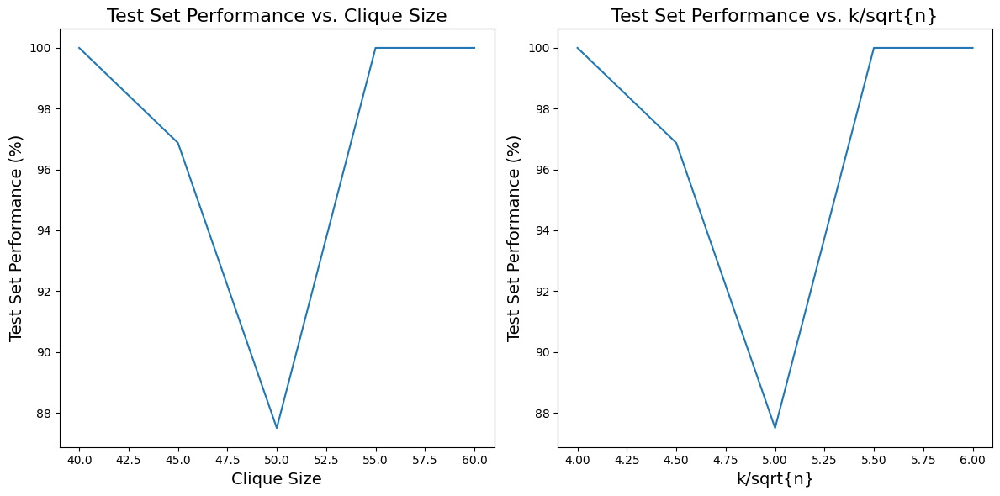

In [ ]:
# Training hyperparameters
training_epochs = 50            # Number of epochs for each clique size
training_steps = 100            # Maximum number of training steps for each epoch (if early stopping never occurs)
num_train = 32                 # Dimension of the training set at each training step
num_val = 32                   # Dimension of the validation set
num_test = 32                  # Dimension of the test set

# Graphs parameters
graph_size = 100               # Number of nodes
start_clique_size = 60         # Dimension of the clique to start training
jump = 5                       # Reduction of the clique size
save_step = 5                  # Number of steps after which we save training and validation error
min_clique_size = 40           # Dimension of the clique to finish training (minimum size, never training on graphs with clique size lower than this)

# Initializations
train_error = []
val_error = []
generalization = []
k_over_sqrt_n = []
clique_sizes_array = []

# Loop for decreasing clique sizes
for current_clique_size in range(start_clique_size,min_clique_size-1, -jump):

  # printing value of clique size when it changes:
  print('Clique size is now: ', current_clique_size)
  # storing values needed for final plot:
  k_over_sqrt_n.append(1.0 * current_clique_size / math.sqrt(graph_size))
  clique_sizes_array.append(current_clique_size)

  # Training epochs loop:
  for epoch in range(training_epochs):

    # Initializing x_axis for each epoch (used for plotting):
    x_axis = []

    # Training steps loop:
    for training_step in range(training_steps+1):

      # Generating training data
      train = generate_graphs(num_train, graph_size, current_clique_size)
      # Forward pass on training data
      train_pred = model_MLP(train[0].to(device))
      # Compute loss on training data
      train_loss = criterion(train_pred.type(torch.float).to(device), torch.Tensor(train[1]).type(torch.long).to(device))

      # Saving errors (both training and validation) and plotting at regular intervals (indicated by "save_step"):
      if training_step % save_step == 0:

        # Incrementing x_axis vector each time data is saved:
        x_axis.append(training_step)

        print('Epoch number ', (epoch), '. Percentage of training completed = ', 100.0 * training_step / training_steps, '%')

        # Storing training error
        train_error.append(train_loss.item())

        # Generating validation graphs:
        val = generate_graphs(num_val, graph_size, current_clique_size)
        # Compute loss on validation set:
        val_pred = model_MLP(val[0].to(device))
        val_loss = criterion(val_pred.to(device), torch.Tensor(val[1]).type(torch.long).to(device))
        val_error.append(val_loss.item())

        # Plotting error curves
        fig, ax = plt.subplots()
        ax.plot(x_axis, train_error, 'r', label='training err')
        ax.plot(x_axis, val_error, 'b', label='validation err')
        title = f"Epoch number  {epoch}, training step  {training_step} / {training_steps}"
        ax.set_title(title, fontsize=14)  # Setting title
        ax.legend()
        plt.show()
        print('--------------------------------------------')

      # Backward pass
      train_loss.backward()
      # Update weights
      optim.step()
      # Clear gradients
      optim.zero_grad(set_to_none=True)

    # At the end of the epoch:

    # 1. checking if early stopping condition is met (based on the validation and training error in the last 3 training steps)
    early_exit = EarlyStopper(np.array(val_error),np.array(train_error))
    if early_exit:

      print("Exiting early, validation error array: ", np.array(val_error[-5:]), ". Training error array: ", np.array(train_error[-5:]))  #printing out last 5 elements, to check that early stopping criterior is really met

      # clearing lists storing training and validation errors before breaking out:
      train_error = []
      val_error = []

      break

    # 2. clearing lists storing training and validation errors before starting new epoch:
    train_error = []
    val_error = []

  # After clique size has finished training (inside clique size decreasing loop):
  # 1. Testing the network with test data
  test = generate_graphs(num_test, graph_size, current_clique_size) # generating test data
  hard_output = torch.zeros([num_test, 2])  #initializing tensor to store hard predictions
  soft_output = model_MLP(test[0].to(device)) #performing forward pass on test data
  # Converting soft predictions to hard predictions:
  for l in range(num_test):
    if soft_output[l][0] > soft_output[l][1]:
      hard_output[l][0] = 1.0
    else:
      hard_output[l][1] = 1.0
  predicted_output = hard_output

  # 2. Computing and storing the generalization error for the current clique size:
  generalization.append(
      100 * (1 - torch.sum(torch.square(torch.Tensor(test[1]) - torch.transpose(predicted_output, 1, 0)[1])).item() / (
                  1.0 * num_test)))
  # 3. Printing the current k/sqrt(n) and the corresponding test error:
  print('Completed training for clique = ', current_clique_size,  '. % correct on test set =', generalization, '$k/sqrt{n}$ =', k_over_sqrt_n)
  print('==========================================')


# At the end of all training, plotting generalization errors for all trained clique sizes:
# - Creating subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

# - Plotting on the first subplot
ax1.plot(clique_sizes_array, generalization)
ax1.set_title("Test Set Performance vs. Clique Size", fontsize=16)
ax1.set_xlabel("Clique Size", fontsize=14)
ax1.set_ylabel("Test Set Performance (%)", fontsize=14)

# - Plotting on the second subplot
ax2.plot(k_over_sqrt_n, generalization)
ax2.set_title("Test Set Performance vs. k/sqrt{n}", fontsize=16)
ax2.set_xlabel("k/sqrt{n}", fontsize=14)
ax2.set_ylabel("Test Set Performance (%)", fontsize=14)

# - Adjusting layout
plt.tight_layout()

# - Displaying the plot
plt.show()

Testing generalization performance with unseen test set:

In [ ]:
# test parameters:
graph_size = 100
start_clique_size = 85  #first lique dimension to test
test_iterations = 15  #number of times for which a single clique size is tested
jump = 1  #decrease of clique size at each step
num_test = 32 #dimension of single test batch

# initializing arrays used for plotting:
generalization_MLP = []
k_vs_sqrt_n_MLP = []
clique_sizes_array = []

# Testing loop:
for current_clique_size in range(start_clique_size,0, -jump):

  # appending data to arrays used for plotting
  k_vs_sqrt_n_MLP.append(1.0*current_clique_size/math.sqrt(graph_size))
  clique_sizes_array.append(current_clique_size)
  current_clique_test_accuracy = 0

  # Test iterations loop (repeating test for "test_iterations" times, then averaging the results)
  for test_iteration in range(test_iterations):
    test_data = generate_graphs(num_test,graph_size,current_clique_size)  #generating single batch of test data

    # predicting labels with trained MLP:
    hard_output = torch.zeros([num_test,2])
    soft_output = model_MLP(test_data[0].to(device))
    for l in range(num_test):
      if (soft_output[l][0] > soft_output[l][1]):
        hard_output[l][0] = 1.0
      else: hard_output[l][1] = 1.0
    predicted_output = hard_output

    # computing accuracy for the current test batch
    current_clique_test_accuracy = current_clique_test_accuracy + 100*(1-torch.sum(torch.square(torch.Tensor(test_data[1])-torch.transpose(predicted_output,1,0)[1])).item()/(1.0*num_test))

  # computing average accuracy for the current clique size
  current_clique_test_accuracy = current_clique_test_accuracy/test_iterations
  generalization_MLP.append(current_clique_test_accuracy)
  print('clique size =',current_clique_size,'---->', current_clique_test_accuracy, '%')
  print('--------------------------------------------------------')

# Final graph:
print('==========================================')

# At the end of all training, plotting generalization errors for all tested clique sizes:
# - Creating subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

# - Plotting on the first subplot
ax1.plot(clique_sizes_array, generalization_MLP)
ax1.set_title("Test Performance vs. Clique Size", fontsize=16)
ax1.set_xlabel("Clique Size", fontsize=14)
ax1.set_ylabel("Test Set Performance (%)", fontsize=14)

# - Plotting on the second subplot
ax2.plot(k_vs_sqrt_n_MLP, generalization_MLP)
ax2.set_title("Test Performance vs. k/sqrt{n}", fontsize=16)
ax2.set_xlabel("k/sqrt{n}", fontsize=14)
ax2.set_ylabel("Test Set Performance (%)", fontsize=14)

# - Adjusting layout
plt.tight_layout()

# - Displaying the plot
plt.show()

-0.7934782608695652


RuntimeError: Expected p_in >= 0 && p_in <= 1 to be true, but got false.  (Could this error message be improved?  If so, please report an enhancement request to PyTorch.)

# Convolutional Neural Network (CNN)

Using the functions that generate the graphs we can represent the adjacency matrices as images. For instance let's see two images, one representing a graphs of size $n=100$ with a planted clique of size $k=50$ and the other without it. Can you tell the difference?

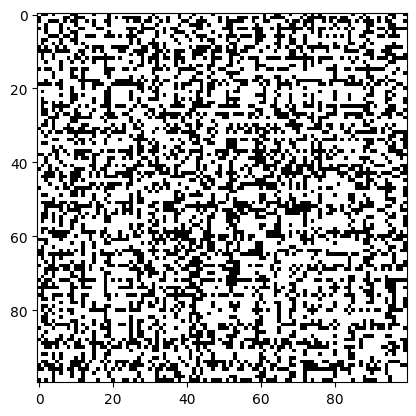

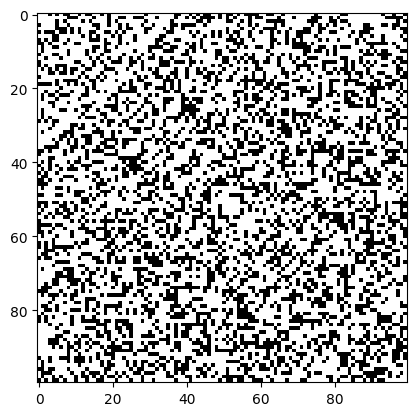

In [ ]:
# Generating 10 graphs and storing them:
graphs_for_visualization = generate_graphs(10,100,50)

# - selecting the first graph with clique among the generated ones:
graph_with_clique = [graphs_for_visualization[0][i] for i, is_clique in enumerate(graphs_for_visualization[1]) if is_clique]
image_0 = graph_with_clique[0] if graph_with_clique else None
# - selecting one graph without clique:
graph_without_clique = [graphs_for_visualization[0][i] for i, is_clique in enumerate(graphs_for_visualization[1]) if not is_clique]
image_1 = graph_without_clique[0] if graph_without_clique else None

#visualizing graphs:
# - with clique
fig, ax = plt.subplots()
ax.imshow(image_0[0], cmap=plt.get_cmap('gray'), vmin=0, vmax=1)
plt.show()
# - without clique
fig, ax = plt.subplots()
ax.imshow(image_1[0], cmap=plt.get_cmap('gray'), vmin=0, vmax=1)
plt.show()

Here we define the CNN. The meaning of each parameter is explained below. This network works only with graphs of a certain size (in this case $n=100$), a different graph needs a slightely different architecture. There is also an early stopping function, which stops if the validation error starts to increase for several steps.

The architecture is basically just a combination of convolutional al pooling layers with kernels of size 3. The optimizier is Adam and the loss is the CrossEntropy.

In [ ]:
lr_rate=0.01            # learning rate
c1=5                    # first convolution layer
c2=10                   # second convolution layer
c3=15                   # third convolution layer
c4=20                   # fourth convolution layer
l3=100                  # linear layer
d=0.2                   # dropout probability
kernel = 3              # kernel size

#function for the early stopping
def EarlyStopper(validation_loss, counter, min_validation_loss, past=3, patience=6, min_delta=0.02):
        length = validation_loss.shape[0]
        if np.mean(validation_loss[length-past:]) < min_validation_loss and length > past:
            min_validation_loss = np.mean(validation_loss[length-past:])
            counter = 0
        elif np.mean(validation_loss[length-past:]) > (min_validation_loss + min_delta) and length > past:
            counter += 1
            if counter >= patience:
                return True, min_validation_loss, counter
        return False, min_validation_loss, counter

#2d convolution with batch normalization and ReLU activation
def convbn(ci,co,ksz,s=1,pz=0):
    return nn.Sequential(
                nn.Conv2d(ci,co,ksz,stride=s,padding=pz,padding_mode = 'circular'),
                nn.ReLU(True),
                nn.BatchNorm2d(co))

#residual block
class Residual(nn.Module):
  def __init__(self, num_channels, use_1x1conv=False, strides=1):
    super().__init__()
    self.conv1 = nn.LazyConv2d(num_channels, kernel_size=3, padding=1,
    stride=strides)
    self.conv2 = nn.LazyConv2d(num_channels, kernel_size=3, padding=1)
    if use_1x1conv:
      self.conv3 = nn.LazyConv2d(num_channels, kernel_size=1,
      stride=strides)
    else:
      self.conv3 = None
      self.bn1 = nn.LazyBatchNorm2d()
      self.bn2 = nn.LazyBatchNorm2d()

  def forward(self, X):
    Y = F.relu(self.bn1(self.conv1(X)))
    Y = self.bn2(self.conv2(Y))
    if self.conv3:
      X = self.conv3(X)
    Y += X
    return F.relu(Y)

# Definition of the CNN architecture
model = nn.Sequential(
            nn.Dropout(0.2),
            convbn(1,c1,kernel,1,1),
            nn.Dropout(d),
            nn.MaxPool2d(kernel),
            Residual(c1),
            convbn(c1,c2,kernel,1,1),
            nn.Dropout(d),
            nn.MaxPool2d(kernel),
            Residual(c2),
            convbn(c2,c3,kernel,1,1),
            nn.Dropout(d),
            nn.MaxPool2d(kernel),
            #Residual(c3),
            #convbn(c3,c4,kernel,1,1),
            #nn.MaxPool2d(kernel),
            nn.Flatten(),
            nn.Linear(135, l3),
            nn.ReLU(),
            nn.Linear(l3, 2),
            nn.ReLU()
            )

optim=torch.optim.Adam(model.parameters())   # optimization with Adam
criterion = nn.CrossEntropyLoss()            # criterion = Cross Entropy
model.to(device)

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/lazy.py:180: UserWarning: Lazy modules are a new feature under heavy development so changes to the API or functionality can happen at any moment.
  warnings.warn('Lazy modules are a new feature under heavy development '


Sequential(
  (0): Dropout(p=0.2, inplace=False)
  (1): Sequential(
    (0): Conv2d(1, 5, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), padding_mode=circular)
    (1): ReLU(inplace=True)
    (2): BatchNorm2d(5, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (2): Dropout(p=0.2, inplace=False)
  (3): MaxPool2d(kernel_size=3, stride=3, padding=0, dilation=1, ceil_mode=False)
  (4): Residual(
    (conv1): LazyConv2d(0, 5, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv2): LazyConv2d(0, 5, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): LazyBatchNorm2d(0, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn2): LazyBatchNorm2d(0, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (5): Sequential(
    (0): Conv2d(5, 10, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), padding_mode=circular)
    (1): ReLU(inplace=True)
    (2): BatchNorm2d(10, eps=1e-05, momentum=0.1, affine=True, track_running_stats

The following is the traing procedure. It works in the following way: at each epoch we generate a batch of training samples. Then we train the network with this batch and check the validation error. This online generation of batches ensures a faster training.

Eventually we also plot the generalization error versus the parameter $k/n$.

If you want to run the code test with small number of epochs, small max_step or smaller samples; the code takes very long.

Training = 0.0 %


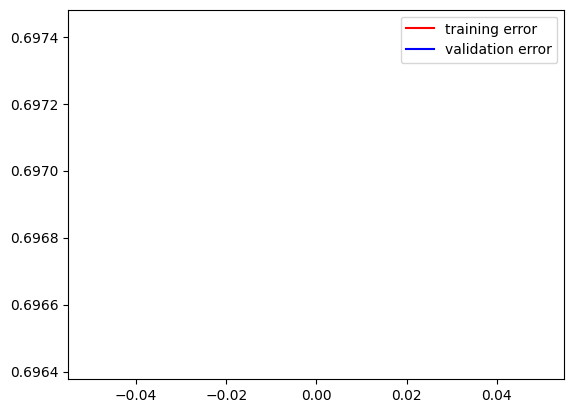

--------------------------------------------
Training = 5.0 %


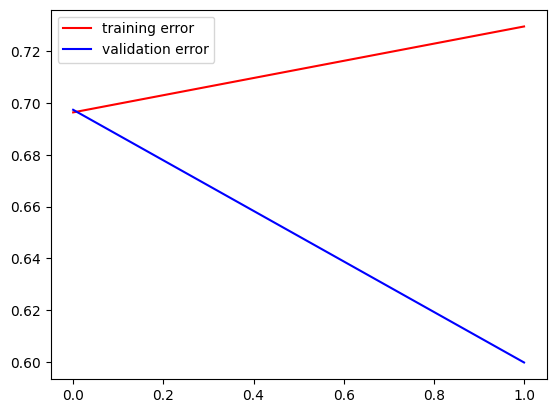

--------------------------------------------
Training = 10.0 %


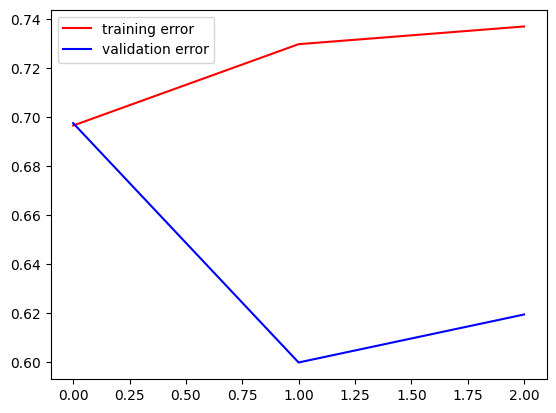

--------------------------------------------
Training = 15.0 %


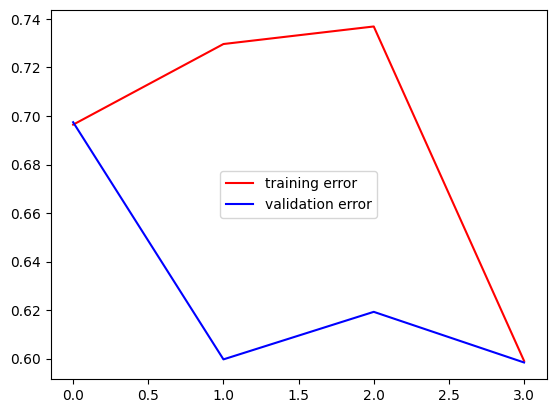

--------------------------------------------
Training = 20.0 %


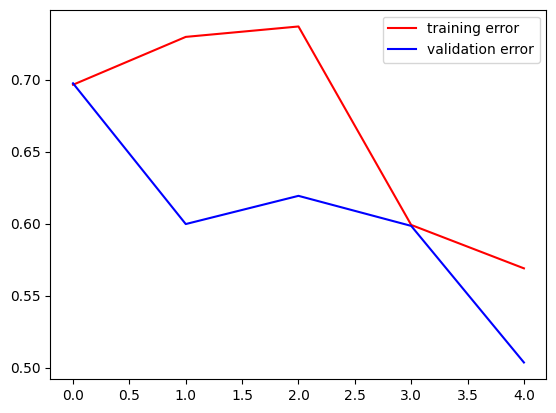

--------------------------------------------
Training = 25.0 %


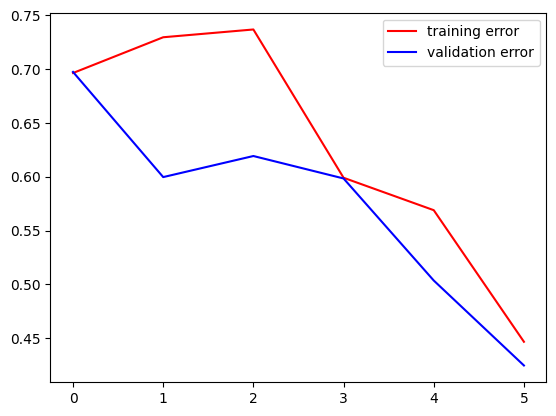

--------------------------------------------
Training = 30.0 %


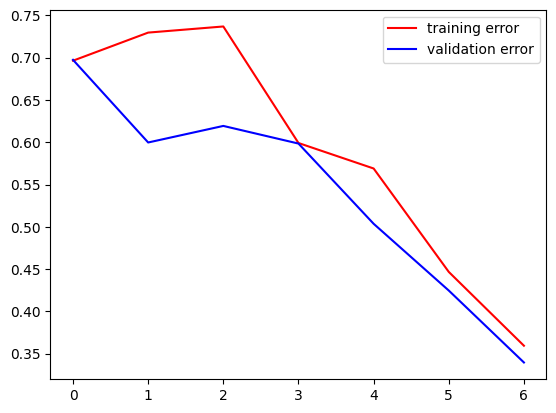

--------------------------------------------
Training = 35.0 %


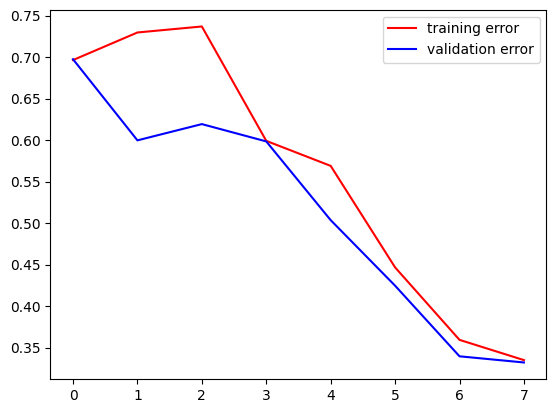

--------------------------------------------
Training = 40.0 %


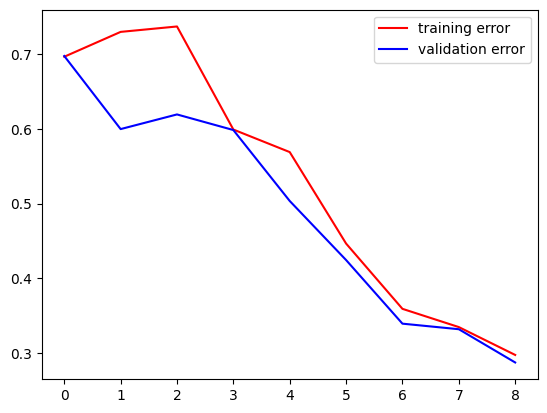

--------------------------------------------
Training = 45.0 %


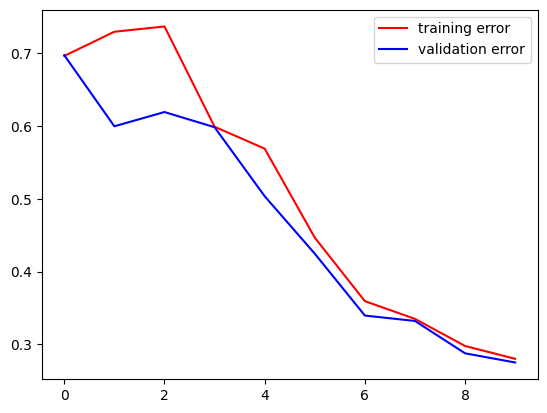

--------------------------------------------
Training = 50.0 %


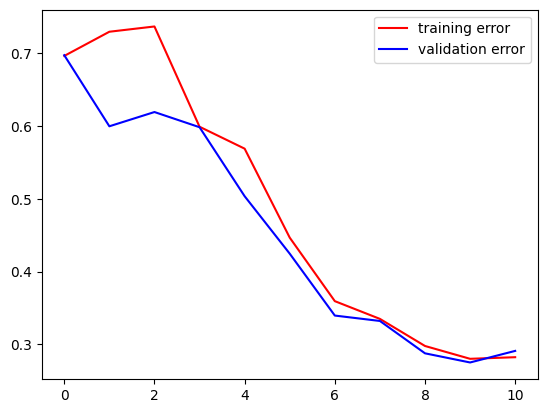

--------------------------------------------
Training = 55.0 %


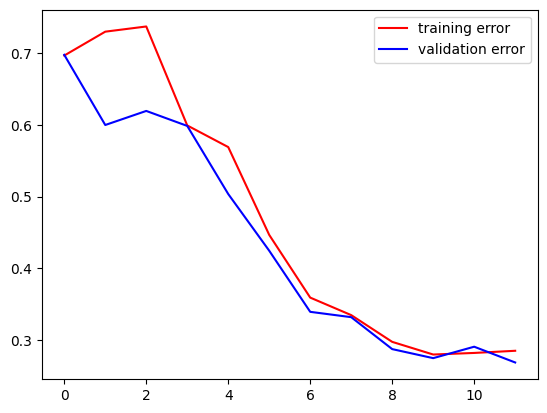

--------------------------------------------
Training = 60.0 %


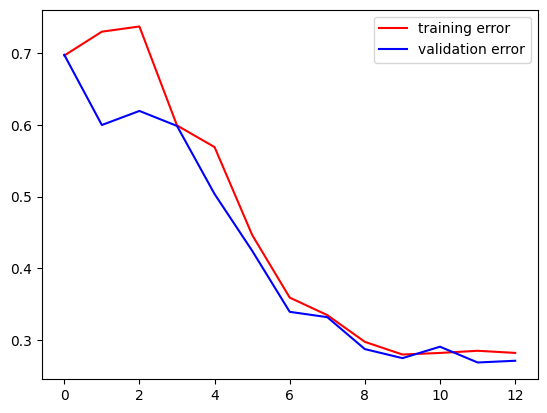

--------------------------------------------
Training = 65.0 %


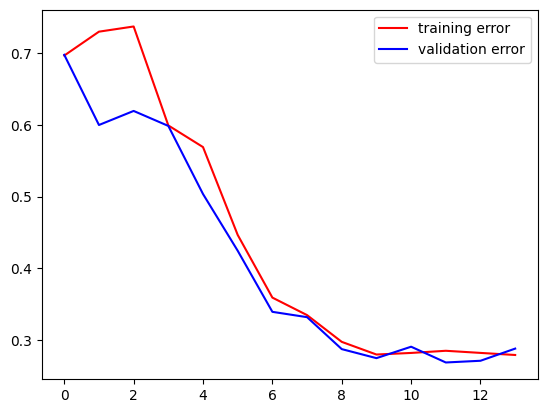

--------------------------------------------
Training = 70.0 %


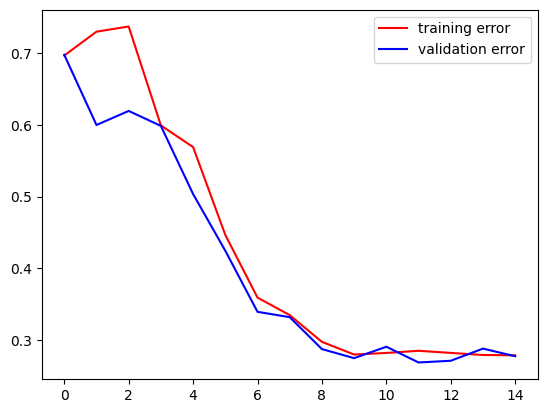

--------------------------------------------
Training = 75.0 %


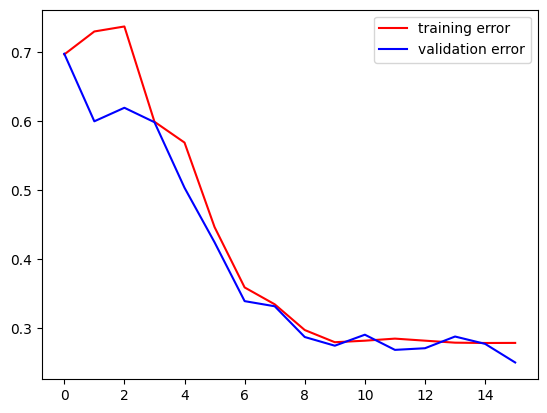

--------------------------------------------
Training = 80.0 %


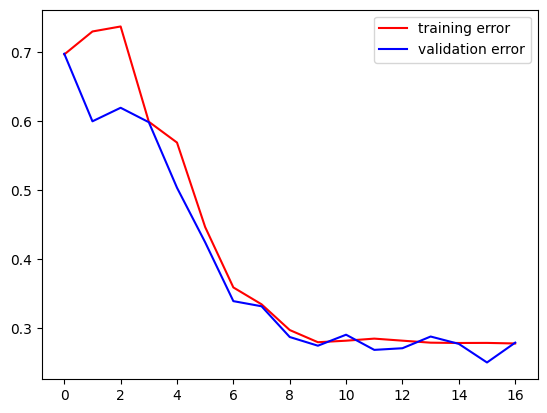

--------------------------------------------
Training = 85.0 %


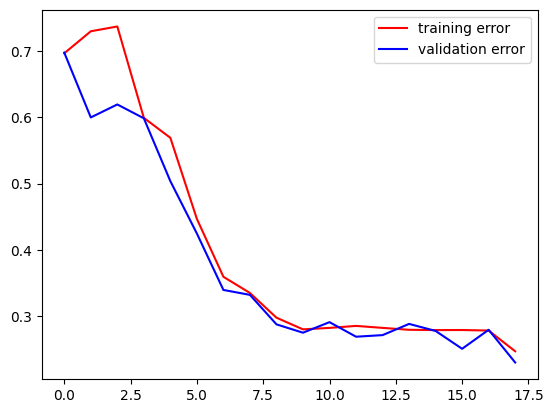

--------------------------------------------
Training = 90.0 %
epoch = 0
dim_clique = 50
training error = 0.04082709550857544
validation error = 0.06358062475919724
test error = 0.05526072531938553
--------------------------------------------
Early stop
--------------------------------------------


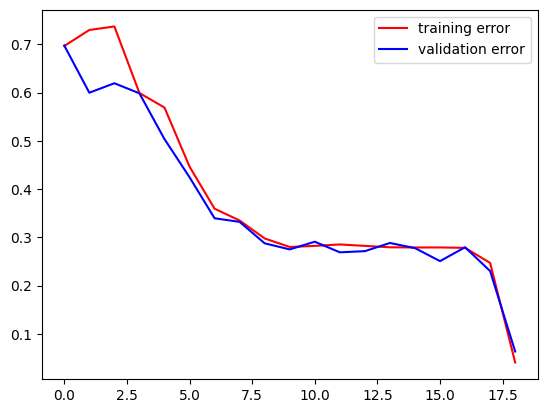

k/n = [5.0] % = [100.0]
Training = 0.0 %
epoch = 0
dim_clique = 48
training error = 0.13917678594589233
validation error = 0.062353719025850296
test error = 0.07658801972866058
--------------------------------------------
Early stop
--------------------------------------------


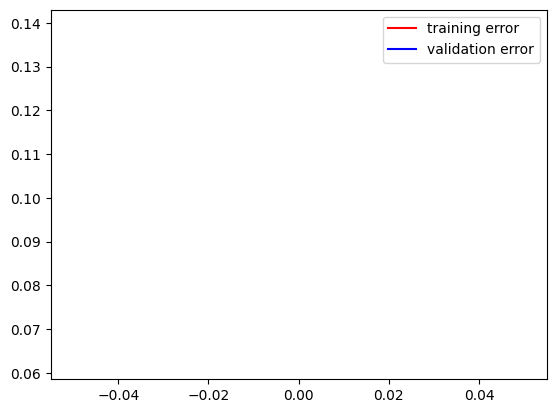

k/n = [5.0, 4.8] % = [100.0, 100.0]
Training = 0.0 %
epoch = 0
dim_clique = 46
training error = 0.10106194019317627
validation error = 0.07713551819324493
test error = 0.06837926805019379
--------------------------------------------
Early stop
--------------------------------------------


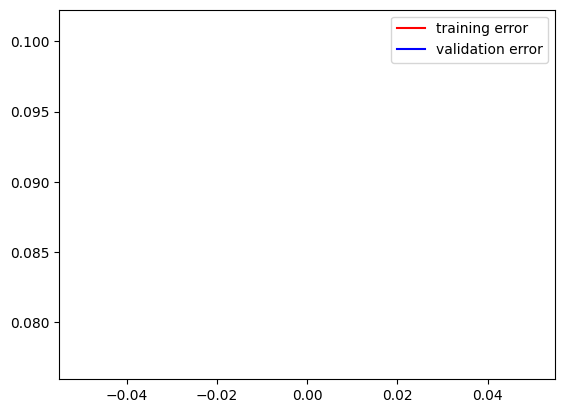

k/n = [5.0, 4.8, 4.6] % = [100.0, 100.0, 100.0]
Training = 0.0 %


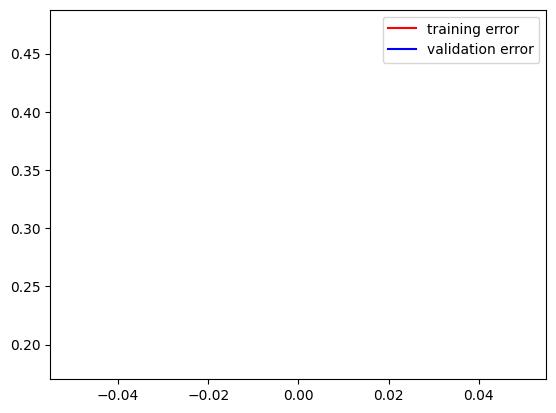

--------------------------------------------
Training = 5.0 %


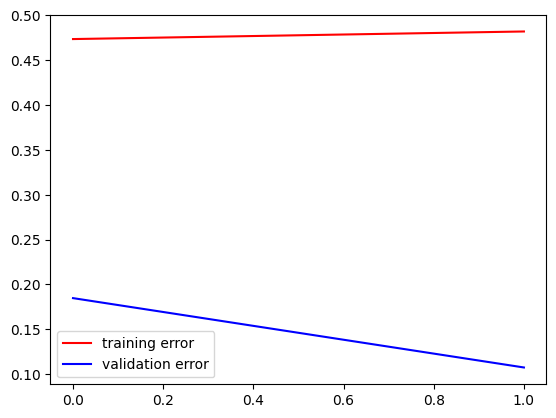

--------------------------------------------
Training = 10.0 %


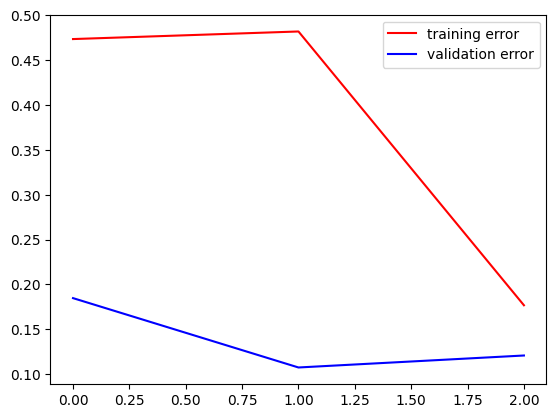

--------------------------------------------
Training = 15.0 %


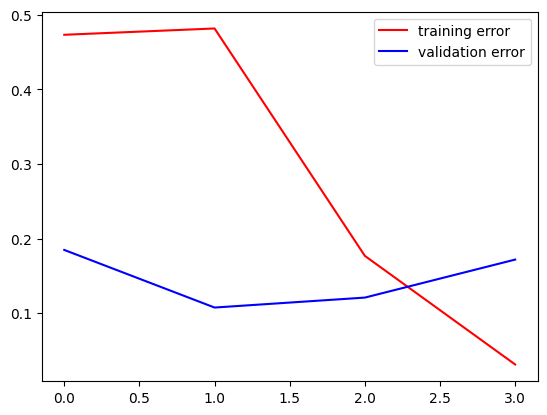

--------------------------------------------
Training = 20.0 %
epoch = 0
dim_clique = 44
training error = 0.02694793976843357
validation error = 0.09714914113283157
test error = 0.041865818202495575
--------------------------------------------
Early stop
--------------------------------------------


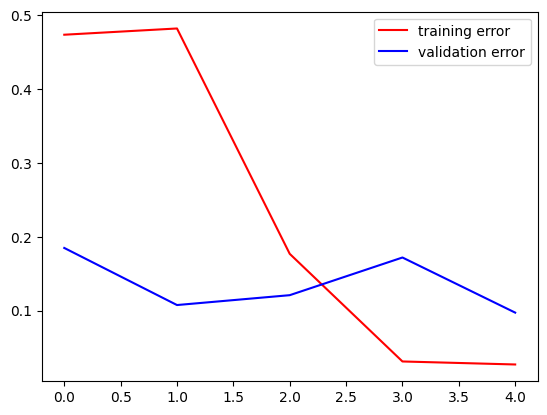

k/n = [5.0, 4.8, 4.6, 4.4] % = [100.0, 100.0, 100.0, 100.0]
Training = 0.0 %


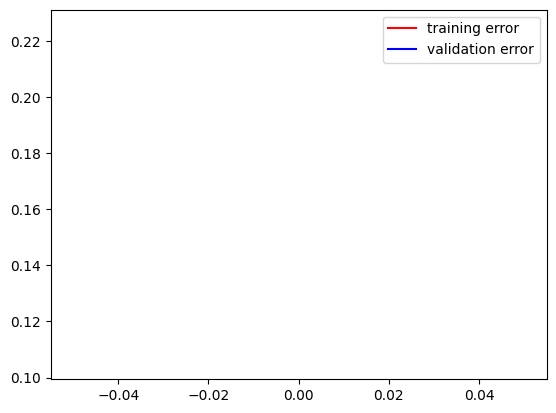

--------------------------------------------
Training = 5.0 %


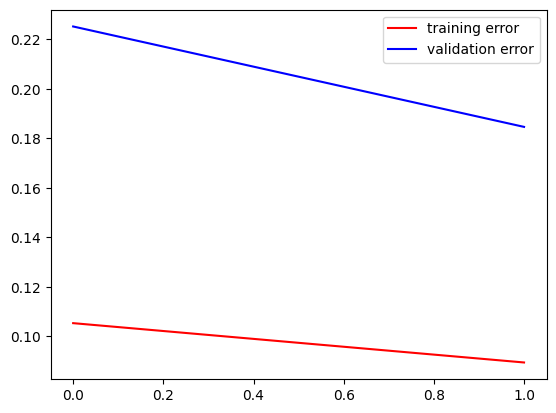

--------------------------------------------
Training = 10.0 %


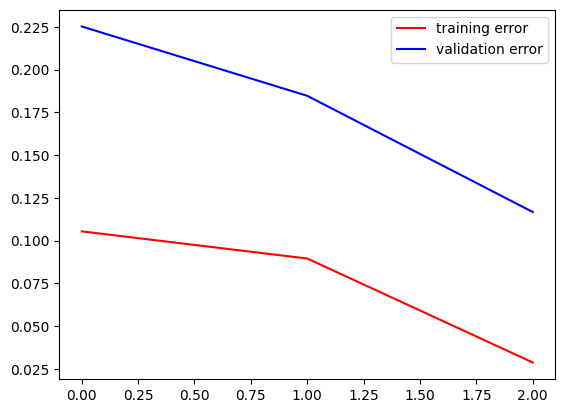

--------------------------------------------
Training = 15.0 %
epoch = 0
dim_clique = 42
training error = 0.09407337754964828
validation error = 0.026119977235794067
test error = 0.7212567329406738
--------------------------------------------
Early stop
--------------------------------------------


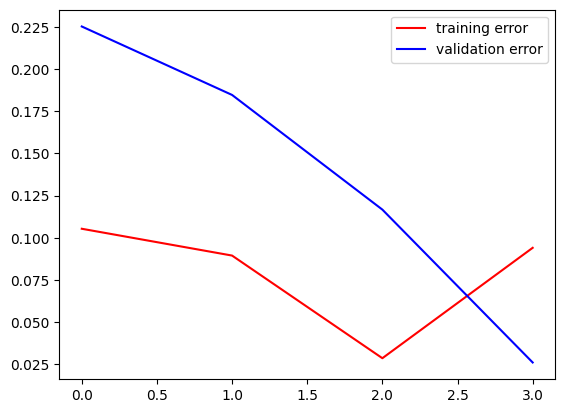

k/n = [5.0, 4.8, 4.6, 4.4, 4.2] % = [100.0, 100.0, 100.0, 100.0, 65.0]
Training = 0.0 %
epoch = 0
dim_clique = 40
training error = 0.5620248317718506
validation error = 0.059691764414310455
test error = 0.061721909791231155
--------------------------------------------
Early stop
--------------------------------------------


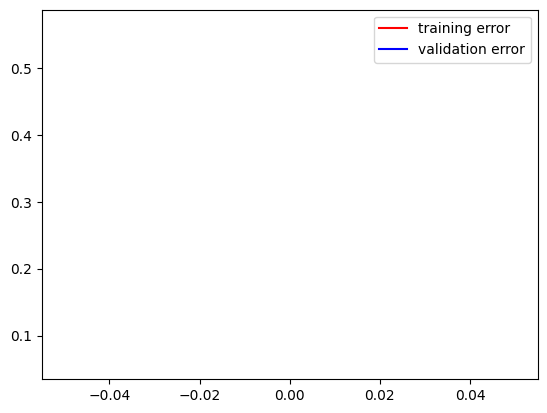

k/n = [5.0, 4.8, 4.6, 4.4, 4.2, 4.0] % = [100.0, 100.0, 100.0, 100.0, 65.0, 90.0]
Training = 0.0 %


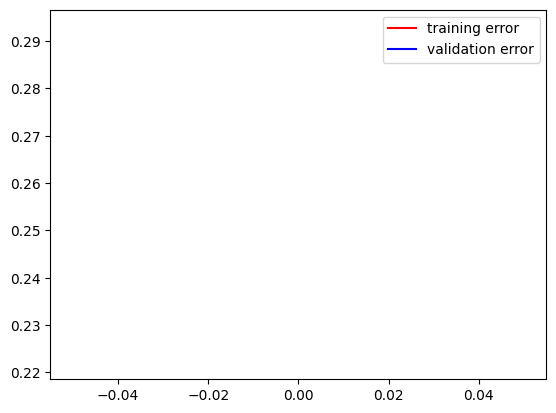

--------------------------------------------
Training = 5.0 %


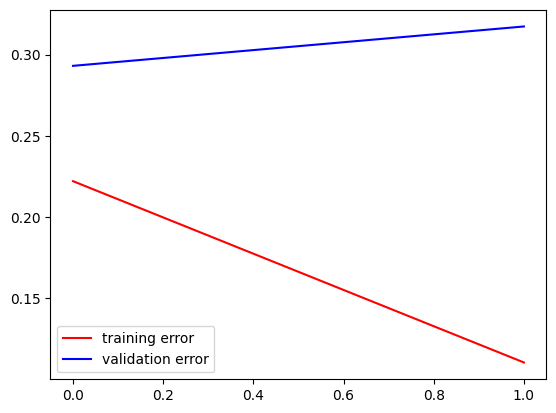

--------------------------------------------
Training = 10.0 %


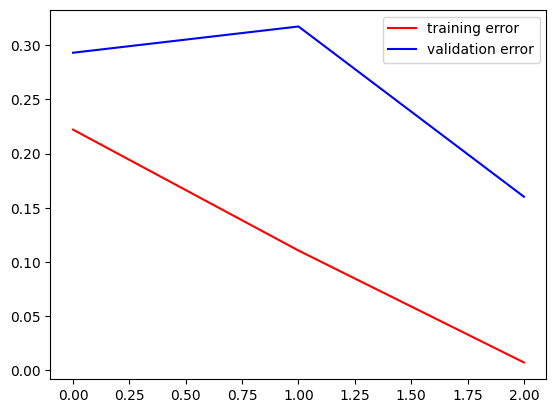

--------------------------------------------
Training = 15.0 %
epoch = 0
dim_clique = 38
training error = 0.01614605449140072
validation error = 0.08234761655330658
test error = 0.1360597312450409
--------------------------------------------
Early stop
--------------------------------------------


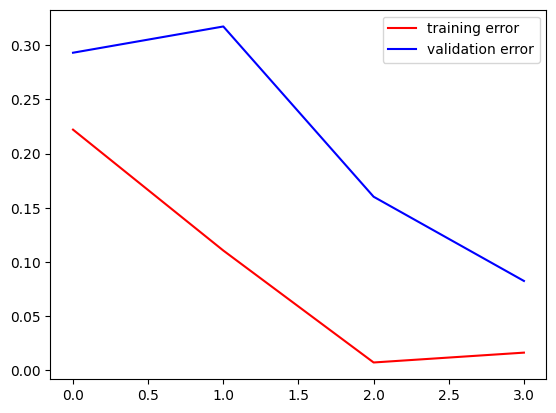

k/n = [5.0, 4.8, 4.6, 4.4, 4.2, 4.0, 3.8] % = [100.0, 100.0, 100.0, 100.0, 65.0, 90.0, 90.0]
Training = 0.0 %


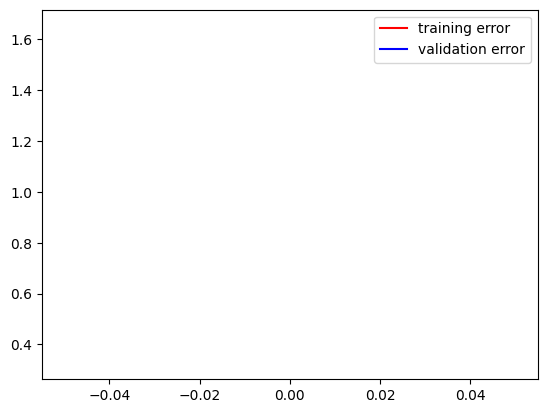

--------------------------------------------
Training = 5.0 %


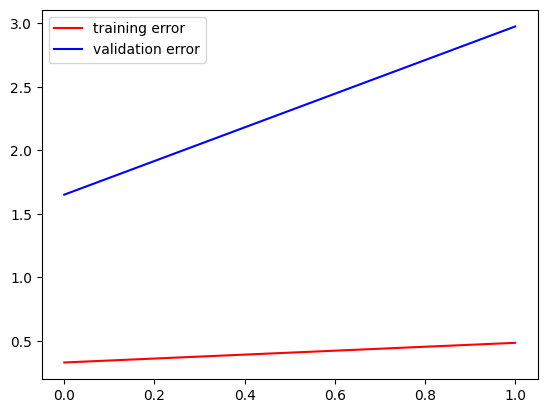

--------------------------------------------
Training = 10.0 %


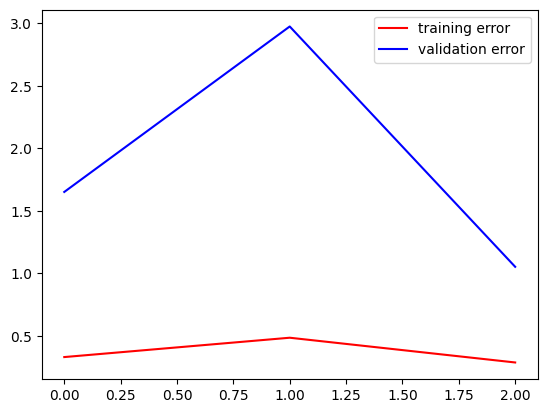

--------------------------------------------
Training = 15.0 %


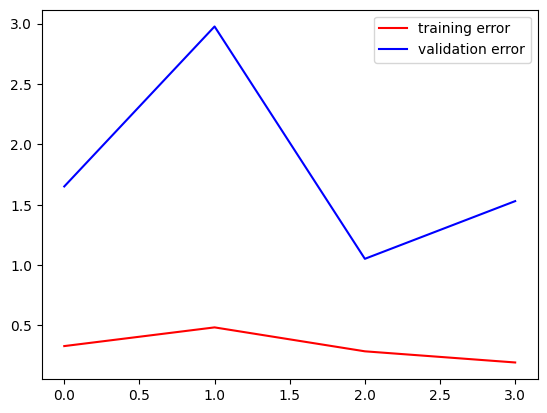

--------------------------------------------
Training = 20.0 %


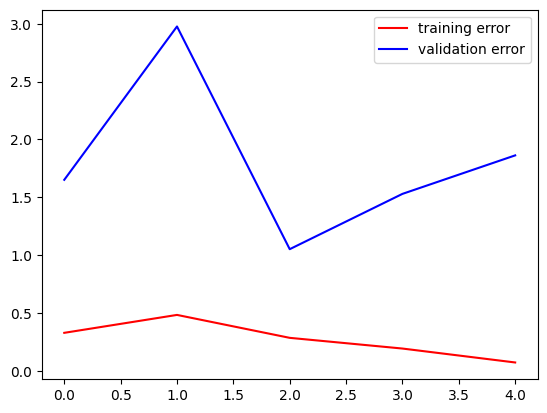

--------------------------------------------
Training = 25.0 %


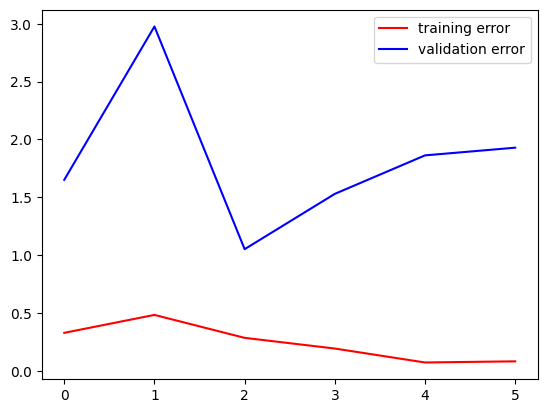

--------------------------------------------
Training = 30.0 %


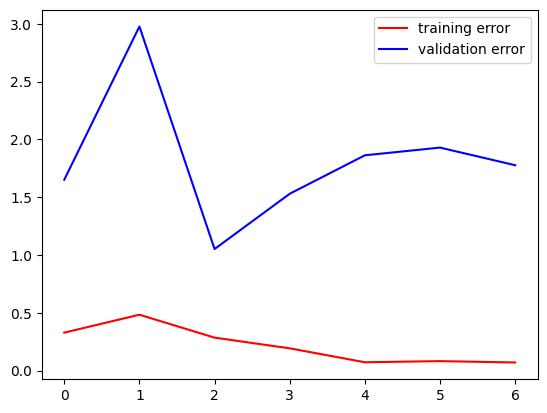

--------------------------------------------
Training = 35.0 %


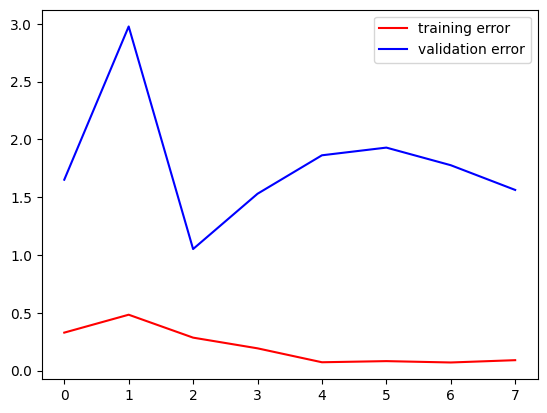

--------------------------------------------
Training = 40.0 %


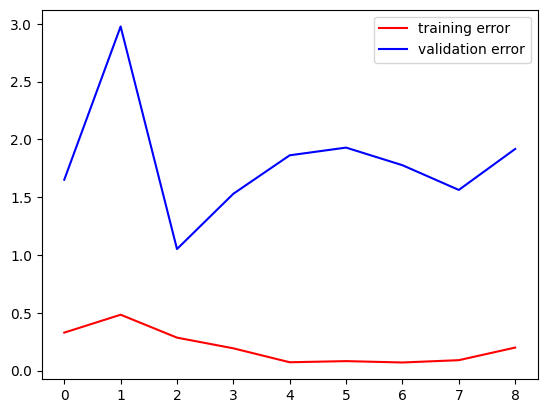

--------------------------------------------
Training = 45.0 %


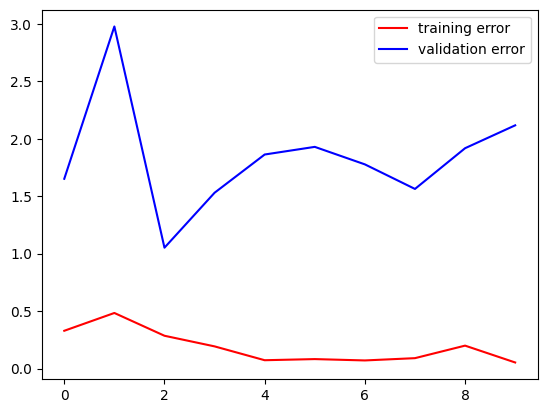

--------------------------------------------
Training = 50.0 %
epoch = 0
dim_clique = 36
training error = 0.15934361517429352
validation error = 1.6623680591583252
test error = 0.20275700092315674
--------------------------------------------
Training = 0.0 %


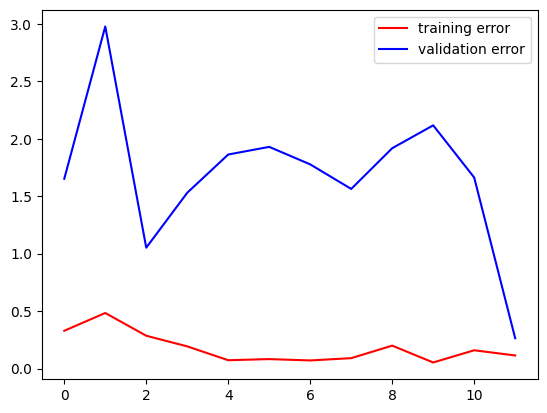

--------------------------------------------
Training = 5.0 %


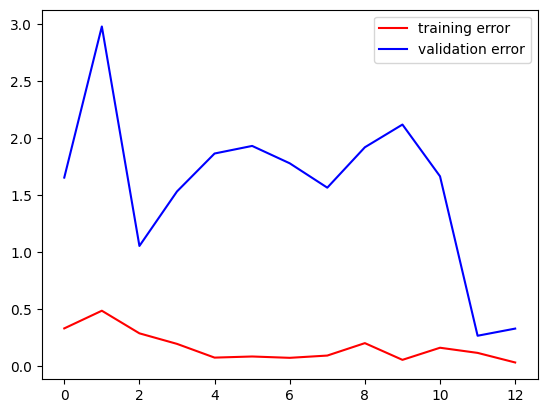

--------------------------------------------
Training = 10.0 %


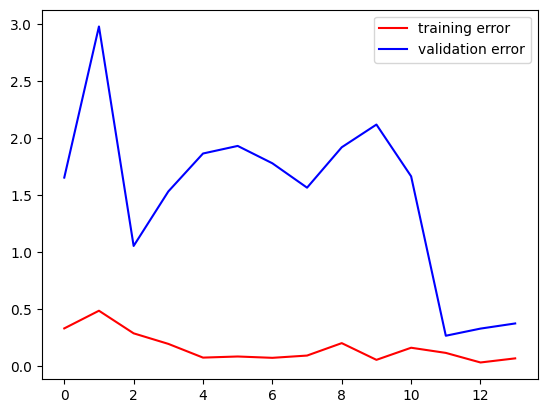

--------------------------------------------
Training = 15.0 %


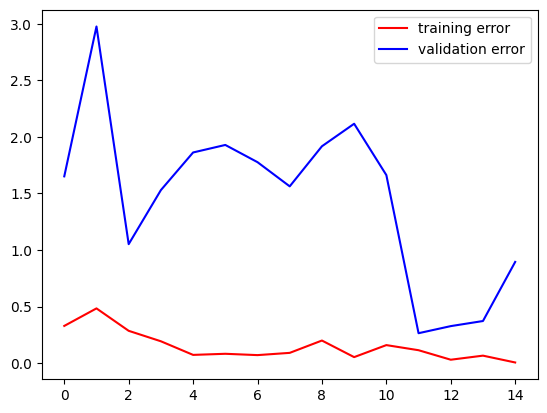

--------------------------------------------
Training = 20.0 %


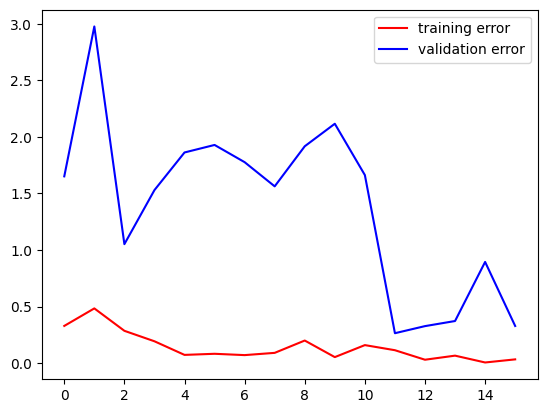

--------------------------------------------
Training = 25.0 %
epoch = 1
dim_clique = 36
training error = 0.010773077607154846
validation error = 0.05988454073667526
test error = 0.09617073088884354
--------------------------------------------
Early stop
--------------------------------------------


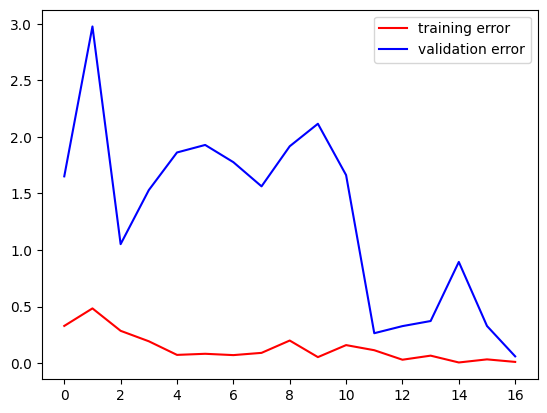

k/n = [5.0, 4.8, 4.6, 4.4, 4.2, 4.0, 3.8, 3.6] % = [100.0, 100.0, 100.0, 100.0, 65.0, 90.0, 90.0, 95.0]
Training = 0.0 %


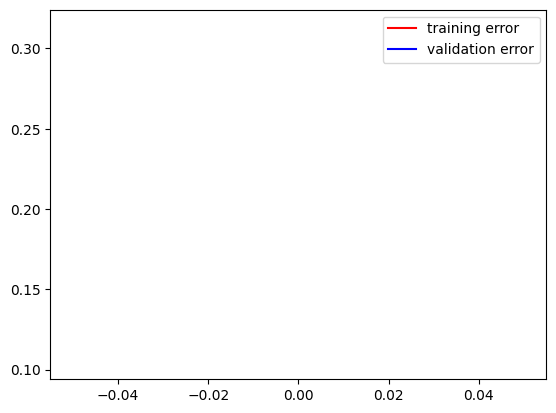

--------------------------------------------
Training = 5.0 %


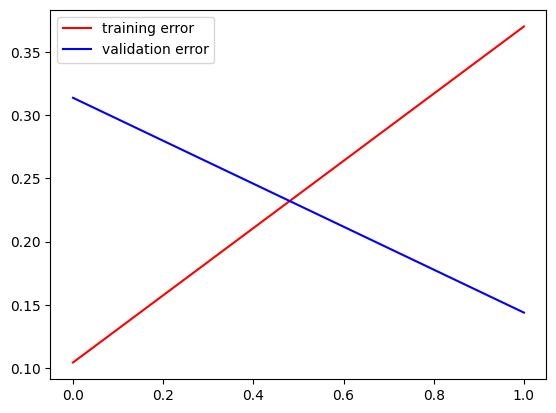

--------------------------------------------
Training = 10.0 %
epoch = 0
dim_clique = 34
training error = 0.16236110031604767
validation error = 0.09587958455085754
test error = 0.364413321018219
--------------------------------------------
Early stop
--------------------------------------------


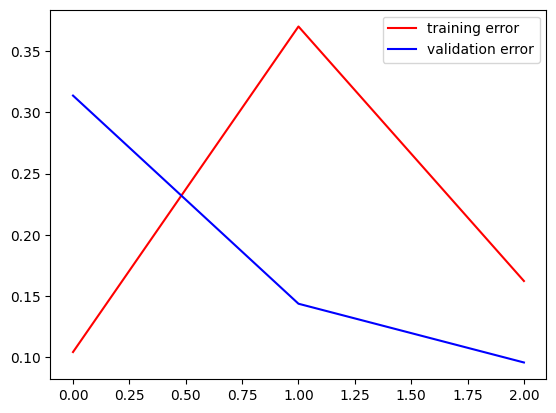

k/n = [5.0, 4.8, 4.6, 4.4, 4.2, 4.0, 3.8, 3.6, 3.4] % = [100.0, 100.0, 100.0, 100.0, 65.0, 90.0, 90.0, 95.0, 90.0]
Training = 0.0 %


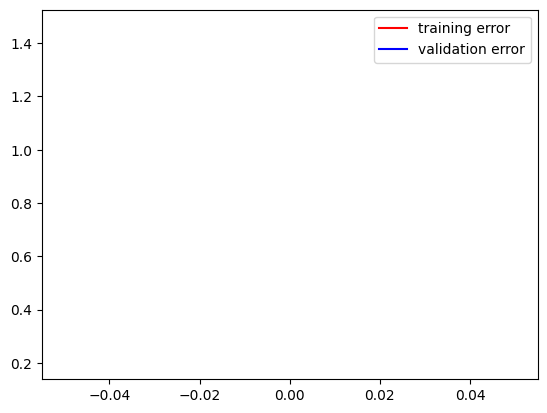

--------------------------------------------
Training = 5.0 %


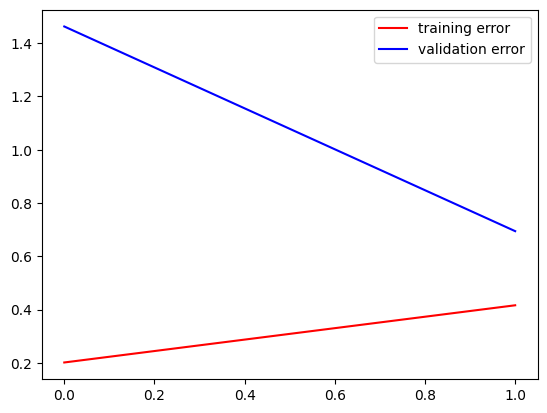

--------------------------------------------
Training = 10.0 %


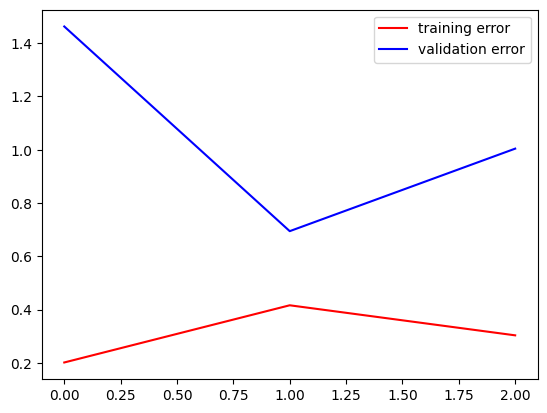

--------------------------------------------
Training = 15.0 %


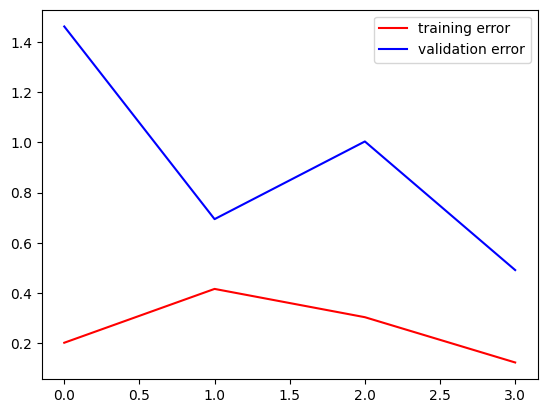

--------------------------------------------
Training = 20.0 %


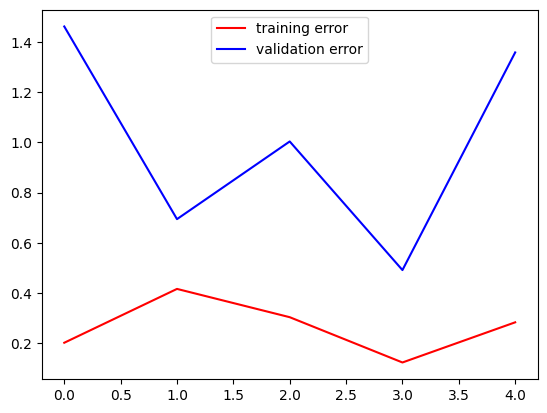

--------------------------------------------
Training = 25.0 %


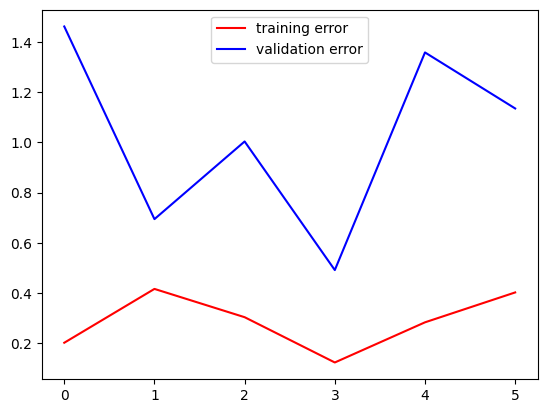

--------------------------------------------
Training = 30.0 %


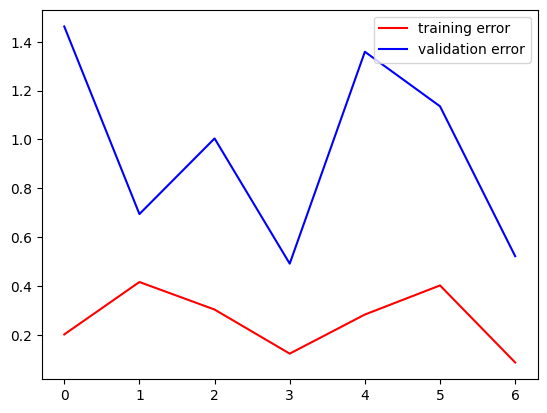

--------------------------------------------
Training = 35.0 %


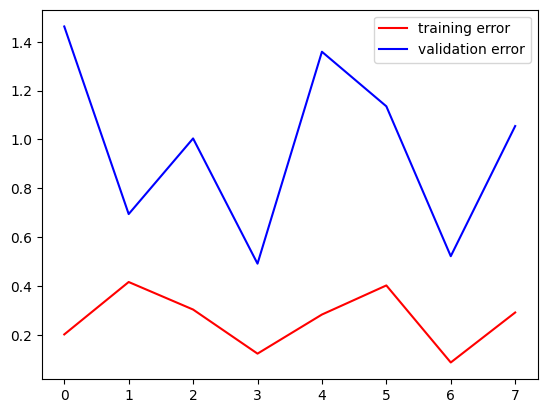

--------------------------------------------
Training = 40.0 %


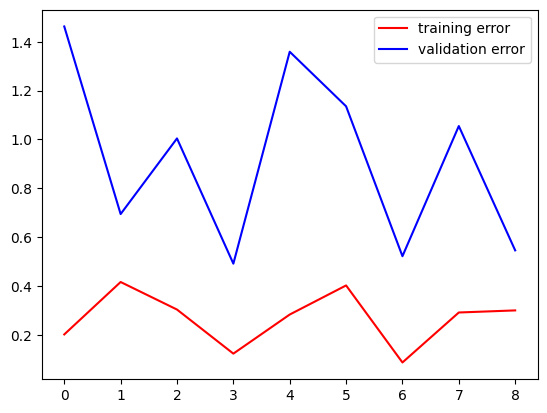

--------------------------------------------
Training = 45.0 %


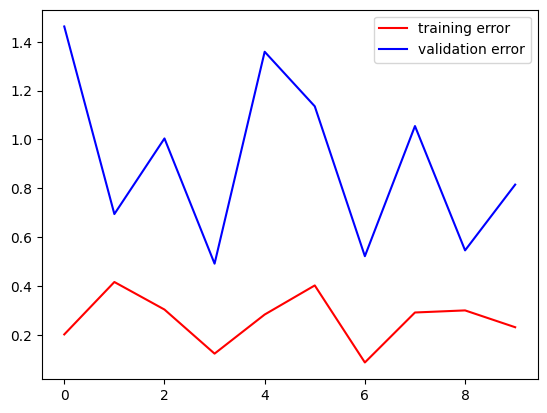

--------------------------------------------
Training = 50.0 %


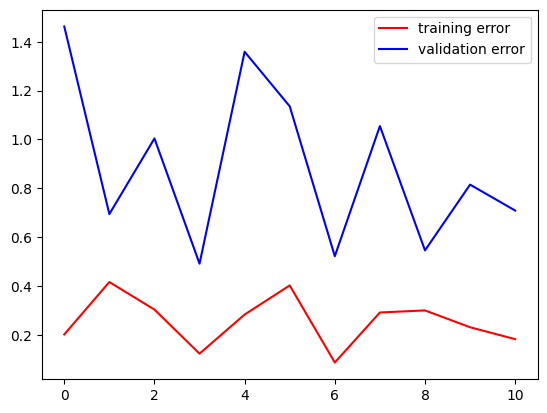

--------------------------------------------
Training = 55.0 %


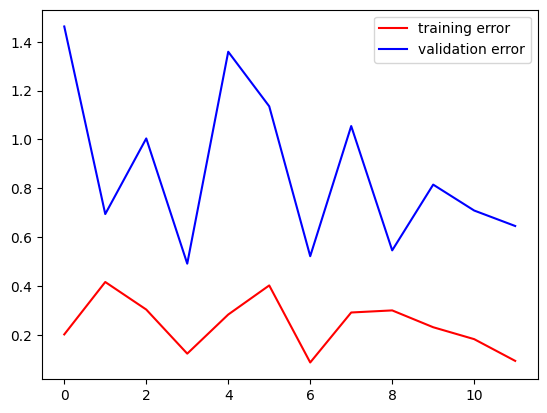

--------------------------------------------
Training = 60.0 %


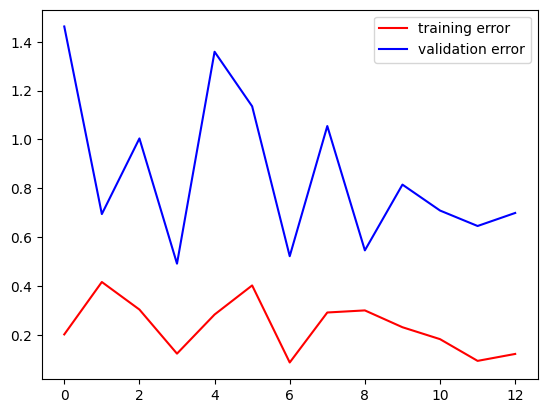

--------------------------------------------
Training = 65.0 %


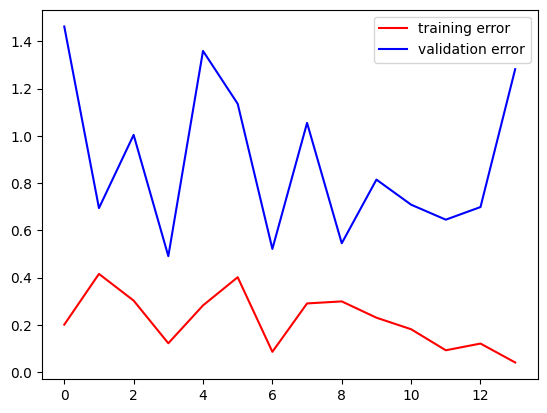

--------------------------------------------
Training = 70.0 %


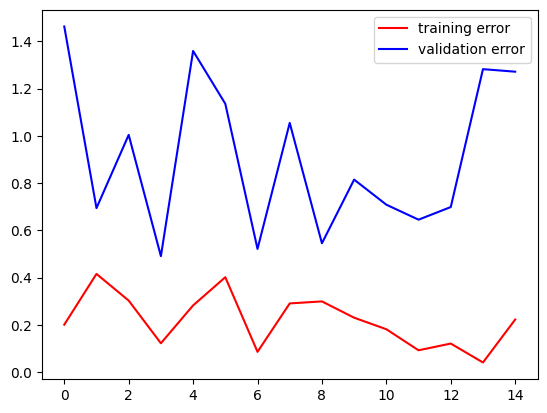

--------------------------------------------
Training = 75.0 %


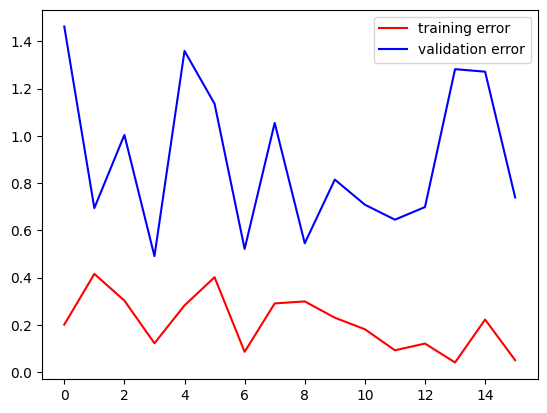

--------------------------------------------
Training = 80.0 %


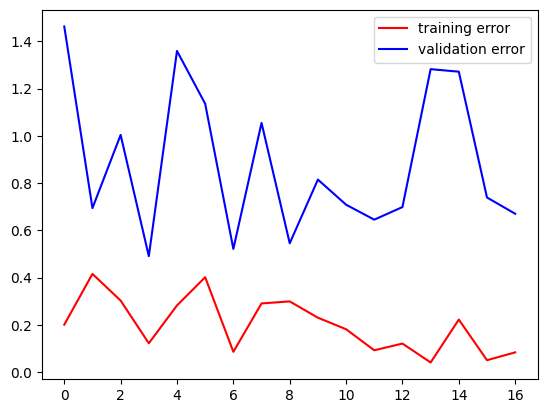

--------------------------------------------
Training = 85.0 %


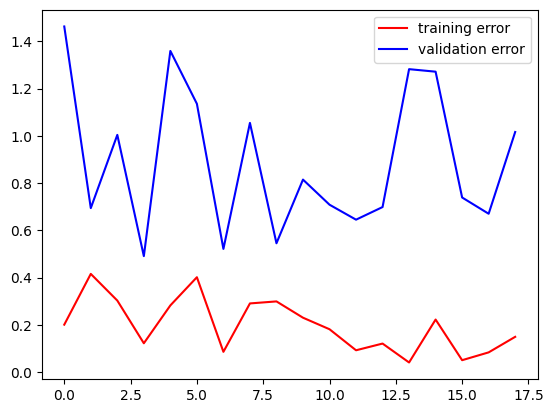

--------------------------------------------
Training = 90.0 %
epoch = 0
dim_clique = 32
training error = 0.044188328087329865
validation error = 1.2257717847824097
test error = 0.3286413252353668
--------------------------------------------
Training = 0.0 %


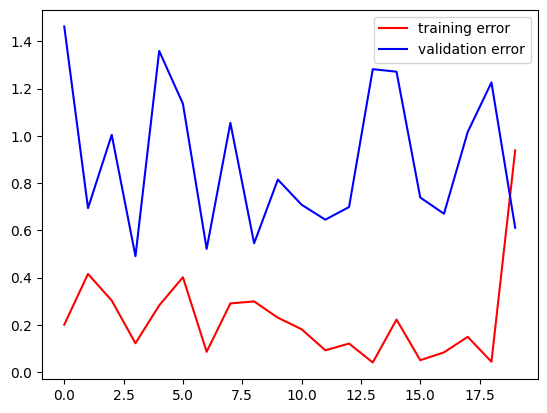

--------------------------------------------
Training = 5.0 %


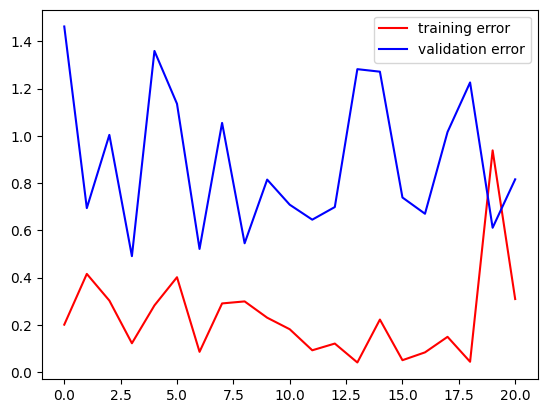

--------------------------------------------
Training = 10.0 %


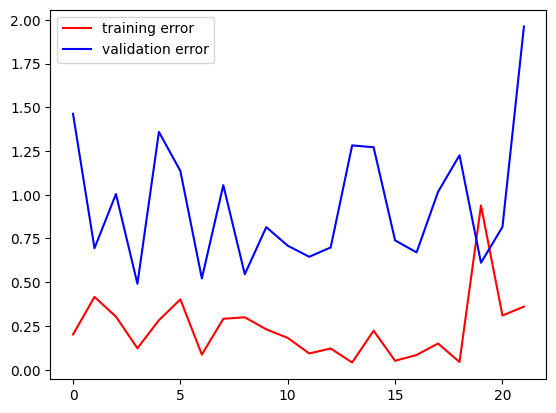

--------------------------------------------
Training = 15.0 %


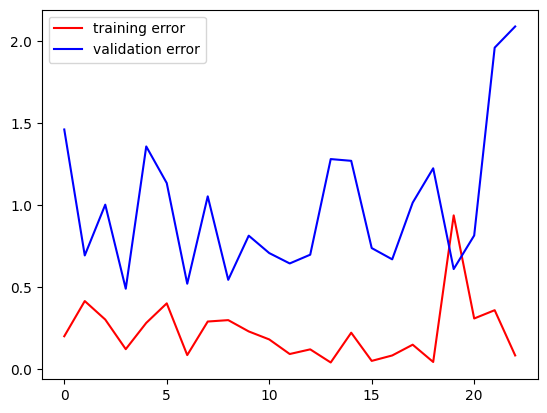

--------------------------------------------
Training = 20.0 %


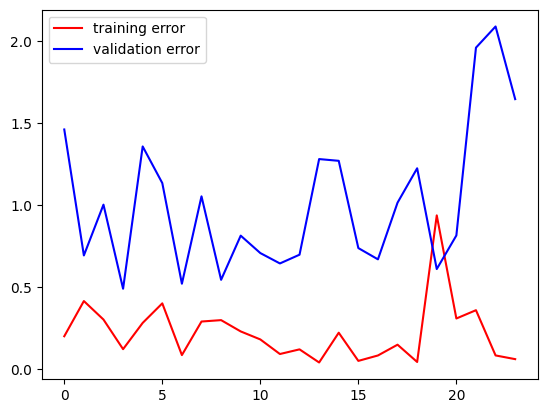

--------------------------------------------
Training = 25.0 %


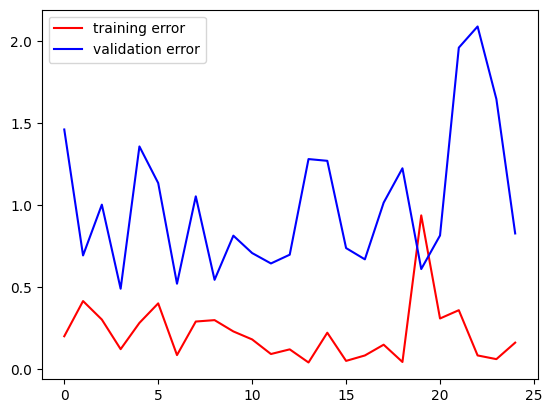

--------------------------------------------
Training = 30.0 %


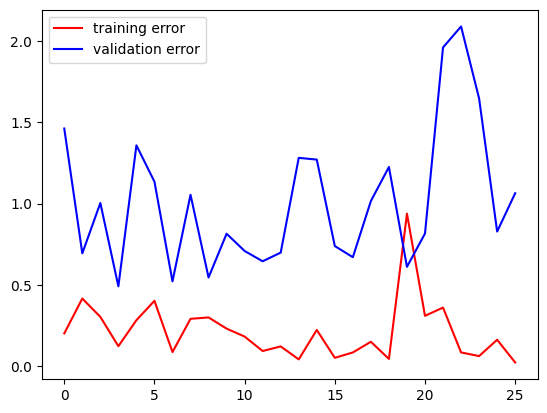

--------------------------------------------
Training = 35.0 %


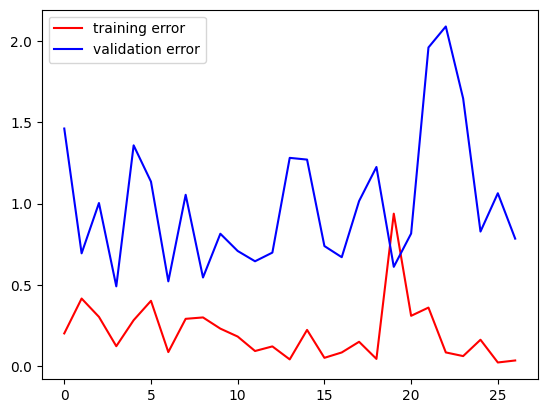

--------------------------------------------
Training = 40.0 %


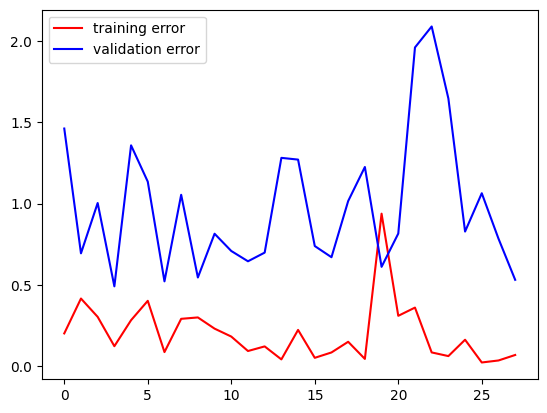

--------------------------------------------
Training = 45.0 %


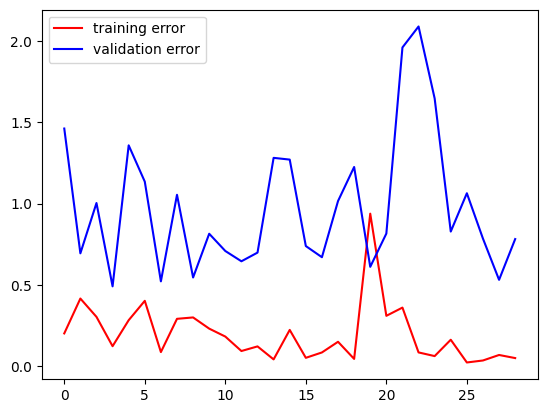

--------------------------------------------
Training = 50.0 %


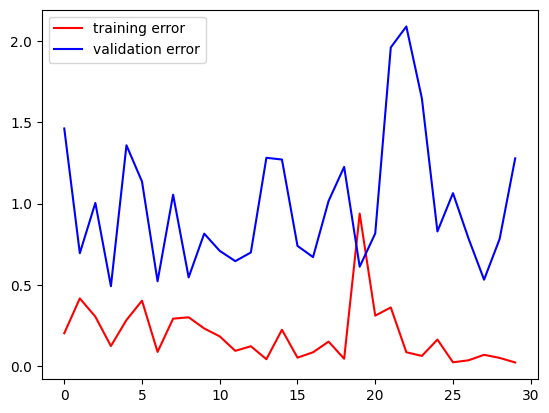

--------------------------------------------
Training = 55.0 %


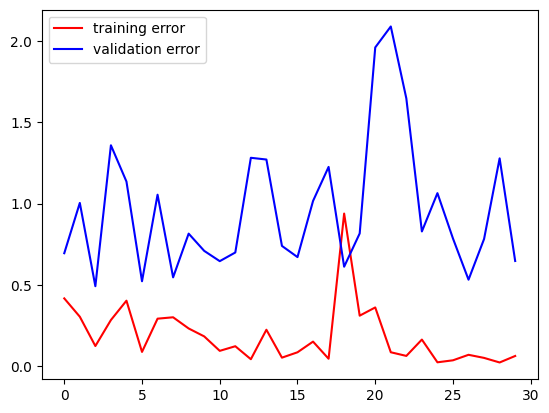

--------------------------------------------
Training = 60.0 %


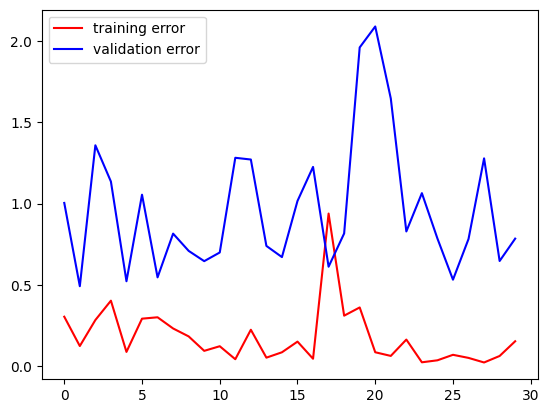

--------------------------------------------
Training = 65.0 %


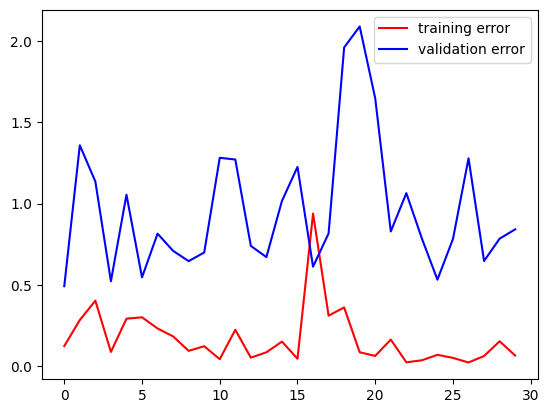

--------------------------------------------
Training = 70.0 %


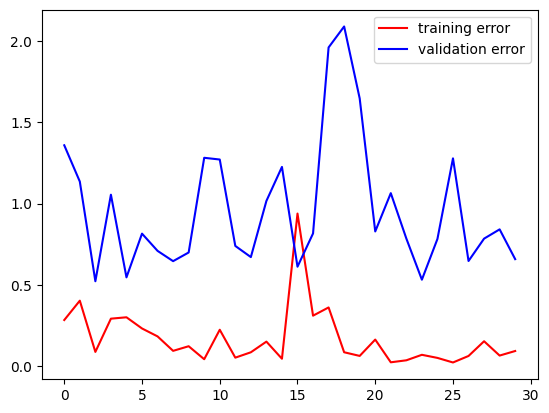

--------------------------------------------
Training = 75.0 %


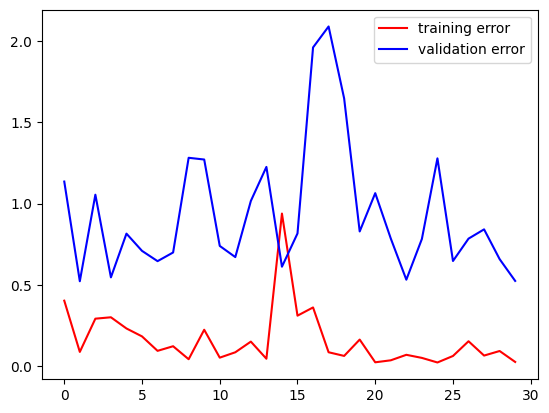

--------------------------------------------
Training = 80.0 %


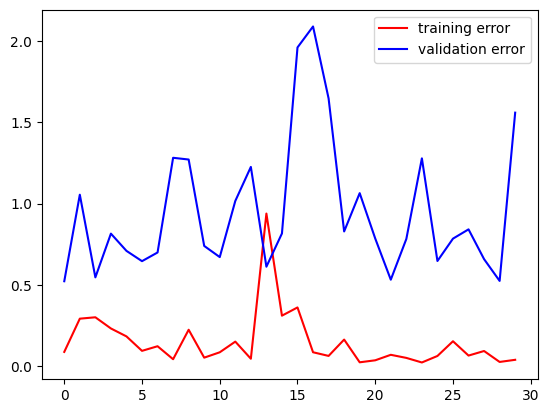

--------------------------------------------
Training = 85.0 %


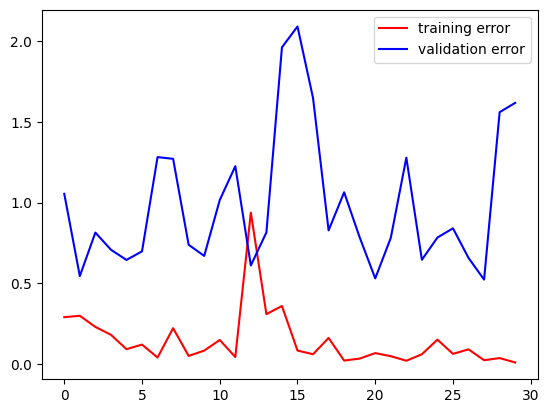

--------------------------------------------
Training = 90.0 %


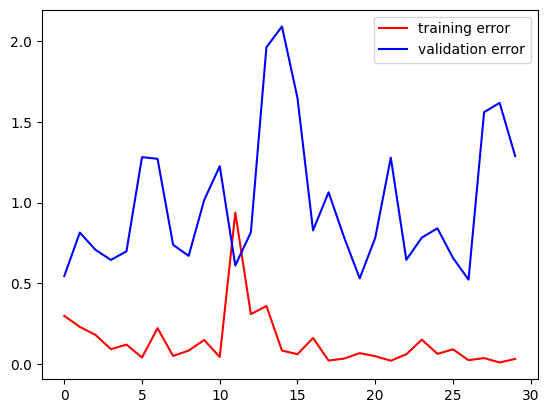

--------------------------------------------
Training = 95.0 %


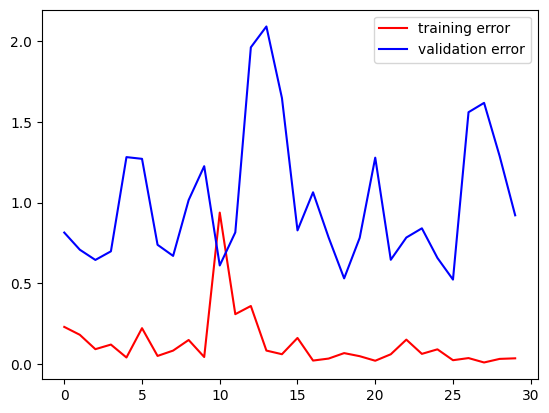

--------------------------------------------
epoch = 1
dim_clique = 32
training error = 0.036116745322942734
validation error = 0.9216486811637878
test error = 0.08517488837242126
--------------------------------------------
Training = 0.0 %


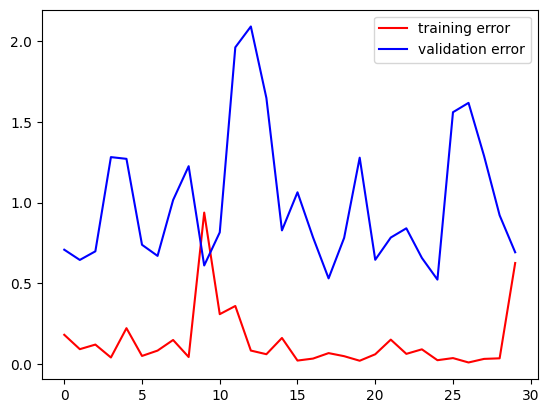

--------------------------------------------
Training = 5.0 %


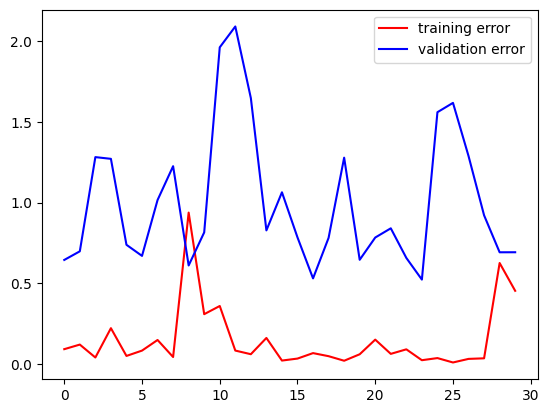

--------------------------------------------
Training = 10.0 %


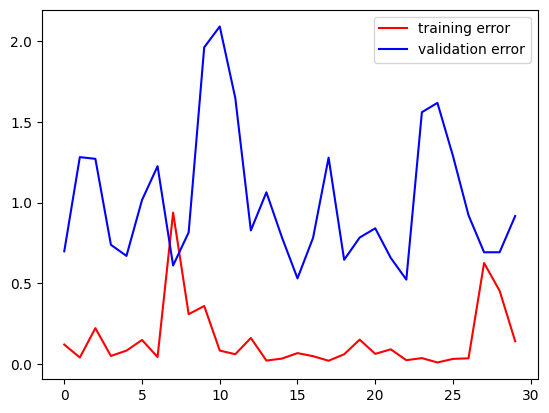

--------------------------------------------
Training = 15.0 %


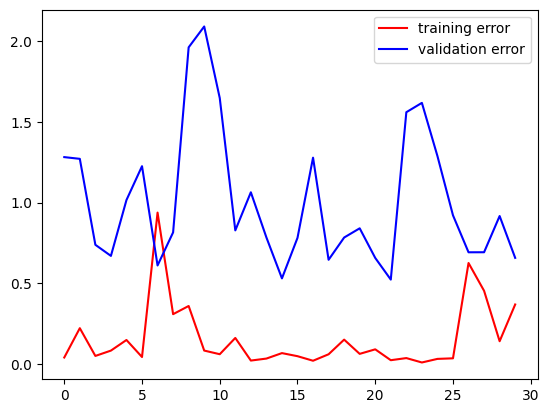

--------------------------------------------
Training = 20.0 %


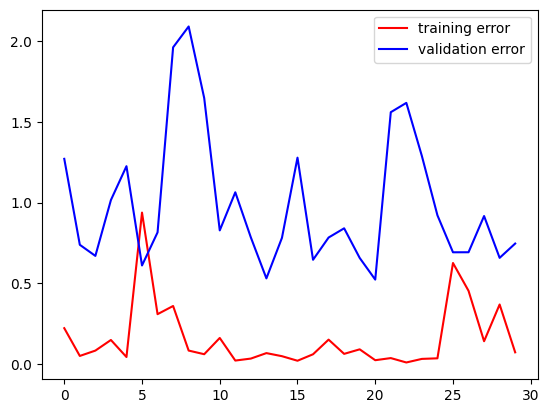

--------------------------------------------
Training = 25.0 %


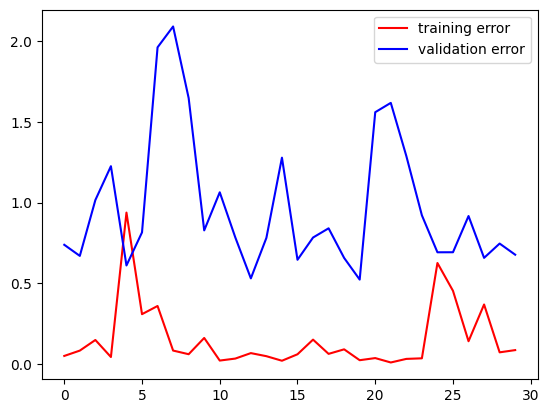

--------------------------------------------
Training = 30.0 %


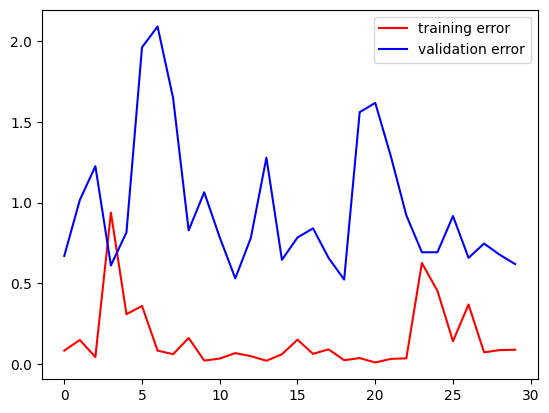

--------------------------------------------
Training = 35.0 %


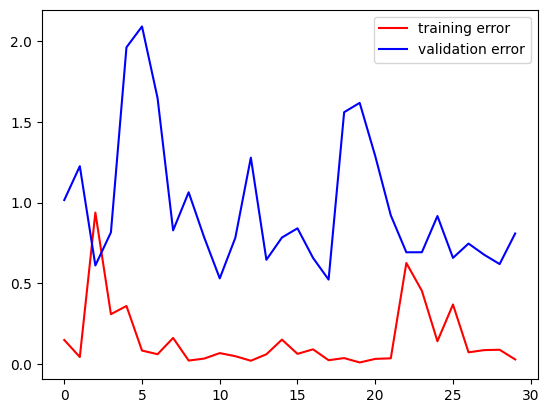

--------------------------------------------
Training = 40.0 %


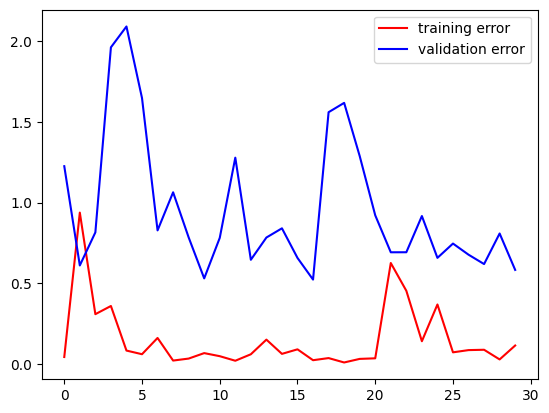

--------------------------------------------
Training = 45.0 %


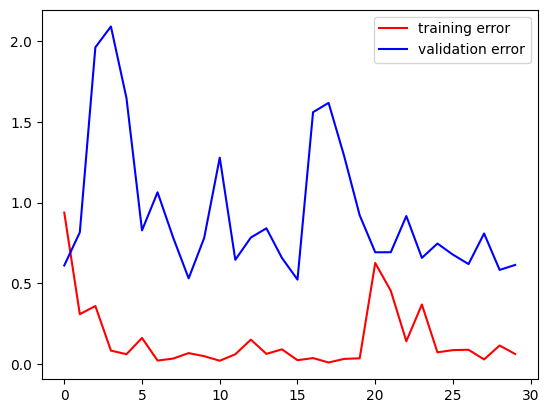

--------------------------------------------
Training = 50.0 %


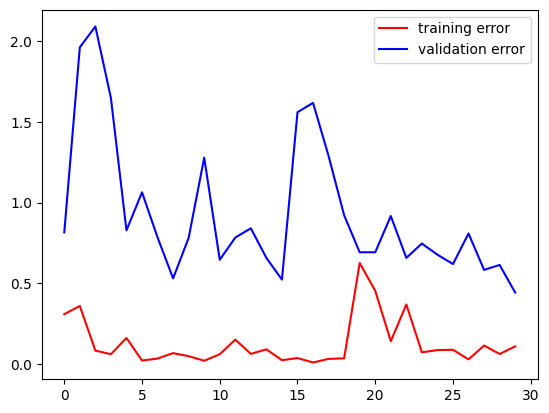

--------------------------------------------
Training = 55.0 %


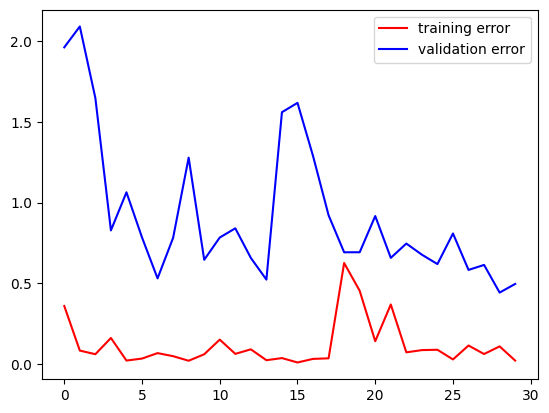

--------------------------------------------
Training = 60.0 %
epoch = 2
dim_clique = 32
training error = 0.15938881039619446
validation error = 0.08402632921934128
test error = 0.2455388605594635
--------------------------------------------
Early stop
--------------------------------------------


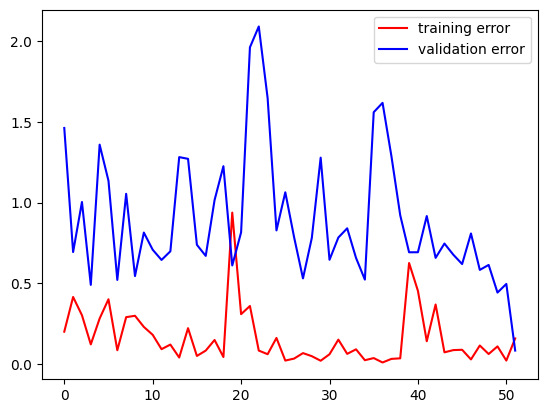

k/n = [5.0, 4.8, 4.6, 4.4, 4.2, 4.0, 3.8, 3.6, 3.4, 3.2] % = [100.0, 100.0, 100.0, 100.0, 65.0, 90.0, 90.0, 95.0, 90.0, 90.0]
Training = 0.0 %


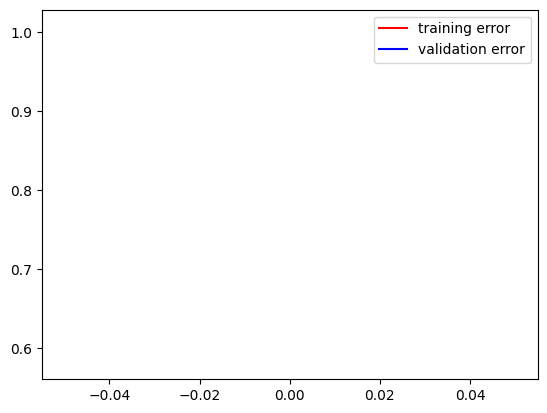

--------------------------------------------
Training = 5.0 %


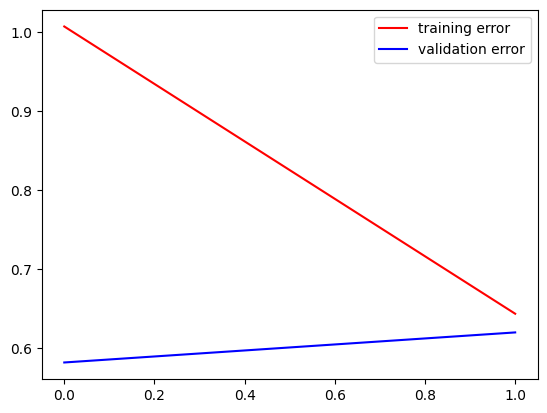

--------------------------------------------
Training = 10.0 %


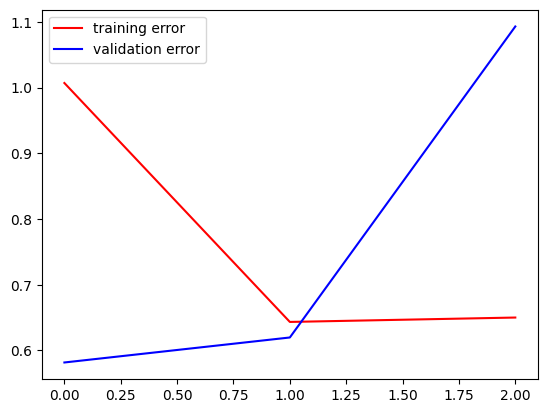

--------------------------------------------
Training = 15.0 %


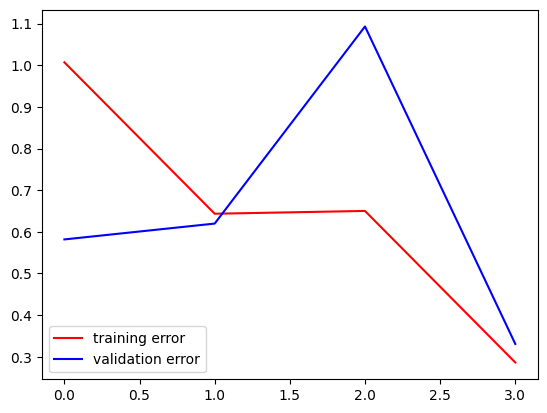

--------------------------------------------
Training = 20.0 %


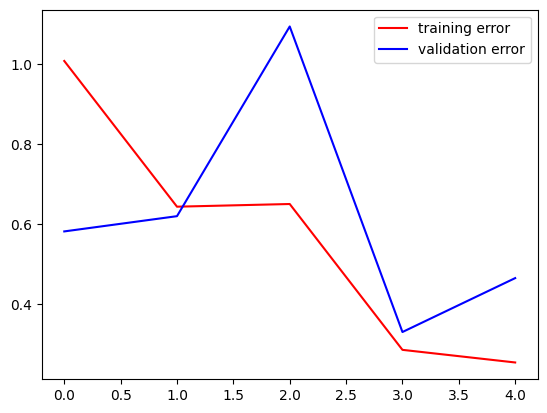

--------------------------------------------
Training = 25.0 %


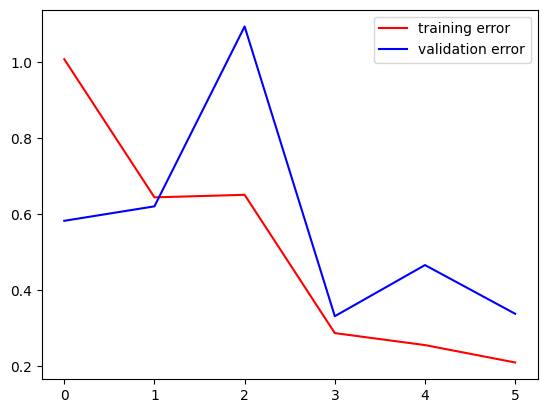

--------------------------------------------
Training = 30.0 %


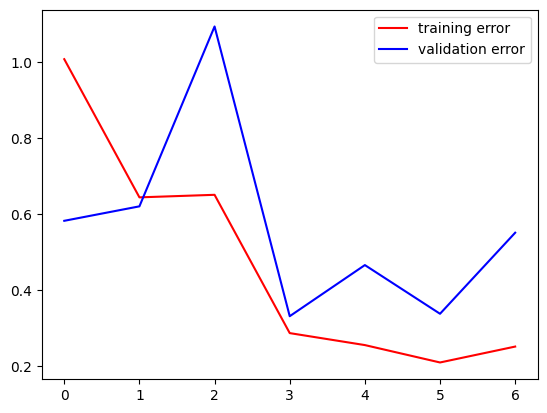

--------------------------------------------
Training = 35.0 %


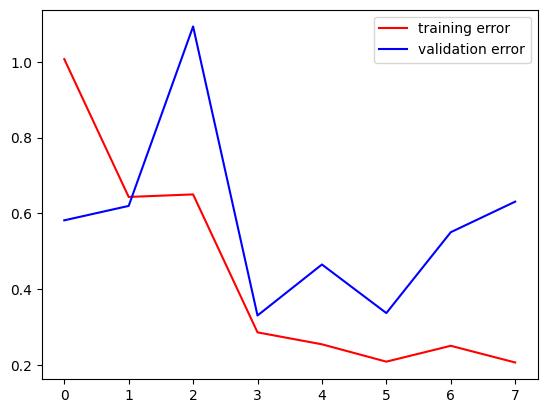

--------------------------------------------
Training = 40.0 %


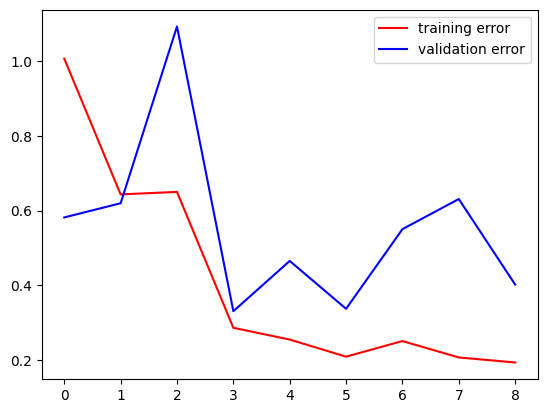

--------------------------------------------
Training = 45.0 %


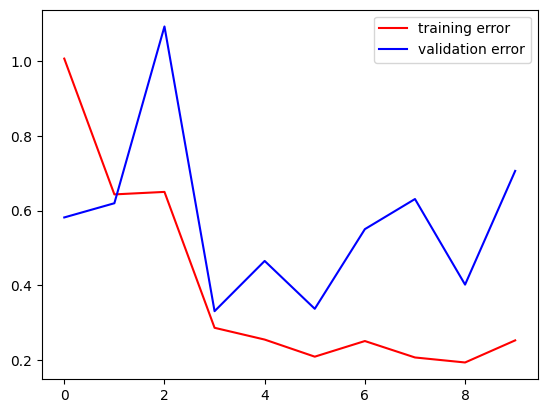

--------------------------------------------
Training = 50.0 %


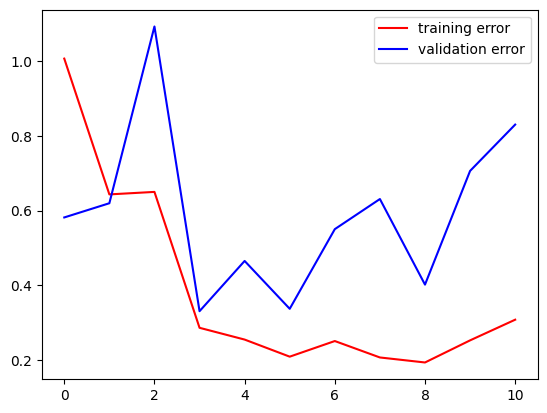

--------------------------------------------
Training = 55.0 %
epoch = 0
dim_clique = 30
training error = 0.14876914024353027
validation error = 0.4481654763221741
test error = 0.4581606388092041
--------------------------------------------
Training = 0.0 %


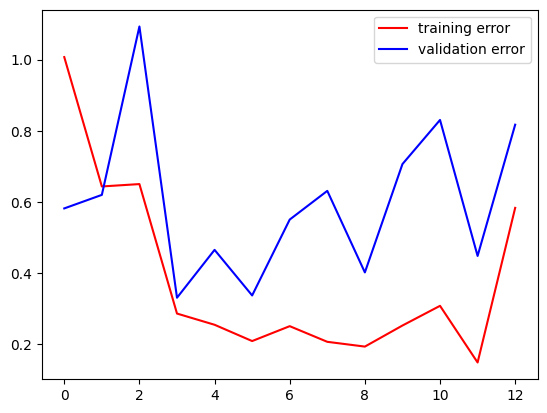

--------------------------------------------
Training = 5.0 %


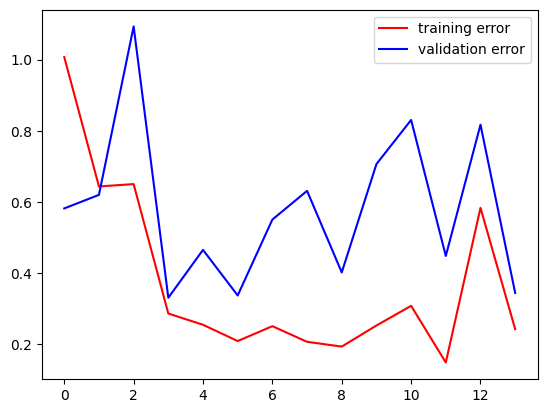

--------------------------------------------
Training = 10.0 %


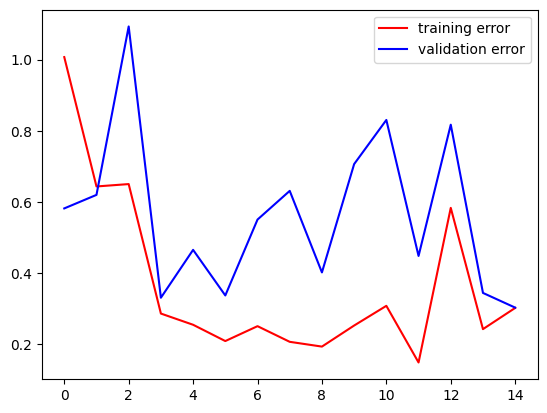

--------------------------------------------
Training = 15.0 %


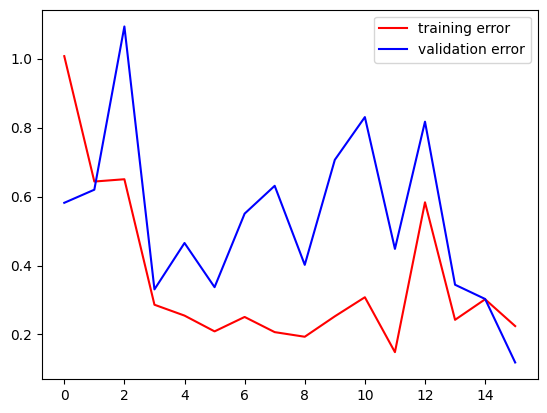

--------------------------------------------
Training = 20.0 %


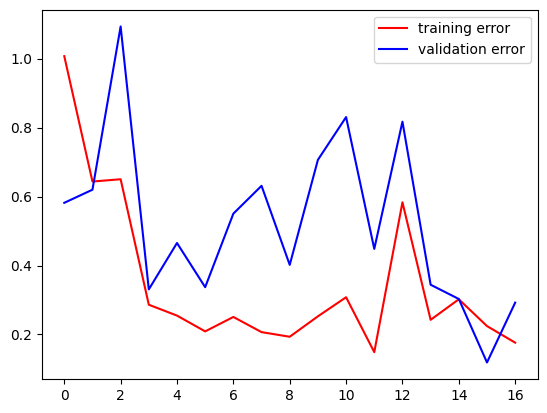

--------------------------------------------
Training = 25.0 %


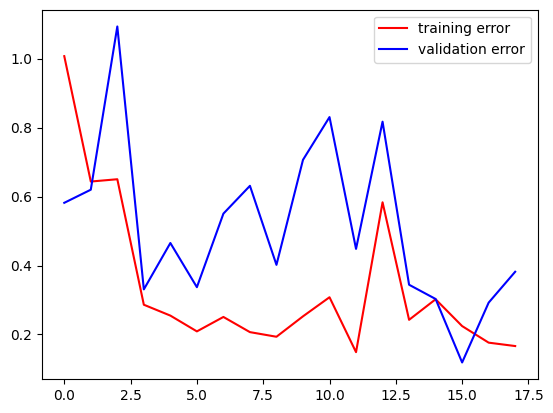

--------------------------------------------
Training = 30.0 %


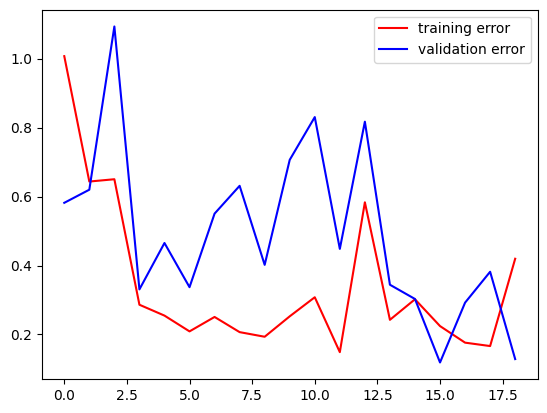

--------------------------------------------
Training = 35.0 %


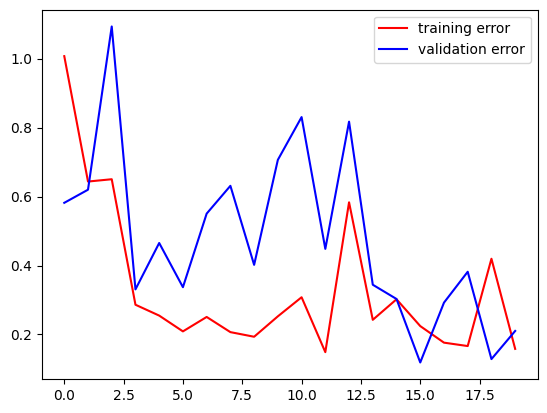

--------------------------------------------
Training = 40.0 %


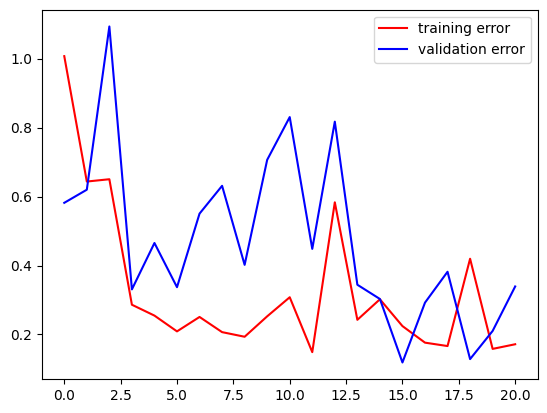

--------------------------------------------
Training = 45.0 %


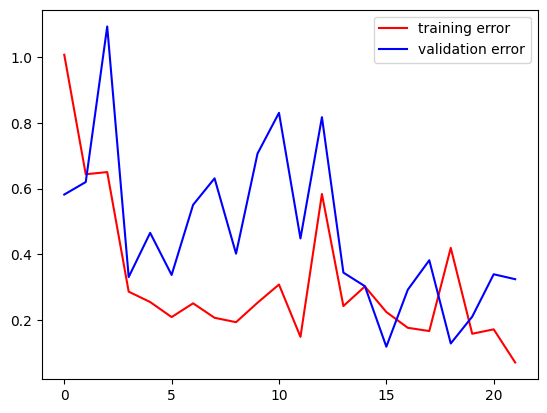

--------------------------------------------
Training = 50.0 %


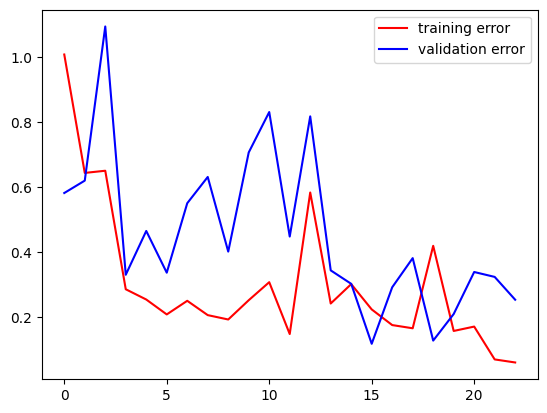

--------------------------------------------
Training = 55.0 %


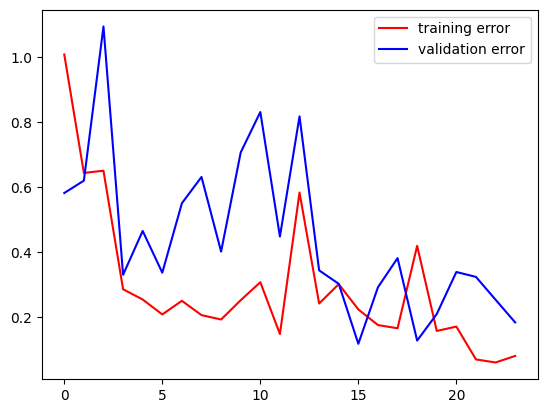

--------------------------------------------
Training = 60.0 %


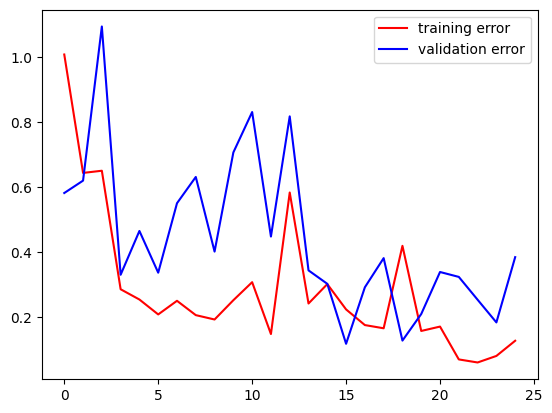

--------------------------------------------
Training = 65.0 %
epoch = 1
dim_clique = 30
training error = 0.13272154331207275
validation error = 0.08589340001344681
test error = 0.2949540317058563
--------------------------------------------
Early stop
--------------------------------------------


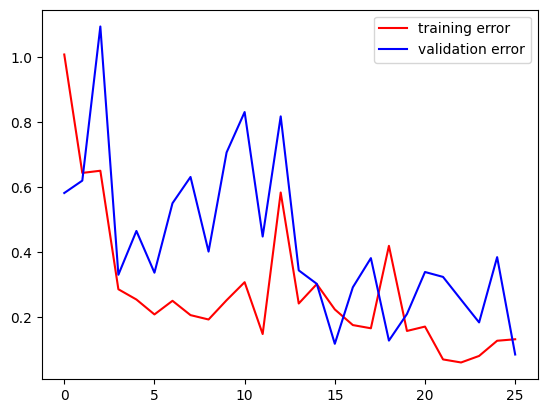

k/n = [5.0, 4.8, 4.6, 4.4, 4.2, 4.0, 3.8, 3.6, 3.4, 3.2, 3.0] % = [100.0, 100.0, 100.0, 100.0, 65.0, 90.0, 90.0, 95.0, 90.0, 90.0, 90.0]


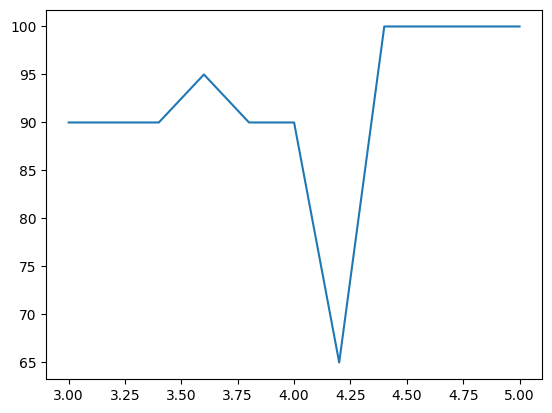

In [ ]:
epoch=5                   # number of epochs
max_steps=100             # maximum number of steps for each epoch
num_train=20              # dimension of the training set at each epoch
num_val=20                # dimension of the validation set
num_test=20               # dimension of the test set
dim_graph=100             # number of nodes
start_dim_clique=50       # dimension of the clique to start with
jump=2                    # jump lengths for the first loop
save_step=5               # number of steps after which we check the early stopping criterion
stop = 29                     # clique size at which we stop
training_exit_error = 0.2    # training error below which we can stop early
validation_exit_error = 0.1  # validation error below which we can stop early

train_error=[]
val_error=[]

generalization=[]
k_over_n=[]
for m in range(0,start_dim_clique-stop,jump):
  dim_clique = start_dim_clique - m
  test = GetClique(num_test,dim_graph,dim_clique, prob = 0.5)
  k_over_n.append(1.0*dim_clique/math.sqrt(dim_graph))
  loss=1.0
  count=0

  for j in range(epoch):
    early_stop_counter=0
    min_validation_loss = np.inf
    train = GetClique(num_train,dim_graph,dim_clique, prob = 0.5)
    val = GetClique(num_val,dim_graph,dim_clique, prob = 0.5)
    for i in range(max_steps):
      output = model(train[0].to(device))
      loss=criterion(output.type(torch.float).to(device), torch.Tensor(train[1]).type(torch.long).to(device))

      # every "print_step" steps we save the error of the train and validation set
      if (i%save_step == 0):
        print('Training =',100.0*i/max_steps,'%')
        train_error.append(loss.item())
        check = model(val[0].to(device))   # checks the output on the validation set
        val_loss = criterion(check.to(device), torch.Tensor(val[1]).type(torch.long).to(device)).item()
        val_error.append(val_loss)

        # early_stopping needs the validation loss to check if it has decresed,
        # and if it has, it will make a checkpoint of the current model
        early_exit,min_validation_loss,early_stop_counter = EarlyStopper(np.array(val_error), early_stop_counter, min_validation_loss)
        if (val_error[count]<validation_exit_error or (early_exit and train_error[count]<training_exit_error)):
          count=count+1
          break

        count=count+1
        if (count > 30):
          # plot of test and validation error curves
          x_axis = np.arange(30)
          fig, ax = plt.subplots()
          ax.plot(x_axis, train_error[count-30:count], 'r', label='training error')
          ax.plot(x_axis, val_error[count-30:count], 'b', label='validation error')
          ax.legend()
          plt.show()
          print('--------------------------------------------')
        else:
          # plot of test and validation error curves
          x_axis = np.arange(count)
          fig, ax = plt.subplots()
          ax.plot(x_axis, train_error[:count], 'r', label='training error')
          ax.plot(x_axis, val_error[:count], 'b', label='validation error')
          ax.legend()
          plt.show()
          print('--------------------------------------------')

      loss.backward()
      optim.step()
      optim.zero_grad(set_to_none=True)


    # test error
    test_output = model(test[0].to(device))   # checks the output on the test set
    test_error = criterion(test_output.to(device), torch.Tensor(test[1]).type(torch.long).to(device))
    if (j%1 == 0):
      print('epoch =',j)
      print('dim_clique =',dim_clique)
      print('training error =', train_error[count-1])
      print('validation error =',val_error[count-1])
      print('test error =',test_error.item())
      print('--------------------------------------------')

    if (val_error[count-1]<validation_exit_error):
          print('Early stop')
          print('--------------------------------------------')
          break
  # plot of test and validation error curves
  x_axis = np.arange(count)
  fig, ax = plt.subplots()
  ax.plot(x_axis, train_error[:count], 'r', label='training error')
  ax.plot(x_axis, val_error[:count], 'b', label='validation error')
  ax.legend()
  plt.show()

  train_error=[]
  val_error=[]

  data = test
  hard_output = torch.zeros([num_test,2])

  soft_output = model(data[0].to(device))
  for l in range(num_test):
    if (soft_output[l][0] > soft_output[l][1]):
      hard_output[l][0] = 1.0
    else: hard_output[l][1] = 1.0
  predicted_output = hard_output

  generalization.append(100*(1-torch.sum(torch.square(torch.Tensor(data[1])-torch.transpose(predicted_output,1,0)[1])).item()/(1.0*num_test)))
  print('k/n =', k_over_n, '% =', generalization)
  print('==========================================')

plt.plot(k_over_n,generalization)

Here we check the generalization error and we compute the transition at which the CNN strats to fail.

k = 85 ----> % = 99.33333333333333
k = 84 ----> % = 98.33333333333333
k = 83 ----> % = 99.66666666666667
k = 82 ----> % = 99.33333333333333
k = 81 ----> % = 99.66666666666667
k = 80 ----> % = 100.0
k = 79 ----> % = 100.0
k = 78 ----> % = 99.66666666666667
k = 77 ----> % = 100.0
k = 76 ----> % = 99.33333333333333
k = 75 ----> % = 99.66666666666667
k = 74 ----> % = 99.33333333333333
k = 73 ----> % = 99.66666666666667
k = 72 ----> % = 100.0
k = 71 ----> % = 99.66666666666667
k = 70 ----> % = 99.66666666666667
k = 69 ----> % = 100.0
k = 68 ----> % = 100.0
k = 67 ----> % = 100.0
k = 66 ----> % = 99.33333333333333
k = 65 ----> % = 99.33333333333333
k = 64 ----> % = 99.0
k = 63 ----> % = 100.0
k = 62 ----> % = 100.0
k = 61 ----> % = 100.0
k = 60 ----> % = 99.66666666666667
k = 59 ----> % = 99.66666666666667
k = 58 ----> % = 99.66666666666667
k = 57 ----> % = 98.66666666666667
k = 56 ----> % = 99.66666666666667
k = 55 ----> % = 99.66666666666667
k = 54 ----> % = 100.0
k = 53 ----> % = 100.0
k 

k = 3 ----> % = 51.333333333333336
k over sqrt(n) = [8.5, 8.4, 8.3, 8.2, 8.1, 8.0, 7.9, 7.8, 7.7, 7.6, 7.5, 7.4, 7.3, 7.2, 7.1, 7.0, 6.9, 6.8, 6.7, 6.6, 6.5, 6.4, 6.3, 6.2, 6.1, 6.0, 5.9, 5.8, 5.7, 5.6, 5.5, 5.4, 5.3, 5.2, 5.1, 5.0, 4.9, 4.8, 4.7, 4.6, 4.5, 4.4, 4.3, 4.2, 4.1, 4.0, 3.9, 3.8, 3.7, 3.6, 3.5, 3.4, 3.3, 3.2, 3.1, 3.0, 2.9, 2.8, 2.7, 2.6, 2.5, 2.4, 2.3, 2.2, 2.1, 2.0, 1.9, 1.8, 1.7, 1.6, 1.5, 1.4, 1.3, 1.2, 1.1, 1.0, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3] % = [99.33333333333333, 98.33333333333333, 99.66666666666667, 99.33333333333333, 99.66666666666667, 100.0, 100.0, 99.66666666666667, 100.0, 99.33333333333333, 99.66666666666667, 99.33333333333333, 99.66666666666667, 100.0, 99.66666666666667, 99.66666666666667, 100.0, 100.0, 100.0, 99.33333333333333, 99.33333333333333, 99.0, 100.0, 100.0, 100.0, 99.66666666666667, 99.66666666666667, 99.66666666666667, 98.66666666666667, 99.66666666666667, 99.66666666666667, 100.0, 100.0, 99.33333333333333, 98.66666666666667, 99.33333333333333, 

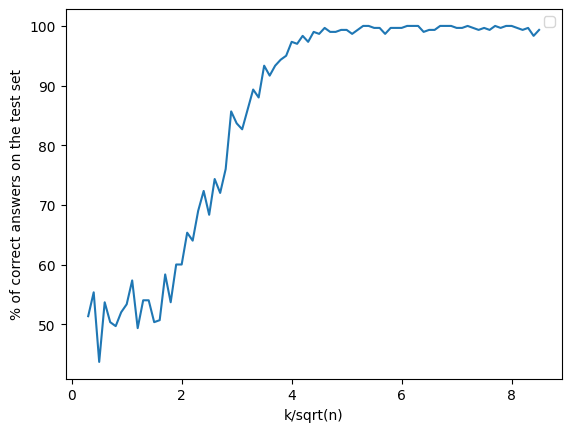

In [ ]:
start_dim_clique = 85
times = 15

generalization_CNN = []
k_vs_sqrt_n_CNN = []

for m in range(0,start_dim_clique-2,1):
  dim_clique = start_dim_clique - m
  k_vs_sqrt_n_CNN.append(1.0*dim_clique/math.sqrt(dim_graph))
  mean = 0

  for j in range(times):
    data = GetClique(num_train,dim_graph,dim_clique, prob = 0.5)
    hard_output = torch.zeros([num_test,2])

    soft_output = model(data[0].to(device))
    for l in range(num_test):
      if (soft_output[l][0] > soft_output[l][1]):
        hard_output[l][0] = 1.0
      else: hard_output[l][1] = 1.0
    predicted_output = hard_output

    mean = mean + 100*(1-torch.sum(torch.square(torch.Tensor(data[1])-torch.transpose(predicted_output,1,0)[1])).item()/(1.0*num_test))

  mean = mean/times
  generalization_CNN.append(mean)
  print('k =',dim_clique,'---->', '% =', mean)
  print('==========================================')
print('k over sqrt(n) =', list(k_vs_sqrt_n_CNN), '% =', list(generalization_CNN))
print('==========================================')

fig, ax = plt.subplots()
ax.plot(k_vs_sqrt_n_CNN,generalization_CNN)
plt.xlabel('k/sqrt(n)')
plt.ylabel('% of correct answers on the test set')
ax.legend()
plt.show()

# Transfer learning (VGG-16)

# Visual Transformer

# Graph Neural Networks (GNNs)

In [ ]:
# Install required packages.
import os
import torch
os.environ['TORCH'] = torch.__version__
print(torch.__version__)

!pip install -q torch-scatter -f https://data.pyg.org/whl/torch-${TORCH}.html
!pip install -q torch-sparse -f https://data.pyg.org/whl/torch-${TORCH}.html
!pip install -q git+https://github.com/pyg-team/pytorch_geometric.git

# Helper function for visualization.
%matplotlib inline
import networkx as nx
import matplotlib.pyplot as plt

2.1.0+cu121
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.8/10.8 MB 83.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.0/5.0 MB 55.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


We build a different dataset generator in the case of GNNs. In fact out graph nodes have no labels, which is not in line with standard GNN architectures. Therefore we have to choose to assign features based on (?). These features some connectivity properties of each node.

In [ ]:
def Plant(A,k,n):
  A[:k,:k] = torch.ones(k,k)
  r = torch.randperm(n)
  A = A[r[:, None], r]
  return A

def PlantedClique(n,p,k,on_off,hidden):
  if (on_off == 0):
    if (hidden == 1):
      p_off = p + (1-p)*(k*(k-1))/(n*(n-1))
    else:
      p_off = p
    A = torch.bernoulli(p_off*torch.ones(n,n))
    A_up = torch.triu(A)
    A = A_up + torch.transpose(A_up, 0, 1)
    A.fill_diagonal_(0)
    return A,on_off
  if (on_off == 1):
    p_on = p
    B = torch.bernoulli(p_on*torch.ones(n,n))
    B_up = torch.triu(B)
    B = B_up + torch.transpose(B_up, 0, 1)
    B.fill_diagonal_(1)
    C = Plant(B,k,n).fill_diagonal_(0)
    return C,on_off

def GetClique(m,n,k,p=0.5,prob=0.5,hidden = 1):
  on_off = torch.bernoulli(prob*torch.ones(m))
  attrib = torch.rand((n*m,5))
  for i in range(m):
    if (i==0):
      data_0 = PlantedClique(n,p,k,on_off[i],hidden)[0]
      batch = i*torch.ones(n)
    else:
      x = PlantedClique(n,p,k,on_off[i],hidden)[0]
      data_0 = torch.block_diag(data_0, x)
      batch = torch.cat((batch, i*torch.ones(n)), 0)

  v_1=torch.sum(data_0,dim=1)
  copy_v_1 = v_1.repeat(n*m,1)
  v_2=torch.sum(copy_v_1*data_0,dim=1)/v_1
  copy_v_2 = v_1.repeat(n*m,1)-v_2.repeat(n*m,1).t()
  copy_v_2 = copy_v_2*copy_v_2
  v_3=torch.sqrt(torch.sum(copy_v_2*data_0,dim=1)/v_1)
  v_4,v_4_ind=torch.max(copy_v_1*data_0,dim=1)
  v_5_contra,v_5_ind=torch.max(data_0/(copy_v_1),dim=1)
  v_5 = 1/v_5_contra

  attrib[:,0] = v_1
  attrib[:,1] = v_2
  attrib[:,2] = v_3
  attrib[:,3] = v_4
  attrib[:,4] = v_5

  data = data_0.long().nonzero().t().contiguous()
  batch = batch.long()
  return attrib,data,batch,on_off.type(torch.long).tolist()

The architecture is just a deep Graph Convolutional network. Also here we use an EarlyStopper function and dropout.

In [ ]:
from torch.nn import Linear
import torch.nn.functional as F
from torch_geometric.nn import GCNConv
from torch_geometric.nn import global_mean_pool

#function for the early stopping
def EarlyStopper(validation_loss, counter, min_validation_loss, past=2, patience=2, min_delta=0.02):
        length = validation_loss.shape[0]
        if np.mean(validation_loss[length-past:]) < min_validation_loss and length > past:
            min_validation_loss = np.mean(validation_loss[length-past:])
            counter = 0
        elif np.mean(validation_loss[length-past:]) > (min_validation_loss + min_delta) and length > past:
            counter += 1
            if counter >= patience:
                return True, min_validation_loss, counter
        return False, min_validation_loss, counter


class GCN(torch.nn.Module):
    def __init__(self, hidden_channels_1, hidden_channels_2, hidden_channels_3, hidden_channels_4, hidden_channels_5):
        super(GCN, self).__init__()
        torch.manual_seed(12345)
        self.conv1 = GCNConv(5, hidden_channels_1)
        self.conv2 = GCNConv(hidden_channels_1, hidden_channels_2)
        self.conv3 = GCNConv(hidden_channels_2, hidden_channels_3)
        self.conv4 = GCNConv(hidden_channels_3, hidden_channels_4)
        self.conv5 = GCNConv(hidden_channels_4, hidden_channels_5)
        self.lin = Linear(hidden_channels_5, 2)

    def forward(self, x, edge_index, batch):
        # 1. Obtain node embeddings
        x = self.conv1(x, edge_index)
        x = x.relu()
        x = self.conv2(x, edge_index)
        x = x.relu()
        x = self.conv3(x, edge_index)
        x = x.relu()
        x = self.conv4(x, edge_index)
        x = x.relu()
        x = self.conv5(x, edge_index)

        # 2. Readout layer
        x = global_mean_pool(x, batch)  # [batch_size, hidden_channels]

        # 3. Apply a final classifier
        x = F.dropout(x, p=0.2, training=self.training)
        x = self.lin(x)

        return x

model_g = GCN(hidden_channels_1=100, hidden_channels_2=80, hidden_channels_3=60, hidden_channels_4=40, hidden_channels_5=20)
optim=torch.optim.Adam(model_g.parameters())   # optimization by Adam
criterion = nn.CrossEntropyLoss()
model_g.to(device)

GCN(
  (conv1): GCNConv(5, 100)
  (conv2): GCNConv(100, 80)
  (conv3): GCNConv(80, 60)
  (conv4): GCNConv(60, 40)
  (conv5): GCNConv(40, 20)
  (lin): Linear(in_features=20, out_features=2, bias=True)
)

Usual training...

Training = 0.0 %


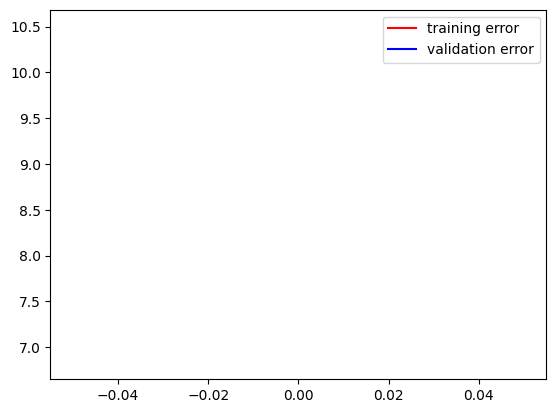

--------------------------------------------
Training = 5.0 %


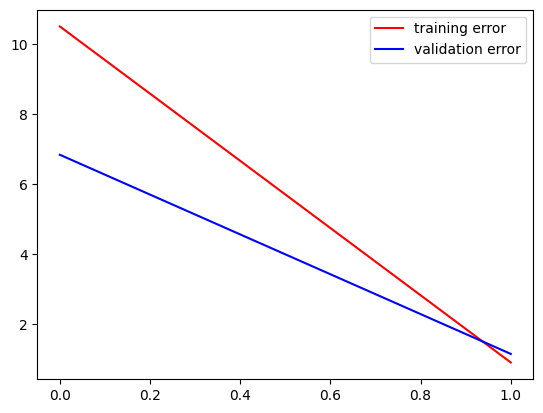

--------------------------------------------
Training = 10.0 %


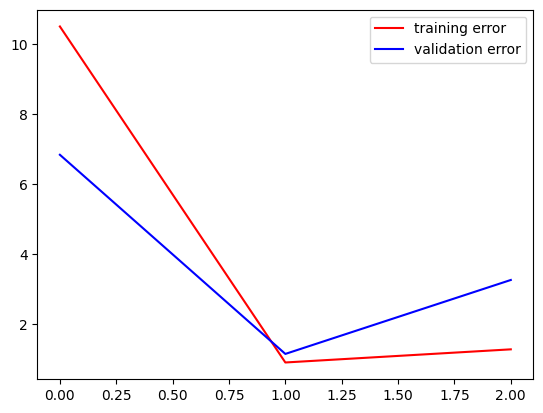

--------------------------------------------
Training = 15.0 %


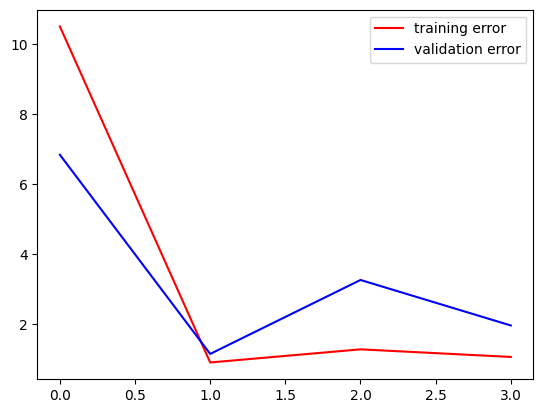

--------------------------------------------
Training = 20.0 %


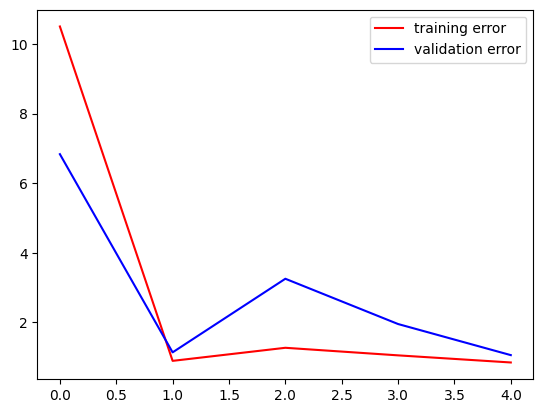

--------------------------------------------
Training = 25.0 %


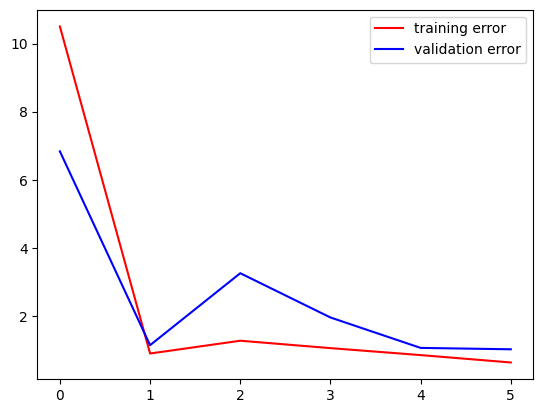

--------------------------------------------
Training = 30.0 %


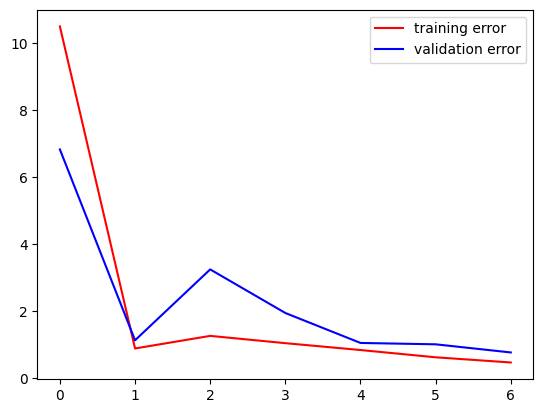

--------------------------------------------
Training = 35.0 %


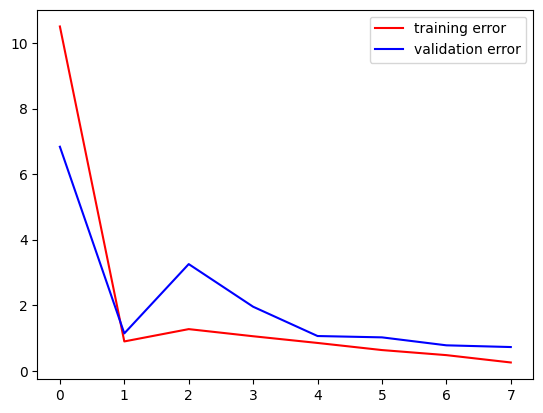

--------------------------------------------
Training = 40.0 %


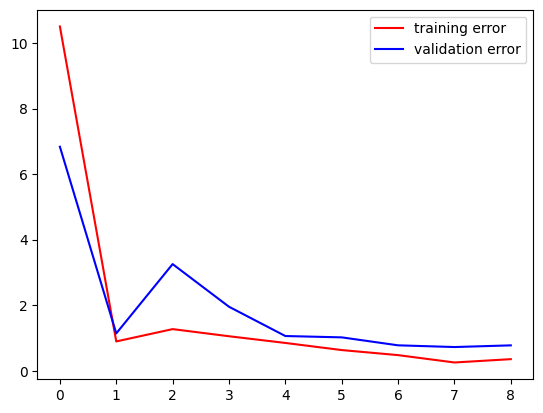

--------------------------------------------
Training = 45.0 %


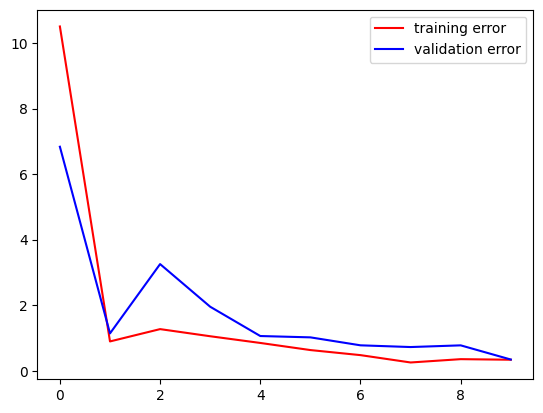

--------------------------------------------
Training = 50.0 %


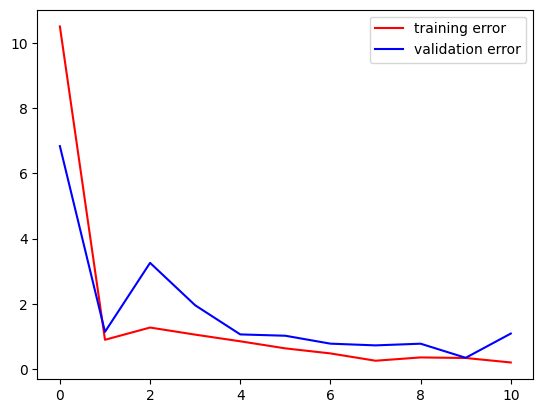

--------------------------------------------
Training = 55.0 %
epoch = 0
dim_clique = 50
training error = 0.1847175657749176
validation error = 0.46634578704833984
test error = 0.5475558042526245
--------------------------------------------
Training = 0.0 %


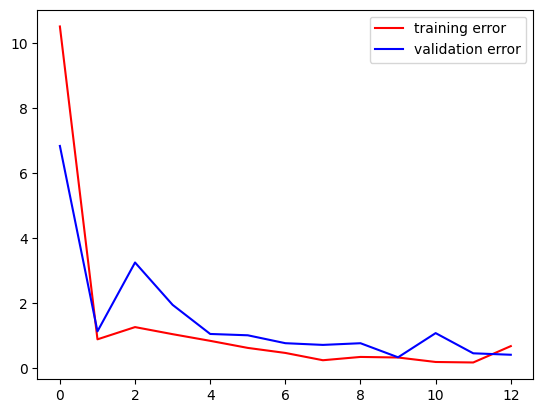

--------------------------------------------
Training = 5.0 %


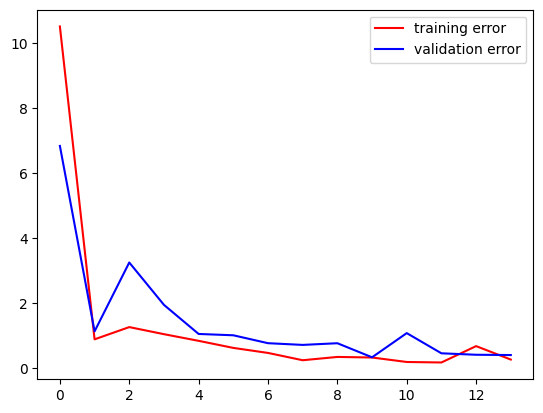

--------------------------------------------
Training = 10.0 %


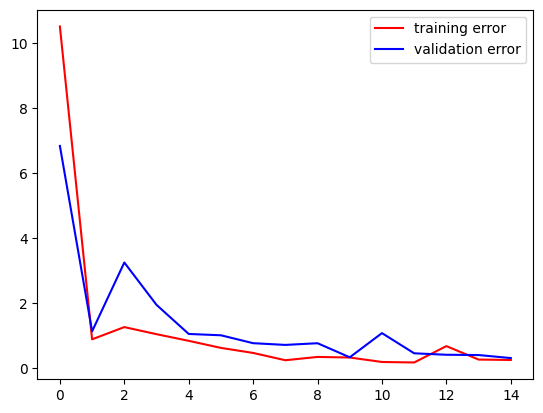

--------------------------------------------
Training = 15.0 %


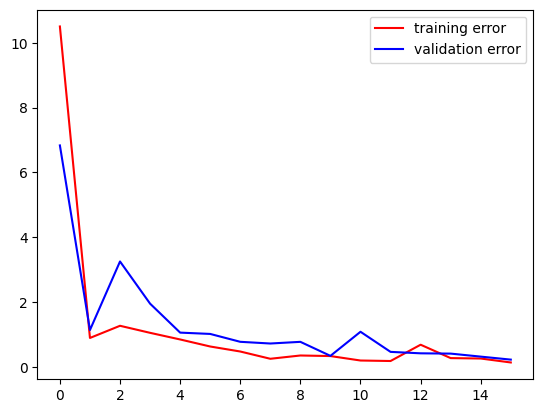

--------------------------------------------
Training = 20.0 %
epoch = 1
dim_clique = 50
training error = 0.2026321142911911
validation error = 0.09484102576971054
test error = 0.08802280575037003
--------------------------------------------
Early stop
--------------------------------------------


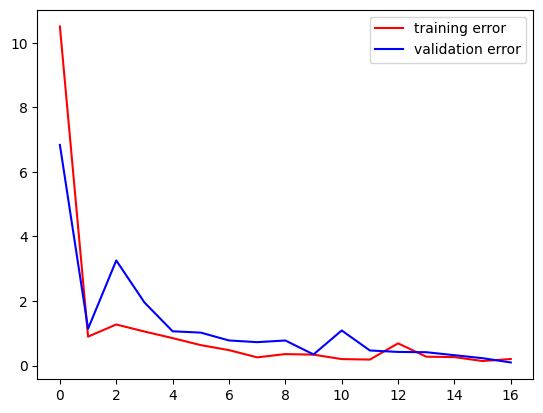

k/n = [5.0] % = [99.5]
Training = 0.0 %


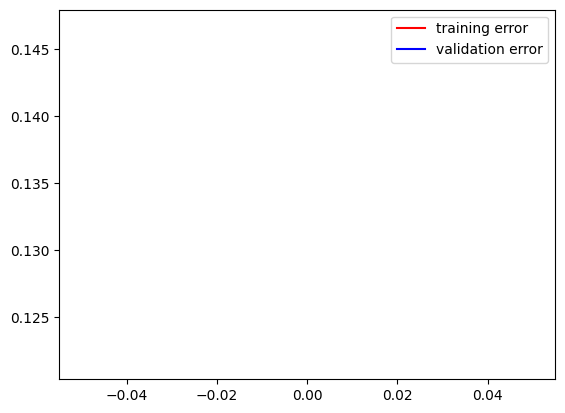

--------------------------------------------
Training = 5.0 %
epoch = 0
dim_clique = 45
training error = 0.10855148732662201
validation error = 0.07716044038534164
test error = 0.18883557617664337
--------------------------------------------
Early stop
--------------------------------------------


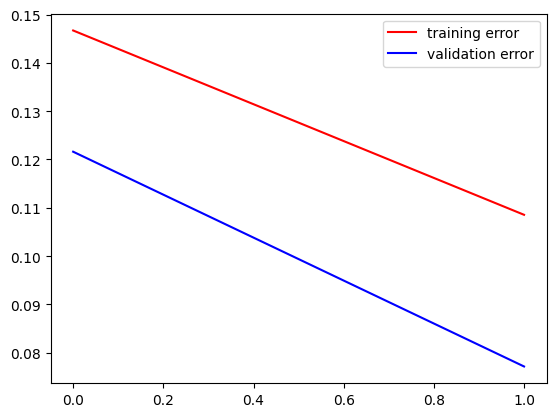

k/n = [5.0, 4.5] % = [99.5, 95.5]
Training = 0.0 %


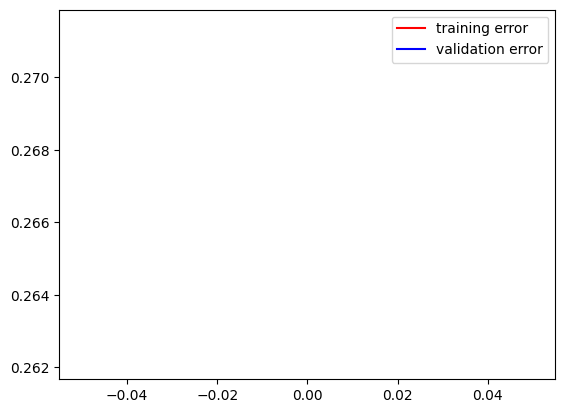

--------------------------------------------
Training = 5.0 %


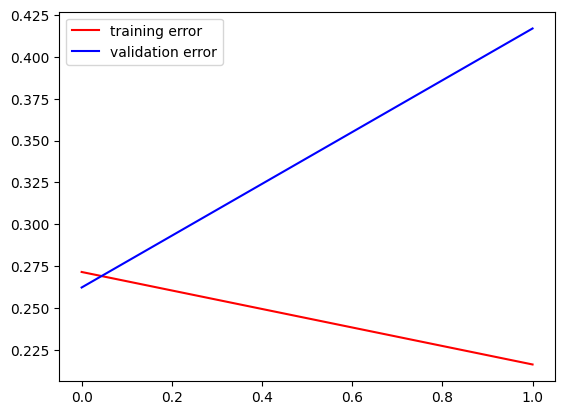

--------------------------------------------
Training = 10.0 %
epoch = 0
dim_clique = 40
training error = 0.12063299119472504
validation error = 0.09205921739339828
test error = 0.10754106193780899
--------------------------------------------
Early stop
--------------------------------------------


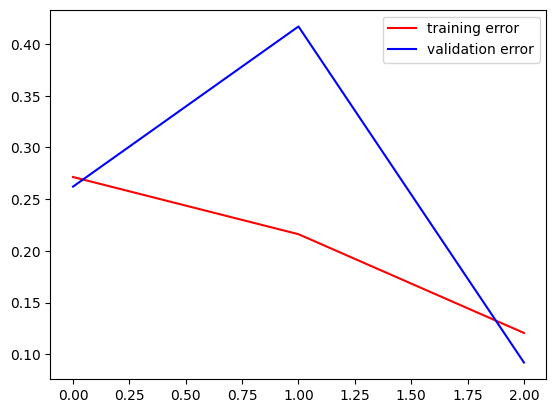

k/n = [5.0, 4.5, 4.0] % = [99.5, 95.5, 99.5]
Training = 0.0 %


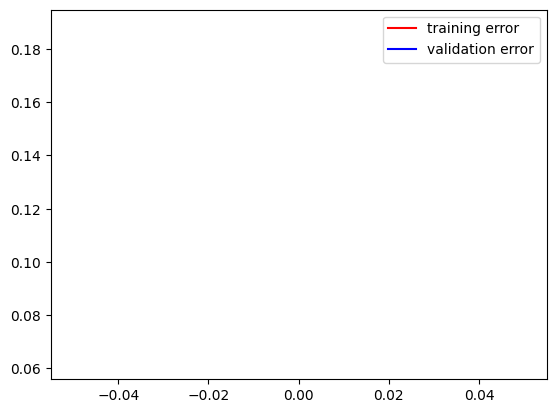

--------------------------------------------
Training = 5.0 %


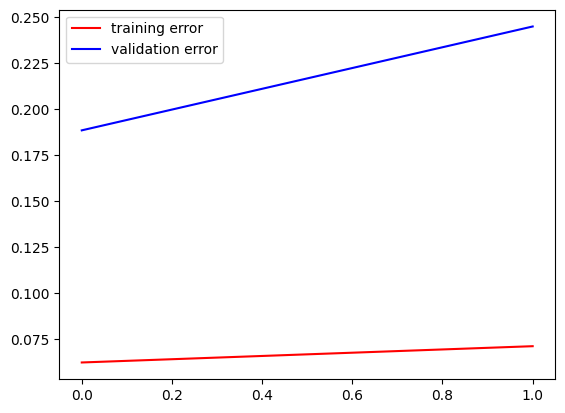

--------------------------------------------
Training = 10.0 %
epoch = 0
dim_clique = 35
training error = 0.036570850759744644
validation error = 0.06945910304784775
test error = 0.10002069175243378
--------------------------------------------
Early stop
--------------------------------------------


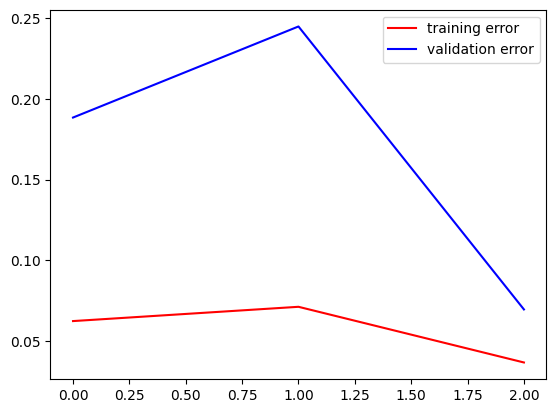

k/n = [5.0, 4.5, 4.0, 3.5] % = [99.5, 95.5, 99.5, 99.0]
Training = 0.0 %


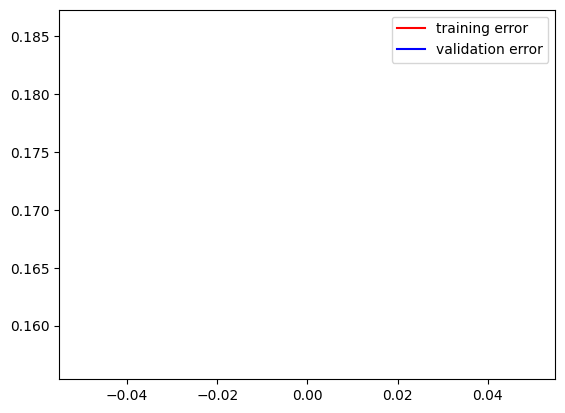

--------------------------------------------
Training = 5.0 %
epoch = 0
dim_clique = 30
training error = 0.1233259066939354
validation error = 0.08435366302728653
test error = 0.1032283678650856
--------------------------------------------
Early stop
--------------------------------------------


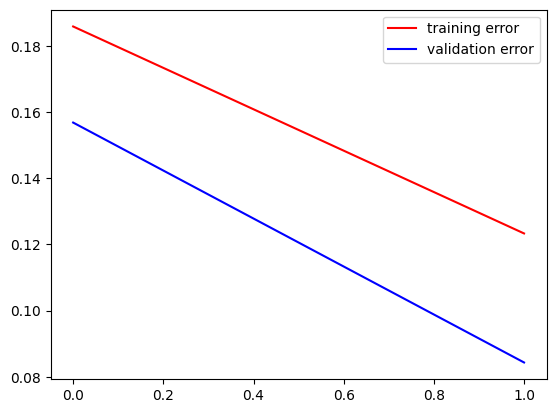

k/n = [5.0, 4.5, 4.0, 3.5, 3.0] % = [99.5, 95.5, 99.5, 99.0, 98.0]
Training = 0.0 %


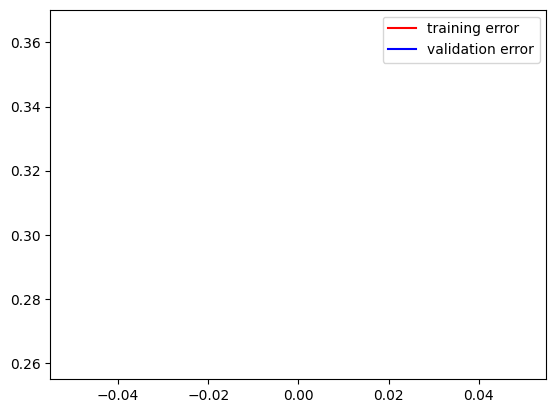

--------------------------------------------
Training = 5.0 %


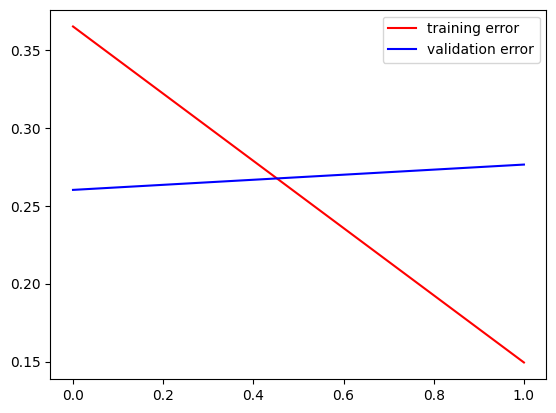

--------------------------------------------
Training = 10.0 %


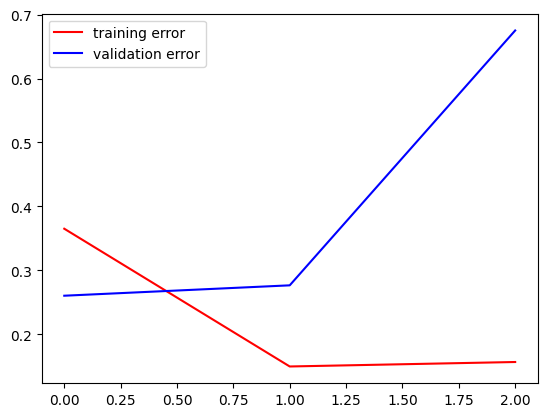

--------------------------------------------
Training = 15.0 %


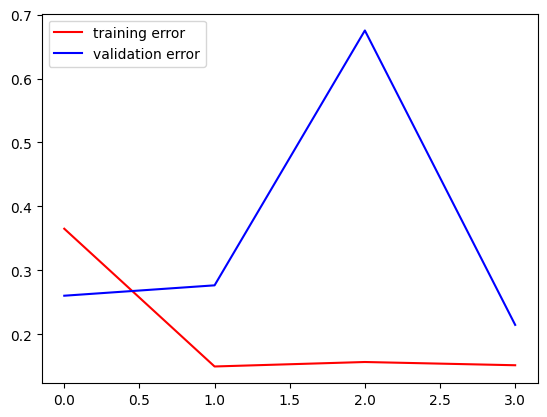

--------------------------------------------
Training = 20.0 %


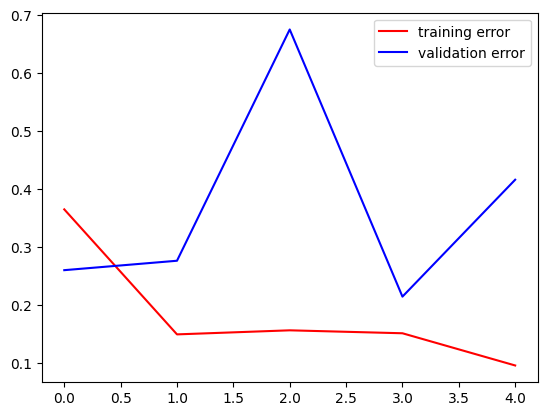

--------------------------------------------
Training = 25.0 %


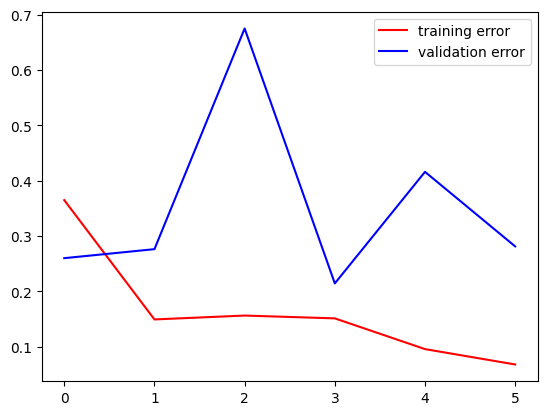

--------------------------------------------
Training = 30.0 %


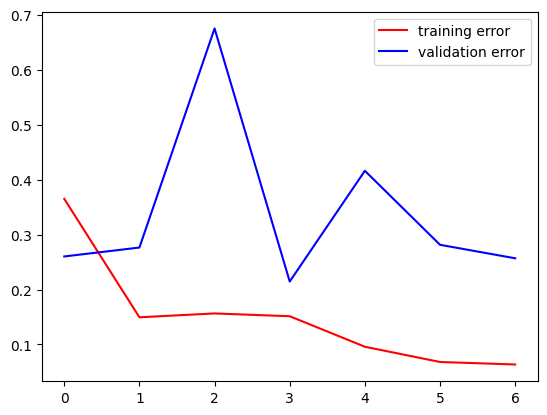

--------------------------------------------
Training = 35.0 %


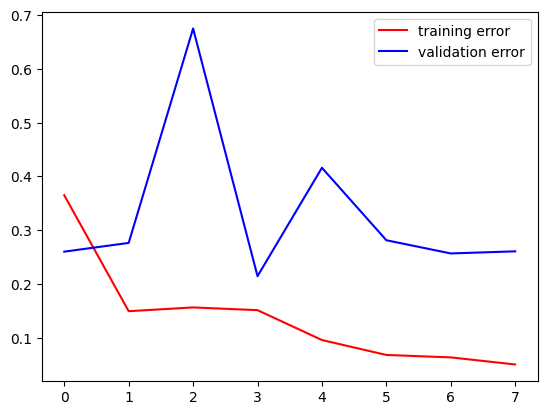

--------------------------------------------
Training = 40.0 %


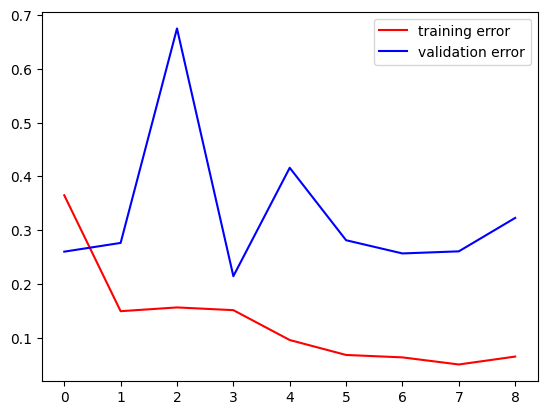

--------------------------------------------
Training = 45.0 %
epoch = 0
dim_clique = 25
training error = 0.029134605079889297
validation error = 0.3599596619606018
test error = 0.210947185754776
--------------------------------------------
Training = 0.0 %


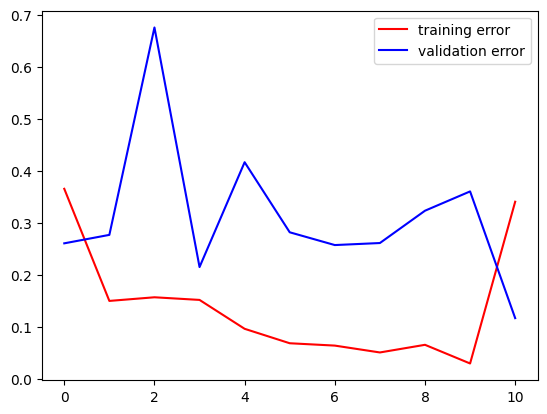

--------------------------------------------
Training = 5.0 %
epoch = 1
dim_clique = 25
training error = 0.19250163435935974
validation error = 0.05906631797552109
test error = 0.09789155423641205
--------------------------------------------
Early stop
--------------------------------------------


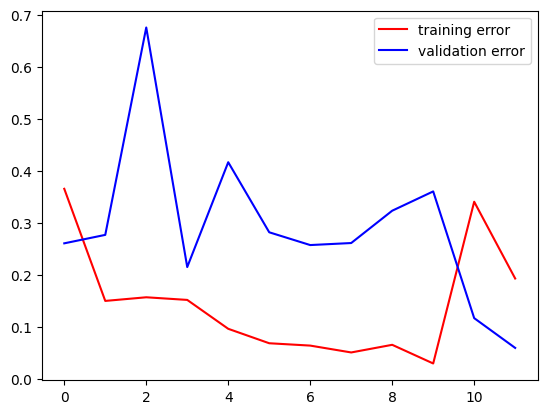

k/n = [5.0, 4.5, 4.0, 3.5, 3.0, 2.5] % = [99.5, 95.5, 99.5, 99.0, 98.0, 97.0]
Training = 0.0 %


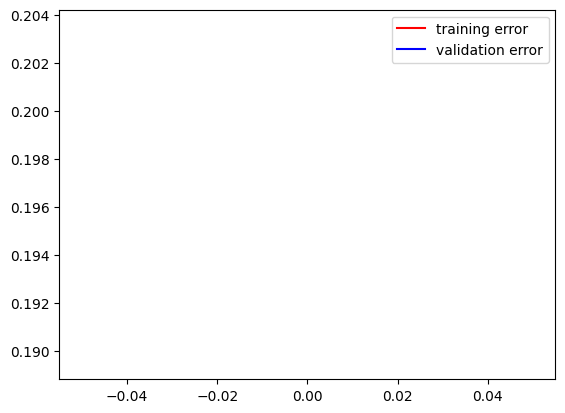

--------------------------------------------
Training = 5.0 %


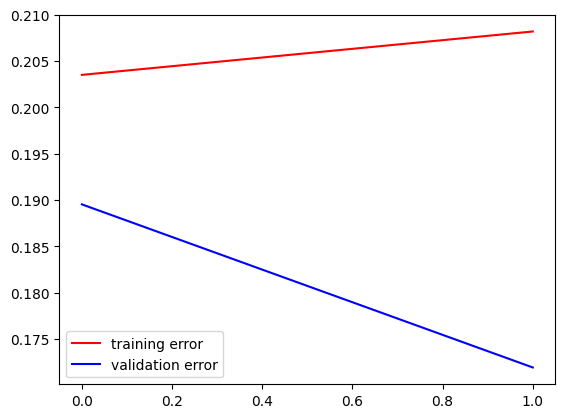

--------------------------------------------
Training = 10.0 %


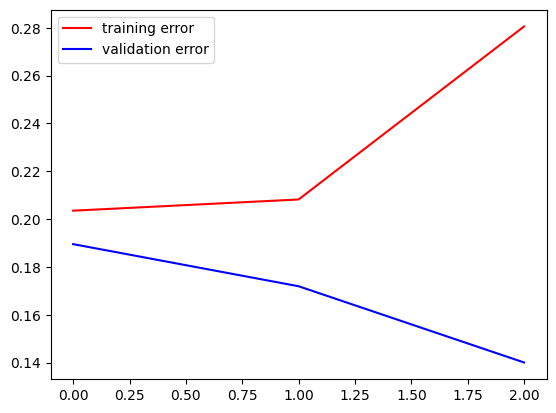

--------------------------------------------
Training = 15.0 %


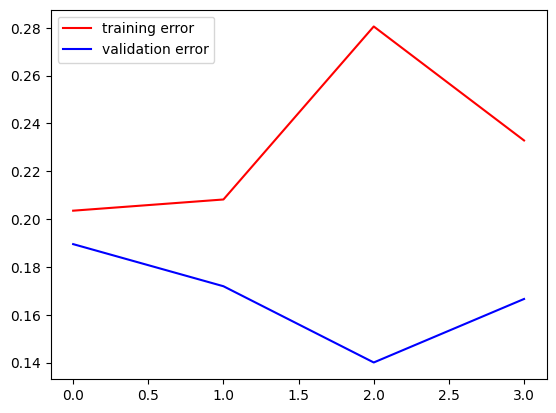

--------------------------------------------
Training = 20.0 %


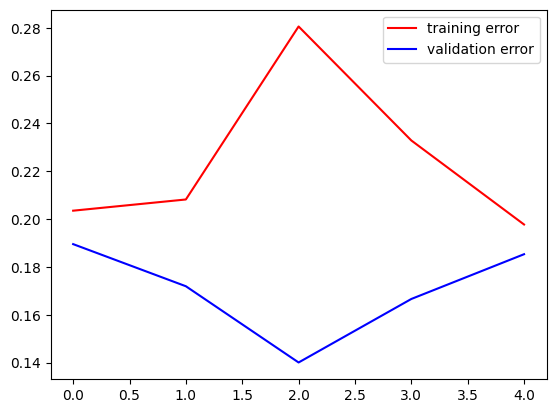

--------------------------------------------
Training = 25.0 %


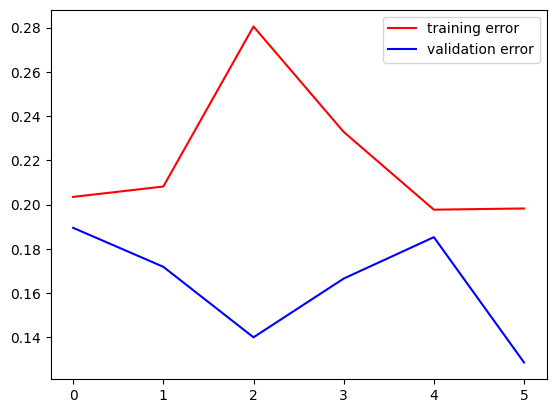

--------------------------------------------
Training = 30.0 %


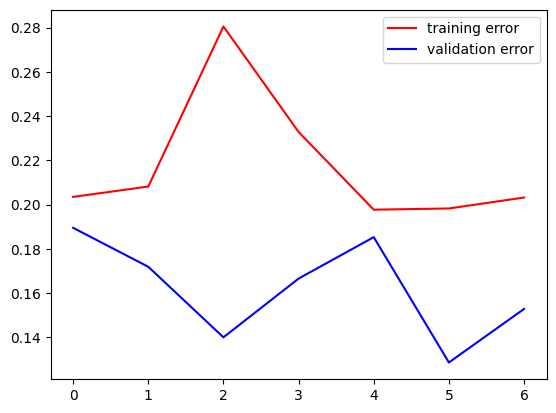

--------------------------------------------
Training = 35.0 %


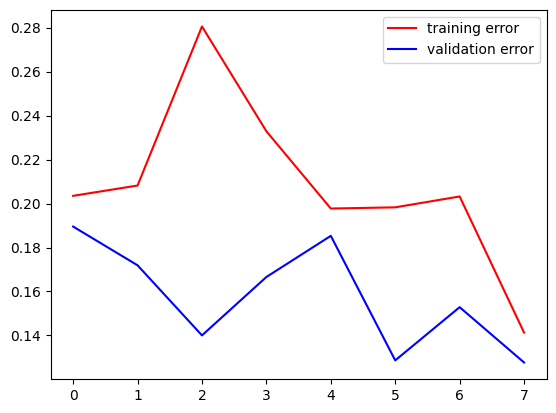

--------------------------------------------
Training = 40.0 %


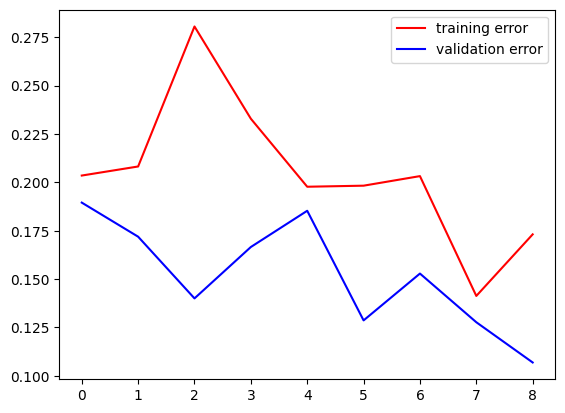

--------------------------------------------
Training = 45.0 %


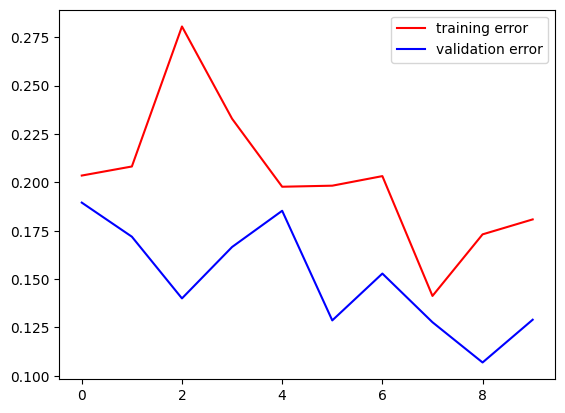

--------------------------------------------
Training = 50.0 %
epoch = 0
dim_clique = 20
training error = 0.17859894037246704
validation error = 0.09868927299976349
test error = 0.5133718252182007
--------------------------------------------
Early stop
--------------------------------------------


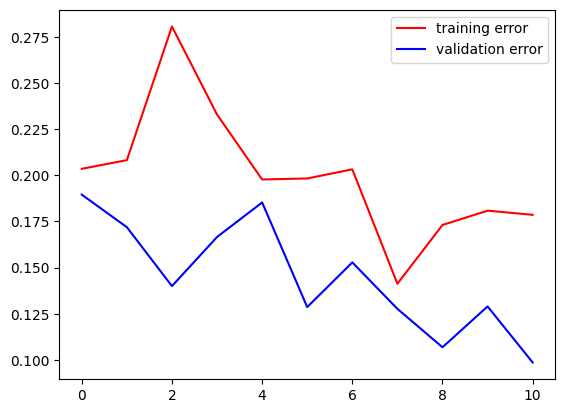

k/n = [5.0, 4.5, 4.0, 3.5, 3.0, 2.5, 2.0] % = [99.5, 95.5, 99.5, 99.0, 98.0, 97.0, 90.0]


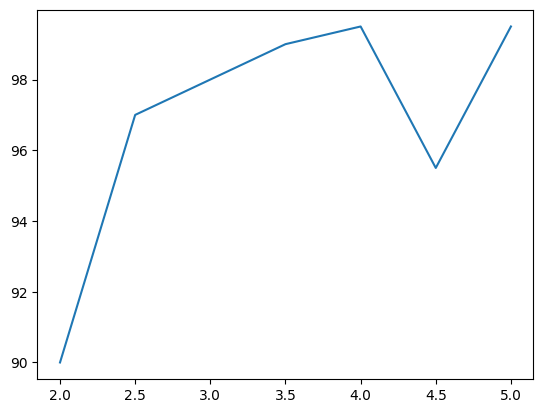

In [ ]:
epoch=10                  # number of epochs
max_steps=100             # maximum number of steps for each epoch
num_train=10              # dimension of the training set at each epoch
num_val=10               # dimension of the validation set
num_test=20              # dimension of the test set
dim_graph= 100            # number of nodes
start_dim_clique=50       # dimension of the clique to start with
jump=5                    # jump lengths for the first loop
save_step=5               # number of steps after which we check the early stopping criterion
stop = 19                     # clique size at which we stop
training_exit_error = 0.2    # training error below which we can stop early
validation_exit_error = 0.1  # validation error below which we can stop early
times=10

train_error=[]
val_error=[]

generalization=[]
k_over_sqrt_n=[]
for m in range(0,start_dim_clique - stop,jump):
  dim_clique = start_dim_clique - m
  test = GetClique(num_test,dim_graph,dim_clique,prob = 0.5)
  k_over_sqrt_n.append(1.0*dim_clique/math.sqrt(dim_graph))
  loss=1.0
  count=0

  for j in range(epoch):
    early_stop_counter=0
    min_validation_loss = np.inf
    train = GetClique(num_train,dim_graph,dim_clique, prob = 0.5)
    val = GetClique(num_val,dim_graph,dim_clique, prob = 0.5)
    for i in range(max_steps):
      output = model_g(train[0].to(device),train[1].to(device),train[2].to(device))
      loss=criterion(output.type(torch.float).to(device), torch.Tensor(train[3]).type(torch.long).to(device))

      # every "print_step" steps we save the error of the train and validation set
      if (i%save_step == 0):
        print('Training =',100.0*i/max_steps,'%')
        train_error.append(loss.item())
        check = model_g(val[0].to(device),val[1].to(device),val[2].to(device))   # checks the output on the validation set
        val_loss = criterion(check.to(device), torch.Tensor(val[3]).type(torch.long).to(device)).item()
        val_error.append(val_loss)

        # early_stopping needs the validation loss to check if it has decresed,
        # and if it has, it will make a checkpoint of the current model
        early_exit,min_validation_loss,early_stop_counter = EarlyStopper(np.array(val_error), early_stop_counter, min_validation_loss)
        if (val_error[count]<validation_exit_error or (early_exit and train_error[count]<training_exit_error)):
          count=count+1
          break

        count=count+1
        if (count > 30):
          # plot of test and validation error curves
          x_axis = np.arange(30)
          fig, ax = plt.subplots()
          ax.plot(x_axis, train_error[count-30:count], 'r', label='training error')
          ax.plot(x_axis, val_error[count-30:count], 'b', label='validation error')
          ax.legend()
          plt.show()
          print('--------------------------------------------')
        else:
          # plot of test and validation error curves
          x_axis = np.arange(count)
          fig, ax = plt.subplots()
          ax.plot(x_axis, train_error[:count], 'r', label='training error')
          ax.plot(x_axis, val_error[:count], 'b', label='validation error')
          ax.legend()
          plt.show()
          print('--------------------------------------------')

      loss.backward()
      optim.step()
      optim.zero_grad(set_to_none=True)


    # test error
    test_output = model_g(test[0].to(device),test[1].to(device),test[2].to(device))   # checks the output on the test set
    test_error = criterion(test_output.to(device), torch.Tensor(test[3]).type(torch.long).to(device))
    if (j%1 == 0):
      print('epoch =',j)
      print('dim_clique =',dim_clique)
      print('training error =', train_error[count-1])
      print('validation error =',val_error[count-1])
      print('test error =',test_error.item())
      print('--------------------------------------------')

    if (val_error[count-1]<validation_exit_error):
          print('Early stop')
          print('--------------------------------------------')
          break
  # plot of test and validation error curves
  x_axis = np.arange(count)
  fig, ax = plt.subplots()
  ax.plot(x_axis, train_error[:count], 'r', label='training error')
  ax.plot(x_axis, val_error[:count], 'b', label='validation error')
  ax.legend()
  plt.show()

  train_error=[]
  val_error=[]

  mean=0
  for j in range(times):
    data = GetClique(num_test,dim_graph,dim_clique)
    hard_output = torch.zeros([num_test,2])

    soft_output = model_g(data[0].to(device),data[1].to(device),data[2].to(device))
    for l in range(num_test):
      if (soft_output[l][0] > soft_output[l][1]):
        hard_output[l][0] = 1.0
      else: hard_output[l][1] = 1.0
    predicted_output = hard_output

    mean = mean + 100*(1-torch.sum(torch.square(torch.Tensor(data[3])-torch.transpose(predicted_output,1,0)[1])).item()/(1.0*num_test))

  mean = mean/times
  generalization.append(mean)

  print('k/n =', k_over_sqrt_n, '% =', generalization)
  print('==========================================')

plt.plot(k_over_sqrt_n,generalization)

Here we check the generalization error and we compute the transition at which the GNN starts to fail.

k = 85 ----> % = 100.0
k = 84 ----> % = 100.0
k = 83 ----> % = 100.0
k = 82 ----> % = 100.0
k = 81 ----> % = 100.0
k = 80 ----> % = 100.0
k = 79 ----> % = 100.0
k = 78 ----> % = 100.0
k = 77 ----> % = 100.0
k = 76 ----> % = 100.0
k = 75 ----> % = 100.0
k = 74 ----> % = 100.0
k = 73 ----> % = 100.0
k = 72 ----> % = 100.0
k = 71 ----> % = 100.0
k = 70 ----> % = 100.0
k = 69 ----> % = 100.0
k = 68 ----> % = 100.0
k = 67 ----> % = 100.0
k = 66 ----> % = 100.0
k = 65 ----> % = 100.0
k = 64 ----> % = 100.0
k = 63 ----> % = 100.0
k = 62 ----> % = 100.0
k = 61 ----> % = 100.0
k = 60 ----> % = 100.0
k = 59 ----> % = 100.0
k = 58 ----> % = 100.0
k = 57 ----> % = 100.0
k = 56 ----> % = 100.0
k = 55 ----> % = 100.0
k = 54 ----> % = 100.0
k = 53 ----> % = 100.0
k = 52 ----> % = 100.0
k = 51 ----> % = 99.66666666666667
k = 50 ----> % = 100.0
k = 49 ----> % = 100.0
k = 48 ----> % = 99.33333333333333
k = 47 ----> % = 99.33333333333333
k = 46 ----> % = 100.0
k = 45 ----> % = 99.66666666666667
k = 44 --

k = 3 ----> % = 47.333333333333336
k over sqrt(n) = [8.5, 8.4, 8.3, 8.2, 8.1, 8.0, 7.9, 7.8, 7.7, 7.6, 7.5, 7.4, 7.3, 7.2, 7.1, 7.0, 6.9, 6.8, 6.7, 6.6, 6.5, 6.4, 6.3, 6.2, 6.1, 6.0, 5.9, 5.8, 5.7, 5.6, 5.5, 5.4, 5.3, 5.2, 5.1, 5.0, 4.9, 4.8, 4.7, 4.6, 4.5, 4.4, 4.3, 4.2, 4.1, 4.0, 3.9, 3.8, 3.7, 3.6, 3.5, 3.4, 3.3, 3.2, 3.1, 3.0, 2.9, 2.8, 2.7, 2.6, 2.5, 2.4, 2.3, 2.2, 2.1, 2.0, 1.9, 1.8, 1.7, 1.6, 1.5, 1.4, 1.3, 1.2, 1.1, 1.0, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3] % = [100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 99.66666666666667, 100.0, 100.0, 99.33333333333333, 99.33333333333333, 100.0, 99.66666666666667, 98.33333333333333, 99.0, 98.66666666666667, 99.33333333333333, 98.33333333333333, 99.33333333333333, 98.66666666666667, 97.66666666666667, 96.66666666666667, 98.66666666666667, 96.333333333333

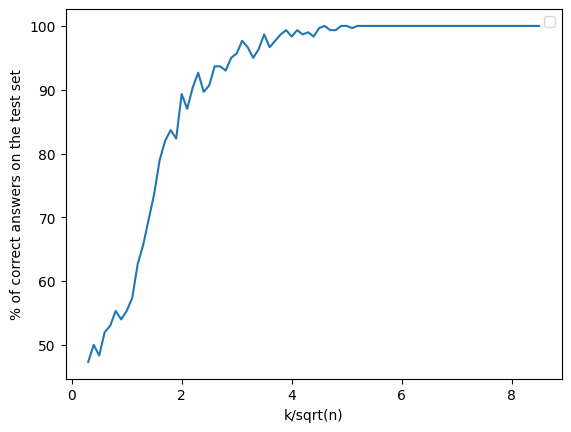

In [ ]:
start_dim_clique=85
stop = 2
times = 15

generalization_GNN = []
k_vs_sqrt_n_GNN = []

for m in range(0,start_dim_clique - stop,1):
  dim_clique = start_dim_clique - m
  k_vs_sqrt_n_GNN.append(1.0*dim_clique/math.sqrt(dim_graph))
  mean = 0

  for j in range(times):
    data = GetClique(num_test,dim_graph,dim_clique)
    hard_output = torch.zeros([num_test,2])

    soft_output = model_g(data[0].to(device),data[1].to(device),data[2].to(device))
    for l in range(num_test):
      if (soft_output[l][0] > soft_output[l][1]):
        hard_output[l][0] = 1.0
      else: hard_output[l][1] = 1.0
    predicted_output = hard_output

    mean = mean + 100*(1-torch.sum(torch.square(torch.Tensor(data[3])-torch.transpose(predicted_output,1,0)[1])).item()/(1.0*num_test))

  mean = mean/times
  generalization_GNN.append(mean)
  print('k =',dim_clique,'---->', '% =', mean)
  print('==========================================')
print('k over sqrt(n) =', list(k_vs_sqrt_n_GNN), '% =', list(generalization_GNN))
print('==========================================')

fig, ax = plt.subplots()
ax.plot(k_vs_sqrt_n_GNN,generalization_GNN)
plt.xlabel('k/sqrt(n)')
plt.ylabel('% of correct answers on the test set')
ax.legend()
plt.show()

# Performance Comparison

This is a comparison of the performance between the different models we tested on the problem

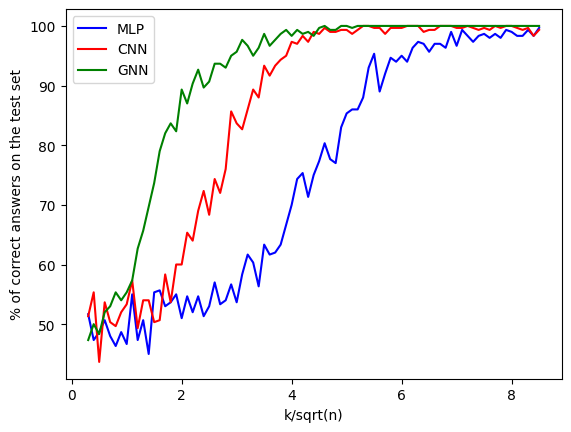

In [ ]:
fig, ax = plt.subplots()
ax.plot(k_vs_sqrt_n_MLP,generalization_MLP, 'b', label='MLP')
ax.plot(k_vs_sqrt_n_CNN,generalization_CNN, 'r', label='CNN')
ax.plot(k_vs_sqrt_n_GNN,generalization_GNN, 'g', label='GNN')
plt.xlabel('k/sqrt(n)')
plt.ylabel('% of correct answers on the test set')
ax.legend()
plt.show()